In [16]:
import torch
from torch import nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader
from torch.utils.data import sampler

import torchvision.models as models
import torchvision.transforms as T
import numpy as np
import h5py
import os
import sys
import datetime
import csv

import torchvision
from torchvision import transforms as transforms
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

import logging
from torch.utils.tensorboard import SummaryWriter
from torch.utils.data import Dataset

# For visualize input
from torch.utils.tensorboard import SummaryWriter
import io
import torchvision
from torchvision import transforms as transforms
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import matplotlib.image as mpimg
from PIL import Image

class EEGDataset(Dataset):
    '''
    Custom Dataset object for PyTorch to load the dataset
    '''
    def __init__(self, x, y, train, val):
        super(EEGDataset).__init__()
        assert x.shape[0] == y.size
        self.x = x
        self.y = [y[i][0] for i in range(y.size)]
        self.train = train
        self.val = val

    def __getitem__(self,key):
        return (self.x[key], self.y[key])

    def __len__(self):
        return len(self.y)

class Logger():
    '''
    Object controlling how information will be logged
    A logger created globally will be used to log all information
    Create a Logger(mode='debug') to have everything print to the console
    '''
    def __init__(self, mode='log'):
        self.mode = mode
        
    def set_model_save_location(self, model_dir):
        self.model_dir = f"saved-model/{model_dir}"
        if not os.path.isdir(slef.model_dir):
            os.mkdir(self.model_dir)
        
    def set_experiment(self, experiment_name):
        self.experiment_name = experiment_name
        log_format = '%(asctime)s %(message)s'
        logging.basicConfig(stream=sys.stdout, level=logging.INFO,
                            format=log_format, datefmt='%m/%d %I:%M:%S %p')
        fh = logging.FileHandler(os.path.join('training-logs', f'log-{experiment_name}-{datetime.datetime.today()}.txt'))
        fh.setFormatter(logging.Formatter(log_format))
        logging.getLogger().addHandler(fh)
        self.writer = SummaryWriter(f"runs/{experiment_name}")
            
    def log(self, message=""):
        if self.mode == 'log':
            logging.info(message)
        elif self.mode == 'debug':
            print(message)

    def save_model(self, model, info):
        torch.save(model.state_dict(), f"{self.model_dir}/model-{logger.experiment_name}-{info}")
        
def load_data(path, role, winLength, numChan, srate, feature, one_channel=False, version=""):
    """
    Load dataset
    :param  
        path: Filepath to the dataset
        role: Role of the dataset. Can be "train", "val", or "test"
        winLength: Length of time window. Can be 2 or 15
        numChan: Number of channels. Can be 24 or 128
        srate: Sampling rate. Supporting 126Hz
        feature: Input feature. Can be "raw", "spectral", or "topo"
        one_channel: Whether input has 1 or 3 channel in depth dimension. Matters when load topo data as number of input channels 
                are different from original's
        version: Any additional information of the datafile. Will be appended to the file name at the end
    """
    transform = T.Compose([
        T.ToTensor()
    ])
    if version:
        f = h5py.File(path + f"child_mind_x_{role}_{winLength}s_{numChan}chan_{feature}_{version}.mat", 'r')
    else:
        f = h5py.File(path + f"child_mind_x_{role}_{winLength}s_{numChan}chan_{feature}.mat", 'r')
    x = f[f'X_{role}']
    if feature == 'raw':
        x = np.transpose(x,(0,2,1))
        x = np.reshape(x,(-1,1,numChan,winLength*srate))
    elif feature == 'topo':
        if one_channel:
            samples = []
            for i in range(x.shape[0]):
                image = x[i]
                b, g, r = image[0,:, :], image[1,:, :], image[2,:, :]
                concat = np.concatenate((b,g,r), axis=1)
                samples.append(concat)
            x = np.stack(samples)
            x = np.reshape(x,(-1,1,x.shape[1],x.shape[2]))
    
    if version:
        f = h5py.File(path + f"child_mind_y_ages_{role}_{winLength}s_{numChan}chan_{feature}_{version}.mat", 'r')
    else:
        f = h5py.File(path + f"child_mind_y_ages_{role}_{winLength}s_{numChan}chan_{feature}.mat", 'r')
    y = f[f'Y_{role}']
   
    return EEGDataset(x, y, role=='train', role=='val')



def plot_to_image_tensor(figure):
    # Save the plot to a PNG in memory.
    figure.savefig('batch.png')
    # Closing the figure prevents it from being displayed directly inside
    # the notebook.
    plt.close(figure)
    img = Image.open('batch.png')
    trans = transforms.ToPILImage()
    trans1 = transforms.ToTensor()
    image_tensor = trans1(img)
    return image_tensor

def plot_EEG(data, feature, numChan, one_channel=True):
    '''
    Plot EEG sample
    :param
        data: An EEGDataset object
        feature: String - 'raw' or 'topo'
        numChan: Int - number of EEG channels
        one_channel: Bool - Whether input has 1 or 3 channel in depth dimension. Matters when load topo data as number of input channels 
                are different from original's
    '''
    x_data = data[:][0]
    if feature == 'raw':        
        fig = plt.figure(figsize=(80, 80))
        outer = gridspec.GridSpec(8, 8)
        for i in range(64):
            inner = gridspec.GridSpecFromSubplotSpec(numChan, 1,
                            subplot_spec=outer[i])
#             npimg = img[i,:,:,:].numpy()
            npimg = x_data[i,:,:,:]
            npimg = np.reshape(npimg,(24,256))
            yax = None
            for j in range(24):
                ax = plt.Subplot(fig, inner[j])
                ax.plot(range(256),npimg[j,:],'k')
                ax.set_xticks([])
                ax.set_yticks([])
                fig.add_subplot(ax)

        return fig
    else:
        sample = 2
        if one_channel:
            image = np.reshape(x_data[sample], (x_data[sample].shape[1],x_data[sample].shape[2]))
            plt.imshow(image.astype('int32'))
        else:
            plt.imshow(np.transpose(x_data[sample].astype('int32'), (1, 2, 0)))
        plt.show()

x 71381, y 71381)
X_train shape: 71381, (1, 24, 256)
Y_train shape: 71381, ()
x 39868, y 39868)
X_val shape: 39868, (1, 24, 256)
Y_val shape: 39868, ()


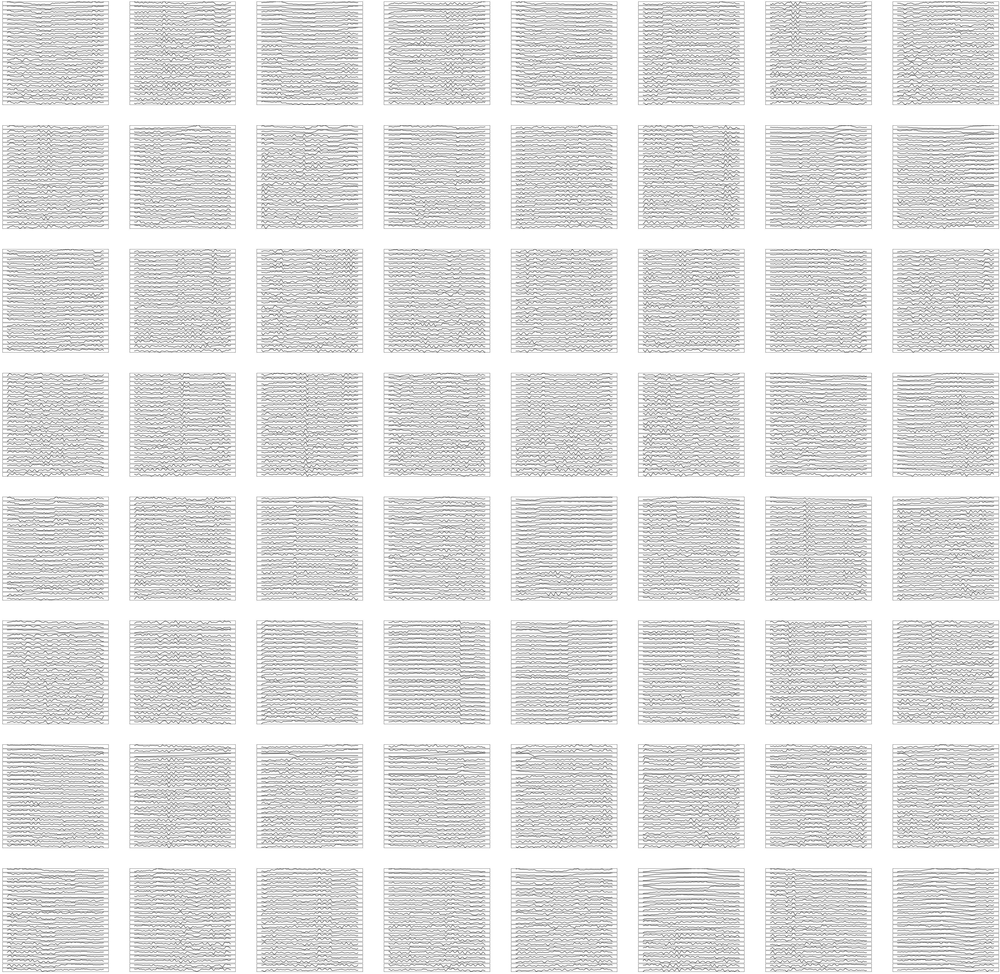

Error in callback <function flush_figures at 0x1554b25d9680> (for post_execute):


KeyboardInterrupt: 

In [15]:
# Load EEG data
path = './data/'
winLength = 2
numChan = 24
srate = 128
feature = 'raw'
one_channel = False

role = 'train'
train_data = load_data(path, role, winLength, numChan, srate, feature, one_channel)
print(f'X_train shape: {len(train_data)}, {train_data[0][0].shape}')
print(f'Y_train shape: {len(train_data)}, {train_data[0][1].shape}')

role = 'val'
val_data = load_data(path, role, winLength, numChan, srate, feature, one_channel)
print(f'X_val shape: {len(val_data)}, {val_data[0][0].shape}')
print(f'Y_val shape: {len(val_data)}, {val_data[0][1].shape}')
plot_EEG(train_data, feature, numChan, one_channel)

(array([10807., 13317., 13932., 10386.,  7695.,  5994.,  5265.,  2268.,
          907.,   810.]),
 array([ 5.016997 ,  6.7052014,  8.3934058, 10.0816102, 11.7698146,
        13.458019 , 15.1462234, 16.8344278, 18.5226322, 20.2108366,
        21.899041 ]),
 <BarContainer object of 10 artists>)

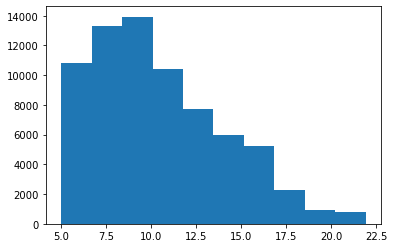

In [63]:
plt.hist(train_data[:][1])

In [32]:
# Initialize device information for PyTorch
USE_GPU = True

dtype = torch.float32 # we will be using float throughout this tutorial

if USE_GPU and torch.cuda.is_available():
    device = torch.device('cuda')
else:
    device = torch.device('cpu')

# Constant to control how frequently we print train loss
print_every = 100

print('using device:', device)

using device: cuda


In [49]:
def check_accuracy(loader, model):
    '''
    Check accuracy of the model 
    param:
        loader: An EEGDataset object
        model: A PyTorch Module to test
    '''
    if loader.dataset.train:
        logger.log('Checking accuracy on training set')
    elif loader.dataset.val:
        logger.log('Checking accuracy on validation set')
    else:
        logger.log('Checking accuracy on test set')   
    num_correct = 0
    num_samples = 0
    model.eval()  # set model to evaluation mode
    with torch.no_grad():
        for x, y in loader:
            x = x.to(device=device, dtype=dtype)  # move to device, e.g. GPU
            y = y.to(device=device, dtype=dtype)
            scores = model(x)
            print(f"label {y}, prediction {scores}")
            _, preds = scores.max(1)
            num_correct += (preds == y).sum()
            num_samples += preds.size(0)
        acc = float(num_correct) / num_samples
        logger.log('Got %d / %d correct (%.2f)' % (num_correct, num_samples, 100 * acc))
        return acc

In [50]:
def train(model, loader_train, loader_val, optimizer, epochs=1):
    """
    Train a model using the PyTorch Module API.
    
    params:
        model: A PyTorch Module giving the model to train.
        loader_train: A PyTorch DataLoader object containing training data loaded in batch
        loader_val: A PyTorch DataLoader object containing validation data loaded in batch        
        optimizer: An Optimizer object we will use to train the model
        epochs: (Optional) A Python integer giving the number of epochs to train for
    
    Returns: Nothing, but prints model accuracies during training.
    """
    model = model.to(device=device)  # move the model parameters to CPU/GPU
    mseLoss = nn.MSELoss()
    for e in range(epochs):
        for t, (x, y) in enumerate(loader_train):
            model.train()  # put model to training mode
            x = x.to(device=device, dtype=dtype)  # move to device, e.g. GPU
            y = y.to(device=device, dtype=dtype)

            scores = model(x)
            loss = mseLoss(scores, y)

            # Zero out all of the gradients for the variables which the optimizer
            # will update.
            optimizer.zero_grad()

            # This is the backwards pass: compute the gradient of the loss with
            # respect to each  parameter of the model.
            loss.backward()

            # Actually update the parameters of the model using the gradients
            # computed by the backwards pass.
            optimizer.step()

            if t % print_every == 0:
                logger.writer.add_scalar("Loss/train", loss.item(), e*len(loader_train)+t)
                logger.log('Epoch %d, Iteration %d, loss = %.4f' % (e, t, loss.item()))
        train_acc = check_accuracy(loader_train, model)
        logger.writer.add_scalar("Acc/train", train_acc, e)        
        val_acc = check_accuracy(loader_val, model)
        logger.writer.add_scalar("Acc/valid", val_acc, e)        
        logger.log()
        
        # Save model every 20 epochs
        if e > 0 and e % 10 == 0:
            logger.save_model(model,f"epoch{e}")
        elif val_acc >= 0.83:
            logger.save_model(model,f"valacc83-epoch{e}")
        elif val_acc >= 0.84:
            logger.save_model(model,f"valacc84-epoch{e}")
    # save final model
    logger.save_model(model,f"epoch{e}")
    return model

In [51]:
def create_model():
    '''
    Create the CNN following configuration in van Putten et al. (2018)
    '''
    model = nn.Sequential(
            nn.Conv2d(1,100,3),
            nn.ReLU(),
            nn.MaxPool2d(2, 2),
            nn.Dropout(0.25),
            nn.Conv2d(100,100,3),
            nn.ReLU(),
            nn.MaxPool2d(2, 2),
            nn.Dropout(0.25),
            nn.Conv2d(100,300,(2,3)),
            nn.ReLU(),
            nn.MaxPool2d(2, 2),
            nn.Dropout(0.25),
            nn.Conv2d(300,300,(1,7)),
            nn.ReLU(),
            nn.MaxPool2d((1,2), stride=1),
            nn.Dropout(0.25),
            nn.Conv2d(300,100,(1,3)),
            nn.ReLU(),
            nn.Conv2d(100,100,(1,3)),
            nn.ReLU(),
            nn.Flatten(),
            nn.Linear(1900,6144),
            nn.ReLU(),
            nn.Linear(6144,1),
        )
    return model

In [52]:
# Create and show model summary
model = create_model()
from pytorch_model_summary import summary
print(summary(model, torch.zeros((1, 1, 24, 256)), show_input=False))

-------------------------------------------------------------------------
      Layer (type)          Output Shape         Param #     Tr. Param #
          Conv2d-1     [1, 100, 22, 254]           1,000           1,000
            ReLU-2     [1, 100, 22, 254]               0               0
       MaxPool2d-3     [1, 100, 11, 127]               0               0
         Dropout-4     [1, 100, 11, 127]               0               0
          Conv2d-5      [1, 100, 9, 125]          90,100          90,100
            ReLU-6      [1, 100, 9, 125]               0               0
       MaxPool2d-7       [1, 100, 4, 62]               0               0
         Dropout-8       [1, 100, 4, 62]               0               0
          Conv2d-9       [1, 300, 3, 60]         180,300         180,300
           ReLU-10       [1, 300, 3, 60]               0               0
      MaxPool2d-11       [1, 300, 1, 30]               0               0
        Dropout-12       [1, 300, 1, 30]          

In [53]:
def test_model(model, test_data, subj_csv):
    '''
    Test model using two different metrics. First is per sample accuracy.
    Second is to use 40 samples per subject and perform voting:
        If mean prediction > 0.5, classify as female (1)
        Otherwise, classify as male (0)
    param:
        model: A trained PyTorch Module
        test_data: test dataset
        subj_csv: spreadsheet containing subject IDs for the test dataset
    '''
    # one-segment test
    logger.log('Testing model accuracy using 1-segment metric')
    loader_test = DataLoader(test_data, batch_size=70)
    per_sample_acc = check_accuracy(loader_test, model)

    # 40-segment test
    logger.log('Testing model accuracy using 40-segment per subject metric')
    with open(subj_csv, newline='') as csvfile:
        spamreader = csv.reader(csvfile, delimiter=' ', quotechar='|')
        subjIDs = [row[0] for row in spamreader]
    unique_subjs,indices = np.unique(subjIDs,return_index=True)

    iterable_test_data = list(iter(DataLoader(test_data, batch_size=1)))
    num_correct = []
    for subj,idx in zip(unique_subjs,indices):
    #     print(f'Subj {subj} - gender {iterable_test_data[idx][1]}')
        data = iterable_test_data[idx:idx+40]
        #print(np.sum([y for _,y in data]))
        assert 40 == np.sum([y for _,y in data]) or 0 == np.sum([y for _,y in data])
        preds = []
        correct = 0
        with torch.no_grad():
            for x,y in data:
                x = x.to(device=device, dtype=dtype)  # move to device, e.g. GPU
                correct = y
                scores = model(x)
                _, pred = scores.max(1)
                preds.append(pred)
        final_pred = (torch.mean(torch.FloatTensor(preds)) > 0.5).sum()
        num_correct.append((final_pred == correct).sum())
    #print(len(num_correct))
    acc = float(np.sum(num_correct)) / len(unique_subjs)
    logger.log('Got %d / %d correct (%.2f)' % (np.sum(num_correct), len(unique_subjs), 100 * acc))
    return per_sample_acc, acc

In [54]:
def run_experiment(seed, model_name, feature, loader_train, loader_val, num_epoch):
    '''
    Train a model for num_epoch given a random seed. 
    During training, logs and intemediary models will be saved in files accordingly to model_name
    param:
        seed: Int - Random seed number
        model_name: String - Name of the model to be saved. Used for logging
        feature: String - Whether 'raw' or 'topo'
        loader_train: DataLoader with training set
        loader_val: DataLoader with validation set
        num_epoch: Int - number of epoch to train the model
    '''
    model = create_model()
    logger.set_model_save_location(f'{model_name}-{feature}')
    experiment = f'{model_name}-{feature}-seed{seed}'
    logger.set_experiment(experiment)

    np.random.seed(seed)
    torch.manual_seed(seed)

    # toggle between learning rate and batch size values 

    optimizer = torch.optim.Adamax(model.parameters(), lr=0.002, weight_decay=0.001)
    model = train(model, loader_train, loader_val, optimizer, epochs=num_epoch)
    
    # Testing
    logger.log('Testing on balanced test set')
    test_data_balanced = load_data(path, 'test', winLength, numChan, srate, feature)
    sample_acc1, subject_acc1 = test_model(model, test_data_balanced, path + 'test_subjIDs_fewer_subjects.csv')

    logger.log('Testing on all-male test set')
    test_data_all_male = load_data(path, 'test', winLength, numChan, srate, feature,'v3')
    sample_acc2, subject_acc2 = test_model(model, test_data_all_male, path + 'test_subjIDs_more_test.csv')
    
    return model

In [56]:
# train model multiple times, each with different random seed
logger = Logger() # initialize logger to be used throughout

batch_size = 70 
loader_train = DataLoader(train_data, batch_size=batch_size, shuffle=True)
loader_val = DataLoader(val_data, batch_size=batch_size)
for s in range(1):
    model = run_experiment(s, 'original-ages', 'raw',loader_train, loader_val,70)
# model = run_experiment(9, 'original', 'raw',70)

05/05 04:13:45 PM Epoch 0, Iteration 0, loss = 131.2477
05/05 04:13:47 PM Epoch 0, Iteration 100, loss = 117.6911
05/05 04:13:49 PM Epoch 0, Iteration 200, loss = 54.4814
05/05 04:13:51 PM Epoch 0, Iteration 300, loss = 101.9112
05/05 04:13:53 PM Epoch 0, Iteration 400, loss = 15.8068
05/05 04:13:55 PM Epoch 0, Iteration 500, loss = 53.6326
05/05 04:13:57 PM Epoch 0, Iteration 600, loss = 27.7795
05/05 04:13:59 PM Epoch 0, Iteration 700, loss = 19.4019
05/05 04:14:01 PM Epoch 0, Iteration 800, loss = 18.3872
05/05 04:14:03 PM Epoch 0, Iteration 900, loss = 23.2987
05/05 04:14:05 PM Epoch 0, Iteration 1000, loss = 21.1216
05/05 04:14:06 PM Checking accuracy on training set
label tensor([ 7.2785,  8.6967,  9.6575,  5.0170,  9.4633,  8.1522, 10.5994, 10.7231,
        10.6322,  7.2319,  9.5864, 14.4903,  6.5753, 11.0216, 10.4711,  8.3164,
         8.6664, 21.0009, 10.1454, 14.0168, 13.1160,  7.6754,  6.3338, 10.7231,
         9.6794, 10.6104, 13.8168, 10.4215, 11.0813, 10.0881,  9.8388, 10

        [10.1919]], device='cuda:0')
label tensor([ 6.3393,  7.6754,  8.3543, 14.0168, 14.3476,  6.3309,  8.7136,  7.7363,
        13.7452, 10.1893, 11.0210,  7.1744,  9.5453,  7.8451,  8.0702, 21.8166,
         8.1879, 10.8328,  5.2195,  5.9292,  6.9608,  5.0414,  6.1806, 16.1216,
         6.4439, 12.0784,  8.2775, 17.3290, 10.0687, 10.5530,  7.6974, 12.7979,
         6.7340,  6.1367,  6.0136,  5.2140,  7.4652, 10.1723, 12.4366, 14.3536,
        12.4366,  7.8477,  7.2785,  7.0812,  8.0702, 13.7452, 10.6952,  8.8340,
        12.8826,  8.4398,  6.2277,  7.5603,  7.0955, 14.4903,  8.4667, 18.1339,
        15.5302, 11.9409, 13.1571, 13.8936,  9.8711, 10.4192,  5.0170, 13.6170,
         7.9524,  6.1700,  9.0526,  6.4681, 13.7812,  6.0545], device='cuda:0'), prediction tensor([[ 9.9521],
        [10.3340],
        [10.2404],
        [10.1575],
        [ 5.6615],
        [ 9.7593],
        [10.2796],
        [10.1335],
        [10.0653],
        [ 9.8459],
        [10.3814],
        [10.1321

label tensor([ 7.0812, 11.6013,  7.5057, 12.5433,  6.8184,  8.2373,  7.7219, 10.2983,
         5.2140, 13.1046, 10.1454,  7.2734,  7.8374,  8.2399,  7.0812,  8.2125,
        14.1920,  5.9646, 13.4363,  9.9100,  6.0114, 12.2996, 12.9046,  8.6118,
        13.6198,  7.8451,  8.6725, 20.4255, 11.0538, 14.4055, 18.0907, 14.4188,
        10.7231,  9.9178,  8.5268, 12.2536,  6.6979, 15.5828, 15.0874,  8.2775,
        13.4363,  8.9845,  9.3515, 17.2359, 11.1030,  9.1402,  6.9962,  5.7594,
         7.8477, 14.3536,  8.2373, 12.4999,  9.0366, 13.7452, 12.0784, 10.6547,
         6.8184, 15.2625, 17.7069, 13.4363, 14.7720,  5.2525, 17.5567, 12.3574,
         8.5848, 13.7757,  6.3727, 16.3106, 13.4171,  8.9101], device='cuda:0'), prediction tensor([[10.1943],
        [ 9.9137],
        [ 5.5493],
        [ 4.7066],
        [10.0213],
        [ 9.9900],
        [10.0972],
        [10.3841],
        [10.1896],
        [ 9.9857],
        [ 1.3065],
        [10.6756],
        [ 9.9598],
        [10.105

label tensor([16.0454,  7.8753,  5.8689, 12.2996,  6.2105, 10.2817,  9.1729,  6.6492,
         8.0258, 15.0295,  8.2284,  9.5864,  8.1546, 16.1380, 14.1072, 18.8211,
        20.4255, 12.3713, 14.1072,  7.1059, 10.7992,  7.4070, 11.4324,  7.9957,
         6.4433,  6.1453,  8.8778,  8.1572,  6.4681, 13.7812, 12.1632,  5.6603,
         5.5486, 11.8588, 10.5994, 15.1415, 14.8787, 15.1415,  7.2734,  6.6492,
         7.3030,  8.0373,  8.0888, 13.4193, 12.9901,  7.9930, 10.8328, 10.5861,
         7.5030,  6.3201, 16.9512,  6.9142, 11.4892,  7.1063,  8.5268, 13.6796,
         6.7280,  6.7280, 15.4864,  8.4233, 14.0027,  8.3900, 11.4541, 13.2114,
        10.9258, 10.5780, 11.5000,  5.2525, 10.2713,  8.8774], device='cuda:0'), prediction tensor([[10.1623],
        [10.2147],
        [ 9.9916],
        [10.0086],
        [10.9871],
        [ 9.6902],
        [ 9.9622],
        [10.5185],
        [10.1093],
        [10.0778],
        [10.3170],
        [ 9.9441],
        [ 9.9791],
        [ 9.986

label tensor([10.5780,  8.8012, 16.3220,  8.2399,  5.1620, 12.9107, 10.7992,  7.3824,
        11.1885, 14.1096,  7.3030,  6.6355, 13.8168,  6.9962, 15.7301,  5.2693,
         9.3261, 21.0009, 10.4789,  9.9204, 13.8168, 10.1235,  9.9178,  5.5672,
        17.2359,  7.4236,  8.3543, 14.8819, 16.3297, 17.3243, 13.8470, 13.0092,
        15.6124,  8.8476, 17.2359, 10.5530,  9.0366,  7.1935,  8.0373,  6.1367,
        14.6404, 10.1235, 12.5817, 13.1160, 13.3815, 20.4255,  8.4995,  8.8806,
         9.0086,  8.5350, 10.0438, 10.0687, 18.9723,  5.6439, 10.7992, 16.0449,
         5.3865, 12.1304,  5.4522, 16.3658,  7.9524,  8.2749,  5.2525,  8.0155,
        13.0934,  7.5877,  6.2105, 11.2568, 12.3844,  7.7219], device='cuda:0'), prediction tensor([[ 9.7499],
        [10.1827],
        [10.1214],
        [ 9.7687],
        [10.0127],
        [ 9.9685],
        [10.1064],
        [10.4537],
        [10.4317],
        [10.1630],
        [10.2706],
        [ 9.9410],
        [10.1376],
        [10.250

label tensor([ 8.2284, 13.0997,  6.9142, 11.1721,  5.7781,  6.9115, 11.6129,  7.8451,
         6.1453, 11.8916, 12.0811,  7.9524,  8.0915, 11.0216, 17.7069, 15.9163,
        10.1477,  9.4905, 17.7534,  9.0366, 13.0885,  5.7594, 10.1235, 13.6521,
        12.9402,  7.9164,  8.0039,  7.3830,  9.3103, 10.9256, 11.8319,  7.9086,
         9.1434,  5.3921,  6.1806, 13.8936, 10.1235, 14.3316,  9.8388, 11.1036,
         9.2748, 10.2740,  9.7074, 15.9163,  7.9164,  7.7525, 11.4596,  9.2747,
        10.2983,  5.2693, 17.7178, 13.1160, 11.6013,  9.5453, 11.1331,  8.7294,
         5.8847,  5.3126,  6.4433, 11.4541, 16.7048,  9.1598, 15.7193,  8.8774,
        10.9258,  9.8711, 16.0154,  7.2734,  7.3141, 13.9861], device='cuda:0'), prediction tensor([[10.1811],
        [10.1332],
        [10.1704],
        [10.0517],
        [10.0052],
        [10.1783],
        [10.2512],
        [10.0777],
        [10.3346],
        [ 9.9868],
        [ 0.5472],
        [10.1678],
        [10.1131],
        [ 8.126

        [ 9.9026]], device='cuda:0')
label tensor([16.9271,  8.0285,  9.6472, 10.6897, 10.0962, 11.6650, 14.9557, 11.0243,
         8.0805, 10.0881,  9.4308, 13.5486, 12.6664, 12.8065,  7.0211,  7.1475,
        14.9997,  5.8662, 11.1030, 16.9212,  9.9593,  5.4522, 12.6089,  5.6362,
         9.4009,  8.4700, 12.3630,  7.7005,  5.4446, 11.0293,  7.0211,  9.0526,
         9.2770,  9.0065,  8.1546,  7.6616, 12.8006, 12.4831,  9.2003, 14.9997,
         5.9888, 21.8990, 13.4414,  9.3349, 11.7276,  8.2968, 15.7246,  9.0333,
        10.0962, 16.0341,  9.7238, 10.4192, 13.3976, 12.9046,  6.0277,  6.4132,
         7.5030, 10.6104, 12.1304, 12.0784,  7.0373, 12.5433,  6.5747, 11.1797,
         6.7363, 15.4864, 16.4611,  8.9484,  7.0214, 12.1632], device='cuda:0'), prediction tensor([[ 9.8158],
        [10.1078],
        [ 9.9430],
        [ 9.8459],
        [10.0831],
        [ 9.8852],
        [ 9.8175],
        [10.2636],
        [10.1697],
        [10.1661],
        [10.1838],
        [ 3.4786

label tensor([ 5.1431, 14.8819,  7.0812, 16.1380,  9.2446, 11.9223, 13.3976,  8.0915,
        16.1380,  9.2196, 16.3220,  7.7302,  7.8533,  7.1361,  5.7594, 10.1235,
        12.1632,  5.0748,  8.8806,  7.5714, 14.0027,  7.1743,  8.5816, 13.6581,
        15.7936, 12.6533, 17.9401,  8.9845,  9.1023, 13.1790, 14.0027,  8.1879,
         8.0564, 12.4857, 11.4892, 11.0927,  7.4070, 14.8819,  9.1653,  7.5631,
        17.0718,  6.5419,  7.3030,  6.4110, 11.0680, 11.2568,  7.4350,  5.1431,
         8.5734, 16.3873,  6.3727, 16.9265,  6.3256, 13.3241,  7.0594, 13.0611,
        13.1133, 15.1804,  8.8558,  9.0086,  9.1264,  8.4369, 10.7582,  7.6457,
        11.2426, 17.4851, 14.4625, 12.3713, 15.7575, 17.4221], device='cuda:0'), prediction tensor([[10.3536],
        [ 9.9652],
        [10.0752],
        [10.1636],
        [10.0537],
        [10.0281],
        [ 9.9228],
        [ 9.6172],
        [ 9.9729],
        [10.6033],
        [10.0260],
        [10.0816],
        [10.2956],
        [ 9.856

label tensor([11.9601, 10.1454, 13.9861, 10.6897, 16.0756,  6.2277,  9.4636, 13.1133,
         8.1879, 13.4363, 15.1804, 12.4754,  5.2336,  8.9484, 14.4188,  6.9197,
        13.3976,  9.7074,  5.4304, 14.4626,  9.7183,  6.7614,  6.9142, 15.2653,
         6.3917,  9.5646, 10.0438,  6.9471, 12.3844,  6.9805,  9.8711, 13.1073,
        15.6316,  7.6974,  6.9744, 12.6089,  5.7836,  7.9524, 11.1113,  9.1729,
        10.6897, 17.7069, 15.2511,  8.0341, 15.7936, 16.3654, 11.5165, 15.6316,
         9.8388, 13.6796, 13.3459,  6.5008,  9.4905,  8.9490,  6.7363, 16.3494,
        10.6104, 11.4541, 14.4188, 16.7518,  6.4110,  7.9359,  7.2355,  9.1402,
        11.0896,  6.8354, 16.0837, 10.0687,  8.2284,  9.9178], device='cuda:0'), prediction tensor([[10.1836],
        [10.0225],
        [ 9.9656],
        [ 9.8857],
        [10.2022],
        [ 9.8535],
        [ 9.8523],
        [10.1304],
        [10.1168],
        [10.0058],
        [10.0054],
        [10.2747],
        [10.0976],
        [10.188

label tensor([ 9.2003,  9.7238,  5.4446,  8.4452, 16.0341,  7.8319,  8.7513,  6.9142,
         6.1453, 18.8211, 13.0092,  7.7525, 21.8990, 16.0756, 15.6239,  7.2355,
        17.2359, 12.5378,  8.8828, 13.3976,  7.2653,  6.0250, 14.9613,  5.9646,
         6.4132, 17.7069, 10.2740,  9.1264,  9.9400, 12.1304,  6.3091,  8.0373,
        17.4713,  6.5747,  7.4212,  6.3561,  5.0414,  8.2174, 10.3640, 12.8006,
        10.5090,  6.6355, 14.1920, 11.2426,  9.7456,  5.9888, 14.6656,  6.0763,
         6.9115, 11.7334, 10.5530,  5.2693,  6.0031, 11.9409, 11.2564,  7.1475,
         7.5253, 16.3654, 16.6725,  7.2785,  9.2523,  8.2775, 11.0927,  8.0044,
        11.1113,  8.1112, 10.7231,  8.5268,  7.3139,  7.0704], device='cuda:0'), prediction tensor([[ 0.4323],
        [ 9.8743],
        [ 9.8641],
        [ 9.9703],
        [10.1516],
        [ 9.9666],
        [10.0093],
        [10.1177],
        [ 9.9358],
        [10.0917],
        [10.1113],
        [10.3035],
        [10.1451],
        [10.189

label tensor([ 9.0284,  9.2770, 10.0881,  8.8253, 16.4062, 10.8239, 15.1825,  5.9292,
        13.1160,  9.8469,  5.1735,  5.4029,  9.7615, 16.7518,  9.2851,  7.5775,
         6.4681, 17.2610, 19.0621, 13.9149,  5.0532, 12.9977,  7.2296, 13.0997,
        12.5843, 10.0961, 14.6404,  9.5048, 11.6896,  5.4304,  9.1626, 10.5090,
        11.9223,  9.3349, 12.4831, 11.6650,  8.9101, 20.6643,  6.8184,  9.9400,
        12.8827,  6.7280, 10.7231, 10.6897,  7.1059,  8.4940,  6.9827, 16.7048,
        15.1415,  6.4625, 12.5297,  6.7614, 11.6129, 12.3686, 11.6896,  8.4940,
         6.0136, 17.3243,  5.8847,  9.2770, 11.0680,  8.0154,  6.6000, 12.6089,
        11.8840, 15.5828, 10.4384, 10.8328,  6.4625,  6.2494], device='cuda:0'), prediction tensor([[10.5094],
        [10.2859],
        [ 9.9394],
        [10.1447],
        [ 9.9646],
        [ 9.8935],
        [10.0355],
        [10.1470],
        [10.1529],
        [10.1100],
        [10.0688],
        [ 9.9300],
        [ 9.9314],
        [ 9.875

label tensor([13.5486, 10.1723, 19.2866, 12.5926, 21.5097, 14.4193, 13.1046,  6.9116,
         6.4132, 13.1073, 13.5486, 13.8685, 12.8065,  5.5535,  8.4749,  7.7363,
        12.5926,  8.8774, 14.8787, 12.6063, 11.0680, 14.8787,  9.0749,  9.9642,
        11.7055, 16.8362, 17.1242,  6.0763, 14.8458, 12.9402,  5.8689,  8.8800,
         8.4667,  8.4419, 14.0546, 17.4851, 12.4999,  6.0114,  9.5070, 14.6103,
        13.3954,  7.6754,  7.0594, 10.5692, 11.6891, 12.9901, 10.1477, 17.2359,
        11.6294, 11.1278,  6.3561, 14.4193, 11.6013, 12.6089,  9.1461,  6.6570,
        15.1804, 16.0394, 15.6316,  7.7302,  5.5131, 16.7574, 15.9163, 11.8840,
         6.3561,  6.3309, 14.4903, 10.5560, 11.9086, 11.1885], device='cuda:0'), prediction tensor([[ 9.9113],
        [ 0.4923],
        [10.1332],
        [10.0411],
        [10.8806],
        [ 9.9916],
        [10.1175],
        [10.0518],
        [ 9.9208],
        [10.0812],
        [10.4263],
        [ 9.9372],
        [10.6112],
        [10.061

label tensor([ 8.8558,  6.8354,  8.2968, 20.8203, 11.0813, 11.8752,  6.8130,  6.1367,
         9.9039,  9.0935, 17.1242,  6.6000, 10.6547,  9.6055, 10.7697,  8.0099,
         7.3824, 11.2344, 12.3574, 11.9601, 15.6075,  8.6725,  8.3981,  8.5327,
         7.6945,  9.1402,  6.2494,  6.3283,  9.9593,  9.5048,  9.1402, 16.3220,
        16.3654, 11.1036, 10.6190, 10.3640, 15.7301, 19.0621, 10.4057, 13.1790,
         5.6603,  5.2693,  6.6136, 13.6356,  8.2174, 13.5486,  7.8451, 14.5419,
        10.9312, 17.7178,  6.3091,  8.4967,  6.4439,  8.4452,  8.3823,  9.1434,
        14.6103,  6.0934, 15.3282, 16.9212,  5.3921, 11.6781,  8.7437, 17.5371,
        11.2426, 14.4193, 14.5419,  5.7836,  8.9490, 14.0243], device='cuda:0'), prediction tensor([[10.3343],
        [ 8.6749],
        [10.1868],
        [10.0048],
        [10.0023],
        [10.2849],
        [ 9.8164],
        [ 9.8548],
        [ 9.8468],
        [10.3089],
        [ 9.9805],
        [ 9.6490],
        [10.1676],
        [10.089

label tensor([ 5.8689, 14.0441,  8.5794, 11.1906, 13.0934, 16.0756, 11.1906,  5.0532,
         7.7363,  6.9805,  6.6984,  7.0730, 20.4124,  6.4110, 13.5043,  6.4625,
        11.9086, 11.0105, 11.8916, 16.4063,  8.1464, 10.4192,  8.8061,  8.4452,
        16.2699,  7.4870,  7.5030,  9.0065,  9.3569, 11.8752, 11.6129, 16.8362,
         9.3898,  8.0044,  7.2653,  6.5090,  9.9039, 11.9409,  8.0099, 10.6547,
         8.2067, 11.7055,  9.0749, 12.0811, 11.4892,  8.2373, 11.1721, 14.1729,
        16.0449, 11.2489, 13.8848,  5.6909,  8.1464, 13.6581, 13.0224,  9.5864,
        14.4193,  5.8689, 11.7334,  8.8828, 14.6405, 11.5827, 13.1790,  8.8806,
         8.0258,  8.3823,  7.4652, 13.4414,  6.2277, 15.6316], device='cuda:0'), prediction tensor([[ 9.9678],
        [10.0911],
        [10.2807],
        [10.3855],
        [10.5839],
        [10.0435],
        [10.0504],
        [10.4203],
        [ 9.9949],
        [10.0085],
        [ 9.9384],
        [10.2301],
        [10.3382],
        [10.091

label tensor([12.8065,  5.7594, 11.0927,  7.6945,  8.2563, 18.9805,  6.3561,  8.5268,
         8.6505, 11.6294,  8.7136, 14.6656,  9.5864, 14.5338,  7.4125,  8.7513,
        15.6239,  7.6951,  8.8253,  8.5848,  7.3830,  8.0341,  8.2124, 15.1825,
        14.4193,  8.6725,  5.6909, 15.6075, 10.0438, 12.6671, 21.3319, 10.6685,
        13.4774, 15.3282, 11.7055,  9.6575, 13.4774,  6.9829,  9.2031,  9.7533,
        12.5297, 11.9223,  6.9827,  8.4369,  8.8253, 12.9271,  8.9845,  6.5753,
        10.6104,  5.1735,  9.2748, 11.1962, 16.4146, 12.4857, 11.2344, 12.4063,
         9.9642,  9.5864,  5.4878, 16.9265,  5.3921, 11.3389, 14.4188, 13.7261,
         9.8798, 12.6089, 12.4063,  8.3194,  8.6505, 16.0756], device='cuda:0'), prediction tensor([[ 9.5922],
        [10.1757],
        [10.1550],
        [10.2750],
        [10.0611],
        [ 9.9111],
        [ 8.8909],
        [10.1573],
        [10.0948],
        [ 9.8323],
        [ 9.5423],
        [ 2.1312],
        [10.2868],
        [ 9.824

label tensor([16.9212,  8.0969,  7.3004, 17.2359,  7.2653, 17.3290, 10.9175, 13.0885,
         7.2734,  5.0558, 10.2736,  7.6151, 13.6796,  8.5302,  7.4652,  9.2523,
         7.5062, 13.4414, 10.0881, 13.8168,  9.6110,  8.7376,  9.2770, 15.3167,
        14.9557, 14.4626, 12.6500, 15.1415, 11.3385,  6.5753, 16.0756, 11.8319,
         9.3569,  5.1431, 12.4725, 10.1723, 12.1304,  9.4308, 15.0681, 16.4808,
         8.7245, 14.6404, 11.1962, 12.3713, 12.5986,  9.6575,  5.7979,  6.5397,
        13.1790, 11.0105, 13.8168, 11.9710,  9.1626, 13.6165,  6.6000, 10.8239,
        13.1790, 13.0885,  7.2734, 11.0216,  8.7513,  5.9646, 11.7276,  9.5864,
        13.6521,  8.3543,  6.5556,  8.0866,  6.4214,  6.0250], device='cuda:0'), prediction tensor([[10.4581],
        [ 9.8341],
        [ 9.9614],
        [10.0945],
        [10.0741],
        [ 9.9920],
        [ 9.9992],
        [ 9.9930],
        [10.0984],
        [10.0727],
        [10.0944],
        [10.1503],
        [10.1611],
        [ 9.885

label tensor([ 6.7614,  9.6110,  9.1461,  6.0222, 11.1030, 17.9401,  8.2968, 14.3316,
         6.2545,  7.5253,  6.4433,  8.4065,  5.2140,  8.0285,  5.3482, 12.5986,
         6.5753, 10.8929,  6.3283,  7.1281, 10.2983,  9.1729,  8.7980, 13.4582,
         6.1756,  5.6219, 12.6089, 12.5926, 14.6405,  9.4691,  9.4276, 11.6294,
         7.9657, 13.1046,  8.7157,  7.1361,  6.5556,  7.8319,  8.0039, 13.3954,
        14.4055, 16.3220,  8.6967,  8.1522, 14.5338, 11.1797, 15.4733, 10.4378,
         9.3569,  6.3283, 11.6151,  7.5775, 11.8916, 12.6671, 16.4611, 17.2715,
         5.0532, 16.0340,  9.7369,  9.8333,  8.2749,  9.0065, 16.7518,  7.0955,
        14.1096, 17.4851, 15.3282,  6.7280,  9.7238, 11.1606], device='cuda:0'), prediction tensor([[10.0816],
        [10.2661],
        [10.1169],
        [10.0793],
        [10.0636],
        [10.0534],
        [10.0588],
        [10.1145],
        [ 9.8223],
        [ 9.8754],
        [ 9.8429],
        [ 9.9250],
        [10.1772],
        [ 9.959

label tensor([16.0341, 17.3243, 13.4363,  8.3981,  7.4236,  8.2775, 14.0546,  9.5864,
        12.9271, 17.0230,  9.5048,  7.9081,  6.0031,  6.0655, 16.5684,  8.1879,
        11.9601,  8.0914,  7.5030, 11.8561, 12.4999, 11.1721,  9.3515, 19.0621,
         9.5048, 10.6104, 10.6815, 11.8840, 12.3713,  8.3653, 11.0293,  9.6055,
         6.0114, 12.1412,  6.5753,  8.1572, 10.5692, 14.7720, 11.2344, 11.8319,
        19.0621,  7.7985, 14.9175, 11.8232,  8.7294, 11.1606,  9.8798, 16.0449,
         8.8558,  5.3925,  7.1743, 13.5043, 13.8470,  9.0333, 11.1797, 14.1154,
         8.0285, 15.1415, 17.1242,  7.7219, 10.2713,  5.7068, 10.0496, 19.0621,
        11.6650,  5.6439,  7.9359,  8.7766,  6.6677,  6.5802], device='cuda:0'), prediction tensor([[10.0472],
        [ 9.8977],
        [ 9.9204],
        [10.3041],
        [10.0973],
        [ 9.8511],
        [10.1511],
        [ 9.9243],
        [10.0560],
        [ 9.9627],
        [10.1696],
        [ 9.9501],
        [10.4028],
        [10.263

label tensor([ 7.6616, 12.0811, 13.2114, 14.9613,  5.6219, 12.8827, 16.3494,  8.7766,
         9.0284,  5.0170,  9.8245,  7.7985, 16.5657,  6.6000,  6.3561, 16.0340,
        12.8450,  5.9292, 11.4541,  6.6984,  7.7363,  7.3004, 16.5684,  6.3864,
        10.1893,  9.3349,  8.2125, 17.5567, 14.3476,  9.3103,  8.1572,  9.0749,
        11.0238,  8.8336, 10.6815, 11.8916, 10.4384, 16.5684, 16.3494, 13.6356,
        10.9258, 16.0756,  6.6492, 18.9723,  8.5734, 11.0813, 16.1523, 11.2489,
         6.8403,  8.7437,  5.1620, 16.4062, 13.7757, 12.6533, 10.1893, 15.7301,
         8.7404, 14.7720, 21.8990, 11.0243,  8.9490, 13.0885, 10.5204, 15.7575,
         8.4667,  7.7985, 16.3658,  8.3823,  8.6725, 10.2687], device='cuda:0'), prediction tensor([[10.1587],
        [ 1.1824],
        [10.1793],
        [10.1549],
        [ 0.8317],
        [10.2558],
        [10.8180],
        [10.2021],
        [ 8.9702],
        [10.1226],
        [10.3343],
        [10.0568],
        [ 9.9825],
        [ 1.080

label tensor([ 8.6806, 15.2625, 16.0341, 12.4397, 11.8565, 14.3476, 16.5657,  8.4700,
        13.2606,  9.2858, 12.9402, 13.1790, 14.0546, 13.6170, 12.3630,  5.4446,
        14.1072, 14.9557,  6.7340,  9.9128, 15.1804,  9.1653,  6.1806,  8.0154,
         7.0214,  7.7985,  5.2693,  5.2195,  6.9805,  8.8609, 13.3459,  7.0894,
         5.2912, 11.6156,  6.9116,  8.4667,  8.8774,  8.3653, 16.0723,  8.4667,
         9.2523, 11.1278,  6.5008,  8.5794, 14.0027,  8.6583,  9.7369,  7.8477,
        14.6405,  6.1806,  9.9400, 16.3220, 10.1235,  8.8061,  7.9054,  6.5857,
         8.3981,  8.8340, 12.4831, 16.7158,  7.3824, 11.4324, 20.8203,  6.0114,
        10.7992,  6.5090,  8.8806, 11.4596, 11.1721, 14.4188], device='cuda:0'), prediction tensor([[10.2540],
        [ 3.1005],
        [10.0743],
        [10.0853],
        [10.0675],
        [10.0512],
        [10.0546],
        [10.1726],
        [10.4432],
        [10.0905],
        [ 8.3992],
        [ 9.9011],
        [10.1768],
        [10.041

label tensor([19.6567, 11.6151,  9.6110, 11.3385,  9.6575,  9.4686,  9.9593, 10.4789,
        11.1962,  6.0545,  7.4652, 16.9265, 14.7720,  7.6945, 17.5371, 17.5567,
        13.3241,  7.3004, 12.1820,  9.6472, 10.5228, 10.4215,  5.0558, 17.5371,
         7.1361,  5.5486,  5.6362,  7.0214,  9.0935,  6.3727,  5.8223,  6.0545,
        11.1331, 15.6316, 13.2114, 16.4967,  8.4995, 18.1339, 17.1762, 12.9107,
        11.8867,  8.8828,  7.6725,  6.0222,  5.0716,  7.2734,  9.5864,  9.9017,
        11.9164, 11.3385, 10.4215,  5.5979,  9.2851, 13.0934,  8.9490, 11.5165,
        14.1784, 13.6356, 13.4363,  7.0214,  6.3201, 12.4366, 10.2878,  7.4652,
        11.8232, 16.9271,  8.0154,  9.0935, 11.4596,  8.7404], device='cuda:0'), prediction tensor([[ 9.8847],
        [ 9.9637],
        [10.0045],
        [10.0205],
        [10.2873],
        [ 9.9384],
        [10.2454],
        [10.2209],
        [10.7158],
        [10.3379],
        [10.4235],
        [10.0284],
        [10.2023],
        [10.251

label tensor([ 9.4633,  8.9101, 18.8814,  8.1687, 10.9312, 11.0896, 16.3297,  6.9093,
        17.0718,  6.8184, 16.0454, 16.1216, 11.0927, 16.9271, 10.0438, 10.9256,
         9.0366,  5.7979, 14.9640, 13.6356, 16.0454, 17.3243,  9.6821, 15.3167,
         7.7219, 13.3954,  7.2920,  8.4369, 11.2564,  8.9813,  9.3103, 14.1072,
        11.2564,  8.2373,  5.3921, 11.7276,  9.2851,  5.2336, 12.3686, 14.8458,
         7.3824,  8.5794, 10.5861, 17.2610, 15.2511, 16.6227, 15.5828,  5.1735,
        13.0997, 11.8319,  6.9142,  8.8609, 10.5228, 13.6826,  6.1756,  8.3653,
         5.4522, 11.1749,  6.6979, 14.9557, 11.3385,  8.3900, 14.4193, 11.5827,
        10.4433, 15.2625, 16.4967,  7.9164,  6.1756, 14.1920], device='cuda:0'), prediction tensor([[10.3886],
        [ 0.9638],
        [10.0189],
        [ 9.8921],
        [10.4035],
        [ 9.9729],
        [10.0145],
        [ 9.8875],
        [ 9.9774],
        [10.1384],
        [10.0860],
        [10.2292],
        [10.2260],
        [ 9.837

label tensor([ 6.9608, 20.4255, 20.4124,  8.0373, 12.0127, 14.1784,  5.0360,  6.2494,
        12.5433, 14.3476, 10.1723,  9.0086,  6.8403, 11.7580,  6.6677, 16.4146,
         7.9359,  8.0044, 11.2564,  6.6984,  8.4452,  6.0114,  6.9805, 14.0168,
         7.4652,  7.1744, 16.9512,  5.8847,  8.4230,  6.1750, 11.0680,  8.2535,
         6.6979, 13.7757,  9.4636, 10.1482, 10.2687,  6.6979, 15.6124,  8.0258,
         5.7068, 13.5234,  6.3917, 11.6129, 10.3147,  5.8847, 11.6650, 10.8239,
         9.3103, 15.1804,  7.9081,  5.3126, 13.6826,  8.0155,  7.8287, 11.0813,
        19.7328,  7.0594,  6.2763, 11.2489, 12.7295,  5.6909,  7.4350,  9.9204,
        12.4063,  8.8774, 18.1290,  9.1022,  8.5350,  7.6457], device='cuda:0'), prediction tensor([[10.0184],
        [10.0389],
        [ 9.9087],
        [10.0520],
        [ 4.4632],
        [10.2198],
        [10.4336],
        [10.2818],
        [ 5.3743],
        [10.0097],
        [10.1532],
        [10.1548],
        [ 0.7365],
        [10.221

label tensor([17.0718,  9.6472,  6.6492, 11.1749,  7.8477,  7.8533, 21.3319,  8.5302,
         8.8778,  6.3612, 16.5684, 13.8936, 11.6650,  9.1620,  8.0039,  6.1453,
        10.8929,  8.5268, 13.0224, 11.2489,  8.5794, 16.9271,  6.0031,  6.5747,
         8.8806,  9.3898, 10.8239, 10.9312,  7.6725,  7.3141,  7.9524, 18.9723,
        10.9258, 12.5986, 14.6103,  7.9957, 16.0723,  6.4685,  5.7701, 16.4611,
         8.7376, 13.8685, 10.8239, 14.6656,  9.5453, 17.2610, 12.5297, 13.4363,
        10.4433,  7.7363, 12.8065,  9.2003, 10.2736, 15.5302, 13.7452,  7.0214,
         9.6110, 10.9256, 12.7295, 13.3976,  9.0749,  7.6754, 18.8814,  9.7615,
        10.2687,  5.8771,  7.0211,  5.1133, 13.3459,  7.6151], device='cuda:0'), prediction tensor([[ 9.8910],
        [10.1613],
        [10.3938],
        [10.0109],
        [11.0661],
        [10.1188],
        [ 9.9078],
        [10.4567],
        [ 9.6345],
        [ 9.2780],
        [10.0476],
        [10.2723],
        [10.0576],
        [10.161

label tensor([17.3460,  7.7985, 10.8239,  9.9287,  8.8774,  9.4905,  7.4125, 10.6897,
         9.1402, 15.6484, 18.0907,  7.7109,  6.0250, 11.2344, 12.0127,  5.3865,
        11.1030, 11.9710,  6.2105, 18.1339,  6.5747, 14.8787, 12.6254,  8.7136,
         5.7594,  6.9142,  8.0888,  7.3824,  5.1735,  9.7456,  9.0526, 11.0293,
        13.5486,  6.5857,  6.3256, 11.9164, 11.9601,  8.7245,  8.4967, 14.3476,
         8.6806, 15.1825, 18.8814,  6.0031,  9.2003,  9.1022, 17.0230, 13.4193,
        11.6294,  8.6806,  9.8711,  5.6302,  8.4452,  7.0373,  5.2912,  9.3261,
         9.4009,  5.1735,  6.9471, 10.0930,  9.9400,  6.9827,  9.7533,  6.6355,
         6.5008, 10.8320, 11.0813, 14.9997, 13.0224,  5.3399], device='cuda:0'), prediction tensor([[ 9.9937],
        [10.0175],
        [ 9.9265],
        [10.3516],
        [10.2275],
        [ 9.8804],
        [10.3204],
        [10.4418],
        [11.2305],
        [10.6899],
        [10.3015],
        [10.3211],
        [10.0722],
        [ 9.918

label tensor([14.4055,  8.4065,  5.7979,  6.4214, 11.1113, 13.1899,  7.0704,  6.8183,
         6.4681,  8.8012,  8.4452,  5.6302, 10.2740,  9.1434, 10.1477,  9.4721,
         6.6355, 11.2568, 16.5657,  8.5734,  8.0258, 14.4903, 10.5780,  8.8806,
         9.3569,  6.8130,  8.7245,  8.8662,  7.8451, 10.6897, 17.9401, 13.4193,
         7.5775,  8.8609, 10.7177,  8.8806,  9.5453,  8.7376,  7.9657, 11.6781,
         6.8354,  7.7302, 16.3658,  8.1572,  7.4815,  8.6967,  6.9471, 10.6104,
         7.2734,  5.6439, 14.3536, 10.1454, 18.9723, 10.1645,  6.2545, 16.0756,
         8.4967, 11.1962,  7.9053,  7.9930, 19.2866, 17.2610, 10.1893, 11.8565,
        10.6190,  8.5848, 11.8916,  8.8012,  8.0915, 11.1606], device='cuda:0'), prediction tensor([[10.0221],
        [10.2366],
        [ 9.9568],
        [10.0392],
        [ 9.9505],
        [10.0968],
        [10.1042],
        [10.0305],
        [ 9.9414],
        [ 9.8917],
        [10.1526],
        [10.2768],
        [ 9.9023],
        [ 9.917

label tensor([ 8.0866, 15.5828, 10.8320,  8.4452, 15.4017,  6.7340,  7.0955, 16.8362,
        21.0009,  9.8469,  8.9845,  6.4681,  5.5727,  8.8806,  6.0250,  9.0333,
         7.0594, 17.6636,  9.9122, 11.1010,  8.8340, 15.0681, 16.0454, 15.4017,
        14.9175,  6.0250,  9.9122, 16.3658, 16.8362,  7.0594, 10.3640, 10.1454,
        19.6567, 14.0243,  8.0341,  7.9957,  9.8333,  8.5327,  5.7594,  9.8245,
         6.0136,  5.5131,  9.2770,  6.4625, 12.4999,  7.0812, 13.4193,  5.7507,
        16.0340,  9.1653,  9.1023,  6.3091,  8.7294,  8.0969,  9.2523, 11.0976,
        16.1216, 14.8787,  9.5070, 12.8826,  7.5775,  5.9292, 16.0341, 10.2983,
        10.1482, 10.7286, 14.6656, 10.1723, 13.4582, 11.7334], device='cuda:0'), prediction tensor([[10.1547],
        [10.1281],
        [ 9.8463],
        [10.3609],
        [ 9.8347],
        [ 9.8074],
        [10.0988],
        [ 9.9857],
        [ 9.8923],
        [10.0285],
        [10.1665],
        [10.0708],
        [ 9.8231],
        [ 0.766

label tensor([ 8.5848,  7.9524, 11.8916, 16.0341,  5.3865, 14.8787,  8.0564,  9.2003,
         9.3569, 16.0723, 16.3220, 10.6322, 10.9312,  9.3103, 13.5043, 12.5986,
         5.7979, 12.8827, 11.4324,  9.5672, 11.0818, 10.5228,  9.1022,  8.4967,
         9.4636, 11.6151,  5.5486,  9.9122,  6.2844,  5.2475, 11.8319, 10.6190,
         7.1744, 11.7580, 15.1825, 21.5097, 16.4146, 21.8990, 19.7383, 15.3282,
         9.1022, 10.4433, 12.5378, 11.5000,  8.7513, 16.5684, 20.4124, 16.4146,
         8.5461, 12.1304, 16.4808,  6.3091,  9.1264, 17.6636, 13.3815,  6.9608,
        17.4851, 11.0680,  6.9744, 19.7328,  8.7520, 14.4188, 21.8196,  8.3823,
        16.0341, 10.5560, 15.6124,  5.6362, 15.4733,  6.7363], device='cuda:0'), prediction tensor([[10.1214],
        [10.3731],
        [ 9.9920],
        [ 9.9906],
        [10.0446],
        [ 9.9745],
        [10.4252],
        [ 9.7136],
        [ 9.9600],
        [10.0252],
        [10.0016],
        [10.0533],
        [ 9.9649],
        [10.411

label tensor([20.8203,  6.1453,  5.8689,  6.2277,  7.5030, 17.4851,  9.9593, 10.6104,
        21.5097, 11.1906,  6.3338,  9.4721, 10.0962,  8.0373,  7.1939, 14.1920,
         8.4398, 11.0105,  6.0250, 13.0611, 14.9997, 13.8685,  9.7615,  5.5672,
        14.4626,  9.1598,  5.8847,  7.6457,  9.2446, 21.3319, 10.6547,  5.0532,
         6.4433,  9.0086,  8.6013,  8.3823, 21.5097, 13.4363,  6.8354,  9.1598,
         8.8336,  7.4815,  9.9017,  5.5486, 11.1606,  7.0373,  7.8451, 10.6815,
        13.3815, 10.1723,  6.4110, 13.6198, 10.6546,  9.1264, 11.1010, 11.1906,
        20.8203, 15.6124,  6.0222,  7.3824, 21.3319, 15.1825,  6.0136, 10.5560,
         5.5486, 14.1065,  8.2124,  5.5979,  5.3921,  8.0285], device='cuda:0'), prediction tensor([[ 9.9178],
        [10.3793],
        [ 9.9812],
        [10.0746],
        [ 9.9757],
        [10.3835],
        [10.1367],
        [10.1922],
        [ 9.8068],
        [10.3470],
        [ 8.9489],
        [10.0045],
        [ 9.9641],
        [10.715

label tensor([ 7.3141, 13.0934,  7.9359, 11.7276,  6.2763, 10.4192, 13.5043,  5.0558,
        10.6815,  8.7520,  8.5461,  5.8662, 13.8685,  8.0702, 21.8196,  6.3612,
         6.1750,  5.1735, 10.0825, 15.4317, 16.7574,  5.0360,  8.4233,  7.1743,
        12.1820,  7.8753, 15.5302, 20.8203, 11.1331, 13.5043, 14.6405,  9.8717,
         8.1546, 12.7295, 14.6103, 13.0611,  8.6039,  6.3835, 10.1887, 10.9120,
        15.1825, 12.4754,  9.4691,  8.5816, 11.9710,  9.3569, 16.4967,  6.9093,
        13.0224,  9.5864, 11.9710,  9.4112,  6.1806, 16.7158,  5.3865, 12.8826,
        13.7452,  9.7238,  6.3256,  7.7005,  9.3126,  5.0748,  5.9292, 14.8458,
         7.7140, 14.3476, 14.1154, 14.6656,  7.6754,  8.8806], device='cuda:0'), prediction tensor([[10.1506],
        [ 9.9966],
        [ 9.2132],
        [10.1847],
        [ 9.8732],
        [ 9.9426],
        [ 9.1694],
        [10.4052],
        [10.2666],
        [10.1689],
        [10.0395],
        [ 9.9781],
        [ 9.9977],
        [ 9.844

label tensor([ 9.7456, 10.2736, 11.6129, 15.2625,  5.7594, 17.4713,  7.3139, 10.6546,
         5.5810,  6.0250, 10.8929,  7.6616,  9.4691, 16.4146,  8.5268, 15.7193,
         8.3741, 10.0825, 13.8685,  6.0763,  7.1935,  6.3201,  7.9054, 13.4774,
         5.7068, 19.7932,  9.1729,  9.7369,  7.1743, 14.4055, 17.6636,  6.1806,
        14.1065, 11.1749,  8.4419,  6.3309, 19.7328, 11.6891,  8.7157, 13.4582,
        10.2740,  6.9115,  9.6794, 10.2817, 17.0230,  7.3830,  7.3830,  5.5979,
        16.3654, 11.0704, 16.0449,  8.9484,  6.9805,  7.2734,  8.2968,  8.1546,
         9.3349,  6.4685,  5.6302,  6.7061,  7.2785, 16.0154, 14.4188, 14.1784,
         9.4636, 13.3954, 11.0680, 15.6124,  6.1806, 12.6089], device='cuda:0'), prediction tensor([[10.0766],
        [ 9.9312],
        [10.0169],
        [10.4329],
        [ 9.9458],
        [10.0450],
        [10.0080],
        [10.0068],
        [10.0760],
        [ 9.9718],
        [10.0030],
        [10.6783],
        [10.1989],
        [10.084

label tensor([13.6796,  9.3515, 14.5205, 11.0896,  7.2296, 15.6484,  7.1743, 12.6664,
        14.9175,  7.5877,  9.9100,  6.0545,  8.7980,  7.5057,  5.4029, 13.6796,
        13.0934, 21.8990,  5.5535, 13.6165,  6.1394,  8.9813,  7.1063,  7.7985,
         8.0914,  7.9359,  8.9845,  5.3126,  8.2174,  7.9053, 11.1030, 17.3460,
        12.3574, 12.2454,  8.3981, 16.0756,  6.7614, 16.0449, 12.9271, 16.0837,
         9.2003,  8.7136,  6.3091,  7.3714,  8.2067,  7.6945, 11.0538,  8.9845,
        13.4363, 12.2536,  6.3917, 15.4733,  9.3898, 16.1380,  9.0366, 17.7069,
        16.0756,  9.8388, 12.9977, 11.8840,  6.3864,  8.7157, 11.7580,  7.1743,
        14.8819,  5.2195, 12.4397,  8.7601, 10.1887, 12.4857], device='cuda:0'), prediction tensor([[10.1219],
        [10.0530],
        [10.0856],
        [ 8.5175],
        [10.1945],
        [10.3606],
        [10.1645],
        [ 9.9756],
        [10.0050],
        [ 6.9495],
        [10.0982],
        [ 9.7987],
        [10.1086],
        [ 8.178

label tensor([17.7069, 10.6104,  7.9359, 11.9710, 10.5861,  6.9608,  6.3612, 16.0454,
        11.9601,  9.2858,  9.1022,  9.6110, 11.3385,  5.1620, 10.5560,  8.5302,
        12.3844, 16.7048,  8.0702, 16.1523, 19.6567,  5.1403, 17.3290, 10.9120,
        13.3954, 10.5692,  8.7136,  8.5734,  7.2920, 10.5228,  7.4236,  7.0812,
         7.9086,  8.0044,  6.9854,  7.9081,  5.8169,  6.1367,  8.8828, 16.0449,
        11.8867,  9.4308,  8.9484, 11.1606,  9.7369, 10.6546,  8.0313, 17.0230,
        16.0723, 11.8232,  7.3824, 16.0449, 15.6075,  6.6492,  8.6583, 11.6156,
         9.7074, 20.8203, 14.1723,  5.8847, 11.5165,  8.3194, 10.5228, 10.3147,
        14.6405, 19.2866,  5.4029,  6.1756, 12.4725,  7.4815], device='cuda:0'), prediction tensor([[ 9.8584],
        [10.2383],
        [10.1437],
        [ 9.9834],
        [10.1748],
        [10.1581],
        [ 6.3764],
        [ 9.8736],
        [10.0030],
        [10.2872],
        [10.0720],
        [10.1203],
        [10.0007],
        [10.006

label tensor([ 6.8130,  8.5542,  8.0702, 11.8561, 13.7452,  7.3030,  5.6909, 13.2114,
         7.9054,  8.6725, 14.2331, 10.7286,  8.4233,  5.7507, 13.8168, 11.6896,
        11.3385, 14.1096,  5.6219,  5.0170, 15.3167, 14.8787, 15.6124, 13.5234,
         6.9093,  9.2446,  8.5327,  9.9017, 20.4255, 16.0723,  6.1700, 15.1804,
        10.4057, 11.2568, 15.1415,  5.1403, 17.1242,  8.3111,  7.4652,  7.7525,
        11.1030, 10.5780, 14.3536, 15.9163, 11.6151,  8.8609,  7.7109, 14.3536,
         8.3900,  8.8340,  5.8771, 14.1920, 16.3106, 11.0896,  8.7766, 16.9512,
        13.0092, 13.0611, 11.7334, 10.1723,  8.0313, 14.7446, 13.6170,  7.1935,
         8.9490, 15.6239, 13.8470,  7.0214, 10.3640, 11.5165], device='cuda:0'), prediction tensor([[10.0207],
        [ 9.9051],
        [ 9.8509],
        [10.1874],
        [10.0171],
        [10.4508],
        [ 9.8935],
        [10.0607],
        [10.8097],
        [10.1160],
        [ 9.9193],
        [10.0354],
        [ 9.9755],
        [10.799

label tensor([ 7.0594, 12.1412,  9.0366,  7.2785,  8.8828,  8.0258, 16.4062, 11.4596,
         8.7157,  9.6110,  9.2748,  9.0065, 11.4596, 10.0496, 21.3319,  7.9359,
         6.9829,  6.1756, 15.1804, 11.1113,  9.9100, 12.0811,  7.3004, 16.4062,
        10.1645,  6.9115, 11.2564,  5.5535, 10.2713,  7.8397, 16.9212, 10.3640,
        15.1804, 14.0546, 16.3494, 11.8429,  7.5714, 10.1482, 13.1571, 16.1380,
         9.6575,  6.6979,  8.0888, 15.5828, 18.1339,  9.2639,  6.9093, 11.3389,
        13.0092, 13.0934,  5.5727,  5.8847, 10.5994,  8.7376,  9.2003, 15.1804,
         5.7507, 11.1775,  9.3103, 11.7580, 13.9149,  8.8778, 14.6103,  8.5302,
        12.4857, 11.6129,  8.1522,  8.0155,  8.2749, 13.4582], device='cuda:0'), prediction tensor([[ 5.4076],
        [10.0059],
        [ 9.9780],
        [10.1660],
        [ 9.8620],
        [10.2808],
        [ 9.7877],
        [10.2693],
        [10.0089],
        [10.1624],
        [10.3323],
        [10.1988],
        [ 9.8881],
        [10.216

label tensor([10.7286,  6.3338,  7.3141, 11.1775, 10.4378,  7.3824,  6.1750, 13.0611,
        16.3654, 10.1723,  8.0285, 17.7534, 10.2740,  9.6110, 16.0723, 11.0243,
         9.0284, 14.0546, 12.5843, 10.7582,  7.4870, 12.6671, 10.1482, 13.4414,
         5.5535, 11.6156,  5.2525,  6.5008, 15.4317,  8.2399,  5.3921, 15.9163,
        13.4774, 11.8916, 14.0168, 12.5926,  8.5268,  6.6136, 11.0216,  6.3309,
         6.3283,  8.8827, 16.0340,  9.5070, 15.0211, 16.0341,  9.9204,  9.7238,
         7.2734,  8.6725,  9.8333, 10.5204,  5.0170,  8.2067,  8.8336, 17.4851,
         6.9854, 13.8848, 11.2489,  9.9593,  8.6013,  8.6039,  9.4308, 19.2866,
        10.4789,  8.8253,  8.2174,  9.7485, 13.0092, 11.2489], device='cuda:0'), prediction tensor([[10.0832],
        [ 9.8025],
        [10.0098],
        [ 9.8217],
        [10.1377],
        [ 9.8289],
        [ 9.7252],
        [10.0568],
        [10.0928],
        [ 8.6666],
        [ 9.8877],
        [ 0.5980],
        [ 9.9155],
        [ 9.969

label tensor([11.0238, 10.2817, 14.1920,  7.1063,  8.8806, 15.1415,  8.7980, 16.2699,
         8.8336, 15.7936,  5.7781,  9.5070,  9.1023,  6.0031, 14.0546, 13.6439,
         5.3865, 12.4831, 12.5817,  8.3194,  5.2140,  6.1756, 10.4057, 13.9149,
        13.1046, 19.7932,  7.7005, 16.4063, 10.6547,  8.0969,  6.8874,  9.6055,
         7.7985,  9.3372, 12.2454, 13.2606,  8.0702, 16.1380,  8.8340,  9.2770,
         7.3030,  6.1700,  8.8476, 12.5378, 11.0819, 10.2817,  6.6570, 16.6227,
        12.1412, 14.3476, 12.3713, 20.8203,  8.5302,  8.1687, 10.2878, 12.1304,
         9.2770, 16.0154, 16.0154, 10.5994,  7.7109,  8.7245,  9.2858,  9.1264,
        15.6316,  7.4212, 11.4541,  5.5810, 14.9640,  7.9930], device='cuda:0'), prediction tensor([[ 9.9503],
        [10.1040],
        [ 9.9871],
        [10.2052],
        [ 1.9668],
        [ 9.9778],
        [ 9.9539],
        [10.0679],
        [10.2165],
        [ 9.9728],
        [10.3958],
        [ 9.9350],
        [ 9.8129],
        [ 9.904

label tensor([ 6.6000, 12.8450, 12.5297,  6.2545,  7.5603,  7.6945,  6.0821,  8.7157,
        16.0154,  6.9854, 14.4626, 13.7812, 11.6781,  8.7376,  7.7140, 12.8827,
        11.0704, 15.2625, 15.6484, 11.7276,  9.9287, 11.4324,  5.0414, 10.7231,
         5.6302,  7.3714,  7.9657, 14.4625,  6.8354,  8.9813, 13.3241, 10.7177,
         9.3103, 11.9164, 16.0756,  9.1598,  5.4029, 10.5228, 17.3290, 15.7246,
        12.6671,  8.0915, 11.8752, 16.0394,  6.8184, 21.0009, 10.0962, 20.4124,
         5.3126, 16.0367, 16.7518,  7.4870,  8.1572, 12.3713,  8.0341,  6.8130,
        15.0681,  8.0313,  9.7369, 15.1804,  6.2277, 13.1073,  8.0313, 13.2114,
         6.3727, 16.3658,  7.4350,  9.8333, 12.0127,  9.0284], device='cuda:0'), prediction tensor([[ 9.3807],
        [ 9.9105],
        [ 0.3342],
        [ 8.1572],
        [11.3198],
        [10.0987],
        [10.2669],
        [10.0264],
        [ 9.9601],
        [10.0614],
        [10.0305],
        [ 9.8669],
        [10.0246],
        [10.102

label tensor([ 9.2770,  9.4721, 15.4017, 11.6781, 15.7936, 10.0438,  8.4940, 17.5371,
         8.3653,  8.2124, 11.0210,  5.2336,  5.4029, 18.1339,  6.0763, 14.1723,
        11.1721, 10.6815,  7.3004,  5.8689,  5.3126,  7.5631,  9.6794, 16.0340,
         5.3921,  6.5008,  5.2140, 11.9601,  7.1744, 12.0784,  8.6013,  8.0888,
         6.9116,  9.4276,  8.8806, 10.1235, 10.0496, 11.3172, 19.6567,  6.9829,
        15.6075,  7.2785,  6.7363, 10.8320, 12.9046,  8.8806,  9.0284,  9.2196,
        11.1331,  9.5646, 14.1154, 12.5433,  6.6355,  7.6754,  9.4414, 10.5228,
         5.4029,  9.8333,  5.0716,  8.7404, 12.3686,  7.7140, 11.8840, 15.0211,
        10.3147, 10.0930,  9.8711, 17.1242,  6.4681, 10.0496], device='cuda:0'), prediction tensor([[10.6415],
        [ 9.9948],
        [ 9.8450],
        [ 9.9091],
        [ 9.9590],
        [10.0638],
        [ 9.9570],
        [10.1437],
        [ 9.6542],
        [ 9.8434],
        [ 9.9363],
        [10.4447],
        [ 9.8626],
        [ 9.886

label tensor([ 6.5337,  7.9524, 11.6151,  8.9052, 12.4857,  9.0065,  7.3714,  9.2031,
        13.1160,  5.7123,  8.8012, 10.1482,  8.5350,  7.8287, 10.1235,  9.0526,
        17.2359,  7.6951, 10.2817, 17.4221, 11.1036, 16.8362, 15.6075,  6.0934,
         8.0866,  5.0360,  8.2124,  5.2195, 17.4851,  7.3776,  6.2844,  9.2858,
         9.9373,  5.2140, 15.0211,  9.6821, 11.1885,  7.7985,  5.4522,  9.3103,
        15.0295,  9.8333, 11.7580,  8.7245, 12.6063,  9.1434, 11.8867,  8.3194,
        13.5234, 18.9723,  7.2355,  7.3141,  8.0805,  8.1988,  9.4276,  8.0373,
         9.0086, 14.4188, 18.9723,  7.6951, 14.0243, 17.0718,  7.8753, 11.1962,
         9.3103, 10.5530,  6.3283, 14.1065, 11.6151, 18.8211], device='cuda:0'), prediction tensor([[10.1631],
        [10.0331],
        [10.0230],
        [ 9.9215],
        [ 9.9214],
        [10.2783],
        [10.1259],
        [10.1781],
        [ 9.9808],
        [10.0380],
        [10.1846],
        [10.0779],
        [10.1097],
        [10.137

label tensor([ 5.8689,  9.4691, 11.8840, 16.7048, 10.9175,  6.9829,  5.5535,  6.4681,
        19.7932, 10.5994, 19.0621,  8.0341,  9.2523, 13.4582, 16.4146,  7.5062,
         8.2749,  8.0341,  6.2105,  8.5302, 12.2536,  8.7136,  6.9962,  5.8223,
        11.1906,  5.3482,  7.1743,  7.4212, 11.0704, 11.7334,  7.0214, 11.3389,
         6.4681,  8.5848,  8.5848,  7.0812,  8.0564, 11.6129,  9.8469,  9.6110,
         6.3612,  8.7980,  9.1729, 14.1723,  7.8397, 13.8470, 12.6533,  7.5714,
         5.6909,  8.5542, 16.0367,  9.8717,  6.1700, 11.1775, 13.1133,  9.8245,
        11.8429,  6.8403,  8.9484, 16.3795,  6.5419,  5.8847,  6.0136,  6.1367,
         8.7157,  5.4878, 16.0367,  6.4681, 19.7328,  6.5857], device='cuda:0'), prediction tensor([[ 9.9864],
        [ 9.9146],
        [ 9.9770],
        [10.2834],
        [10.1523],
        [ 8.5986],
        [10.1324],
        [ 8.1014],
        [ 0.5466],
        [ 9.9281],
        [10.0413],
        [ 9.9152],
        [10.0229],
        [10.131

label tensor([ 9.0065, 12.3630,  8.0915, 11.9409, 16.5684,  6.1947,  6.0763,  8.0915,
         9.9178,  5.4878,  5.0969,  6.1700,  5.6219, 10.8239,  9.9017,  9.3126,
         7.7745,  8.5302, 12.0127, 12.9107, 13.6439,  8.0155, 10.9120, 12.7979,
        17.1242,  7.3830,  9.0086,  8.7980,  8.5350, 10.3912, 10.1477,  6.7614,
        11.8916,  7.1361,  6.6570,  9.2523, 11.6891, 16.0837,  7.4125, 15.5302,
         7.7985,  7.9930, 13.5043, 14.0441, 17.2359, 18.8211, 16.4146,  6.6984,
         8.8828,  6.4439, 17.0718,  8.0702,  8.1112,  8.8800, 20.4124, 12.5843,
        13.6165,  9.2639, 13.5043,  6.1806, 10.1235,  6.0114,  7.3824, 14.2331,
         7.1744,  8.7520,  7.9957,  5.2036, 15.6484, 11.0813], device='cuda:0'), prediction tensor([[10.4698],
        [10.0599],
        [10.0600],
        [ 9.9805],
        [ 9.9784],
        [10.4680],
        [ 9.9962],
        [ 5.3899],
        [10.0883],
        [10.2986],
        [10.0481],
        [ 9.8361],
        [ 1.4193],
        [ 9.889

label tensor([ 6.2277,  9.5864,  6.3309,  8.4967, 13.0885, 12.5926, 10.7642,  5.0716,
        14.5117, 17.4713,  7.6951,  6.2494,  7.3830, 14.4193, 14.4903,  7.8477,
        12.1820,  6.1367,  8.7102,  8.5461,  8.4369, 11.3172,  7.5603, 17.2715,
        14.4626,  7.4815,  9.6110,  6.4433,  8.0702,  8.7601,  6.8130,  5.5810,
         9.9287, 15.0874,  5.0558, 15.7936, 11.9164, 10.7286,  6.4214,  9.1626,
         7.8451, 11.1331, 10.8328,  9.9593, 11.1113,  6.8354, 16.9271,  8.0155,
         9.5864,  9.1434,  5.8771,  7.0812,  8.8253,  8.9101,  6.0222,  7.0594,
         8.8609,  6.5419,  6.5802, 14.4626,  9.2851,  8.1879, 14.1729, 13.6796,
        16.9212,  5.0360, 13.7725,  8.4967, 14.1065, 10.7697], device='cuda:0'), prediction tensor([[ 9.8564],
        [ 9.9125],
        [ 7.8277],
        [10.0250],
        [10.0311],
        [10.0821],
        [10.1572],
        [10.2458],
        [10.0555],
        [10.1244],
        [10.2145],
        [10.1775],
        [10.1282],
        [10.024

label tensor([ 6.4110,  6.0934,  7.8451, 11.4541, 11.6781,  9.9373,  7.2785,  9.2446,
        13.6170,  5.9888, 10.6190, 11.9710,  6.8403, 10.6815,  5.1403, 13.1073,
        16.6227, 15.4317, 11.1113, 16.9271,  5.7979, 11.0927,  8.0341,  8.6118,
         7.9930, 11.6151,  8.8828,  6.8184,  7.3824,  9.1022,  6.9805, 13.6198,
         9.9178,  6.6492, 16.0367, 14.9613,  9.8388, 16.0340,  8.9484, 15.7658,
        13.6356,  6.9116,  7.5253, 10.9175, 11.9223,  5.7781,  5.7836,  8.3900,
         8.8012,  6.0545,  9.0749, 15.1415, 13.8685,  6.9093,  7.5057,  6.3727,
        11.1010, 11.6891,  7.6945,  8.3981,  9.9400,  6.0821,  7.7363, 13.6439,
        11.6013,  8.8340, 13.6439, 16.9512, 14.8458,  6.6984], device='cuda:0'), prediction tensor([[ 9.9559],
        [13.8384],
        [10.0317],
        [ 9.8347],
        [10.3622],
        [ 9.8074],
        [10.2799],
        [10.2222],
        [10.0300],
        [10.0935],
        [10.2675],
        [ 9.9367],
        [ 0.6193],
        [10.129

label tensor([ 9.6821,  7.5030,  9.0065,  8.1522,  6.3256,  7.6951,  6.6000,  6.5747,
         7.6616,  9.2639, 12.3844, 11.6650,  5.2912, 13.4363,  8.4065,  7.6945,
         9.4636, 11.6650, 10.4215, 10.9120,  7.8753, 14.7720, 13.3976,  5.7594,
        17.7069, 12.6063, 19.7328,  7.3141,  5.3921, 19.7328, 11.4541, 14.5117,
        10.7642, 11.0927, 10.5780, 16.6725, 15.5302,  8.8806,  8.5734,  7.7985,
        16.7518, 15.4864, 17.9401,  8.1687, 11.3389, 12.4857,  8.6505, 13.1571,
        10.2713, 11.0818, 15.6484,  7.0373, 11.7580, 11.7661, 16.0837,  9.7369,
        11.1721, 11.0293, 12.0784, 16.3795,  7.4098, 17.3290,  6.3561, 19.2866,
         6.9471,  5.3482,  7.1281, 11.6129,  7.8397, 10.7642], device='cuda:0'), prediction tensor([[10.2580],
        [ 9.9395],
        [10.0875],
        [ 9.8443],
        [10.4591],
        [ 9.8097],
        [11.1898],
        [10.3020],
        [10.3058],
        [10.3752],
        [10.0680],
        [ 9.8683],
        [10.0577],
        [10.044

label tensor([ 8.0155, 11.1331,  7.4070,  6.5090,  9.5070, 11.3172, 11.6896, 13.4171,
         6.0934,  8.9490, 15.2511, 11.9086, 16.0756,  5.0969,  7.8533, 10.4711,
         9.9178, 14.1096, 12.4999, 11.2426, 10.7286, 11.1962,  6.6677,  8.8774,
        12.1820,  7.4070,  7.9657,  9.0065,  7.8374, 10.5861,  8.3164, 12.1304,
        11.0210,  7.6945,  9.0333, 14.4626,  8.8827,  5.8169,  5.5672, 12.3844,
        11.8588,  9.6575, 10.5560, 10.2983, 17.2715, 17.5371,  6.1394,  7.0704,
        16.1928,  6.9805,  6.5008, 10.7286,  9.4721,  8.3900,  8.4940, 11.0293,
         8.8806, 11.3385, 12.9107, 13.8848, 17.9401, 13.7725,  6.5802,  8.8806,
        11.1036, 13.5043,  7.1744,  9.4686,  5.8771,  8.6725], device='cuda:0'), prediction tensor([[10.0588],
        [ 9.8879],
        [ 3.1636],
        [10.1466],
        [ 9.8857],
        [10.2117],
        [10.0959],
        [ 9.2650],
        [ 9.1450],
        [ 9.8404],
        [ 9.9706],
        [10.0266],
        [10.0404],
        [10.030

label tensor([10.8328,  6.4110, 13.1073,  7.3830,  6.3309,  6.5753, 10.1235,  8.8806,
        16.3873, 10.8929,  9.3898, 13.1133,  6.5397, 16.7574,  7.9359, 10.7642,
        10.5560,  6.0277,  9.0826, 13.1073,  6.7363, 11.8916, 11.5827,  8.3653,
         6.9829, 15.2625,  5.6909,  8.2535, 16.1380, 17.7178,  9.9204, 16.6227,
        16.6725, 11.7661,  7.9957,  6.0136,  6.6979,  6.0655,  7.1281,  6.8183,
        13.7812, 10.5530, 11.0210, 16.7158,  6.6136,  8.8609, 11.6891, 10.3640,
        12.6063,  5.4522, 10.1482,  8.2373,  9.9122, 17.4713, 18.8814, 13.4414,
        11.2489, 10.6546, 14.1065, 13.0092,  5.4522,  7.0211,  8.4967,  7.4070,
         8.3543,  9.2940, 10.5994,  5.3921,  7.6945, 11.1962], device='cuda:0'), prediction tensor([[10.0995],
        [10.1545],
        [10.2101],
        [10.1639],
        [ 9.9945],
        [10.2821],
        [10.3875],
        [10.3829],
        [ 9.9380],
        [ 2.2927],
        [10.1634],
        [ 9.8959],
        [ 9.9378],
        [10.136

label tensor([ 8.4940,  9.9039,  8.3823,  5.2336, 12.6671,  8.4967, 10.2687,  7.8319,
         8.3111, 13.3241,  7.4212,  8.1879,  8.8800,  8.3741, 10.2817, 11.5827,
        10.6547,  7.1743,  9.3103,  6.5337,  9.6110,  7.2785,  9.0526,  5.5535,
         7.7525, 11.3419,  6.7061, 13.0092, 13.4414, 11.0896,  8.0155, 16.6725,
        17.1242, 13.6581,  8.1464,  6.4433, 11.0293,  5.2525, 13.1160, 12.5986,
         7.4070, 13.3815, 13.7261, 10.7286, 16.6227,  5.3126, 11.0216,  8.0341,
        14.6103,  8.5110, 11.1278, 15.7193,  5.2475,  8.3194, 12.0784, 11.4596,
         5.2036, 12.6089,  8.4700, 10.4711, 12.1820, 13.6439,  8.8558,  9.0749,
        17.5371, 16.0837,  9.1461,  7.6151, 12.8450,  8.0969], device='cuda:0'), prediction tensor([[10.0248],
        [ 9.8573],
        [ 9.9950],
        [11.1407],
        [ 9.9576],
        [ 9.9984],
        [10.2867],
        [10.1563],
        [ 9.8986],
        [ 9.9630],
        [ 0.8022],
        [ 8.9622],
        [ 9.8569],
        [10.263

label tensor([12.6254, 11.0680,  9.4691, 10.8929,  7.9054,  8.2775,  6.6979, 15.4017,
        10.6815,  8.4700,  5.5979, 15.5302, 15.5302, 20.8203,  9.0526, 16.7574,
         5.2140,  7.4098,  6.3201, 10.1477, 10.5228, 11.0243,  8.5848, 10.2983,
        15.0681, 11.8561,  9.2770,  7.4652,  8.8806,  8.5848,  6.4433, 16.7158,
         8.8800,  5.2475, 12.3686, 10.0627,  5.1735, 15.0295,  8.4995, 11.1749,
        12.2454, 12.3686, 18.9805,  7.8677, 12.5433,  6.5397, 12.9977, 11.6650,
        14.1065, 13.3815,  9.2851, 16.4808, 10.9256,  6.4625,  8.3741, 16.4063,
         6.5802, 16.0367,  7.2653,  7.1475, 16.2699,  6.2494, 11.7661,  7.7985,
        12.9046,  7.6151,  6.3393, 13.1790,  7.0812,  8.2284], device='cuda:0'), prediction tensor([[ 9.9754],
        [ 9.9579],
        [10.5360],
        [10.0867],
        [10.4893],
        [ 9.8454],
        [ 9.8108],
        [ 9.8269],
        [ 9.9218],
        [ 9.8355],
        [10.2507],
        [10.0646],
        [ 9.9075],
        [10.026

label tensor([14.1154,  6.4439,  5.7594,  7.1939, 10.9175, 17.2715, 14.5041, 15.7575,
         9.1620, 10.0438, 14.9997, 16.2699,  9.2523,  8.7437,  8.4700, 10.7642,
         9.7183,  9.3569,  8.4700, 13.4171, 15.3282, 12.5817,  5.7701,  7.6754,
        12.3713, 11.9601,  5.1403,  5.2475, 14.9640,  7.7005,  5.2336, 12.6063,
         8.0702, 14.0546,  9.0284,  7.2920,  5.4304, 14.0441, 11.1797, 11.7276,
         5.4029,  7.0730, 12.6089, 13.8936, 12.5926,  9.4009,  5.4304, 18.9723,
         5.7068,  7.6151,  5.0170, 16.9512,  5.4446, 15.0211, 17.4221, 14.5338,
         7.3824, 16.3106, 11.6013, 12.2536,  7.0812, 20.6643,  9.0086,  9.1729,
        10.0687, 10.4192,  9.8245,  6.0222, 12.4754,  6.3864], device='cuda:0'), prediction tensor([[ 9.9905],
        [10.8317],
        [10.0010],
        [10.2019],
        [ 9.1609],
        [ 9.9578],
        [ 9.9475],
        [ 9.9315],
        [ 8.9958],
        [ 9.9664],
        [ 9.9091],
        [ 9.8200],
        [10.0989],
        [10.213

label tensor([14.1154, 15.7193,  8.5461, 12.2536,  9.6794,  6.4433,  6.2277, 17.0718,
        14.1723,  8.6583,  7.5714, 16.3795, 17.7069,  8.4995,  8.7102, 12.9271,
        12.9977,  5.0532, 13.2606,  9.5048, 12.0811, 11.5165, 17.2610,  8.1879,
         6.6677,  8.5734, 12.4397,  5.8169,  5.8847, 17.3460,  5.2140, 13.5234,
        13.2606,  9.6794,  9.0526,  5.0969,  7.4350,  9.0333,  9.8798, 10.0687,
         7.1475, 13.8168, 15.3282,  9.8798,  5.0748,  6.0545,  5.6362,  6.6492,
        15.7658,  8.6583, 13.3954, 21.0009,  9.1264, 10.6685,  8.2563, 15.6316,
         7.7363, 13.6198, 13.3815,  6.0222,  8.5794, 16.0154, 13.2606,  5.5810,
         5.5979, 11.1721,  6.8184, 13.5486,  5.1431,  6.1750], device='cuda:0'), prediction tensor([[ 9.9834],
        [10.2862],
        [10.2081],
        [10.0666],
        [ 9.8074],
        [ 7.4649],
        [10.0677],
        [10.0313],
        [10.0808],
        [ 9.9629],
        [10.1820],
        [ 9.9851],
        [ 9.8341],
        [10.024

label tensor([ 8.8609,  5.7781, 16.4062,  5.0748,  7.0894, 15.2653,  6.9744,  7.3004,
         5.5672, 13.6521,  8.7376, 11.9409, 11.6294,  6.9093,  9.4686, 16.0756,
        13.3459, 13.5043,  8.4749, 16.0454,  7.4236, 13.6198, 16.1216,  7.7985,
         5.1403, 21.5097,  6.0655,  6.3309,  7.5030, 16.3494,  8.4967,  8.6583,
        10.5560, 12.8826, 12.9901,  7.7903,  9.2031,  8.3543,  6.0222, 11.4596,
        11.3172, 10.5530,  6.1756,  9.1626,  9.0826, 17.3460,  5.2195, 10.1482,
        17.3243,  6.9829, 11.1962,  9.9100,  5.2336,  5.7123,  6.4214,  8.0888,
         7.3030,  6.9115, 16.0341, 16.2699,  9.2748,  6.9116,  7.0211,  9.7533,
         7.7985,  7.5030,  9.4112,  7.6622, 11.9164, 10.5560], device='cuda:0'), prediction tensor([[ 9.8418],
        [10.1720],
        [ 9.8748],
        [ 9.8652],
        [10.0680],
        [ 9.9595],
        [10.1043],
        [10.2323],
        [10.2150],
        [ 9.9610],
        [10.0225],
        [ 0.4468],
        [10.1202],
        [10.035

label tensor([14.4625,  9.8711,  8.3900, 11.1906,  7.2653, 15.6316, 11.5165,  9.3261,
        10.1893,  6.0222, 15.7246, 16.3658, 16.1928,  7.0211, 16.1523,  7.0594,
         6.5556,  7.7985,  9.6110,  8.0154,  8.5734,  9.9178,  7.0373,  9.3515,
        14.5117, 16.3654, 17.1762,  8.2749, 11.0976,  7.1059,  9.8798,  6.3283,
        13.4363, 13.3267, 11.9409, 15.2653,  8.6118,  7.1059,  7.0373,  7.0730,
         5.6362,  6.1756,  7.3139,  8.4700,  6.0136,  9.7533,  9.0366, 13.4363,
        14.7720,  9.8333, 12.3574,  9.1264,  6.5802, 19.0621, 12.4857,  7.3776,
         8.4782, 16.3658, 13.1899,  6.6979,  8.4967,  6.4214,  7.9524,  6.3393,
        16.3658, 14.5117,  6.9116,  5.2693,  7.0211,  8.2775], device='cuda:0'), prediction tensor([[10.0437],
        [10.2408],
        [ 9.9439],
        [ 9.9873],
        [10.4019],
        [10.2061],
        [ 9.8730],
        [10.0106],
        [ 9.9855],
        [10.2372],
        [ 9.9295],
        [10.0225],
        [ 9.8456],
        [10.278

label tensor([10.4384,  5.7594,  8.2563, 10.1454, 11.8565,  8.7376, 11.7661, 12.4857,
         9.3515,  9.2196, 12.6063,  7.2296,  8.4940, 13.6826,  6.4439,  7.8397,
         7.8477,  7.5775, 12.9107,  9.7369,  7.8374,  9.1729,  7.8451, 12.4725,
         6.6136, 12.5001,  8.6583,  9.4112, 10.4057, 16.0340, 15.5828,  9.6110,
         7.2319,  9.9100, 10.1893, 10.9256, 16.0154,  9.4691, 15.1415, 13.9861,
         6.7061,  9.1620, 11.7276, 12.1412,  7.7005, 14.3316,  6.7061,  7.5775,
        11.1010, 10.5090,  7.8319, 11.7661, 17.3290,  5.8847, 17.3460, 10.7582,
        11.3385,  9.6472,  7.0594, 14.1920,  7.0812,  6.5090,  9.2523,  7.5631,
         6.9827,  9.3898,  5.8847,  7.0704, 10.7582,  7.8533], device='cuda:0'), prediction tensor([[10.5259],
        [ 9.9731],
        [ 9.8752],
        [10.0370],
        [10.1652],
        [10.4145],
        [10.3560],
        [10.3041],
        [10.0744],
        [ 6.3875],
        [ 9.8936],
        [10.0457],
        [10.0864],
        [ 9.925

label tensor([12.5986,  6.3338, 17.1762, 11.6896, 15.4864,  8.4419, 12.5378, 17.0230,
         8.0969, 10.6897, 14.3316,  8.1988, 14.9557, 20.8203, 14.1920,  6.2494,
        11.1721, 19.2866, 12.4999, 11.8319,  8.0155,  5.6439,  5.0532,  5.1620,
        13.6165,  7.6945, 13.6826,  7.9053,  8.1687, 11.0216,  5.2912, 10.6952,
        12.1304,  9.1022,  7.9524,  7.1361, 10.8320, 11.4596, 10.6190, 11.5165,
        14.0027,  6.9805,  8.6013,  7.9053,  6.9829, 16.4146,  6.3835, 10.9120,
         9.3372, 16.7574,  6.4433,  8.1522, 17.5371,  6.3256,  5.1431, 10.5861,
        14.9640, 11.6294, 11.1721,  7.8287, 16.3494,  6.3727,  8.8662, 14.1723,
        16.0723,  9.0366, 12.6533,  9.2196,  7.9053, 10.7231], device='cuda:0'), prediction tensor([[10.0588],
        [10.4842],
        [ 8.9030],
        [ 9.9927],
        [10.4543],
        [10.1491],
        [ 9.8458],
        [10.0238],
        [10.1045],
        [ 9.8966],
        [ 9.8426],
        [10.1685],
        [ 9.8865],
        [ 9.873

label tensor([16.3220,  5.7594,  6.4433,  5.5979,  9.6472,  8.8340,  8.5542,  8.5794,
         7.0594,  6.3256, 14.8458, 16.0154, 15.3167,  5.5131,  9.0826, 10.3147,
         9.8388, 11.4892, 13.5234,  9.9100,  9.1620,  8.6664,  7.7005, 13.3954,
        10.9258,  8.4782, 12.5001,  9.0065, 17.2715,  8.8558, 13.3815, 11.0704,
        11.0896,  9.3261, 17.5567,  7.0214, 16.3873,  6.2763, 14.8787, 15.6316,
        13.1571,  9.9642,  6.0114,  7.0704, 10.7642,  7.7525, 10.9258,  9.7456,
         6.0250,  8.7294,  9.3569,  6.6677,  6.5747, 13.7261, 16.5684, 13.9149,
         8.8253, 15.3282,  8.6013, 11.0538,  7.0812,  7.1063,  7.1744,  8.0099,
         6.6984, 13.4171,  6.9827,  5.7068, 14.1729, 17.4851], device='cuda:0'), prediction tensor([[10.1110],
        [10.1905],
        [10.2377],
        [10.2195],
        [ 6.9001],
        [10.1661],
        [10.2159],
        [10.3159],
        [10.6550],
        [10.3627],
        [ 9.8506],
        [ 9.9011],
        [10.0353],
        [ 0.492

label tensor([14.4055,  5.0360,  8.2775,  9.4309,  7.4870,  8.2809, 10.1482, 13.9149,
        13.0997, 10.5560,  9.3349, 13.0611, 11.0105, 17.7534, 10.9256, 11.6650,
         5.4029,  8.3741,  7.1475, 11.1906, 11.0216,  8.5542, 10.1482,  5.5727,
         7.0894,  6.6984, 14.6103,  5.5645,  6.3256,  8.7766,  6.0934, 10.6685,
        14.1729, 11.7334, 11.7661, 12.5986, 16.0341,  5.2195,  6.3727,  8.5350,
         7.8533, 11.0216,  6.4681,  9.3261, 12.9271,  8.5268, 12.0784, 10.0930,
         7.5062,  6.3917, 16.0340, 11.0210,  9.4633, 19.7932,  8.3543,  7.6725,
         7.3030,  7.6754,  8.5461, 14.9640,  6.3835,  9.1598, 16.3658,  6.6677,
         5.5645, 18.1339, 10.9175,  5.4446,  8.0702, 14.9613], device='cuda:0'), prediction tensor([[ 9.9092],
        [10.0027],
        [ 9.8551],
        [10.0570],
        [10.2513],
        [ 9.6580],
        [10.5096],
        [ 2.9431],
        [10.1218],
        [10.2843],
        [11.1270],
        [10.0731],
        [10.1348],
        [10.389

label tensor([ 7.7302,  7.8477, 10.0496, 20.6643, 10.4001, 14.1784, 11.9223, 12.1820,
         6.3727,  6.9116, 11.1885,  5.0414, 15.7658,  8.0155,  6.3091, 12.6664,
        12.0784,  8.6664, 20.8203,  7.1744, 11.1885, 10.0961, 16.1380, 18.9805,
         6.0763,  5.7068, 10.9258,  5.6439,  6.3338, 14.9557,  9.1022, 16.0454,
         8.3823, 14.4625, 10.8239,  6.3256,  6.5397,  6.3612,  9.7485,  5.9888,
         7.3030,  5.3399, 14.5117,  9.4112, 14.1065, 15.5828, 11.1331, 14.5117,
        17.0230, 16.4808, 14.1154,  7.2296,  9.2446,  8.2563,  5.3482, 17.1242,
         9.3126, 12.7295, 14.3536,  6.0136, 10.6952, 11.0243, 11.6891, 13.6581,
        11.3172,  7.5603,  5.4446,  9.9178, 11.2426,  5.5645], device='cuda:0'), prediction tensor([[10.1404],
        [11.1483],
        [10.0106],
        [ 9.9129],
        [10.3838],
        [10.1584],
        [10.2546],
        [10.1057],
        [10.1087],
        [10.0959],
        [10.0631],
        [10.1654],
        [ 9.8403],
        [10.396

label tensor([ 8.7157, 20.4124, 16.0756, 12.0811,  8.3900,  6.4625,  7.0594, 12.3574,
        13.3976,  5.3925,  5.5535,  8.1988,  7.5057,  7.0214, 10.5994,  5.7507,
         9.7456,  5.8771, 12.4857,  6.0222, 12.0127,  8.2535, 10.5861, 12.3713,
        17.7178, 12.4857, 17.7534, 19.7328,  9.3898, 14.3316,  8.2399, 14.5205,
         6.3393,  6.5753,  8.4419,  8.6806, 11.5827,  9.4686, 12.6254, 11.6151,
        11.6129,  6.6677,  8.0702,  9.7238, 12.6533,  6.2545, 15.1825, 10.0825,
         9.0935,  9.7238,  6.6570,  8.8806,  7.6725, 14.5338, 10.6547, 10.0961,
        15.7936,  7.0894,  5.5486, 19.7328, 11.6781,  6.9608, 10.5560, 11.1775,
         5.2525, 13.7725,  6.6984,  6.8184,  8.4398,  6.9115], device='cuda:0'), prediction tensor([[10.2901],
        [10.0683],
        [10.1832],
        [ 0.6722],
        [10.0132],
        [10.1940],
        [ 1.4464],
        [ 9.9673],
        [10.0308],
        [10.3597],
        [10.4272],
        [10.1068],
        [10.6637],
        [10.328

label tensor([11.7661,  9.2196,  8.1464, 11.3389,  9.2851,  7.9054, 16.9512, 15.3003,
         7.5062, 10.8239,  6.1756,  6.3256,  8.0805, 12.0784, 13.7261,  9.8469,
         8.8662,  9.1022,  8.0373,  8.6118, 15.7658, 16.0837, 16.3658,  8.0805,
         5.3126,  5.6909, 12.4725, 16.7158, 10.4378,  8.6118,  9.4276, 13.6356,
        10.5560, 11.8916,  5.6362,  6.4625, 11.0293,  7.9359, 13.6581,  8.3653,
         7.0894, 11.3389,  6.3393,  9.9039, 15.5828,  9.4112,  8.9845, 10.0438,
        15.2511, 17.2610, 16.3466, 14.0441,  7.7745, 11.8867,  7.1059, 18.9723,
         5.3399,  6.9142,  9.8798,  9.0749,  5.3399, 17.7178,  8.4369, 10.0930,
         7.5030, 10.1723,  8.7136,  6.0545,  7.8374, 10.8320], device='cuda:0'), prediction tensor([[10.1526],
        [ 9.8276],
        [ 9.8780],
        [10.0078],
        [ 9.9495],
        [ 9.9879],
        [ 9.9938],
        [ 9.0315],
        [ 7.6344],
        [ 9.9057],
        [ 9.9198],
        [ 5.0672],
        [10.1130],
        [ 9.846

label tensor([13.6521,  7.6754,  7.6622,  7.9957,  5.3925, 17.2359, 10.9120,  5.2140,
        11.9601, 10.5090,  6.2105, 16.3494,  7.0955, 21.3319,  7.4236,  8.1572,
        16.5657, 18.8211, 12.9107, 15.7575,  8.8012,  6.9093, 10.3640, 11.8867,
         7.7985,  9.4309,  5.8662,  8.6806,  8.7102,  8.6664,  9.1434,  5.0558,
        13.4363, 16.8362, 16.3873, 14.1065,  8.0341,  7.2319,  8.1522,  9.6055,
         7.5631,  8.9845,  8.4995, 15.4864, 11.7661,  7.0955, 16.3220,  6.5802,
         6.0763,  9.2748,  8.7245,  7.6945,  8.9484, 15.0874, 11.0293, 16.4062,
         8.3741, 15.7193,  9.9204,  9.0935, 10.5090,  9.4309,  8.7157, 16.4146,
        15.0295,  5.8771, 12.8826, 11.0818,  9.5075,  6.7061], device='cuda:0'), prediction tensor([[ 9.8426],
        [10.4627],
        [ 9.8752],
        [10.0360],
        [10.1640],
        [10.1379],
        [10.1524],
        [10.2216],
        [ 9.8617],
        [10.2397],
        [10.0519],
        [10.0869],
        [10.2556],
        [10.143

label tensor([10.5994, 14.5419,  8.4369,  6.6492,  7.6754,  9.6575,  6.1453, 16.6725,
        12.8065,  8.3653, 12.2996, 17.2610,  5.1431, 16.4063, 12.3713, 16.0341,
        16.0756, 10.8328,  8.3741, 10.4433,  8.5110, 11.1962,  5.5727,  6.1756,
        15.4317,  7.8397,  7.4652,  9.5075, 11.6013,  9.6472, 16.3106,  8.5110,
         7.9524,  8.8827, 10.7286,  7.6457,  5.0558,  7.9524, 14.8787,  7.5603,
         8.5327,  7.6725, 13.7725, 16.0449,  9.7456,  5.3865, 13.1160, 14.3536,
         7.0211, 17.0230, 10.5861,  5.5672, 16.0723, 12.9107,  8.6806, 10.8239,
        16.5657,  9.4276, 11.1606,  9.5864,  7.9359, 12.2454, 12.5433,  7.7219,
         6.9116, 16.4967,  5.8223,  8.2563, 12.5433, 12.4754], device='cuda:0'), prediction tensor([[ 9.9679],
        [10.0137],
        [10.4402],
        [10.0840],
        [10.0533],
        [10.6440],
        [10.2365],
        [10.1775],
        [10.5554],
        [ 9.7565],
        [10.2261],
        [ 9.9143],
        [10.0522],
        [10.038

label tensor([ 5.2195,  6.6355, 10.0438, 16.0367, 13.2606,  9.5070, 11.6896, 16.0394,
         7.6951, 10.9256, 16.3106,  7.4212,  5.7979, 13.4193,  5.6603, 15.6124,
        13.5234,  7.3824, 16.9212, 10.7231, 10.7177,  5.2525,  7.8319, 17.3243,
        13.4414,  6.3612,  8.7102,  7.3824,  5.8847, 11.1036, 14.4193,  5.7979,
        20.8203, 13.2114,  7.2296,  6.3917, 12.4063,  5.2475,  9.9593,  9.9128,
         6.0136,  5.5810,  9.4414, 11.9601, 11.0216, 13.0934,  6.3727,  8.7245,
         9.2003,  7.5603,  7.8374,  9.8245, 17.7534, 16.7158, 11.7580, 12.5001,
         8.6118,  9.3372, 11.8840,  6.9744,  6.1756,  7.7903,  7.1281,  7.0594,
        10.4378, 11.1721, 12.8450,  9.0333, 17.0718, 13.5234], device='cuda:0'), prediction tensor([[10.0834],
        [ 9.8560],
        [10.0372],
        [10.1309],
        [ 9.9004],
        [10.3901],
        [10.1951],
        [10.0814],
        [10.0882],
        [10.3305],
        [10.5025],
        [ 2.6419],
        [10.3056],
        [10.619

label tensor([ 6.4625,  7.9053,  9.7456, 13.5486, 12.4999, 13.7452,  6.6979, 15.6075,
        11.6129,  9.0749,  7.1939,  8.0866,  8.9052,  9.3515,  5.3921,  8.3653,
        12.9271, 14.5041, 10.2687,  8.0866,  6.1750, 10.7642,  8.5794,  8.1879,
        11.8232,  9.4686,  9.2940, 10.6897,  5.7068,  6.3561,  9.5864,  8.5110,
        11.1606, 11.6781,  6.7614,  8.6725,  6.9744, 15.6484,  6.5556,  7.3776,
         8.4452, 10.0687, 12.6533, 12.8827,  9.4905,  8.0044, 14.0027,  8.2749,
         9.6794, 16.9265,  6.3561, 14.1729,  6.3091,  6.8184, 10.7231,  8.3981,
        12.3686, 17.2610,  6.5178, 12.2454,  9.8245, 15.7936,  9.2770,  8.9101,
         6.4110, 20.8203,  9.1461,  8.8806, 10.5780,  5.1735], device='cuda:0'), prediction tensor([[ 9.9140],
        [10.2422],
        [10.1343],
        [10.5193],
        [10.1077],
        [ 9.8577],
        [10.4936],
        [10.0134],
        [10.0166],
        [10.1179],
        [ 9.9630],
        [10.4068],
        [10.1526],
        [10.185

label tensor([ 6.9093,  8.7513, 10.2878,  6.2545,  7.1281,  5.8662,  8.4452,  9.1653,
         6.9116, 16.6227, 13.6521, 11.8232,  5.7836,  5.2036,  5.0969, 12.9977,
         8.5302,  5.6603,  8.8662,  9.4309,  6.2844,  6.0114,  9.1402, 14.9997,
         6.4433,  6.1756,  5.3865,  8.2968,  9.0065, 13.3976,  5.8847,  5.9646,
         5.2195,  9.2748,  6.6677, 11.9164, 14.4626,  9.0284, 16.3297, 16.4611,
         5.0558, 14.6405, 15.5828, 11.6129,  7.1281, 14.3476, 10.5228,  8.5816,
         8.2749,  5.6302,  9.4309, 20.4124,  8.8558, 14.9175,  8.9101, 13.6356,
         9.8245, 15.6124, 16.1380,  8.3194,  6.6492, 14.8458,  6.2763, 15.5302,
         9.7456,  8.7102,  9.5864,  5.7068, 12.6254, 14.0168], device='cuda:0'), prediction tensor([[ 9.9288],
        [ 9.9584],
        [ 9.9298],
        [10.1823],
        [ 9.9568],
        [10.1000],
        [10.1571],
        [10.0042],
        [10.2802],
        [10.2112],
        [10.0319],
        [10.0241],
        [10.1151],
        [10.157

label tensor([ 9.9642, 12.3574,  6.5556, 13.4171,  6.7363, 15.3167, 14.0027,  9.1402,
        16.4611, 13.0092, 14.4626, 14.5117,  8.9052, 17.1762, 14.6103, 11.8561,
         6.1394,  9.4309, 14.0546,  5.2693, 10.5204,  6.5556, 15.7246, 13.2606,
        14.4626, 14.9613, 11.3419,  9.5864, 10.5560,  6.3256,  8.4398, 15.4864,
        14.1784,  6.1756, 15.6124,  6.0934, 11.1721, 12.1632,  5.7979,  8.8012,
         7.9930, 15.3282,  9.6110,  9.4636, 15.0681, 16.0454,  9.4905, 13.3241,
         9.7615, 13.6170, 11.5165,  7.7985,  6.6492, 16.5657,  5.0748,  8.5110,
         6.3727, 10.7642, 19.2866, 15.4317,  8.7437,  9.8717,  9.3515, 13.6521,
        13.0224, 16.7048, 15.7658,  8.4419,  8.8774,  8.3981], device='cuda:0'), prediction tensor([[10.2455],
        [10.1238],
        [10.3618],
        [10.1744],
        [ 9.5700],
        [ 9.8704],
        [10.3659],
        [10.0236],
        [ 9.8422],
        [ 9.9646],
        [10.0331],
        [12.1101],
        [ 8.7776],
        [ 7.836

label tensor([ 8.8476, 10.4057,  9.1626,  8.2749, 16.3106,  7.7005,  8.0866,  6.0821,
         5.7836,  7.4125, 11.0819,  8.8662, 10.3640,  6.0031, 11.2344, 11.0105,
         7.8319, 11.6129,  7.5714,  6.1394, 11.1010, 13.4774,  8.0969,  6.5747,
         6.7363, 13.2114, 16.0449,  8.0341, 13.6796,  9.0826, 12.6063, 13.3976,
        10.1723,  9.1461,  8.8800,  5.0716,  9.1461,  8.6118,  5.8662,  6.3612,
         9.6526,  8.7245,  6.0250, 16.3795,  6.3309, 17.5567, 14.8458, 15.1804,
         6.1453, 11.3419,  7.7525,  6.3091,  8.2399,  6.9805, 10.0825, 11.1906,
        15.5828, 10.1893,  5.7123, 13.1899, 15.5302, 11.5827,  6.9962,  6.1394,
         8.9813,  7.2319, 13.8470,  7.5253,  8.9052,  6.9962], device='cuda:0'), prediction tensor([[10.4675],
        [10.3546],
        [10.7489],
        [10.1030],
        [ 9.9823],
        [ 9.9577],
        [10.1019],
        [ 9.9414],
        [10.0195],
        [ 9.9984],
        [10.3062],
        [10.3785],
        [ 8.9710],
        [10.175

label tensor([ 9.0826, 16.0340, 14.8458,  9.5864, 14.1072, 12.9107, 19.0621, 12.5986,
         6.9142,  8.4452, 11.2344,  9.4905, 10.0438,  6.8354,  6.6355, 19.0621,
        16.1380, 17.3243, 17.1762, 19.6567, 12.4397,  8.4667,  6.3612, 14.9997,
        10.3640,  9.2851,  5.6362,  5.7836,  5.5727, 12.4857, 11.6650,  5.4446,
         5.7068,  9.4636, 11.0813, 10.2736, 16.0837, 14.4055,  8.0099, 11.1331,
         8.8336, 12.3574,  6.5857, 11.9601,  7.4098, 16.0837,  7.1935,  5.3865,
         5.4878, 11.7055, 16.1928,  6.8403, 14.6656,  6.5556, 12.6500,  7.8677,
         9.1626, 16.4062,  8.4749, 12.9901,  6.3256, 13.1899,  7.5030,  8.4452,
         8.9490,  6.6136,  6.0277, 18.8211,  9.9287, 13.4582], device='cuda:0'), prediction tensor([[ 9.9096],
        [ 9.8385],
        [ 9.8624],
        [ 9.9754],
        [ 9.9669],
        [10.1038],
        [ 9.9428],
        [ 9.4709],
        [10.8198],
        [10.2352],
        [ 9.8689],
        [10.2145],
        [10.0152],
        [12.089

label tensor([18.9723, 11.0238,  8.0888, 12.5378,  6.9805,  8.2775,  5.0558,  9.7533,
         9.2446,  8.3111,  9.2031,  6.1700, 12.9901,  7.0373,  6.0655, 10.6104,
        10.1477,  8.1879,  8.2174, 12.0811,  7.1063,  5.4029, 16.3466, 16.0756,
         9.4414, 15.2625,  8.0341,  6.7614, 12.8006,  9.9287, 14.3476,  9.1653,
         8.8012,  7.6151,  9.1402,  6.3283,  8.0155,  6.4685,  9.7369,  6.0031,
        14.1154,  9.1598, 10.4711,  7.6151,  6.9093, 11.1721, 17.1762, 10.0961,
        13.3954,  8.1988,  5.0748,  8.7294, 12.7979, 10.6547,  8.4782, 11.0976,
         6.8184, 10.2736,  7.0214,  8.8336,  8.6039,  9.7369, 10.8239, 12.1412,
        14.9557, 12.8826, 16.3466,  9.0366, 10.0962,  6.9471], device='cuda:0'), prediction tensor([[10.0702],
        [ 9.8374],
        [ 9.9904],
        [ 9.8523],
        [10.0803],
        [ 9.8581],
        [10.0875],
        [10.1226],
        [10.1582],
        [10.1963],
        [10.0994],
        [10.2441],
        [ 9.8772],
        [ 7.857

label tensor([ 9.4633,  7.2920, 14.7446,  9.1653,  8.5848, 10.7286, 16.9212, 16.3466,
         7.5775, 14.8354, 13.7725,  8.6505,  5.2475,  9.1264,  5.4446,  9.3372,
        18.0907,  9.3569, 14.7720, 10.2740, 13.0092, 13.1160,  7.0812, 10.8239,
         5.2140, 15.6075, 18.1339, 12.4999,  5.3925, 13.6826,  6.6136,  8.2373,
        11.8916,  9.8798,  8.6039, 15.7193,  9.3349,  7.0730,  9.2748, 13.3459,
        21.8990,  7.7985,  6.3309,  7.5877,  8.7766,  9.6575,  8.5110,  6.6355,
         9.2940,  5.1735,  7.0812,  8.7520, 18.9805,  7.8287,  5.6302,  9.8717,
         9.1264, 18.0907,  5.2336, 11.8867,  5.2036,  6.1453,  5.7123, 10.2983,
         8.1687,  9.1461, 10.3912, 11.7580, 13.6521,  6.9827], device='cuda:0'), prediction tensor([[10.2047],
        [10.1833],
        [10.2873],
        [10.1161],
        [10.0971],
        [10.1942],
        [10.1402],
        [10.7348],
        [10.0964],
        [10.2548],
        [ 9.9876],
        [10.1787],
        [ 9.9012],
        [ 9.914

label tensor([14.1729,  8.3981, 10.7231,  9.6055, 11.8840,  8.8340,  6.9093, 12.8450,
        14.6405,  6.3309,  7.9053,  7.1475,  5.6603,  9.8469, 15.0211, 12.6500,
         7.7525,  8.3823,  9.9178,  5.2475,  6.6355,  6.0763, 13.6439,  9.3372,
         6.8183,  9.1626,  9.2748,  5.8662,  6.9854,  5.7507, 15.0681, 10.4192,
        16.4063, 10.0930, 16.6725, 10.9120, 16.0154,  5.1620, 15.6484,  8.7376,
        11.1962,  6.6492,  8.0341,  8.5327, 11.3385, 10.0496, 11.8867,  9.6055,
         8.7437,  9.7238,  8.3823,  6.5857, 14.4193,  5.2525,  6.6677,  6.3256,
        17.4851, 19.7383,  8.6505,  9.2851,  7.1935, 11.4892,  8.4749,  7.0373,
        16.8362, 10.8929,  6.6677,  5.7123,  6.5419, 10.5861], device='cuda:0'), prediction tensor([[ 9.9718],
        [ 9.6489],
        [11.2065],
        [ 9.9927],
        [ 9.9397],
        [10.1370],
        [ 9.9933],
        [10.1462],
        [10.5908],
        [10.5306],
        [10.1668],
        [10.0651],
        [10.4352],
        [10.122

label tensor([ 8.8827, 17.7069, 17.7178, 14.1065, 14.1784,  8.8662, 11.3389, 10.7697,
        14.1729, 13.6826, 12.5297, 12.5433, 11.5000,  8.0044, 15.6316,  7.7219,
        18.8211, 18.1339,  5.5979,  9.6821,  8.2563, 14.2331,  9.9039,  7.8677,
        11.8232,  6.3917, 12.3844, 10.4711, 12.9107,  8.2749, 11.1962,  8.1687,
        11.7580, 12.5001, 14.1096, 13.2114, 21.5097,  7.7903,  6.9854,  8.1988,
        10.6815,  5.2693, 16.0837, 12.6533, 10.4378,  5.8662,  8.0099, 10.2713,
         9.8469, 11.1962, 15.4317,  9.0086,  9.0526,  6.0136,  6.9962, 10.7697,
        13.0224,  5.9292,  9.2748, 14.5041, 13.6826, 10.9256, 14.1920,  9.0826,
         7.4350, 16.5657, 12.9901,  9.0749,  9.2091, 10.8328], device='cuda:0'), prediction tensor([[10.0848],
        [ 9.8638],
        [ 9.8890],
        [10.1217],
        [10.1273],
        [ 9.8759],
        [10.0014],
        [ 9.8989],
        [10.1022],
        [ 9.8449],
        [ 0.5884],
        [ 5.8406],
        [ 9.9644],
        [10.996

label tensor([ 8.0155, 10.7992, 10.6547,  6.3917,  6.6984,  9.6526,  8.7766, 14.1154,
        15.1804,  6.4681,  6.0114,  9.4276, 10.1454, 11.1010, 13.1073,  6.3091,
        11.9710,  8.7404,  9.8711,  9.4414, 13.4363,  9.4636,  5.4304,  5.7507,
         8.3981,  8.9484,  8.7157, 15.3282,  7.0214, 10.1235,  6.0222, 14.0027,
        19.2866, 16.4808,  9.4276,  8.7766, 16.0454,  6.3201,  9.2003,  6.8130,
         6.5008, 10.7582, 13.6521, 13.8936,  6.8354,  6.3309,  8.0866,  7.6945,
         7.4652, 11.1030, 16.0341, 11.2564, 15.4317, 16.0340,  5.6909,  6.3917,
        12.9046, 12.4397, 12.4857, 10.4192,  6.3309,  9.2446, 11.7055,  9.9204,
        13.1046,  9.4721, 16.5684,  8.6583, 11.3389, 16.5657], device='cuda:0'), prediction tensor([[10.5806],
        [ 9.8689],
        [10.0701],
        [10.3247],
        [ 9.9481],
        [10.2128],
        [10.1080],
        [ 9.9995],
        [10.2040],
        [ 9.9626],
        [10.2287],
        [ 9.7878],
        [ 9.9697],
        [10.312

label tensor([12.3630,  7.9930, 10.5204, 12.6671, 10.3640,  9.3126,  9.9178,  9.3898,
         8.2284,  9.5864,  7.4098,  5.5979,  5.2475, 16.5684,  7.9930, 12.4366,
        14.0546, 14.8354,  8.0866,  7.7109,  6.5337, 10.4192, 10.8239, 10.0962,
         8.3543,  7.3824,  6.9827, 15.7575, 12.5843,  9.8711, 10.8929,  8.0039,
         9.3372,  5.7701, 10.1477, 12.3713,  8.0702, 12.4397, 11.1113, 16.4062,
        17.4713, 15.7193,  7.7745, 14.5205,  5.6362,  8.0373, 10.7992,  9.1264,
        16.3297,  5.7781,  5.7123,  5.6439, 17.3290,  7.3824,  6.9142, 10.6685,
         5.0170,  9.9100,  8.6039, 11.5827,  9.1022,  5.8847, 11.8840, 15.1415,
        10.8239, 15.7658,  6.3393, 10.2740, 11.7661,  6.3612], device='cuda:0'), prediction tensor([[ 9.9129],
        [10.1865],
        [10.1026],
        [10.0282],
        [ 5.8447],
        [10.1825],
        [10.0322],
        [ 9.8795],
        [ 9.1981],
        [10.0936],
        [ 9.8848],
        [10.2128],
        [10.0946],
        [10.047

label tensor([16.8362, 11.1030,  8.9813, 11.1962, 11.0927, 12.5843, 15.6075, 14.8354,
         5.1735, 20.8203,  8.8662, 10.7177, 16.7574, 13.6521, 11.6294, 12.8826,
         6.4214, 10.8239,  7.3139, 14.4625, 11.2564,  6.0277,  8.4230, 10.0881,
         7.3004,  8.1988,  8.1988, 14.1723,  9.2851,  6.3309,  8.1546,  7.1063,
         5.4522, 10.1723, 15.6124,  8.1112,  8.0155, 11.6650, 17.7178,  8.7404,
        12.0127, 11.4541,  6.0222, 14.0243,  9.4009,  5.7594, 11.4324, 16.1523,
         9.1598,  9.4691, 18.8211, 12.3574, 12.9402,  5.5486,  8.7102,  6.5753,
        14.4193,  6.0655,  8.3900,  7.4815, 14.1154,  7.0594,  6.9805, 13.3267,
         6.0934, 10.4378,  9.5864,  7.4098,  6.5753, 13.1571], device='cuda:0'), prediction tensor([[ 9.8996],
        [10.0808],
        [ 9.9979],
        [10.2965],
        [10.5152],
        [ 9.9133],
        [ 9.9363],
        [10.0395],
        [10.1108],
        [ 9.8942],
        [ 9.9749],
        [10.0479],
        [10.0506],
        [ 9.834

label tensor([ 5.6909,  6.7363,  5.6439, 13.3976,  5.2336,  8.1687,  7.8374, 14.6656,
        16.2699, 14.4625,  8.5734, 15.5302,  5.0558, 11.9601, 14.0546, 11.9086,
        13.0885,  5.2912,  7.1361, 13.6165, 15.5302,  7.1475, 15.6124,  5.5645,
        10.0496, 20.4255,  8.2749, 12.5433,  8.1879, 12.3844,  7.3824,  8.6725,
         8.5734, 15.7658,  7.6974,  9.1626,  8.2125, 21.8196, 16.0340,  7.4212,
         7.1063,  7.8477, 20.8203, 17.4221,  9.7369,  6.9608, 19.7383,  8.6505,
         6.3561, 14.4903,  7.5030, 19.7383, 12.4063, 10.4711, 16.0449,  6.1367,
         9.9373,  7.3004,  6.3283,  8.0258,  8.6013,  8.5816,  6.4685, 12.9271,
        14.8819, 10.2736,  9.1620, 14.1072,  6.3835, 16.4808], device='cuda:0'), prediction tensor([[ 9.9745],
        [10.5612],
        [ 9.8943],
        [10.1074],
        [11.2395],
        [ 9.9534],
        [ 9.9406],
        [10.1269],
        [ 9.9767],
        [10.0293],
        [10.3431],
        [ 9.9548],
        [10.0350],
        [ 9.987

label tensor([ 7.8753,  7.5253,  7.9081,  6.2545, 10.8929, 17.1762,  9.6110, 12.5297,
         8.9052,  8.8558,  9.5864, 14.9557, 14.0441,  8.8806,  7.7140,  6.1947,
         9.2003, 13.1160,  6.7340, 11.1775, 10.6546, 10.0961, 11.9164, 13.9861,
         6.2763, 12.6500, 12.4857, 16.5657,  6.2494,  9.6472, 10.4789, 11.4541,
        15.4733, 15.7301, 14.1723, 15.4864, 17.6636, 11.3389, 11.6013, 10.6322,
         8.2124, 17.5371, 14.9613,  5.2195, 10.6547, 15.7936, 12.3574, 14.5041,
         8.0969, 13.5234,  7.5714, 14.9640,  9.0526,  8.7520,  9.5864, 10.9120,
         8.1464,  7.2319, 10.6897,  8.7136, 10.4789,  5.5727,  9.9039, 11.1885,
         7.4652, 13.9861,  7.4870, 12.9901, 13.6170, 13.7261], device='cuda:0'), prediction tensor([[10.7477],
        [ 9.8734],
        [10.3987],
        [ 8.1812],
        [10.2073],
        [ 5.7359],
        [ 9.9664],
        [ 0.6226],
        [10.4081],
        [10.3408],
        [10.2085],
        [ 9.8571],
        [ 9.8693],
        [ 4.928

label tensor([ 6.3256, 10.6547,  8.4233,  7.1475,  6.8874,  7.7745, 18.0907, 10.7992,
         7.8397,  7.7525, 10.0930,  6.4681, 15.3282,  5.7594,  7.1059, 14.1072,
        11.0819,  9.5453,  7.0894,  7.4652, 12.8827,  8.6039,  6.1750,  6.0763,
         8.2535, 17.3460, 13.0885,  7.6151, 16.9271, 10.5204, 12.4857,  7.6616,
         9.0086, 11.8429, 17.4221, 19.7383,  5.3921, 14.5338, 11.1278,  8.7157,
         9.6794,  7.6457,  9.3103,  5.5672,  8.7980, 10.0930,  6.1756, 17.3290,
        16.4062,  6.5747,  7.1744, 10.3912, 12.6664,  8.8774,  9.3372,  9.8388,
         7.6151,  9.3126, 17.3290,  7.0594, 10.5780, 11.0976, 11.8232,  7.1059,
         8.8340, 13.8470,  6.5090, 11.1749, 11.7661,  8.4995], device='cuda:0'), prediction tensor([[10.9699],
        [10.0199],
        [10.0396],
        [10.0639],
        [ 9.9693],
        [10.3439],
        [10.2521],
        [ 9.9808],
        [10.1973],
        [10.3694],
        [10.2475],
        [10.4727],
        [10.2299],
        [ 8.748

label tensor([15.0211, 15.6124,  6.5397,  8.5542, 10.6685,  8.4995,  9.1022,  8.7404,
         7.3830, 14.9613,  8.7376, 14.6404,  7.9524,  9.9039,  8.0155, 18.9805,
        11.6781, 14.3536, 12.7979,  8.4369, 11.6129, 13.1899, 21.3319, 11.8752,
         6.9471, 14.8458, 14.3316, 12.2454,  8.0914,  6.3338,  8.3981, 12.5001,
        10.1645, 17.4221,  6.4433,  6.4625,  8.0039,  9.7615, 16.3466,  8.7520,
         6.4110, 15.0211,  8.5350, 18.1290, 16.5657,  8.2373,  7.0373, 12.4857,
        12.6089,  7.9164, 10.2983, 11.4596, 10.0930, 13.7261, 10.0930,  8.7980,
        10.1454, 12.9901, 11.9223, 16.4063,  7.6151, 17.4221,  5.2912, 10.1645,
        13.3954, 16.1216, 10.2740,  8.5542,  9.5672, 10.6104], device='cuda:0'), prediction tensor([[11.6152],
        [ 9.9497],
        [10.1783],
        [10.1425],
        [ 9.9622],
        [ 9.9797],
        [10.0831],
        [10.0332],
        [10.1774],
        [ 9.8327],
        [10.5836],
        [10.1175],
        [10.0123],
        [ 9.862

label tensor([ 7.1935,  6.9093,  7.4870, 10.7582, 10.6952,  9.3898,  9.3898, 14.8787,
        16.6725, 10.1477,  9.1598,  8.9813, 13.1073,  8.8778,  7.5603, 12.4857,
         7.6151, 10.4789,  9.5672, 16.5684,  8.8558,  8.4369, 13.4171,  8.6725,
        13.3815,  7.6151,  7.9053,  9.3261, 16.0454,  9.5864, 12.5817, 12.9901,
        17.5567,  8.0313, 21.0009, 15.1804, 15.3282, 16.3494,  8.9101,  6.9805,
        11.0216, 11.7580,  5.2525,  7.4652, 21.8166, 20.4124, 16.7048,  8.6013,
         9.9128,  6.7363, 15.6484, 19.0621,  9.0086, 12.1820, 21.8166,  5.6362,
         5.0532,  7.0373, 14.8819, 17.5567,  8.7376,  7.5062, 19.2866, 13.0885,
         8.6039,  7.6622, 12.8827, 17.4221, 18.9805,  9.0333], device='cuda:0'), prediction tensor([[ 9.9582],
        [ 9.8280],
        [10.0855],
        [10.0493],
        [10.3149],
        [10.6270],
        [ 9.9794],
        [ 9.9186],
        [10.4060],
        [10.0914],
        [ 9.8983],
        [10.3741],
        [ 0.8513],
        [10.537

label tensor([ 5.8847, 13.6198,  8.2174,  8.6725, 16.9212, 11.5165,  7.6457, 15.4864,
         7.9657,  5.7836, 17.6636, 18.9723, 21.8990,  9.2091,  9.1729,  6.2545,
         7.3830,  9.5075, 10.0930,  6.8130, 15.5828, 12.4063,  5.2475,  9.4633,
         9.6526,  7.4350,  9.0935, 12.5297, 20.4124,  5.6362,  7.8753, 11.0819,
        13.3815, 11.0896, 10.6952, 16.7048,  7.7985, 16.8362,  5.0748,  7.7525,
         8.3981,  6.2763, 13.3241, 10.1645, 10.8239, 13.3976,  7.4070,  5.9292,
        14.0546,  6.3309, 12.8450, 16.0723, 10.5090,  7.3141, 12.5433,  7.0594,
         9.4308, 11.2489,  8.3653,  5.6603, 11.6294,  9.5672,  5.8771,  5.0716,
        10.8929, 15.6239,  8.0915, 14.5117,  5.0558,  8.8061], device='cuda:0'), prediction tensor([[10.1519],
        [10.3038],
        [10.1334],
        [ 9.8127],
        [ 9.7813],
        [ 9.9296],
        [ 9.8074],
        [10.2655],
        [10.2079],
        [10.0093],
        [ 9.9196],
        [10.0822],
        [ 9.9864],
        [10.034

label tensor([ 6.1756,  5.0969,  7.4350,  9.3898,  5.2036,  8.9490,  8.8774, 13.3815,
         6.4439, 15.0211,  6.4132,  5.1735,  6.2494, 16.4611, 11.6156,  5.7068,
        14.5117,  6.0655, 19.7932,  5.5727,  7.3139, 10.0438, 12.6089,  5.0532,
         6.7280,  8.0154,  7.3139,  8.8828, 13.4582,  6.6979,  6.5090, 11.6781,
         7.3141, 10.5861,  6.4681, 10.5530,  9.5048, 10.5530,  8.8806, 16.3795,
         6.8354,  6.7340, 11.9409, 10.1893, 10.7642,  6.5178, 16.0756,  5.2525,
         6.7280, 14.1729,  5.6219, 11.4324,  7.6616,  8.8827,  6.2844, 13.0934,
         5.5131,  5.5979,  7.7985,  8.2775, 15.7575,  6.3727,  9.1023, 10.6547,
        13.9861,  6.9197,  9.6794,  7.2319,  9.9204, 11.7334], device='cuda:0'), prediction tensor([[10.2574],
        [ 0.6633],
        [ 9.5767],
        [ 9.9834],
        [ 9.7759],
        [10.2528],
        [10.1118],
        [ 9.9946],
        [ 9.2926],
        [10.3340],
        [10.2203],
        [11.9693],
        [10.0639],
        [ 9.888

label tensor([ 9.9642,  5.9888,  9.1653, 16.4063,  6.1700, 14.4626,  7.2920,  7.6974,
        11.9223, 17.2359,  8.3823, 15.4733, 10.4192, 10.5780,  5.9888,  8.2174,
         9.2770,  8.0313, 17.3290, 11.1775, 11.8232, 19.2866,  9.3126, 10.5228,
        12.5297, 14.7720,  6.3201,  9.1461,  5.0170,  5.0532, 10.6897, 10.4378,
        10.3640,  5.1403, 11.1775, 14.8787,  7.9359,  8.4700,  6.5397,  7.4070,
        16.0367,  6.6984, 13.4774,  8.5268, 10.2740, 14.4626, 10.4215,  6.0250,
         7.7363, 11.8916,  8.8774,  7.8533,  9.2031, 11.2489, 13.6796, 11.9601,
         6.5802, 12.6254, 12.5817, 12.6664,  6.3393,  8.6118, 10.0825,  6.0277,
        16.6227, 21.8166,  6.8184, 16.7158, 12.3630,  9.2639], device='cuda:0'), prediction tensor([[ 8.5188],
        [10.2501],
        [10.1099],
        [ 9.8796],
        [10.7468],
        [10.2116],
        [10.0604],
        [10.5022],
        [ 1.4849],
        [ 9.8872],
        [10.1749],
        [10.1215],
        [10.0650],
        [10.205

label tensor([ 6.2277, 12.4831, 10.8320,  8.1464, 15.4864, 10.6546, 11.3419, 15.7301,
         9.6472,  8.0155, 11.6896,  8.8340,  7.6457, 11.6891, 13.0934,  8.7102,
        12.1632, 16.9512,  8.8800,  6.5857, 14.0027, 13.6521,  9.6055,  7.6616,
        11.8588,  9.4636,  5.3921, 14.8819,  7.3139, 17.3460, 11.0105, 10.4789,
        11.3172,  9.5453,  5.3482, 10.6322, 10.7177,  6.0114, 16.3795,  5.7979,
        12.5926, 10.4789, 10.4001,  9.2031,  8.2373,  8.4419, 12.9402, 11.0538,
         8.4233,  5.8223, 13.0885,  7.9086, 16.0723, 19.7328,  5.0532,  8.9484,
         7.5253,  8.3741,  7.8374,  9.7183,  7.4870, 14.1729,  8.4667, 10.2983,
        15.1825,  9.0366,  7.0894, 15.0681, 14.3536,  9.2003], device='cuda:0'), prediction tensor([[ 7.8738],
        [10.0518],
        [ 9.8298],
        [10.3643],
        [10.6972],
        [ 9.9116],
        [ 6.5182],
        [ 9.9665],
        [12.8561],
        [ 9.8821],
        [10.1379],
        [10.1949],
        [ 9.8074],
        [10.128

label tensor([ 8.7404,  5.8689,  9.7369,  7.0812, 16.4808,  6.0250, 12.4366, 18.8814,
         6.9608, 14.6405, 13.3976, 17.4713,  9.8711,  9.6110, 12.4857,  8.9490,
        11.1749,  9.3126,  8.6505,  6.1750, 16.4611,  7.7363,  6.8874, 10.7582,
        19.6567,  8.3111,  7.9524,  8.7513,  7.7140,  5.6302,  9.2940, 10.9312,
        14.7720, 15.7193, 11.8429, 13.1133, 10.6897, 21.3319, 14.9557,  9.4636,
         6.5397, 10.6547,  7.7005,  6.1453,  9.4721,  9.1022,  6.4439,  5.7701,
        11.8840, 14.0243, 11.4892, 13.6198,  7.6457,  8.9845,  9.9039, 12.1632,
        11.4324,  9.3261, 13.4414,  7.5030, 10.6897,  5.5535,  7.1361,  7.0955,
         8.7376, 11.9164,  8.0154,  7.6151,  7.6457,  7.0955], device='cuda:0'), prediction tensor([[10.0509],
        [ 9.9845],
        [ 9.9388],
        [10.1068],
        [10.0751],
        [ 9.9890],
        [10.0108],
        [ 9.9336],
        [10.0465],
        [ 9.8392],
        [10.1302],
        [10.1543],
        [10.2686],
        [10.108

label tensor([10.5994,  9.1653, 10.0687,  6.4214,  8.2968,  9.7238, 11.8752, 10.6190,
         9.3515,  5.2195,  8.8827, 18.9723,  8.6505,  8.8828, 13.4774,  8.7376,
         8.2125,  6.7614,  7.2319, 16.6227,  6.0821, 14.1154, 10.1235, 10.5994,
        16.3220,  7.3030, 11.0538, 11.6650,  6.9608, 14.7446,  6.0222, 13.4582,
         8.5110,  8.4782, 15.5828,  6.2545,  5.5672, 13.8936,  6.9962, 13.1073,
        16.3658, 16.3654, 17.4851, 13.7757,  9.9039, 12.3686, 11.2344,  7.0373,
         9.2639, 17.0718,  6.0136, 11.6294, 12.5001,  8.3194,  6.1367,  8.8476,
         8.8806,  8.7601,  8.2968, 13.9861,  8.4369,  6.0763, 13.1133,  5.8847,
        16.7048, 16.4146, 12.4857, 17.2359,  5.7594,  7.5062], device='cuda:0'), prediction tensor([[ 9.8433],
        [10.0890],
        [10.2011],
        [ 9.9945],
        [ 9.8016],
        [10.0721],
        [10.1198],
        [ 9.8599],
        [10.0966],
        [10.4115],
        [ 9.9317],
        [ 9.8799],
        [10.2545],
        [ 9.859

label tensor([ 6.1756, 14.1920,  5.7068,  7.3824,  6.4685, 16.3873, 11.1749,  8.0341,
        11.1721, 16.9212,  5.0414, 17.4221, 13.3815, 14.8458,  7.8319, 16.0341,
        10.5228,  7.9053,  9.6055,  6.3393,  6.3338, 17.3243, 14.6404,  6.7340,
         6.6000,  6.0136, 16.4146, 11.7580,  8.3981,  7.8319, 13.3976, 12.4857,
         7.6616,  9.8245, 16.7518,  9.1620, 13.0224, 15.2625,  6.3864,  9.2851,
         5.2525, 21.0009,  6.6000,  7.6945, 10.5090, 12.1820,  6.9115, 13.6826,
         6.0763, 12.3630, 14.1154,  8.7980, 21.3319,  7.3830, 12.5817, 10.5228,
         6.2844, 19.0621,  5.1620, 11.7055,  6.1394, 10.8239, 10.4215, 14.5041,
         8.7766, 10.4433,  5.8847, 11.8752, 17.3460,  7.4350], device='cuda:0'), prediction tensor([[10.2591],
        [ 9.9510],
        [10.0795],
        [10.2690],
        [10.1247],
        [10.1097],
        [10.0659],
        [ 9.9605],
        [10.0253],
        [10.1540],
        [10.1207],
        [ 9.8317],
        [10.0870],
        [ 9.889

label tensor([10.0825, 16.3220, 17.4713,  8.7513, 18.8211, 19.7383,  5.7781,  8.3194,
        17.5371,  9.0065,  5.7507,  6.3201, 12.9901,  9.9642,  7.3830, 11.8232,
         9.8388, 14.1096,  5.5727,  8.7437,  6.2545, 10.5560,  6.7280,  6.4439,
         9.0065, 10.9258, 10.0438,  8.7404,  9.3349, 10.8929, 21.0009,  5.8847,
         7.3139, 14.0168,  9.2851, 16.0756,  9.2031, 19.7328,  5.6439,  9.6110,
         7.0214, 10.0962, 14.7720,  9.4721, 14.0168,  7.4652, 13.5043,  9.6526,
         8.0341,  6.3864, 11.6650,  8.2535,  6.2763, 11.9601, 11.8565, 10.0496,
        14.4626,  6.3835, 11.6294, 12.3574,  9.7238,  5.2693, 14.0441,  6.0031,
         8.0915,  8.5461, 20.4124,  8.0341, 16.4808,  7.1063], device='cuda:0'), prediction tensor([[11.0505],
        [ 9.8887],
        [ 9.9696],
        [ 9.8687],
        [ 9.9721],
        [10.0982],
        [ 9.9559],
        [ 9.9608],
        [10.0479],
        [10.0505],
        [10.2331],
        [ 8.2100],
        [ 9.8945],
        [ 9.849

label tensor([ 5.7836,  9.4691, 15.5302, 13.6439, 13.4193,  6.5008, 11.0216, 16.1523,
         8.4452, 14.6656,  7.2785, 21.8196, 12.4754, 11.6896,  8.6505, 15.2625,
         7.5062, 11.8867, 12.1412, 14.0168, 12.3686,  6.4110, 15.1804,  9.6110,
         9.7485,  8.4398,  7.5877,  5.9292, 16.7158,  6.7280,  6.6355,  8.5542,
         6.1394, 11.1030, 13.5043,  6.5337,  7.9081,  9.3372,  5.7781,  8.0564,
        16.3494, 14.0243, 11.6781, 12.4063, 12.9402,  9.8388, 16.4808,  9.8798,
        14.4193, 15.7301,  9.0935, 11.8429,  9.5864, 13.0934,  8.4967,  7.0812,
        13.6796,  6.9115, 11.1030,  5.5727,  7.0704, 11.0704, 19.2866, 15.6316,
        15.3167, 16.1523, 19.0621,  6.6984, 13.4414, 21.3319], device='cuda:0'), prediction tensor([[ 7.2012],
        [10.0200],
        [10.1991],
        [10.1664],
        [10.6249],
        [10.1848],
        [ 9.9579],
        [10.0095],
        [10.0798],
        [10.1267],
        [10.3913],
        [10.0724],
        [11.2222],
        [10.206

label tensor([ 5.5979, 17.1762, 13.8685, 13.8848,  9.3349, 12.1412, 12.9402,  8.8012,
         9.8717,  5.4304, 17.3460,  6.2105, 10.6952, 10.6685,  8.8774, 13.8685,
        11.0818, 14.2331,  7.7005,  5.6362, 14.2331,  8.7766,  6.3309,  8.2809,
         6.0655,  9.1023, 12.3574,  9.0366,  5.0558,  9.2940, 12.5817,  8.9101,
        15.0295, 11.2344, 10.8328,  7.3030,  8.8662, 10.7286,  6.9744,  8.2373,
         8.3981, 10.4433,  5.0170,  9.2196,  6.4110, 13.3954,  8.0285, 17.1242,
         5.5979, 15.6239, 16.0756, 11.2344,  9.7183,  8.0039,  5.9888,  9.0065,
         8.5461,  9.4686,  8.2399,  5.7979, 11.3389,  9.0526, 12.8450,  9.2091,
        12.2996,  7.1744,  8.3543, 11.1036,  6.7614,  6.8184], device='cuda:0'), prediction tensor([[ 9.7058],
        [ 9.3014],
        [ 9.9945],
        [ 8.0734],
        [10.0716],
        [10.0577],
        [ 9.7826],
        [10.0615],
        [ 9.3506],
        [ 9.9933],
        [ 9.9781],
        [10.3560],
        [ 9.9326],
        [10.076

label tensor([10.2878, 11.3172, 12.3686, 11.0818,  7.4236, 13.8168,  7.7140,  6.6355,
        17.7069, 14.4626, 13.4414,  9.2639, 12.9046,  7.6945, 16.3106,  7.8397,
         7.5631,  9.0333,  8.0258,  8.8828, 12.4857,  8.7294, 16.4611, 10.7231,
         7.1744,  8.0039, 14.5419,  8.0888,  5.5672, 14.1096,  7.9054,  6.8354,
        14.0027, 14.8787,  8.4230,  6.0934, 14.5117,  8.2174,  7.9957,  7.6945,
         8.7766, 16.0756,  8.4995,  9.8333, 15.7575,  5.5979,  7.3004,  9.1434,
         8.4369,  6.7061,  9.5864,  8.6967,  7.3776, 10.4192, 15.4864,  8.0373,
         6.0545,  6.0763,  7.7363,  6.9197,  8.8061, 11.0538, 17.7069, 15.2625,
        19.2866,  7.4125, 15.0681, 15.1825, 11.8319,  5.7123], device='cuda:0'), prediction tensor([[10.3686],
        [10.1460],
        [ 9.9326],
        [10.1212],
        [10.2822],
        [10.1066],
        [ 8.3244],
        [ 9.9473],
        [ 9.8323],
        [ 9.9275],
        [10.3678],
        [ 9.8632],
        [10.2177],
        [10.067

label tensor([10.7992, 11.0818,  9.6110,  7.3030,  9.3898,  8.1879,  5.0716,  8.8828,
        11.9710,  9.2523,  6.9093, 13.0092,  9.1434,  9.4691, 11.1010, 14.0168,
        11.2568,  6.3338,  7.0812, 12.9977, 11.0210, 10.1723, 13.6198, 16.3106,
        12.2536,  6.5857, 10.4711,  9.5672, 10.5090,  5.3921,  7.1475,  8.7513,
         6.2763, 10.9312,  8.7437,  9.6110,  8.6583, 13.9861, 10.5090, 18.8814,
        10.4711, 13.0885,  8.4967,  7.1939,  8.1988,  9.9287,  6.3256, 16.5684,
         7.4815,  8.2174, 16.3494,  6.1367,  8.8012, 16.4967,  7.9164,  7.4212,
        15.7936, 13.1790,  8.4230,  6.1756, 11.1606,  7.8677, 17.7069, 12.9271,
         5.5645,  8.6725, 16.0367,  5.8107, 12.8065, 12.3574], device='cuda:0'), prediction tensor([[10.0892],
        [10.4211],
        [10.0381],
        [10.1243],
        [ 9.9856],
        [10.2992],
        [ 9.6456],
        [ 9.8561],
        [ 9.9609],
        [ 9.0460],
        [ 9.8595],
        [ 9.9027],
        [ 9.9459],
        [10.372

label tensor([ 5.1735,  5.5727, 11.9164, 13.8685,  8.8558,  8.8558, 12.4831,  7.9086,
         5.3925,  8.0702, 14.9557, 10.8239, 17.0230, 15.0295,  8.4065, 14.4188,
         7.7903, 10.7582, 12.9977, 17.3460,  7.0214, 14.9613, 16.9265, 11.6156,
         9.6110,  5.2195,  6.9115,  8.9052,  8.8558, 10.5228, 16.5684,  9.0065,
        13.1571,  6.5747, 15.7658,  9.1626, 14.9613,  7.1935,  6.8184, 10.6815,
         9.6794,  8.4452,  7.3714, 12.6533, 10.6685, 16.1216,  7.4870,  5.8223,
        13.1899, 16.5684, 19.0621, 14.4055, 13.1160, 16.3654,  9.0086,  6.3309,
        14.5205, 16.3654, 12.2536, 11.1962, 11.0818,  9.2748, 10.7177, 14.8787,
        11.9086,  9.2940,  6.1453,  8.2775, 10.7177,  8.5734], device='cuda:0'), prediction tensor([[10.1298],
        [ 9.7288],
        [ 9.8773],
        [10.0291],
        [10.1441],
        [10.1519],
        [10.6152],
        [ 2.3817],
        [10.2419],
        [ 9.8372],
        [ 9.8366],
        [10.1850],
        [ 9.9705],
        [10.163

05/05 04:14:15 PM Checking accuracy on validation set
label tensor([10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379,
        10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379,
        10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379,
        10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379,
        10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379,
        10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379,
        10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379,
        10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379,
        10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379], device='cuda:0'), prediction tensor([[10.2692],
        [ 9.9201],
        [10.4202],
        [10.0149],
        [ 9.9356],
        [10.0123],
        [10.2998],
        [ 9.8866],
        [ 9.9767],
        [10.0486],
        [10.0766],

label tensor([9.4003, 9.4003, 9.4003, 9.4003, 9.4003, 9.4003, 9.4003, 9.4003, 9.4003,
        9.4003, 9.4003, 9.4003, 9.4003, 9.4003, 9.4003, 9.4003, 9.4003, 9.4003,
        9.4003, 9.4003, 9.4003, 9.4003, 9.4003, 9.4003, 9.4003, 9.4003, 9.4003,
        9.4003, 9.4003, 9.4003, 9.4003, 9.4003, 9.4003, 9.4003, 9.4003, 9.4003,
        9.4003, 9.4003, 9.4003, 9.4003, 9.4003, 9.4003, 9.4003, 9.4003, 9.4003,
        9.4003, 9.4003, 9.4003, 9.4003, 9.4003, 9.4003, 9.4003, 9.4003, 9.4003,
        9.4003, 9.4003, 9.4003, 9.4003, 9.4003, 9.4003, 9.4003, 9.4003, 9.4003,
        9.4003, 9.4003, 9.4003, 9.4003, 9.4003, 9.4003, 9.4003],
       device='cuda:0'), prediction tensor([[10.3378],
        [10.3954],
        [10.7106],
        [10.2489],
        [ 9.7529],
        [10.1162],
        [10.8367],
        [ 9.9050],
        [ 6.8678],
        [ 9.1184],
        [10.3691],
        [10.9473],
        [11.3056],
        [ 9.8762],
        [10.6430],
        [ 9.8604],
        [ 8.6569],
        [ 

label tensor([11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831,
        11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831,
        11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831,
        11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831,
        11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831,
        11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831,
        11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831,
        11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831,
        11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 17.7398], device='cuda:0'), prediction tensor([[10.2282],
        [10.2340],
        [10.5069],
        [10.0467],
        [10.1579],
        [ 9.9346],
        [ 9.9883],
        [10.1048],
        [10.1720],
        [10.3134],
        [10.1641],
        [10.0355],
        [10.0075],
        [10.177

label tensor([13.4637, 13.4637, 13.4637, 13.4637, 13.4637, 13.4637, 13.4637, 13.4637,
        13.4637, 13.4637, 13.4637, 13.4637, 13.4637, 13.4637, 13.4637, 13.4637,
        13.4637, 13.4637, 13.4637, 13.4637, 13.4637, 13.4637, 13.4637, 13.4637,
        13.4637, 13.4637, 13.4637, 13.4637, 13.4637, 13.4637, 13.4637, 13.4637,
        13.4637, 13.4637, 13.4637, 13.4637, 13.4637, 13.4637, 13.4637, 13.4637,
        13.4637, 13.4637, 13.4637, 13.4637, 13.4637, 13.4637, 13.4637, 13.4637,
        13.4637, 13.4637, 13.4637, 13.4637, 13.4637, 13.4637, 13.4637, 13.4637,
        13.4637, 13.4637, 13.4637, 13.4637, 13.4637, 13.4637, 13.4637, 13.4637,
        13.4637, 13.4637, 13.4637, 13.4637, 13.4637, 13.4637], device='cuda:0'), prediction tensor([[5.1216],
        [2.5518],
        [1.5254],
        [3.5765],
        [7.3591],
        [5.3248],
        [3.7451],
        [2.0319],
        [7.3729],
        [7.4446],
        [5.7187],
        [7.0834],
        [6.9827],
        [7.0108],
        [6

label tensor([10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506,
        10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506,
        10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506,
        10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506,
        10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506,
        10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506,
        10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506,
        10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506,
        10.5506, 10.5506, 10.5506, 10.5506,  9.8223,  9.8223], device='cuda:0'), prediction tensor([[10.2086],
        [10.2433],
        [10.1078],
        [10.1370],
        [ 9.9052],
        [10.0559],
        [10.0539],
        [10.2731],
        [10.0642],
        [10.2300],
        [10.1530],
        [10.1958],
        [10.0851],
        [10.087

label tensor([10.1783, 10.1783, 10.1783, 10.1783, 10.1783, 10.1783, 10.1783, 10.1783,
        10.1783, 10.1783, 10.1783, 10.1783, 10.1783, 10.1783, 10.1783, 10.1783,
        10.1783, 10.1783, 10.1783, 10.1783, 10.1783, 10.1783, 10.1783, 10.1783,
        10.1783, 10.1783, 10.1783, 10.1783, 10.1783, 10.1783, 10.1783, 10.1783,
        10.1783, 10.1783, 10.1783, 10.1783, 10.1783, 10.1783, 10.1783, 10.1783,
        10.1783, 10.1783, 10.1783, 10.1783, 10.1783, 10.1783, 10.1783, 10.1783,
        10.1783, 10.1783, 10.1783, 10.1783, 10.1783, 10.1783, 10.1783, 10.1783,
        10.1783, 10.1783, 10.1783, 10.1783, 10.1783, 10.1783, 10.1783, 10.1783,
        10.1783, 10.1783, 10.1783, 10.1783, 10.1783, 10.1783], device='cuda:0'), prediction tensor([[10.3846],
        [10.2364],
        [10.0004],
        [10.1635],
        [10.2019],
        [ 9.8583],
        [10.6848],
        [10.1994],
        [10.1101],
        [10.1541],
        [10.3396],
        [10.1350],
        [10.2377],
        [10.018

label tensor([7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455,
        7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455,
        7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455,
        7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455,
        7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455,
        7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455,
        7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455,
        7.4455, 7.4455, 7.4455, 7.4455, 6.7067, 6.7067, 6.7067],
       device='cuda:0'), prediction tensor([[ 9.9513],
        [ 9.9635],
        [ 7.4451],
        [10.7452],
        [10.4007],
        [10.8518],
        [10.2633],
        [ 8.5351],
        [ 9.3630],
        [10.6034],
        [10.3913],
        [11.3186],
        [10.1828],
        [10.1656],
        [10.6011],
        [10.5830],
        [10.1557],
        [1

label tensor([11.5274, 11.5274, 11.5274, 11.5274, 11.5274, 11.5274, 11.5274, 11.5274,
        11.5274, 11.5274, 11.5274, 11.5274, 11.5274, 11.5274, 11.5274, 11.5274,
        11.5274, 11.5274, 11.5274, 11.5274, 11.5274, 11.5274, 11.5274, 11.5274,
        11.5274, 11.5274, 11.5274, 11.5274, 11.5274, 11.5274, 11.5274, 11.5274,
        11.5274, 11.5274, 11.5274, 11.5274, 11.5274, 11.5274, 11.5274, 11.5274,
        11.5274, 11.5274, 11.5274, 11.5274, 11.5274, 11.5274, 11.5274, 11.5274,
        11.5274, 11.5274, 11.5274, 11.5274, 11.5274, 11.5274, 11.5274, 11.5274,
        11.5274, 11.5274, 11.5274, 11.5274, 11.5274, 11.5274, 11.5274, 11.5274,
        11.5274, 11.5274, 11.5274, 11.5274, 11.5274, 11.5274], device='cuda:0'), prediction tensor([[9.8074],
        [9.8074],
        [9.8074],
        [9.8074],
        [9.8074],
        [9.8074],
        [9.8074],
        [9.8074],
        [9.8074],
        [9.8074],
        [9.8074],
        [9.8074],
        [9.8074],
        [9.8074],
        [9

label tensor([16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816,
        16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816,
        16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816,
        16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816,
        16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816,
        16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816,
        16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816,
        16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816,
        16.5816, 16.5816,  7.0405,  7.0405,  7.0405,  7.0405], device='cuda:0'), prediction tensor([[ 9.9045],
        [10.0294],
        [10.0461],
        [ 9.9124],
        [ 9.9966],
        [ 9.9102],
        [10.0067],
        [10.1013],
        [ 9.9917],
        [10.0546],
        [ 9.9123],
        [10.0838],
        [ 9.9614],
        [ 9.951

label tensor([8.6478, 8.6478, 8.6478, 8.6478, 8.6478, 8.6478, 8.6478, 8.6478, 8.6478,
        8.6478, 8.6478, 8.6478, 8.6478, 8.6478, 8.6478, 8.6478, 8.6478, 8.6478,
        8.6478, 8.6478, 8.6478, 8.6478, 8.6478, 8.6478, 8.6478, 8.6478, 8.6478,
        8.6478, 8.6478, 8.6478, 8.6478, 8.6478, 8.6478, 8.6478, 8.6478, 8.6478,
        8.6478, 8.6478, 8.6478, 8.6478, 8.6478, 8.6478, 8.6478, 8.6478, 8.6478,
        8.6478, 8.6478, 8.6478, 8.6478, 8.6478, 8.6478, 8.6478, 8.6478, 8.6478,
        8.6478, 8.6478, 8.6478, 8.6478, 8.6478, 8.6478, 8.6478, 8.6478, 8.6478,
        8.6478, 8.6478, 8.6478, 8.6478, 8.6478, 8.6478, 7.7689],
       device='cuda:0'), prediction tensor([[10.8465],
        [10.8730],
        [10.0374],
        [10.0669],
        [10.1237],
        [ 9.8911],
        [10.2188],
        [ 9.9396],
        [ 9.9247],
        [10.0943],
        [10.0778],
        [10.9179],
        [10.3577],
        [10.0934],
        [10.0996],
        [10.1479],
        [10.3057],
        [1

label tensor([6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505,
        6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505,
        6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505,
        6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505,
        6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505,
        6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505,
        6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505,
        6.7505, 6.7505, 8.5324, 8.5324, 8.5324, 8.5324, 8.5324],
       device='cuda:0'), prediction tensor([[ 9.9034],
        [10.1430],
        [ 6.5702],
        [11.9735],
        [ 9.3588],
        [11.2207],
        [11.1167],
        [10.2565],
        [10.1187],
        [ 9.2583],
        [11.4768],
        [11.5425],
        [10.4694],
        [ 9.8960],
        [10.2137],
        [ 9.8755],
        [ 9.9331],
        [ 

label tensor([ 7.3776,  7.3776,  7.3776,  7.3776,  7.3776,  7.3776,  7.3776,  7.3776,
         7.3776,  7.3776,  7.3776,  7.3776,  7.3776,  7.3776,  7.3776,  7.3776,
         7.3776,  7.3776,  7.3776,  7.3776,  7.3776,  7.3776,  7.3776,  7.3776,
         7.3776,  7.3776,  7.3776,  7.3776,  7.3776,  7.3776,  7.3776,  7.3776,
         7.3776,  7.3776,  7.3776,  7.3776,  7.3776,  7.3776,  7.3776,  7.3776,
         7.3776,  7.3776,  7.3776,  7.3776,  7.3776,  7.3776,  7.3776,  7.3776,
         7.3776,  7.3776,  7.3776,  7.3776,  7.3776,  7.3776,  7.3776,  7.3776,
         7.3776,  7.3776,  7.3776,  7.3776,  7.3776,  7.3776,  7.3776,  7.3776,
         7.3776,  7.3776,  7.3776,  7.3776, 11.9634, 11.9634], device='cuda:0'), prediction tensor([[10.0014],
        [ 9.9678],
        [ 9.9076],
        [ 9.9678],
        [ 9.9810],
        [10.0055],
        [10.3173],
        [10.1267],
        [10.0844],
        [10.0164],
        [ 9.9560],
        [10.1368],
        [ 9.9789],
        [ 9.990

label tensor([11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877,
        11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877,
        11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877,
        11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877,
        11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877,
        11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877,
        11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877,
        11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877,
        12.4585, 12.4585, 12.4585, 12.4585, 12.4585, 12.4585], device='cuda:0'), prediction tensor([[ 9.9792],
        [10.1311],
        [10.2267],
        [10.0861],
        [10.0737],
        [10.2666],
        [10.0579],
        [10.2218],
        [10.0534],
        [10.1619],
        [10.0645],
        [ 9.9920],
        [10.0054],
        [10.174

label tensor([11.3528, 11.3528, 11.3528, 11.3528, 11.3528, 11.3528, 11.3528, 11.3528,
        11.3528, 11.3528, 11.3528, 11.3528, 11.3528, 11.3528, 11.3528, 11.3528,
        11.3528, 11.3528, 11.3528, 11.3528, 11.3528, 11.3528, 11.3528, 11.3528,
        11.3528, 11.3528, 11.3528, 11.3528, 11.3528, 11.3528, 11.3528, 11.3528,
        11.3528, 11.3528, 11.3528, 11.3528, 11.3528, 11.3528, 11.3528, 11.3528,
        11.3528, 11.3528, 11.3528, 11.3528, 11.3528, 11.3528, 11.3528, 11.3528,
        11.3528, 11.3528, 11.3528, 11.3528, 11.3528, 11.3528, 11.3528, 11.3528,
        11.3528, 11.3528, 11.3528, 11.3528, 11.3528, 11.3528, 11.3528, 11.3528,
        11.3528, 11.3528, 11.3528, 12.2153, 12.2153, 12.2153], device='cuda:0'), prediction tensor([[10.1555],
        [10.1848],
        [10.2127],
        [ 9.9585],
        [ 9.6635],
        [ 9.9072],
        [10.6904],
        [ 9.5511],
        [ 8.2645],
        [ 9.6592],
        [10.1507],
        [ 9.2824],
        [ 1.1647],
        [ 1.187

label tensor([9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883,
        9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883,
        9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883,
        9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883,
        9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883,
        9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883,
        9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883,
        6.3940, 6.3940, 6.3940, 6.3940, 6.3940, 6.3940, 6.3940],
       device='cuda:0'), prediction tensor([[ 9.9738],
        [10.0437],
        [10.1687],
        [10.3867],
        [10.2729],
        [10.0362],
        [10.2627],
        [ 9.9640],
        [10.0596],
        [10.0295],
        [10.0819],
        [10.0675],
        [ 9.9555],
        [ 9.9377],
        [10.0674],
        [10.1997],
        [ 9.9396],
        [1

label tensor([ 9.6275,  9.6275,  9.6275,  9.6275,  9.6275,  9.6275,  9.6275,  9.6275,
         9.6275,  9.6275,  9.6275,  9.6275,  9.6275,  9.6275,  9.6275,  9.6275,
         9.6275,  9.6275,  9.6275,  9.6275,  9.6275,  9.6275,  9.6275,  9.6275,
         9.6275,  9.6275,  9.6275,  9.6275,  9.6275,  9.6275,  9.6275,  9.6275,
         9.6275,  9.6275,  9.6275,  9.6275,  9.6275,  9.6275,  9.6275,  9.6275,
         9.6275,  9.6275,  9.6275,  9.6275,  9.6275,  9.6275,  9.6275,  9.6275,
         9.6275,  9.6275,  9.6275,  9.6275,  9.6275,  9.6275,  9.6275,  9.6275,
         9.6275,  9.6275,  9.6275,  9.6275,  9.6275,  9.6275,  9.6275,  9.6275,
         9.6275,  9.6275, 13.4385, 13.4385, 13.4385, 13.4385], device='cuda:0'), prediction tensor([[10.2891],
        [10.0299],
        [10.0501],
        [10.1601],
        [ 9.8637],
        [10.1203],
        [ 9.8108],
        [10.1223],
        [10.0192],
        [10.1244],
        [10.0262],
        [10.1072],
        [ 9.9670],
        [ 9.985

label tensor([11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245,
        11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245,
        11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245,
        11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245,
        11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245,
        11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245,
        11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245,
        11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 15.6616, 15.6616,
        15.6616, 15.6616, 15.6616, 15.6616, 15.6616, 15.6616], device='cuda:0'), prediction tensor([[10.1116],
        [10.0788],
        [10.0828],
        [10.1425],
        [10.1108],
        [10.1643],
        [10.0305],
        [10.1496],
        [10.1582],
        [10.3925],
        [10.0409],
        [10.1851],
        [10.0451],
        [10.168

label tensor([ 8.2010,  8.2010,  8.2010,  8.2010,  8.2010,  8.2010,  8.2010,  8.2010,
         8.2010,  8.2010,  8.2010,  8.2010,  8.2010,  8.2010,  8.2010,  8.2010,
         8.2010,  8.2010,  8.2010,  8.2010,  8.2010,  8.2010,  8.2010,  8.2010,
         8.2010,  8.2010,  8.2010,  8.2010,  8.2010,  8.2010,  8.2010,  8.2010,
         8.2010,  8.2010,  8.2010,  8.2010,  8.2010,  8.2010,  8.2010,  8.2010,
         8.2010,  8.2010,  8.2010,  8.2010,  8.2010,  8.2010,  8.2010,  8.2010,
         8.2010,  8.2010,  8.2010,  8.2010,  8.2010,  8.2010,  8.2010,  8.2010,
         8.2010,  8.2010,  8.2010,  8.2010,  8.2010,  8.2010,  8.2010,  8.2010,
         8.2010, 10.0880, 10.0880, 10.0880, 10.0880, 10.0880], device='cuda:0'), prediction tensor([[ 10.2846],
        [  9.7605],
        [  2.7361],
        [  1.0098],
        [  0.9120],
        [ 10.3009],
        [  9.8543],
        [ 10.0465],
        [ 10.2634],
        [  9.7404],
        [ 10.0885],
        [ 10.1721],
        [  9.9102],
  

label tensor([13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309,
        13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309,
        13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309,
        13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309,
        13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309,
        13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309,
        13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309,
        13.4309, 13.4309, 13.4309, 13.4309, 13.4309,  8.7842,  8.7842,  8.7842,
         8.7842,  8.7842,  8.7842,  8.7842,  8.7842,  8.7842], device='cuda:0'), prediction tensor([[ 0.5345],
        [ 0.2792],
        [10.1150],
        [ 1.2236],
        [ 1.1298],
        [ 0.8014],
        [ 0.6870],
        [ 0.7250],
        [ 0.5160],
        [ 0.7224],
        [ 0.6926],
        [ 0.5726],
        [ 0.5473],
        [ 0.329

label tensor([15.1119, 15.1119, 15.1119, 15.1119, 15.1119, 15.1119, 15.1119, 15.1119,
        15.1119, 15.1119, 15.1119, 15.1119, 15.1119, 15.1119, 15.1119, 15.1119,
        15.1119, 15.1119, 15.1119, 15.1119, 15.1119, 15.1119, 15.1119, 15.1119,
        15.1119, 15.1119, 15.1119, 15.1119, 15.1119, 15.1119, 15.1119, 15.1119,
        15.1119, 15.1119, 15.1119, 15.1119, 15.1119, 15.1119, 15.1119, 15.1119,
        15.1119, 15.1119, 15.1119, 15.1119, 15.1119, 15.1119, 15.1119, 15.1119,
        15.1119, 15.1119, 15.1119, 15.1119, 15.1119, 15.1119, 15.1119, 15.1119,
        15.1119, 15.1119, 15.1119, 15.1119, 15.1119, 15.1119, 15.1119, 15.1119,
         9.1784,  9.1784,  9.1784,  9.1784,  9.1784,  9.1784], device='cuda:0'), prediction tensor([[ 9.9017],
        [ 9.9155],
        [ 9.8804],
        [ 9.9527],
        [ 9.7839],
        [10.0811],
        [ 9.9806],
        [10.0659],
        [ 9.9796],
        [10.1695],
        [ 9.8975],
        [ 9.8974],
        [ 9.8858],
        [ 9.922

label tensor([5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229,
        5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229,
        5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229,
        5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229,
        5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229,
        5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229,
        5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229,
        5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229],
       device='cuda:0'), prediction tensor([[10.2895],
        [10.2060],
        [10.2295],
        [10.9631],
        [10.5232],
        [10.1383],
        [10.2499],
        [10.5738],
        [10.0036],
        [10.4027],
        [10.0645],
        [10.2434],
        [10.3445],
        [ 9.8970],
        [ 9.6093],
        [10.0053],
        [ 9.8713],
        [ 

label tensor([8.5327, 8.5327, 8.5327, 8.5327, 8.5327, 8.5327, 8.5327, 8.5327, 8.5327,
        8.5327, 8.5327, 8.5327, 8.5327, 8.5327, 8.5327, 8.5327, 8.5327, 8.5327,
        8.5327, 8.5327, 8.5327, 8.5327, 8.5327, 8.5327, 8.5327, 8.5327, 8.5327,
        8.5327, 8.5327, 8.5327, 8.5327, 8.5327, 8.5327, 8.5327, 8.5327, 8.5327,
        8.5327, 8.5327, 8.5327, 8.5327, 8.5327, 8.5327, 8.5327, 8.5327, 8.5327,
        8.5327, 8.5327, 8.5327, 8.5327, 8.5327, 8.5327, 8.5327, 8.5327, 8.5327,
        8.5327, 8.5327, 8.5327, 8.5327, 8.5327, 8.5327, 8.5327, 8.5327, 8.5327,
        8.5327, 8.5327, 8.5327, 8.5327, 8.5327, 8.5327, 8.5327],
       device='cuda:0'), prediction tensor([[10.2366],
        [10.0466],
        [10.0619],
        [10.2019],
        [ 9.9006],
        [10.0198],
        [10.1053],
        [10.2955],
        [10.1365],
        [10.0321],
        [ 9.8781],
        [10.5739],
        [ 9.4206],
        [10.2139],
        [ 8.5431],
        [10.0200],
        [10.8446],
        [1

label tensor([15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214,
        15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214,
        15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214,
        15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214,
        15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214,
        15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214,
        15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214,
        15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214,
        15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214], device='cuda:0'), prediction tensor([[10.0350],
        [10.4389],
        [10.4575],
        [10.0901],
        [10.2054],
        [10.1682],
        [ 9.9797],
        [10.0594],
        [10.5550],
        [ 9.9825],
        [10.0459],
        [10.3039],
        [10.0379],
        [10.158

label tensor([8.5465, 8.5465, 8.5465, 8.5465, 8.5465, 8.5465, 8.5465, 8.5465, 8.5465,
        8.5465, 8.5465, 8.5465, 8.5465, 8.5465, 8.5465, 8.5465, 8.5465, 8.5465,
        8.5465, 8.5465, 8.5465, 8.5465, 8.5465, 8.5465, 8.5465, 8.5465, 8.5465,
        8.5465, 8.5465, 8.5465, 8.5465, 8.5465, 8.5465, 8.5465, 8.5465, 8.5465,
        8.5465, 8.5465, 8.5465, 8.5465, 8.5465, 8.5465, 8.5465, 8.5465, 8.5465,
        8.5465, 8.5465, 8.5465, 8.5465, 8.5465, 8.5465, 8.5465, 8.5465, 8.5465,
        8.5465, 8.5465, 8.5465, 8.5465, 8.5465, 8.5465, 8.5465, 8.5465, 8.5465,
        8.5465, 8.5465, 8.5465, 8.5465, 8.5465, 8.5465, 8.5465],
       device='cuda:0'), prediction tensor([[10.0763],
        [10.3578],
        [10.7582],
        [10.7915],
        [11.6897],
        [ 4.4127],
        [13.7635],
        [10.5469],
        [10.2545],
        [11.6203],
        [11.6386],
        [12.1074],
        [10.6852],
        [15.9866],
        [10.9916],
        [11.8006],
        [11.7938],
        [1

label tensor([11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198,
        11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198,
        11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198,
        11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198,
        11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198,
        11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198,
        11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198,
        11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198,
        11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198], device='cuda:0'), prediction tensor([[10.0516],
        [ 9.8772],
        [ 9.9754],
        [ 9.9643],
        [ 9.9459],
        [10.0615],
        [10.2689],
        [ 9.9637],
        [ 9.9751],
        [10.5895],
        [10.1975],
        [ 9.9824],
        [ 9.9614],
        [10.032

label tensor([9.7972, 9.7972, 9.7972, 9.7972, 9.7972, 9.7972, 9.7972, 9.7972, 9.7972,
        9.7972, 9.7972, 9.7972, 7.8101, 7.8101, 7.8101, 7.8101, 7.8101, 7.8101,
        7.8101, 7.8101, 7.8101, 7.8101, 7.8101, 7.8101, 7.8101, 7.8101, 7.8101,
        7.8101, 7.8101, 7.8101, 7.8101, 7.8101, 7.8101, 7.8101, 7.8101, 7.8101,
        7.8101, 7.8101, 7.8101, 7.8101, 7.8101, 7.8101, 7.8101, 7.8101, 7.8101,
        7.8101, 7.8101, 7.8101, 7.8101, 7.8101, 7.8101, 7.8101, 7.8101, 7.8101,
        7.8101, 7.8101, 7.8101, 7.8101, 7.8101, 7.8101, 7.8101, 7.8101, 7.8101,
        7.8101, 7.8101, 7.8101, 7.8101, 7.8101, 7.8101, 7.8101],
       device='cuda:0'), prediction tensor([[10.4224],
        [10.2815],
        [10.5302],
        [10.5256],
        [ 9.6518],
        [10.6006],
        [10.2862],
        [10.1361],
        [ 9.9698],
        [10.1031],
        [10.3202],
        [10.5171],
        [ 9.8122],
        [10.0266],
        [10.1877],
        [10.3407],
        [10.2818],
        [1

label tensor([5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 9.9724,
        9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724,
        9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724,
        9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724,
        9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724,
        9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724,
        9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724,
        9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724],
       device='cuda:0'), prediction tensor([[10.4668],
        [ 8.0633],
        [ 7.6272],
        [ 1.0536],
        [ 4.5123],
        [ 2.5296],
        [ 1.7110],
        [10.8522],
        [10.4238],
        [10.1243],
        [ 9.9439],
        [10.0242],
        [ 9.9602],
        [ 9.9927],
        [ 9.9969],
        [ 9.7043],
        [ 9.9619],
        [ 

label tensor([ 9.2940,  9.2940,  9.2940,  9.2940,  9.2940,  9.2940,  9.2940,  9.2940,
         9.2940,  9.2940,  9.2940, 16.8306, 16.8306, 16.8306, 16.8306, 16.8306,
        16.8306, 16.8306, 16.8306, 16.8306, 16.8306, 16.8306, 16.8306, 16.8306,
        16.8306, 16.8306, 16.8306, 16.8306, 16.8306, 16.8306, 16.8306, 16.8306,
        16.8306, 16.8306, 16.8306, 16.8306, 16.8306, 16.8306, 16.8306, 16.8306,
        16.8306, 16.8306, 16.8306, 16.8306, 16.8306, 16.8306, 16.8306, 16.8306,
        16.8306, 16.8306, 16.8306, 16.8306, 16.8306, 16.8306, 16.8306, 16.8306,
        16.8306, 16.8306, 16.8306, 16.8306, 16.8306, 16.8306, 16.8306, 16.8306,
        16.8306, 16.8306, 16.8306, 16.8306, 16.8306, 16.8306], device='cuda:0'), prediction tensor([[10.2806],
        [10.3524],
        [10.1035],
        [10.3319],
        [10.0813],
        [10.0559],
        [10.1414],
        [10.2099],
        [10.0246],
        [10.1640],
        [10.1812],
        [10.4951],
        [ 9.9164],
        [10.069

label tensor([10.2002, 10.2002, 10.2002, 10.2002, 10.2002, 10.2002, 10.2002,  6.8540,
         6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,
         6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,
         6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,
         6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,
         6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,
         6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,
         6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,
         6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540], device='cuda:0'), prediction tensor([[10.1997],
        [10.1961],
        [10.2815],
        [10.0462],
        [10.3225],
        [10.1618],
        [10.0801],
        [ 3.1101],
        [10.5015],
        [10.7685],
        [10.0492],
        [ 9.8222],
        [10.4268],
        [10.023

label tensor([13.6740, 13.6740, 13.6740, 13.6740, 13.6740, 13.6740, 13.6740, 13.6740,
        13.6740, 13.6740,  7.4400,  7.4400,  7.4400,  7.4400,  7.4400,  7.4400,
         7.4400,  7.4400,  7.4400,  7.4400,  7.4400,  7.4400,  7.4400,  7.4400,
         7.4400,  7.4400,  7.4400,  7.4400,  7.4400,  7.4400,  7.4400,  7.4400,
         7.4400,  7.4400,  7.4400,  7.4400,  7.4400,  7.4400,  7.4400,  7.4400,
         7.4400,  7.4400,  7.4400,  7.4400,  7.4400,  7.4400,  7.4400,  7.4400,
         7.4400,  7.4400,  7.4400,  7.4400,  7.4400,  7.4400,  7.4400,  7.4400,
         7.4400,  7.4400,  7.4400,  7.4400,  7.4400,  7.4400,  7.4400,  7.4400,
         7.4400,  7.4400,  7.4400,  7.4400,  7.4400,  7.4400], device='cuda:0'), prediction tensor([[10.4053],
        [ 9.9013],
        [ 9.9294],
        [ 9.9018],
        [ 9.9713],
        [10.2734],
        [ 9.8577],
        [ 9.9109],
        [ 9.9072],
        [ 9.8667],
        [10.0659],
        [10.1781],
        [10.3238],
        [ 9.975

label tensor([16.6450, 16.6450, 16.6450, 16.6450, 16.6450, 16.6450,  8.5467,  8.5467,
         8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,
         8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,
         8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,
         8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,
         8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,
         8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,
         8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,
         8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467], device='cuda:0'), prediction tensor([[ 9.8525],
        [ 9.8521],
        [ 9.8247],
        [ 9.8458],
        [ 9.8571],
        [ 9.8756],
        [10.3976],
        [10.6270],
        [10.0942],
        [10.2258],
        [10.3359],
        [10.3573],
        [10.8510],
        [10.613

label tensor([8.5602, 8.5602, 8.5602, 8.5602, 8.5602, 8.5602, 8.5602, 8.5602, 8.5602,
        8.5274, 8.5274, 8.5274, 8.5274, 8.5274, 8.5274, 8.5274, 8.5274, 8.5274,
        8.5274, 8.5274, 8.5274, 8.5274, 8.5274, 8.5274, 8.5274, 8.5274, 8.5274,
        8.5274, 8.5274, 8.5274, 8.5274, 8.5274, 8.5274, 8.5274, 8.5274, 8.5274,
        8.5274, 8.5274, 8.5274, 8.5274, 8.5274, 8.5274, 8.5274, 8.5274, 8.5274,
        8.5274, 8.5274, 8.5274, 8.5274, 8.5274, 8.5274, 8.5274, 8.5274, 8.5274,
        8.5274, 8.5274, 8.5274, 8.5274, 8.5274, 8.5274, 8.5274, 8.5274, 8.5274,
        8.5274, 8.5274, 8.5274, 8.5274, 8.5274, 8.5274, 8.5274],
       device='cuda:0'), prediction tensor([[13.8481],
        [ 9.9916],
        [10.0086],
        [10.0249],
        [ 9.9083],
        [ 9.9116],
        [10.0279],
        [ 9.9820],
        [10.6822],
        [10.1545],
        [10.2064],
        [10.0085],
        [10.3551],
        [10.1242],
        [10.1420],
        [10.0365],
        [10.0083],
        [ 

label tensor([11.2625, 11.2625, 11.2625, 11.2625, 11.2625,  8.4644,  8.4644,  8.4644,
         8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,
         8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,
         8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,
         8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,
         8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,
         8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,
         8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,
         8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644], device='cuda:0'), prediction tensor([[10.3829],
        [ 9.8252],
        [10.2721],
        [10.0596],
        [10.0790],
        [10.1185],
        [10.2856],
        [10.1705],
        [10.1055],
        [10.0470],
        [10.0006],
        [10.1714],
        [10.4323],
        [ 6.516

label tensor([ 8.9568,  8.9568,  8.9568,  8.9568,  8.9568,  8.9568,  8.9568,  8.9568,
        10.4136, 10.4136, 10.4136, 10.4136, 10.4136, 10.4136, 10.4136, 10.4136,
        10.4136, 10.4136, 10.4136, 10.4136, 10.4136, 10.4136, 10.4136, 10.4136,
        10.4136, 10.4136, 10.4136, 10.4136, 10.4136, 10.4136, 10.4136, 10.4136,
        10.4136, 10.4136, 10.4136, 10.4136, 10.4136, 10.4136, 10.4136, 10.4136,
        10.4136, 10.4136, 10.4136, 10.4136, 10.4136, 10.4136, 10.4136, 10.4136,
        10.4136, 10.4136, 10.4136, 10.4136, 10.4136, 10.4136, 10.4136, 10.4136,
        10.4136, 10.4136, 10.4136, 10.4136, 10.4136, 10.4136, 10.4136, 10.4136,
        10.4136, 10.4136, 10.4136, 10.4136, 10.4136, 10.4136], device='cuda:0'), prediction tensor([[10.0587],
        [10.1033],
        [ 9.9709],
        [ 9.9059],
        [ 9.8331],
        [10.2510],
        [10.3109],
        [ 9.9225],
        [ 9.8632],
        [10.0188],
        [10.0026],
        [10.0053],
        [10.0040],
        [ 9.934

label tensor([5.5343, 5.5343, 5.5343, 5.5343, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286,
        9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286,
        9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286,
        9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286,
        9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286,
        9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286,
        9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286,
        9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286],
       device='cuda:0'), prediction tensor([[ 9.9987],
        [ 9.9751],
        [10.3633],
        [10.1883],
        [10.1821],
        [10.3117],
        [10.2938],
        [10.0683],
        [10.1418],
        [10.0380],
        [10.0479],
        [10.0072],
        [10.0746],
        [10.3541],
        [10.2078],
        [10.2008],
        [10.6774],
        [ 

label tensor([10.4547, 10.4547, 10.4547, 10.4547, 10.4547, 10.4547, 10.4547, 11.3386,
        11.3386, 11.3386, 11.3386, 11.3386, 11.3386, 11.3386, 11.3386, 11.3386,
        11.3386, 11.3386, 11.3386, 11.3386, 11.3386, 11.3386, 11.3386, 11.3386,
        11.3386, 11.3386, 11.3386, 11.3386, 11.3386, 11.3386, 11.3386, 11.3386,
        11.3386, 11.3386, 11.3386, 11.3386, 11.3386, 11.3386, 11.3386, 11.3386,
        11.3386, 11.3386, 11.3386, 11.3386, 11.3386, 11.3386, 11.3386, 11.3386,
        11.3386, 11.3386, 11.3386, 11.3386, 11.3386, 11.3386, 11.3386, 11.3386,
        11.3386, 11.3386, 11.3386, 11.3386, 11.3386, 11.3386, 11.3386, 11.3386,
        11.3386, 11.3386, 11.3386, 11.3386, 11.3386, 11.3386], device='cuda:0'), prediction tensor([[10.6462],
        [ 9.9612],
        [10.1861],
        [10.0267],
        [10.0746],
        [ 9.9897],
        [10.1548],
        [10.0631],
        [10.7769],
        [ 9.9532],
        [ 9.9025],
        [10.3086],
        [ 9.9389],
        [10.005

label tensor([10.3557, 10.3557, 10.3557, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598,
        11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598,
        11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598,
        11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598,
        11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598,
        11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598,
        11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598,
        11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598,
        11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598], device='cuda:0'), prediction tensor([[ 9.8566],
        [ 9.5033],
        [ 9.9473],
        [ 9.9331],
        [10.1661],
        [10.1040],
        [10.0164],
        [10.0495],
        [10.0268],
        [10.0062],
        [10.0272],
        [10.0026],
        [10.0694],
        [ 9.910

label tensor([6.1037, 6.1037, 6.1037, 6.1037, 6.1037, 6.1037, 5.5781, 5.5781, 5.5781,
        5.5781, 5.5781, 5.5781, 5.5781, 5.5781, 5.5781, 5.5781, 5.5781, 5.5781,
        5.5781, 5.5781, 5.5781, 5.5781, 5.5781, 5.5781, 5.5781, 5.5781, 5.5781,
        5.5781, 5.5781, 5.5781, 5.5781, 5.5781, 5.5781, 5.5781, 5.5781, 5.5781,
        5.5781, 5.5781, 5.5781, 5.5781, 5.5781, 5.5781, 5.5781, 5.5781, 5.5781,
        5.5781, 5.5781, 5.5781, 5.5781, 5.5781, 5.5781, 5.5781, 5.5781, 5.5781,
        5.5781, 5.5781, 5.5781, 5.5781, 5.5781, 5.5781, 5.5781, 5.5781, 5.5781,
        5.5781, 5.5781, 5.5781, 5.5781, 5.5781, 5.5781, 5.5781],
       device='cuda:0'), prediction tensor([[10.0240],
        [10.4146],
        [10.0286],
        [ 5.4335],
        [10.4703],
        [10.3565],
        [10.1429],
        [10.4925],
        [10.1307],
        [ 9.8429],
        [10.2363],
        [10.0194],
        [10.0048],
        [10.0696],
        [10.1683],
        [10.2029],
        [ 9.8514],
        [1

label tensor([6.3913, 6.3913, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493,
        6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493,
        6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493,
        6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493,
        6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493,
        6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493,
        6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493,
        6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493],
       device='cuda:0'), prediction tensor([[ 6.4994],
        [ 9.3871],
        [ 8.5125],
        [10.7798],
        [10.6898],
        [ 9.9384],
        [11.3734],
        [10.0713],
        [ 9.8086],
        [10.5520],
        [10.3818],
        [10.0994],
        [10.4259],
        [10.0753],
        [10.0152],
        [10.2134],
        [ 9.9714],
        [1

label tensor([12.5926, 12.5926, 12.5926, 12.5926, 12.5926, 18.3640, 18.3640, 18.3640,
        18.3640, 18.3640, 18.3640, 18.3640, 18.3640, 18.3640, 18.3640, 18.3640,
        18.3640, 18.3640, 18.3640, 18.3640, 18.3640, 18.3640, 18.3640, 18.3640,
        18.3640, 18.3640, 18.3640, 18.3640, 18.3640, 18.3640, 18.3640, 18.3640,
        18.3640, 18.3640, 18.3640, 18.3640, 18.3640, 18.3640, 18.3640, 18.3640,
        18.3640, 18.3640, 18.3640, 18.3640, 18.3640, 18.3640, 18.3640, 18.3640,
        18.3640, 18.3640, 18.3640, 18.3640, 18.3640, 18.3640, 18.3640, 18.3640,
        18.3640, 18.3640, 18.3640, 18.3640, 18.3640, 18.3640, 18.3640, 18.3640,
        18.3640, 18.3640, 18.3640, 18.3640, 18.3640, 18.3640], device='cuda:0'), prediction tensor([[10.1633],
        [10.4348],
        [10.5948],
        [10.1318],
        [10.4436],
        [ 9.9981],
        [ 9.9415],
        [10.2281],
        [10.1275],
        [10.1466],
        [10.0493],
        [10.1101],
        [10.1475],
        [ 9.958

label tensor([ 5.4330, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982,
        14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982,
        14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982,
        14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982,
        14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982,
        14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982,
        14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982,
        14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982,
        14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982], device='cuda:0'), prediction tensor([[10.2007],
        [ 7.2822],
        [ 9.9285],
        [ 9.9529],
        [ 9.9987],
        [10.0867],
        [10.1968],
        [10.1026],
        [10.1762],
        [ 9.4665],
        [10.0313],
        [10.2802],
        [10.1732],
        [10.433

label tensor([15.9387, 15.9387, 15.9387, 15.9387,  9.6165,  9.6165,  9.6165,  9.6165,
         9.6165,  9.6165,  9.6165,  9.6165,  9.6165,  9.6165,  9.6165,  9.6165,
         9.6165,  9.6165,  9.6165,  9.6165,  9.6165,  9.6165,  9.6165,  9.6165,
         9.6165,  9.6165,  9.6165,  9.6165,  9.6165,  9.6165,  9.6165,  9.6165,
         9.6165,  9.6165,  9.6165,  9.6165,  9.6165,  9.6165,  9.6165,  9.6165,
         9.6165,  9.6165,  9.6165,  9.6165,  9.6165,  9.6165,  9.6165,  9.6165,
         9.6165,  9.6165,  9.6165,  9.6165,  9.6165,  9.6165,  9.6165,  9.6165,
         9.6165,  9.6165,  9.6165,  9.6165,  9.6165,  9.6165,  9.6165,  9.6165,
         9.6165,  9.6165,  9.6165,  9.6165,  9.6165,  9.6165], device='cuda:0'), prediction tensor([[ 9.7942],
        [10.2199],
        [10.2470],
        [10.3343],
        [10.3270],
        [10.2524],
        [10.2268],
        [10.1336],
        [10.0480],
        [10.0351],
        [10.0923],
        [ 9.9948],
        [10.0038],
        [ 9.977

label tensor([19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321,
        19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321,
        19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321,
        19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321,
        19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321,
        19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321,
        19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321,
        19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321,
        19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321], device='cuda:0'), prediction tensor([[10.0471],
        [ 9.9396],
        [ 9.9214],
        [10.0379],
        [ 9.9967],
        [ 9.9783],
        [ 9.9606],
        [ 9.9542],
        [10.0789],
        [10.3104],
        [10.2071],
        [10.0840],
        [ 9.9313],
        [10.047

label tensor([ 5.1894,  5.1894,  5.1894, 14.0250, 14.0250, 14.0250, 14.0250, 14.0250,
        14.0250, 14.0250, 14.0250, 14.0250, 14.0250, 14.0250, 14.0250, 14.0250,
        14.0250, 14.0250, 14.0250, 14.0250, 14.0250, 14.0250, 14.0250, 14.0250,
        14.0250, 14.0250, 14.0250, 14.0250, 14.0250, 14.0250, 14.0250, 14.0250,
        14.0250, 14.0250, 14.0250, 14.0250, 14.0250, 14.0250, 14.0250, 14.0250,
        14.0250, 14.0250, 14.0250, 14.0250, 14.0250, 14.0250, 14.0250, 14.0250,
        14.0250, 14.0250, 14.0250, 14.0250, 14.0250, 14.0250, 14.0250, 14.0250,
        14.0250, 14.0250, 14.0250, 14.0250, 14.0250, 14.0250, 14.0250, 14.0250,
        14.0250, 14.0250, 14.0250, 14.0250, 14.0250, 14.0250], device='cuda:0'), prediction tensor([[10.0014],
        [10.2780],
        [10.1619],
        [ 7.7568],
        [ 8.2315],
        [ 9.4394],
        [ 3.9278],
        [ 7.5658],
        [ 7.9753],
        [ 7.2908],
        [ 9.3721],
        [ 5.3193],
        [ 6.8815],
        [ 9.592

label tensor([10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685,
        10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685,
        10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685,
        10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685,
        10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685,
        10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685,
        10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685,
        10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685,
        10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685], device='cuda:0'), prediction tensor([[10.6805],
        [10.1636],
        [10.4970],
        [10.2986],
        [10.1717],
        [10.0826],
        [10.2481],
        [10.0920],
        [10.3012],
        [10.0553],
        [10.0786],
        [10.3700],
        [10.2280],
        [10.235

label tensor([10.4028, 10.4028, 12.5712, 12.5712, 12.5712, 12.5712, 12.5712, 12.5712,
        12.5712, 12.5712, 12.5712, 12.5712, 12.5712, 12.5712, 12.5712, 12.5712,
        12.5712, 12.5712, 12.5712, 12.5712, 12.5712, 12.5712, 12.5712, 12.5712,
        12.5712, 12.5712, 12.5712, 12.5712, 12.5712, 12.5712, 12.5712, 12.5712,
        12.5712, 12.5712, 12.5712, 12.5712, 12.5712, 12.5712, 12.5712, 12.5712,
        12.5712, 12.5712, 12.5712, 12.5712, 12.5712, 12.5712, 12.5712, 12.5712,
        12.5712, 12.5712, 12.5712, 12.5712, 12.5712, 12.5712, 12.5712, 12.5712,
        12.5712, 12.5712, 12.5712, 12.5712, 12.5712, 12.5712, 12.5712, 12.5712,
        12.5712, 12.5712, 12.5712, 12.5712, 12.5712, 12.5712], device='cuda:0'), prediction tensor([[10.3379],
        [10.7418],
        [10.1695],
        [10.1031],
        [10.0038],
        [ 9.9363],
        [10.0935],
        [ 9.9379],
        [10.1031],
        [10.0351],
        [10.0187],
        [10.2821],
        [ 9.9638],
        [10.085

label tensor([8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630,
        8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630,
        8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630,
        8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630,
        8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630,
        8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630,
        8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630,
        8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630],
       device='cuda:0'), prediction tensor([[10.0589],
        [10.0091],
        [10.2182],
        [10.0293],
        [10.1374],
        [10.1468],
        [10.0422],
        [10.0472],
        [10.0500],
        [ 9.9017],
        [10.0214],
        [10.3085],
        [10.0099],
        [ 9.9305],
        [10.1742],
        [ 9.8916],
        [10.3633],
        [1

label tensor([8.5465, 8.6473, 8.6473, 8.6473, 8.6473, 8.6473, 8.6473, 8.6473, 8.6473,
        8.6473, 8.6473, 8.6473, 8.6473, 8.6473, 8.6473, 8.6473, 8.6473, 8.6473,
        8.6473, 8.6473, 8.6473, 8.6473, 8.6473, 8.6473, 8.6473, 8.6473, 8.6473,
        8.6473, 8.6473, 8.6473, 8.6473, 8.6473, 8.6473, 8.6473, 8.6473, 8.6473,
        8.6473, 8.6473, 8.6473, 8.6473, 8.6473, 8.6473, 8.6473, 8.6473, 8.6473,
        8.6473, 8.6473, 8.6473, 8.6473, 8.6473, 8.6473, 8.6473, 8.6473, 8.6473,
        8.6473, 8.6473, 8.6473, 8.6473, 8.6473, 8.6473, 8.6473, 8.6473, 8.6473,
        8.6473, 8.6473, 8.6473, 8.6473, 8.6473, 8.6473, 8.6473],
       device='cuda:0'), prediction tensor([[ 9.9604],
        [ 9.8580],
        [10.1435],
        [10.1178],
        [10.2592],
        [10.1315],
        [10.1279],
        [10.5422],
        [10.7112],
        [ 9.1587],
        [ 1.1026],
        [ 9.5180],
        [11.3183],
        [11.2506],
        [10.0206],
        [10.0405],
        [10.5101],
        [1

label tensor([9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302,
        9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302,
        9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302,
        9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302,
        9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302,
        9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302,
        9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302,
        9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302],
       device='cuda:0'), prediction tensor([[ 9.9880],
        [10.1484],
        [ 9.8868],
        [10.0211],
        [10.2664],
        [ 9.9171],
        [10.0177],
        [10.3309],
        [ 9.9850],
        [10.0029],
        [10.4439],
        [10.0816],
        [ 9.9988],
        [10.0743],
        [10.0759],
        [10.1003],
        [10.2321],
        [ 

label tensor([10.3753, 10.3753, 10.3753, 10.3753, 10.3753, 10.3753, 10.3753, 10.3753,
        10.3753, 10.3753, 10.3753, 10.3753, 10.3753, 10.3753, 10.3753, 10.3753,
        10.3753, 10.3753, 10.3753, 10.3753, 10.3753, 10.3753, 10.3753, 10.3753,
        10.3753, 10.3753, 10.3753, 10.3753, 10.3753, 10.3753, 10.3753, 10.3753,
        10.3753, 10.3753, 10.3753, 10.3753, 10.3753, 10.3753, 10.3753, 10.3753,
        10.3753, 10.3753, 10.3753, 10.3753, 10.3753, 10.3753, 10.3753, 10.3753,
        10.3753, 10.3753, 10.3753, 10.3753, 10.3753, 10.3753, 10.3753, 10.3753,
        10.3753, 10.3753, 10.3753, 10.3753, 10.3753, 10.3753, 10.3753, 10.3753,
        10.3753, 10.3753, 10.3753, 10.3753, 10.3753, 10.3753], device='cuda:0'), prediction tensor([[ 9.9497],
        [ 9.9967],
        [ 9.9067],
        [ 9.8655],
        [10.0760],
        [ 9.9397],
        [ 9.9457],
        [ 9.8191],
        [10.1339],
        [ 9.9162],
        [ 9.9643],
        [ 9.9722],
        [ 9.8898],
        [10.172

label tensor([17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287,
        17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287,
        17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287,
        17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287,
        17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287,
        17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287,
        17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287,
        17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287,
        17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287], device='cuda:0'), prediction tensor([[ 9.8995],
        [ 9.9572],
        [ 9.9791],
        [ 9.8663],
        [ 9.8958],
        [ 9.9077],
        [ 9.9601],
        [10.0941],
        [11.0631],
        [11.2376],
        [12.4503],
        [10.0453],
        [10.8986],
        [ 9.877

label tensor([12.7842, 12.7842, 12.7842, 12.7842, 12.7842, 12.7842, 12.7842, 12.7842,
        12.7842, 12.7842, 12.7842, 12.7842, 12.7842, 12.7842, 12.7842, 12.7842,
        12.7842, 12.7842, 12.7842, 12.7842, 12.7842, 12.7842, 12.7842, 12.7842,
        12.7842, 12.7842, 12.7842, 12.7842, 12.7842, 12.7842, 12.7842, 12.7842,
        12.7842, 12.7842, 12.7842, 12.7842, 12.7842, 12.7842, 12.7842, 12.7842,
        12.7842, 12.7842, 12.7842, 12.7842, 12.7842, 12.7842, 12.7842, 12.7842,
        12.7842, 12.7842, 12.7842, 12.7842, 12.7842, 12.7842, 12.7842, 12.7842,
        12.7842, 12.7842, 12.7842, 12.7842, 12.7842, 12.7842, 12.7842, 12.7842,
        11.8429, 11.8429, 11.8429, 11.8429, 11.8429, 11.8429], device='cuda:0'), prediction tensor([[10.2417],
        [ 9.8888],
        [ 9.9417],
        [ 9.9061],
        [10.3481],
        [ 9.8531],
        [ 9.9847],
        [10.1668],
        [ 9.8760],
        [ 9.8867],
        [ 9.7950],
        [ 9.8931],
        [ 9.8574],
        [ 9.869

05/05 04:14:21 PM 
05/05 04:14:21 PM Epoch 1, Iteration 0, loss = 19.8051
05/05 04:14:23 PM Epoch 1, Iteration 100, loss = 19.4067
05/05 04:14:25 PM Epoch 1, Iteration 200, loss = 17.8468
05/05 04:14:27 PM Epoch 1, Iteration 300, loss = 14.6499
05/05 04:14:29 PM Epoch 1, Iteration 400, loss = 20.1537
05/05 04:14:31 PM Epoch 1, Iteration 500, loss = 22.4475
05/05 04:14:33 PM Epoch 1, Iteration 600, loss = 12.6612
05/05 04:14:35 PM Epoch 1, Iteration 700, loss = 15.3936
05/05 04:14:37 PM Epoch 1, Iteration 800, loss = 15.5925
05/05 04:14:39 PM Epoch 1, Iteration 900, loss = 15.7218
05/05 04:14:41 PM Epoch 1, Iteration 1000, loss = 15.1472
05/05 04:14:41 PM Checking accuracy on training set
label tensor([17.7178, 18.8814, 18.8211, 12.5926,  7.4870, 12.5817,  8.3653,  7.9957,
        14.0546,  5.0170, 11.3389,  7.6974, 17.4221,  7.8319, 11.2426, 12.6664,
         9.7533, 15.6316,  5.3126, 12.8827,  5.0532,  6.9471,  6.6355,  9.0065,
         6.0545,  6.2105,  7.9524,  6.5802,  6.0655, 15.2

label tensor([ 5.2475, 10.0496,  5.1735, 14.4625,  6.7363,  6.4681,  7.6457, 16.7574,
         8.9813, 16.0756, 15.6075, 19.7383,  8.1522, 14.5041,  8.7980, 19.7932,
         8.5350,  8.2125,  7.4815,  8.3900, 14.1154, 10.1645, 13.3241,  7.0704,
         9.0284,  7.4098,  9.4009,  8.8774, 11.8561, 10.9120, 11.1749,  9.2851,
         7.7985, 16.5657, 16.0367, 10.9258, 16.4062,  8.0702,  7.9081,  6.1453,
         6.8354, 16.4967, 13.4171,  9.1434, 11.6650,  6.9805, 10.6685,  8.3900,
         7.9054, 11.0819,  6.6355,  9.2196,  8.4233,  6.7061,  7.8477, 13.6198,
        10.1893, 11.6013,  8.5268, 13.5043, 17.2715, 19.7383,  9.6110,  7.2296,
        17.7178, 10.6322, 11.1036,  8.3164,  8.7601,  8.5734], device='cuda:0'), prediction tensor([[9.6955],
        [9.8032],
        [9.8819],
        [9.7065],
        [9.6805],
        [9.7353],
        [9.9965],
        [9.4720],
        [9.7369],
        [9.7663],
        [9.5511],
        [9.5837],
        [9.2010],
        [9.6340],
        [9

label tensor([ 7.4070,  6.5802,  6.6492,  9.5070,  9.2770,  7.1935,  6.8184, 16.1523,
        10.0962, 12.5843,  6.1453, 12.1412, 12.9901,  9.1653, 10.5228, 16.1523,
         6.1750,  8.7376,  9.7533,  5.8771,  9.4309, 12.8006, 13.1571, 12.5986,
         9.9100, 15.3282, 15.6239, 14.1154,  6.5802,  6.9744, 13.0997,  6.3091,
         8.8827,  5.5486,  8.5542,  5.5535,  9.3126, 13.9149,  5.0360, 10.2736,
        16.3297,  8.3194,  9.6575, 10.1477,  8.3194,  8.8253,  8.5268, 10.7642,
        14.0243,  9.8798,  6.4132, 11.7276, 12.3574,  7.7109,  8.9490,  9.1620,
        14.5205,  9.2940,  9.8388,  7.5062, 16.3654,  5.4878, 16.0367,  6.4214,
         9.4309,  5.7123, 14.3316,  6.8184, 21.3319,  7.7745], device='cuda:0'), prediction tensor([[9.6820],
        [9.8024],
        [9.4800],
        [8.4834],
        [9.5176],
        [9.6377],
        [9.8262],
        [9.6913],
        [9.5200],
        [9.6974],
        [9.7724],
        [9.5935],
        [9.4668],
        [9.6215],
        [9

label tensor([ 8.8253, 20.6643, 14.6656,  8.9490, 16.7574,  8.3981,  5.6439,  6.4132,
        14.4903,  9.8388,  8.8476,  8.2124,  9.8388,  8.0044,  5.3925, 14.6405,
        16.7158,  5.6219,  9.9642,  9.2091, 16.4063, 15.6075,  8.1546, 11.9164,
        16.0756,  6.3835,  8.8806,  8.2749, 17.3290,  9.7074,  5.6362, 11.9086,
        13.3241,  5.2525,  9.7615, 12.7295, 11.9601, 13.8168,  6.2105,  9.4633,
         8.2174,  7.7140, 12.5986,  6.3612, 14.8354, 14.4625,  8.4782,  9.4691,
        11.7276, 16.1216,  6.9116, 10.6547,  8.9484, 14.9640,  9.0366,  8.0341,
        15.1804, 14.8819, 13.3954, 10.2878, 11.8429, 16.3494, 13.4414, 18.0907,
         8.5794, 10.5204, 16.7158,  8.1879, 12.8450, 10.7231], device='cuda:0'), prediction tensor([[ 9.5817],
        [ 9.4863],
        [ 7.6895],
        [ 9.5749],
        [ 9.6376],
        [ 9.7891],
        [ 9.5029],
        [ 9.8849],
        [ 9.6065],
        [ 9.7024],
        [ 9.5125],
        [ 9.4078],
        [ 9.6951],
        [ 9.710

label tensor([ 8.7136, 13.1899,  5.5810, 16.8362, 11.8319, 12.8006,  8.0702,  5.2475,
         6.0934,  9.7238,  8.4749,  7.8677,  6.6979,  5.3925, 14.1096,  5.1735,
         6.8183, 10.5090,  5.0170,  8.0313, 10.9175,  6.2545,  8.9484,  7.4815,
        14.9640,  5.9646, 14.4193, 11.1797,  9.0284,  7.1935,  6.2763, 11.7334,
         7.7219, 10.4057,  7.9657, 12.0784,  7.8451, 14.0168, 11.9409, 12.6254,
         7.6151, 13.7261,  5.7068,  5.8662, 11.7055,  5.1431,  6.9093,  6.0655,
        10.2687,  6.3091,  8.0285, 11.0243, 11.9223,  5.2693,  7.4350,  7.4070,
         8.9845,  9.4009, 13.1899,  6.6355, 10.7177, 14.0441,  7.2920, 10.8239,
        11.5827, 16.0449,  6.9093, 12.9046, 14.8354, 15.0211], device='cuda:0'), prediction tensor([[9.7231],
        [9.7176],
        [9.8231],
        [9.6615],
        [9.6227],
        [9.6673],
        [9.4080],
        [9.6073],
        [9.8330],
        [9.7359],
        [9.7814],
        [9.9064],
        [9.9784],
        [9.8488],
        [9

label tensor([12.1412, 12.5378,  5.7781,  6.9829,  9.4905,  8.2775,  9.2770,  7.7525,
        14.5205,  9.1023,  6.0031,  9.3372,  7.3004,  8.1522,  8.1522, 16.1380,
        14.1729, 12.4857,  8.0373,  6.6984, 13.3976,  7.1281,  6.7280,  7.8374,
         9.2639, 12.2536,  6.9829, 12.8827, 12.2454,  9.6055, 13.1790,  5.6219,
         8.0341, 11.3389, 12.6664,  5.8107,  8.8827,  6.0136, 13.6826, 10.9312,
         9.4636, 13.0092, 12.2454, 11.6294, 17.2715,  6.8184,  8.4667,  9.9593,
         9.9204,  8.2067, 15.0681,  5.6302, 14.6404, 11.8752,  6.4439,  8.9813,
        12.4999, 11.1721, 10.4215, 17.0230, 16.3220,  8.1112, 11.1010,  7.9957,
        10.4433, 12.2996,  8.0373,  8.7766,  7.3141, 14.1154], device='cuda:0'), prediction tensor([[ 9.6989],
        [ 9.4742],
        [ 9.7968],
        [ 9.8305],
        [ 9.4658],
        [ 9.3908],
        [ 9.8270],
        [ 9.7569],
        [ 9.5827],
        [-3.9193],
        [ 9.9880],
        [ 9.6827],
        [ 9.6657],
        [ 9.842

label tensor([13.2114,  8.9845,  5.5131,  7.1475, 16.0837, 16.4146, 16.3795, 16.3658,
        10.2878,  9.6794,  8.2968, 10.0961, 11.4541,  7.7219, 15.6484, 12.4999,
         5.1431,  9.2770, 11.0243, 11.3172,  9.5048, 10.1645,  5.5727,  9.1402,
        10.0881, 15.5828, 20.4124,  8.4065, 13.6356,  6.4110,  9.7074, 15.0874,
        10.9120, 14.1154, 12.3844,  9.1729,  6.3309, 12.7295, 13.6439, 12.4754,
        15.2653,  6.9471,  8.2535,  9.4414,  6.3091, 10.5204,  8.5327,  5.2036,
        10.6322, 14.0027,  9.9287, 17.0718, 11.4892,  9.2747, 14.8458, 10.5861,
        17.4851,  7.6974, 12.4857, 12.7979, 11.8565,  9.6575, 13.3241, 11.8588,
         8.2535,  8.7102,  5.2912, 10.4433,  6.9854,  6.6000], device='cuda:0'), prediction tensor([[9.1564],
        [9.7373],
        [1.5575],
        [9.5910],
        [9.8913],
        [9.6548],
        [9.5383],
        [9.4827],
        [9.8137],
        [9.9965],
        [9.9317],
        [9.7435],
        [9.7383],
        [9.5974],
        [9

label tensor([21.3319,  5.1620,  7.7985,  8.8800,  8.9052,  5.8689, 13.1133,  8.8662,
         7.1475, 11.7276,  6.9744,  9.7533, 12.6500,  8.7136, 14.8819,  8.2124,
        12.0127,  8.2775,  7.4070, 12.6671,  5.2336, 10.7642, 11.7334, 11.3419,
        16.0340, 12.9901,  8.5110, 10.4057,  6.7363,  6.3393, 12.4831,  7.9524,
         5.2475,  6.5747,  8.0866, 12.6664, 14.2331, 11.6294,  9.7456, 13.6521,
         7.0812,  5.7781, 15.1825,  5.8107,  8.7376,  9.4691, 13.3954,  6.3835,
         7.7903,  9.0366, 10.0930,  8.1546, 13.0611,  8.7601,  8.3653, 16.3873,
        15.4733,  8.2284, 16.8362, 10.9175, 17.4851, 15.9163, 16.0340,  6.7061,
        13.6170, 12.6671, 14.5117,  6.6984,  6.2105, 13.4414], device='cuda:0'), prediction tensor([[9.5057],
        [9.8575],
        [9.8779],
        [9.8324],
        [9.9148],
        [9.8621],
        [9.5242],
        [9.8065],
        [9.5751],
        [9.7058],
        [9.9302],
        [9.9177],
        [9.7952],
        [9.7921],
        [9

label tensor([ 6.9093,  5.9646, 14.9613,  7.3824, 19.0621, 11.0819,  8.5734,  7.5775,
         5.5535,  6.3835, 14.3316,  7.2920,  6.4681, 14.1920,  8.7601,  5.8662,
         8.2809, 16.7574, 15.0681, 10.4711,  6.3338,  9.2446, 16.4808,  9.2031,
         7.2920, 10.0627, 10.4711, 10.5228, 11.5165,  8.4967,  7.5775, 14.0243,
         7.5030, 15.7301, 12.4857,  8.0866, 12.5986,  8.7102, 13.6165, 15.7936,
        11.1906,  7.4652, 11.7580,  9.7369, 15.7658,  9.6110, 10.9120, 11.6129,
         8.1112, 10.2740,  5.7507,  8.3653,  8.0039, 21.8990,  8.2067, 10.8929,
         9.9122,  5.9888, 16.7574, 15.1415, 17.7178,  5.0170,  8.3981,  9.3515,
         8.8800,  9.0333, 14.1072, 15.0681, 16.9271,  7.0373], device='cuda:0'), prediction tensor([[9.5992],
        [9.7786],
        [9.4785],
        [9.8450],
        [9.5928],
        [9.8338],
        [9.7162],
        [9.6492],
        [9.6825],
        [9.6368],
        [9.8936],
        [9.8082],
        [9.7631],
        [9.6453],
        [9

label tensor([12.9046,  7.6951,  9.1264, 10.6104,  8.1879,  8.6725,  5.4029,  9.6472,
        11.8429, 17.3243, 12.1304, 14.1065,  8.2373,  7.0211,  9.9122,  8.4667,
         5.7836, 15.0211,  6.8184, 16.9271,  6.9116,  6.9115,  6.1700,  8.9813,
         8.7404, 17.4221, 12.1632,  7.3141,  6.0763,  7.6616,  8.3741,  9.6526,
        15.0295, 13.6521, 21.5097,  9.0366,  7.6945,  5.0558,  9.8388,  9.9400,
        12.7295, 14.6404,  6.2844, 12.5378,  6.9116,  5.7594, 12.1412, 14.0243,
         7.6616,  6.0222,  6.1947, 14.6405, 10.4215,  6.6492, 11.0704, 11.6156,
        15.4733, 11.5165,  9.4276, 12.8006,  9.3898,  7.9164,  5.2475,  6.1367,
        13.1133,  6.0545, 13.0224,  7.0955,  8.8806, 18.9723], device='cuda:0'), prediction tensor([[ 9.6025],
        [ 9.7712],
        [ 9.8043],
        [ 9.6503],
        [ 9.9338],
        [ 9.8124],
        [ 9.5531],
        [ 9.5667],
        [ 9.8444],
        [ 9.4859],
        [ 9.7115],
        [ 9.4396],
        [ 9.7029],
        [ 9.022

label tensor([ 7.9524,  5.5727, 19.7328,  6.9142,  6.2844,  6.3091,  6.0821, 11.8232,
        21.3319, 11.2426,  5.8169,  7.1361, 17.2610,  8.2809, 13.6356, 12.4063,
         7.9359, 14.4626,  6.3338,  6.3393,  6.3338, 17.1762,  9.0826, 10.4384,
         6.0136,  6.4681, 14.1920, 12.3844, 11.7661,  8.5461, 10.7642, 17.6636,
        15.0874,  6.5753, 12.6500,  7.3824, 11.3172, 11.7055,  9.9128,  8.9484,
        11.5165, 16.0756,  8.7980,  9.0284,  9.3261,  7.7903,  7.5631,  7.9657,
         6.0763,  7.2920,  7.0955, 14.1096, 12.9977, 10.4433, 11.2426, 18.1290,
         7.4098, 14.1096,  6.4132, 10.6685,  6.6492, 13.4363,  8.5734,  9.6821,
        10.0687, 13.0092, 11.4098,  8.4369,  5.5535,  7.5631], device='cuda:0'), prediction tensor([[9.7454],
        [9.1128],
        [9.6663],
        [9.8877],
        [9.4414],
        [9.8879],
        [9.8003],
        [9.6818],
        [9.4063],
        [9.5536],
        [9.9008],
        [9.7944],
        [9.4522],
        [9.8713],
        [9

label tensor([ 9.5070,  9.9400,  8.6039,  7.9086, 17.5371, 16.3873, 14.5117,  8.5461,
        17.3243, 17.9401,  5.5727, 11.4892,  5.8847,  9.1402,  7.9657,  7.1939,
         8.1112, 20.6643, 12.7295, 11.0680, 17.3243,  5.7123, 11.9086, 10.5994,
         6.6979,  6.4439, 13.5486,  7.0955,  5.8662, 10.8929, 17.7534,  6.6984,
        13.7725,  7.6622, 13.9149,  7.7985,  6.6000,  7.3714,  9.8711,  6.2844,
        10.4057,  7.8477, 10.8320, 15.2625,  9.6526,  6.5747,  5.5645, 10.0962,
         9.7183,  7.2355, 15.3003,  9.9400, 17.1242, 16.5684, 11.0704, 10.7286,
        13.7812, 12.6089,  5.6219, 17.5567, 19.0621,  5.0170,  8.2124, 11.8561,
        10.5861,  7.0894, 20.6643, 16.1928,  5.5535,  9.8333], device='cuda:0'), prediction tensor([[9.6462],
        [8.8178],
        [9.9180],
        [9.9094],
        [9.8055],
        [9.6217],
        [9.7400],
        [9.8944],
        [9.4494],
        [9.4027],
        [9.5563],
        [9.7649],
        [9.6722],
        [9.6680],
        [9

label tensor([14.5041, 11.5165, 11.0896,  5.4522, 11.0927, 16.0394, 15.6075, 10.9256,
        15.7301,  8.4967, 13.8168, 10.1893, 12.9046,  9.1729, 17.7534,  9.3126,
         7.8451,  7.6945, 13.6439,  5.7594,  5.0969,  8.4782, 16.4146,  6.9608,
         6.5419, 21.3319,  9.6110, 13.8470, 10.0930,  9.9204,  5.2140,  9.1620,
         8.2284,  9.9593, 21.8196, 20.4124,  5.4304,  8.6725, 12.6063, 11.8867,
         9.4633,  9.9122, 11.1797,  8.7766,  8.5848,  5.4522,  9.3515,  7.4125,
        15.7658, 10.0627, 21.8196,  7.1475, 10.4789, 11.1010, 11.7334,  9.2639,
        16.1380,  8.7766, 10.7231, 11.1030,  8.8662, 11.1036,  7.8287, 10.7177,
        11.0243, 11.8561, 16.1928,  9.0526, 11.0813, 12.9402], device='cuda:0'), prediction tensor([[9.7888],
        [9.5586],
        [9.3130],
        [9.7017],
        [9.7709],
        [9.6362],
        [9.6920],
        [9.4672],
        [9.5281],
        [9.7757],
        [9.6448],
        [9.8784],
        [9.4840],
        [9.7874],
        [9

label tensor([ 9.3372,  5.7068, 18.0907,  8.9052, 11.7055, 15.1415,  8.7980, 11.1775,
        12.6089,  9.5075, 16.5684, 14.5205,  5.7507,  9.2003,  7.4870, 17.0718,
        10.5090, 18.8814, 10.2736,  8.7520,  8.0258, 10.7231, 15.6075,  7.8287,
        13.9861, 13.4363,  6.3393,  5.9292, 16.7158,  5.2336,  6.5008,  6.0031,
         7.0955, 11.6156,  9.1023,  6.3835, 15.6484,  7.4815,  8.2174,  8.6013,
         7.5603, 14.3536,  5.0170,  5.4446, 17.3460,  7.2785, 16.3220, 10.7231,
        12.0784,  9.7074, 10.0496, 13.5043,  6.0545, 16.4146,  8.4940,  8.5327,
         9.3898,  8.6039,  9.2748, 15.3003,  8.4967,  8.7601, 15.4733, 16.4146,
         9.2639,  9.0526,  8.7520,  8.4233,  8.7376,  9.3898], device='cuda:0'), prediction tensor([[9.8005],
        [9.7959],
        [9.8533],
        [9.8914],
        [9.4070],
        [9.7274],
        [9.5779],
        [9.4227],
        [9.7341],
        [9.7261],
        [9.5675],
        [9.4583],
        [9.5238],
        [4.2690],
        [9

label tensor([12.6664, 15.0681,  9.0065,  6.4439, 12.4857,  6.7280,  8.0039, 10.0962,
         5.4878, 13.1073, 13.4363,  7.7525,  8.0915,  7.4350,  9.0935,  6.4214,
        14.8354,  9.1264,  6.8183,  6.8874,  8.3900,  7.7140,  8.7513, 10.7231,
        14.5117,  7.8319, 14.7720, 14.5117,  9.5646, 12.4366,  9.2196,  6.5337,
        11.1885,  6.3917, 12.4831,  9.4633, 10.9258, 17.3243, 13.6170,  9.2748,
         8.7376,  8.7601,  8.0888, 13.4363,  9.2940, 13.3976,  9.3898, 11.0293,
         7.3004,  8.1572,  6.3917, 11.9164, 13.3976,  7.3141, 13.8470,  6.3309,
         5.9646,  8.2775,  7.4212, 13.3815, 16.0449,  9.8711,  6.9805,  5.6909,
         7.4212,  5.7123, 10.6685, 15.0211,  7.1281, 14.8354], device='cuda:0'), prediction tensor([[ 9.7913],
        [ 9.4820],
        [ 9.8903],
        [ 9.7603],
        [ 9.5505],
        [ 9.7413],
        [ 9.6885],
        [ 9.3327],
        [ 9.7001],
        [ 9.5748],
        [ 9.4543],
        [ 9.8904],
        [ 9.6683],
        [ 9.909

        [9.5911]], device='cuda:0')
label tensor([14.1729, 12.3844,  6.9829,  5.2475, 10.6952,  6.8354,  8.1988,  9.6821,
        12.7295,  7.1059, 14.8819, 18.1339, 17.5567,  7.0211,  8.8806,  6.5857,
        10.7642, 10.5861,  6.4681, 14.3536, 10.7697, 14.6404,  8.2067,  7.1059,
        13.5486, 11.8561,  7.0704, 11.0243, 12.9402,  8.9101,  7.0594, 19.6567,
         7.6151,  8.7245,  6.1947, 14.8458,  8.4940, 14.2331, 13.8936,  5.3399,
        19.0621, 15.9163, 10.4789,  6.7363,  8.4700, 15.0211, 14.9640, 15.6075,
        12.8006,  6.5753,  7.4350, 11.6129,  9.2031, 14.5419, 13.3267,  6.8874,
        10.3640, 10.8239,  5.2912, 11.1606, 17.1242,  5.8771,  8.2067, 11.0105,
         9.2031,  8.7513,  8.8828,  5.1620, 11.0238,  9.8388], device='cuda:0'), prediction tensor([[ 9.5745],
        [ 9.8930],
        [ 9.8306],
        [ 9.6528],
        [ 9.4682],
        [ 9.6398],
        [ 9.5175],
        [ 9.8199],
        [ 9.8398],
        [ 9.8356],
        [ 9.5921],
        [ 9.8049]

label tensor([13.6796,  9.8798,  7.7903,  6.6570,  7.7745, 13.4363,  6.0136, 16.1380,
        13.3241,  9.5646,  7.7302, 10.9258, 12.2996, 12.4857,  7.0594, 16.4808,
        11.1962,  8.2174, 15.7936,  5.8169, 18.9723, 14.0243,  8.6505, 14.4055,
        11.2344, 12.6500,  7.7903, 15.2653,  5.6219,  9.9100,  8.3823,  8.8806,
        17.2359, 11.9710, 16.4063,  8.8778, 16.0367,  6.2277,  9.4309, 14.4625,
        12.6089,  7.9081, 13.4414,  5.5979, 12.4857,  7.2920, 16.7048, 14.1784,
        10.0881,  9.2770, 10.8320, 14.5419,  8.3164,  8.4419,  9.4691, 12.4754,
        12.5378,  6.4625, 10.8320,  8.4940, 14.0168,  5.8107, 11.4541, 13.6198,
         7.3141,  8.8253, 19.0621,  9.6110, 12.4857,  6.1394], device='cuda:0'), prediction tensor([[ 9.8992],
        [ 9.9319],
        [ 9.6222],
        [ 9.7235],
        [ 9.7146],
        [ 9.4599],
        [ 9.8441],
        [ 9.6331],
        [ 9.6883],
        [ 9.7305],
        [ 9.5687],
        [ 9.6469],
        [ 9.5698],
        [ 9.809

        [ 9.6552]], device='cuda:0')
label tensor([16.4062,  8.0258, 10.1887, 11.3172, 14.5041, 17.5567, 10.4433,  9.2851,
        11.0293,  8.6039,  5.3921,  8.2373, 10.6897, 17.5567,  8.7245, 11.0238,
        13.6826,  9.1626,  9.6575,  7.5775,  6.0114, 11.4541,  6.0250, 19.0621,
        12.8065, 10.8320, 11.9710,  7.1059,  7.3830, 12.9107, 11.0927,  6.5397,
        17.6636, 12.8065,  9.0284,  9.9204,  6.4625, 11.3419, 10.1723,  5.4446,
         5.2195,  6.6492, 11.6781, 17.1242, 13.3815,  5.6302, 16.4146, 19.0621,
        14.0243, 16.8362, 16.1928, 13.2114,  5.0414, 11.0238, 14.8354, 16.0723,
        10.0438, 13.8470, 12.2996, 16.4611, 16.0341, 13.6170,  7.6974, 11.2426,
        13.7725, 11.1721,  8.0258, 10.0438,  5.6439,  8.4369], device='cuda:0'), prediction tensor([[ 9.6965],
        [ 9.6726],
        [ 9.7859],
        [ 9.5445],
        [ 9.7575],
        [ 9.6029],
        [ 9.8028],
        [ 9.6134],
        [ 9.5627],
        [ 9.8685],
        [ 9.7853],
        [ 6.5242

label tensor([12.4754, 15.4017, 16.3297,  6.9116,  7.7363,  9.7074,  8.0039,  5.6219,
         9.1729,  8.7766, 12.4857,  7.4125,  9.2091,  8.1988, 11.1962,  8.6118,
         8.0044, 21.0009,  6.1700, 13.4774,  6.4681, 10.0627,  9.1264, 19.2866,
         5.7068,  5.0716,  9.9373, 11.1113, 11.6151, 13.4582, 10.8328, 15.5302,
         6.9829, 18.8211, 10.7177,  8.1988,  9.9204,  7.4212,  8.2373, 11.6151,
         5.1403, 11.0976,  7.7985, 16.3658,  9.8388, 11.6891,  6.6979, 14.4625,
        10.1893, 11.1030,  8.3741,  9.2031,  9.1264,  9.4633, 10.9256, 14.9175,
        11.3385, 11.2426,  9.1402, 14.0441, 11.5827,  8.3543, 11.1606, 12.5843,
         8.2399,  8.1879, 14.6656,  5.3482, 10.4001,  7.4652], device='cuda:0'), prediction tensor([[ 9.5497],
        [ 9.3975],
        [ 9.6279],
        [ 9.6984],
        [ 9.8520],
        [ 9.7555],
        [ 9.7442],
        [ 9.4694],
        [ 9.8494],
        [ 9.7765],
        [ 9.8165],
        [ 9.9418],
        [ 9.5691],
        [10.020

        [9.6066]], device='cuda:0')
label tensor([14.1065, 15.7246, 18.9805, 13.5486,  8.1879, 17.7178, 10.0962, 10.0627,
         6.4110, 18.1339,  7.6945, 11.0819, 11.0896,  9.4633, 15.2653, 16.1216,
         8.0155, 15.2653,  6.5753,  9.6526, 11.0927,  9.2748, 15.6484,  5.6219,
         9.9128,  5.1133, 16.9212, 14.1096, 11.2564,  7.0704, 11.7580,  7.8319,
        17.0230,  5.6219,  8.7376,  8.9101,  9.6110,  8.6118,  8.4452,  8.7245,
         9.2858, 10.3640,  7.1743,  7.0594,  9.0749, 19.7932, 12.5001,  9.0065,
        14.6405, 10.7992,  9.2523, 16.9512, 12.9271, 10.5204, 10.7286, 13.3267,
        10.0438,  8.1988, 16.4808, 11.1331, 21.8990, 16.1523,  8.1879, 16.0723,
        15.6484,  8.0341, 13.1046,  7.9164,  8.4230, 21.8166], device='cuda:0'), prediction tensor([[  9.6133],
        [  9.4658],
        [  9.6313],
        [  7.5621],
        [  9.7033],
        [  9.9526],
        [  9.4677],
        [  9.8518],
        [  9.7001],
        [  9.4107],
        [  9.7270],
      

label tensor([11.0105, 12.3686,  5.8107,  9.1729, 14.0168, 10.6897, 16.0449, 16.9512,
         6.6136, 12.4831,  9.1729,  7.6945,  7.2920,  7.2653,  6.0136,  7.2734,
        17.1762, 17.4221, 14.4903,  9.6794, 12.1632,  9.6526, 13.0611,  6.9116,
        13.7452,  5.6219, 15.7658, 13.5486,  8.7245,  6.2545, 17.1762,  5.7068,
        21.5097,  8.0285, 17.2715,  5.0748,  7.7109, 14.1920,  9.5864, 17.3460,
        10.7231,  9.4905, 13.7812, 13.6170,  8.4940, 12.4857, 13.4193, 12.8827,
         6.0250, 12.2996,  5.4029,  6.3091,  9.4686,  9.5075,  7.6951,  8.4782,
         6.1700,  8.8061,  7.6951,  9.5672,  8.2124,  8.8558, 10.7231,  8.7513,
         6.1756, 20.6643, 16.0394, 16.4062,  5.0748, 12.1632], device='cuda:0'), prediction tensor([[9.6346],
        [9.5919],
        [9.8552],
        [9.6791],
        [9.6227],
        [9.5427],
        [9.6573],
        [9.8898],
        [9.4835],
        [9.7140],
        [9.9946],
        [9.6266],
        [9.7466],
        [9.6413],
        [9

        [ 9.8167]], device='cuda:0')
label tensor([10.1887,  8.0155,  6.8184, 14.7446,  6.3091,  6.3338,  6.8354, 18.8211,
        15.1825,  8.2174,  7.7005,  8.1572,  8.2535, 10.1477,  8.5327, 14.7446,
        15.0295,  8.5302, 11.0680,  6.0136, 17.2610,  9.4308, 10.4192,  6.2277,
         9.6110,  5.2195, 11.0927,  8.7520,  6.0655, 21.3319, 13.6826,  8.8800,
        13.3976,  6.6979, 10.7992,  6.9854,  5.0414,  7.7525,  9.8469,  6.9608,
        13.3459, 16.1928,  5.3925, 10.7286,  8.8806, 14.6404,  8.5848,  6.1756,
        10.1723,  7.0730, 13.7452,  8.2968, 12.6254,  5.0360,  5.3925, 11.6650,
        12.7295, 11.7661,  6.9829,  8.0373, 12.5986,  6.3091,  8.8828, 13.5486,
        12.2536, 16.0367, 18.1290, 11.3389,  5.5645,  6.6979], device='cuda:0'), prediction tensor([[ 9.4894],
        [ 9.6623],
        [ 9.8387],
        [ 9.6929],
        [ 9.7670],
        [ 9.6071],
        [ 4.0095],
        [ 9.6850],
        [ 9.6500],
        [ 9.7054],
        [ 9.6868],
        [ 9.8412

label tensor([ 6.2105, 11.9710,  6.7614, 17.9401,  7.0704,  9.1598,  7.7219, 13.6356,
         7.8753,  8.3900,  8.9813,  5.0748, 11.8319,  6.6355, 10.4711, 13.1899,
         9.5864, 17.4221,  7.5030,  9.4276,  6.5857,  9.2770,  5.5486,  9.1402,
        10.5994,  9.7533,  6.9829,  8.4782, 13.5234,  7.2920,  8.2124,  6.2844,
         8.1988,  6.8354,  7.4098,  7.6457,  9.7369,  6.4433, 12.9271, 13.2114,
        11.1749, 10.6897,  7.6457, 13.8685, 12.6254, 12.8827,  8.6118, 12.6063,
         6.6136,  8.2775, 10.6546, 13.4582, 12.5843,  6.8183, 11.0210,  6.0545,
        11.8867, 21.8196,  7.9359,  9.4633, 12.9107, 11.7276,  8.8827,  8.9101,
        15.3003, 16.0837, 18.1339,  9.5070, 13.4363, 15.2625], device='cuda:0'), prediction tensor([[9.4454],
        [9.5138],
        [9.6583],
        [9.6362],
        [9.8984],
        [9.7795],
        [9.6100],
        [9.5807],
        [9.4508],
        [9.5404],
        [9.6489],
        [9.4055],
        [9.8503],
        [9.8655],
        [9

label tensor([18.0907,  6.9197, 13.9149, 16.7158, 12.4831,  8.4065,  8.1988, 15.4317,
         8.4398,  7.4070, 16.8362, 17.7178, 17.3243, 14.8787,  7.7985, 14.4625,
         5.5979, 11.5165, 12.9107,  5.4522, 12.9901,  6.2277, 14.9175, 12.5986,
         7.9086, 14.8354,  5.0170,  5.4029, 13.6165, 11.9223, 11.0927,  5.5727,
         6.6677,  7.7363,  8.7376,  6.6984,  9.0366, 13.1073,  5.8771,  7.1281,
        11.1030,  8.4233,  9.2747,  8.7766,  8.8609,  7.2653, 10.4378, 12.9402,
         6.1947, 17.2715,  8.8800, 12.3686, 13.6521, 13.4414, 11.9409,  5.2693,
        10.4192,  8.2775, 16.0454, 10.7286,  8.0969, 11.9164,  7.5030,  7.1935,
        10.4711,  6.0031, 16.0454, 12.9046, 13.6198, 17.9401], device='cuda:0'), prediction tensor([[ 9.8006],
        [ 9.8712],
        [ 9.5333],
        [ 9.4528],
        [ 9.9183],
        [ 9.5598],
        [ 9.8782],
        [ 9.4639],
        [ 9.9086],
        [ 9.8884],
        [ 9.4750],
        [ 9.9360],
        [ 9.4472],
        [ 9.619

label tensor([16.3466,  7.8477,  7.3830,  6.1367,  5.0558, 11.9409,  5.8771,  6.6000,
        15.6316,  9.1598, 16.1523, 10.4378, 12.0784,  5.5535,  7.8477, 16.3466,
         5.1431, 15.0681, 14.9997,  8.8828,  5.3399,  6.2844, 13.1160, 15.7193,
         8.2174, 11.0976,  7.6951,  6.1394,  7.0812, 14.5117, 11.5165, 10.7177,
         6.4685,  5.3482,  8.3900,  8.4398, 10.4433,  7.2296,  8.0702,  6.6136,
         6.9471, 11.4596, 17.2359, 11.4098,  6.6677,  6.8874, 11.9086, 10.2817,
        19.0621,  9.5048,  9.7533, 14.9640, 19.2866,  9.2940,  9.9039, 11.1036,
         9.3126,  7.5877, 11.0896, 11.5000,  5.7701,  6.3256,  6.5857, 14.5338,
         9.9128, 16.5684,  5.8662, 17.4851,  5.0748,  9.6526], device='cuda:0'), prediction tensor([[ 9.6685],
        [ 9.7471],
        [ 9.7920],
        [ 9.4145],
        [ 9.9467],
        [ 9.5580],
        [ 9.7751],
        [ 9.6333],
        [ 9.4394],
        [ 9.6860],
        [ 9.9000],
        [ 9.4557],
        [ 9.5424],
        [ 9.767

label tensor([12.6089,  9.5864,  8.4369, 12.5986,  8.1879,  7.7985,  8.8827,  7.1939,
        11.0680,  9.9593,  7.5057,  9.8333,  8.7404, 11.3172, 10.1887,  7.4125,
        12.4857, 11.3385, 11.9601, 11.6294, 16.0723,  7.4815,  8.0154,  7.8753,
         9.5646, 17.6636,  8.7376, 14.1723,  6.5747, 10.1723,  8.9813, 15.3003,
        11.3385, 11.1749, 14.4193,  7.3830, 16.9265, 12.1632,  8.2174, 16.0837,
         7.7985, 14.1072,  7.0894,  8.7294,  8.4452,  8.7601, 11.0538,  5.5486,
        13.0611, 15.3282,  9.3515, 17.5371, 11.1010,  9.5864,  9.1461,  8.7404,
        19.6567, 11.9086,  6.0763,  5.1431,  6.1750, 13.6796, 15.5828,  7.5253,
        10.7642, 10.4215,  8.4749, 10.8929,  8.7520,  6.9142], device='cuda:0'), prediction tensor([[9.7243],
        [9.9143],
        [9.5559],
        [6.8002],
        [9.7915],
        [9.6442],
        [9.6071],
        [9.6883],
        [9.6835],
        [9.9189],
        [9.8666],
        [9.8899],
        [9.9097],
        [9.8419],
        [9

label tensor([16.0756,  9.2940, 11.9164, 15.0295, 13.4414,  8.2563, 15.0295,  8.2373,
         6.5857, 12.4857, 10.0825,  8.0805,  6.3309, 11.0243, 16.3106,  8.2563,
         7.5603,  5.2036,  9.4633,  9.2851, 11.1113,  8.1546, 13.4363, 16.7574,
        21.8990,  8.0914,  8.8828,  5.7781, 10.7697,  8.8340,  7.6974, 16.9512,
         9.1264,  7.2785,  9.8245, 10.6104, 11.0896,  6.3864,  7.0730,  7.9086,
         9.4686, 13.3954, 15.0211, 10.5090, 16.4063,  7.4125,  7.0894, 16.9512,
        18.8211, 11.7334,  7.8319,  6.5419, 11.8840, 14.4626, 10.3147, 18.9805,
         6.0821,  5.5486, 16.3297,  9.2091,  8.0888,  8.5542, 11.2568, 11.0293,
        10.4057,  9.1626,  6.1367,  9.8245, 10.0627,  8.4065], device='cuda:0'), prediction tensor([[9.7019],
        [9.4624],
        [9.4866],
        [9.8172],
        [9.7157],
        [9.8650],
        [9.6203],
        [9.7868],
        [9.8636],
        [9.7415],
        [9.7376],
        [9.9176],
        [9.7569],
        [9.7457],
        [9

        [ 9.4225]], device='cuda:0')
label tensor([15.4017,  9.1434,  9.0935,  8.4398, 12.8450,  7.7985, 13.6165, 11.8752,
        11.6896, 14.5117,  5.3925,  8.0313,  6.9471,  6.7340,  9.2446, 17.0718,
         7.7302,  5.7594, 10.2687, 11.1036, 12.4857,  8.4419,  8.6725,  9.3103,
        10.5090, 10.4433,  9.9204,  6.2844,  9.9122, 13.4363,  7.1939, 10.6547,
        13.4171,  9.1626,  8.3164, 11.1906,  8.3981,  7.0894, 11.4541,  9.5070,
        11.0819,  6.9471, 12.4725,  9.6526, 12.7295,  8.1464,  8.3543,  5.9888,
        13.1073,  8.3164, 16.9265,  8.2124, 11.2564,  8.0969, 11.7334,  5.5535,
         9.0065, 13.4774,  8.5542,  7.1935, 14.4626, 12.4725,  8.0914,  8.4452,
        20.4255,  9.1729, 13.8168, 13.2606,  8.8828, 16.1216], device='cuda:0'), prediction tensor([[9.4584],
        [9.7324],
        [9.8046],
        [9.9628],
        [9.8001],
        [9.7050],
        [9.6707],
        [9.8222],
        [9.8949],
        [9.3495],
        [9.8093],
        [9.7735],
        [

        [9.8743]], device='cuda:0')
label tensor([ 8.3653, 10.5560,  5.3925, 13.2606, 11.3419,  7.9164, 11.0819, 11.8867,
         5.7507, 10.4192, 10.5994, 17.2610,  5.5535, 12.4857,  7.2785, 10.4433,
         6.7614,  6.0277,  6.3835, 14.3536, 14.3536,  8.9490,  8.7601, 11.8840,
         8.9813,  9.2858,  6.9471,  8.2373, 12.7979,  8.5794,  5.7781, 16.7574,
        10.7286,  7.1063,  6.6979, 18.8211, 10.2878, 16.0340, 16.7574,  7.1743,
         9.2851, 16.3494,  8.3741, 15.7246, 15.7301,  6.5747, 11.8916, 12.4063,
        16.4146,  6.8403, 11.3389, 11.4541, 21.0009,  8.0914,  6.9829, 10.5228,
         9.0284,  6.3338,  8.8800,  9.5646,  6.5802,  5.5645,  7.0955, 12.1820,
         6.3612, 20.8203, 14.1096, 19.0621, 13.6165,  8.8827], device='cuda:0'), prediction tensor([[9.6900],
        [9.4666],
        [9.7581],
        [9.4715],
        [9.9161],
        [9.5203],
        [9.5802],
        [9.6956],
        [9.6419],
        [9.5690],
        [9.7515],
        [9.4731],
        [9

        [9.6479]], device='cuda:0')
label tensor([ 6.0250,  8.7136,  9.7456,  8.2284,  5.9292, 13.3459,  5.8107,  7.3776,
         7.7363, 16.3873,  9.1434,  7.3139, 16.3795,  6.8874,  6.6984, 21.3319,
         9.1598, 11.6650, 10.6685, 11.6294, 16.1928, 13.1790,  6.3309,  6.0934,
         6.4110,  7.4815,  6.8874, 13.4363, 16.3494, 12.6063, 10.0825,  5.1431,
         5.3482, 12.5297,  6.5337,  6.1394,  8.0341,  5.8223, 18.8814,  5.2195,
        10.7231, 13.3459, 10.3640,  9.9642, 15.2653,  6.9471,  8.2373,  8.3981,
         7.4815,  8.5268,  5.0969, 11.0243,  6.3612, 16.0454,  8.7437, 12.6671,
        12.3686,  5.6439,  6.5090,  5.3399, 12.7295,  5.9646, 16.5684, 10.0930,
        17.5371,  6.3309, 11.1775,  7.9657, 14.6405,  5.8689], device='cuda:0'), prediction tensor([[9.6236],
        [9.8711],
        [9.5764],
        [9.8093],
        [9.7955],
        [9.0273],
        [9.7990],
        [9.4821],
        [9.5180],
        [8.1825],
        [9.9245],
        [9.6046],
        [9

label tensor([ 6.3201,  9.4308, 10.5994,  6.7340, 10.1887,  5.2525,  7.1939, 14.8354,
        10.6815, 13.2606,  9.6055,  8.5327,  6.1394, 14.1065, 16.0449,  7.7005,
        10.0961,  6.9827,  5.6302, 11.0976, 11.8429,  6.7340, 14.2331, 14.1154,
         8.8800, 16.3220,  7.6622, 14.8354,  5.6909,  5.8662,  8.9101, 10.4789,
        14.9997,  6.1700,  5.2912,  7.3030, 12.7295,  5.4522,  8.2809, 16.7048,
        15.6075, 10.1482,  6.6984,  7.4350, 10.0881,  5.5979, 11.0293, 10.2687,
        10.8239,  6.7363, 12.6254,  7.7363,  5.6362, 14.4903,  9.2639, 14.2331,
         6.3864, 13.4193,  9.2747,  5.6219, 13.5234, 13.8168, 10.7177,  7.3141,
        11.9086,  9.7615,  9.2446, 10.0627,  8.5110,  7.4870], device='cuda:0'), prediction tensor([[ 9.7435],
        [ 9.7804],
        [ 9.7149],
        [ 9.9965],
        [ 9.6099],
        [ 9.9413],
        [ 9.6209],
        [ 9.9660],
        [ 9.4023],
        [ 9.4848],
        [ 9.9625],
        [ 9.7355],
        [ 9.7421],
        [ 9.517

label tensor([ 9.6526, 16.0341,  8.8336, 12.1304, 12.6254,  6.2545,  6.8130, 12.4366,
        10.5780,  6.5556,  8.7136,  5.2036,  5.6909,  6.4439, 11.9223,  8.2968,
         8.1687, 13.3267,  9.3261,  5.3865,  6.4132, 15.7301, 11.1030,  9.2091,
         8.1464,  8.2809, 10.9120, 14.8819, 20.8203,  7.8753,  8.7376, 15.0681,
         8.4995, 12.6671, 10.0687, 11.1962, 10.1454,  6.8184, 10.0627, 12.8450,
        12.4857,  7.1744,  9.2003,  8.0258,  7.2785,  8.2809, 13.6356, 19.0621,
         8.5542,  5.5535,  5.3399,  8.4967, 13.1790, 13.6796,  6.9805,  7.5253,
         9.5646, 13.0997,  9.4636, 13.2114,  6.0821,  8.8253, 13.5486, 16.3654,
        19.7383,  9.5048, 10.7582, 12.4754,  6.4110,  6.8874], device='cuda:0'), prediction tensor([[ 9.7272],
        [ 9.8109],
        [ 9.7193],
        [ 9.5861],
        [ 9.8458],
        [ 9.4186],
        [ 9.7779],
        [ 9.7002],
        [ 9.8149],
        [ 9.6390],
        [ 9.7963],
        [ 9.9192],
        [ 9.9307],
        [ 7.354

        [9.9869]], device='cuda:0')
label tensor([ 9.2940,  8.2968,  7.7985,  6.0763,  8.0915, 13.3459,  9.7369, 10.5994,
         7.9164, 15.4864, 14.7446, 16.4146, 16.9212, 15.3003, 13.4363, 14.3316,
        14.9613,  6.3309,  8.8778,  8.8827,  7.7745, 14.8458,  8.9484, 10.3640,
         7.1935,  8.3741, 13.6826, 14.3476,  7.6616,  7.9053, 11.5165,  6.0655,
         6.0136, 16.9212, 11.8916,  6.6355,  8.7157,  9.0333,  6.6570,  7.8287,
         5.2336,  6.1750,  9.1729,  5.0748, 11.1885,  9.0826,  8.3823,  8.0258,
         6.9962,  6.7280, 13.5486, 11.8867, 18.8814, 11.2426, 13.6170, 12.7295,
        12.6533,  6.9962,  5.5131,  8.1988, 19.0621, 11.1721, 10.1477, 15.6316,
         6.7340, 17.2359, 12.5986, 13.6439, 12.5001,  6.6979], device='cuda:0'), prediction tensor([[ 9.5853],
        [ 9.7942],
        [ 9.7822],
        [ 9.6708],
        [ 7.4015],
        [ 9.7322],
        [ 9.5809],
        [ 9.9282],
        [ 9.6247],
        [ 9.6423],
        [ 9.6997],
        [ 9.8065]

label tensor([ 7.4236,  6.5008,  5.3126,  8.2174,  5.2140, 10.7177, 14.5419,  9.6575,
         5.6439,  8.4452,  7.7005, 12.0127,  7.1063,  6.1367, 11.6129,  9.0284,
         7.2653, 11.8840,  8.4995,  9.4633,  6.5747,  5.6219, 13.6198,  7.9957,
        12.8450,  7.5057,  7.8451,  8.5734,  6.9744,  5.5535,  7.4125,  7.7985,
        10.6190,  6.3091,  7.1063,  5.8847,  8.2775,  7.4870, 10.5204,  8.4398,
         6.6000,  8.1546, 10.8239,  8.6039,  5.2195, 11.9223, 19.0621,  8.4967,
        14.1072, 15.4017,  6.1806,  7.5714, 10.4789, 18.8814,  8.0914, 10.6546,
         9.2196,  5.7594, 12.2454,  7.2653,  8.7980,  8.2124,  6.5802, 14.1072,
         5.6219,  6.0114,  8.8336,  6.6355,  8.8806,  6.3309], device='cuda:0'), prediction tensor([[9.9554],
        [9.7036],
        [9.7879],
        [9.9340],
        [9.7588],
        [9.7448],
        [9.5893],
        [9.7997],
        [9.5607],
        [9.8922],
        [9.6917],
        [9.7857],
        [9.5885],
        [9.4327],
        [9

        [ 9.6354]], device='cuda:0')
label tensor([ 9.4691, 14.0168, 12.6500, 14.5419, 13.0997,  8.2563,  8.4369, 16.0154,
         8.1546, 11.2568,  7.4098,  8.6505,  9.3261,  9.6110,  9.6110,  7.0730,
        18.9723, 13.0092, 10.8328, 15.3167, 12.3686,  8.7980,  9.5453,  8.9484,
        14.9613, 13.1571,  8.2749, 10.2983,  8.3194,  8.8609,  5.4446, 16.0454,
        11.3389,  9.0086, 15.6075, 10.1887, 10.1893, 14.9557,  8.5461, 15.7575,
         9.6821, 11.0216, 11.3419,  5.5486,  5.5810, 10.9175, 16.7158, 10.4384,
         7.0955,  9.1022,  6.0250, 11.6151, 16.0340, 13.8936,  6.5753, 17.3460,
        12.4831,  7.3139,  7.2920,  6.3612, 16.3658,  8.5848,  7.2355,  9.4691,
        10.1887, 16.7158,  7.7140,  6.3561,  8.6039,  9.9100], device='cuda:0'), prediction tensor([[ 8.9756],
        [ 9.8636],
        [ 9.7641],
        [ 9.5226],
        [ 9.7890],
        [ 9.8582],
        [ 9.7956],
        [ 9.6413],
        [ 9.7554],
        [ 9.7879],
        [ 9.7997],
        [ 9.8835

label tensor([ 5.0170,  7.6151,  8.7513,  6.2105, 11.0818, 11.0238,  5.8771, 10.7231,
        16.1523,  5.0748,  9.2639, 12.6671,  5.2195, 11.4324,  8.0285,  5.5810,
        17.3290,  8.6967, 14.1072, 14.6103,  9.9128, 16.4967, 16.1523,  8.4452,
         9.0333, 16.9265,  8.7980,  6.0031,  8.8340, 10.2983,  8.7102,  6.3612,
        12.7979,  9.2851, 17.2610,  9.9593,  8.1112,  9.5864, 14.3476,  7.8753,
        14.7446, 15.3003,  9.1729,  8.8558,  7.8287, 13.6439, 16.1523,  9.9373,
         6.2277, 10.4215, 14.8819,  6.0250,  9.3103,  9.5070,  5.1403,  8.1879,
         6.1394, 21.8196, 11.1906,  6.9805,  6.4685, 12.7295,  7.7140, 10.5228,
         7.8677, 17.7534, 11.0680, 11.6013, 17.3243, 19.0621], device='cuda:0'), prediction tensor([[9.9125],
        [9.6657],
        [9.6006],
        [9.6458],
        [9.7147],
        [9.4929],
        [9.7169],
        [9.5779],
        [9.7533],
        [9.4278],
        [9.5521],
        [9.6778],
        [9.6608],
        [9.5783],
        [9

        [ 9.0349]], device='cuda:0')
label tensor([ 8.5794, 10.5994, 16.3658,  9.9017,  6.4681,  8.3653,  5.7781,  9.2003,
         7.7302, 15.4317,  7.0704, 16.6227, 14.0243,  8.4940,  9.1620, 13.0885,
        17.1762,  9.6055, 14.5041, 15.3167, 13.6796,  8.2775,  6.5747, 10.3640,
         5.0360, 11.3385, 11.0896,  8.7136,  8.0154, 16.1380, 12.5817, 15.3282,
        10.1235,  8.3111,  6.3612, 10.6815,  6.9115,  8.3164, 11.8840,  9.4009,
        11.1797, 10.7177,  7.0730,  6.1453,  9.9122,  6.3393,  6.3338,  7.7903,
        11.6151,  9.2031, 15.0874,  8.5794, 12.4366,  9.1434, 12.1412, 13.8936,
         8.1546, 11.1775, 10.8239, 11.9164,  7.8374, 12.4857,  5.2036, 11.1962,
        12.6089, 10.3147,  5.7979, 11.3419,  7.5057, 11.0819], device='cuda:0'), prediction tensor([[9.7641],
        [9.9381],
        [9.6130],
        [9.7188],
        [9.8103],
        [9.7780],
        [9.8722],
        [9.2297],
        [9.6225],
        [9.4543],
        [9.8477],
        [9.6993],
        [

        [9.5923]], device='cuda:0')
label tensor([ 7.0812,  5.2036,  8.2749,  6.6677, 15.5828,  8.0373, 14.4193, 12.1304,
         6.5857,  9.1620,  9.1434,  8.4749,  7.8374,  9.7369, 17.4851,  5.8847,
        15.2511, 18.9805, 13.6198,  8.4782,  5.9888, 13.3267,  6.6000, 15.1825,
         6.6136,  8.5268,  6.3917, 11.3172, 11.4596, 11.0819, 15.3003, 20.4255,
         9.7074,  8.0341,  9.0526,  7.5062,  9.2770, 10.2713,  9.1598, 12.4725,
         5.5979, 11.7055,  7.0211, 10.0438, 12.5378, 10.7231,  7.2296,  6.5090,
         9.0086,  8.8774,  9.9287,  6.5178, 14.7446,  9.7485,  9.4414, 15.4317,
         8.7294, 13.2606,  5.3921, 17.7534, 10.6322,  8.5794,  7.8374, 12.0811,
         7.8451,  9.0086, 15.0874,  9.2446, 12.8826, 12.6089], device='cuda:0'), prediction tensor([[9.7215],
        [9.8272],
        [9.6767],
        [9.8028],
        [9.6179],
        [9.5155],
        [9.6061],
        [9.6941],
        [7.5269],
        [9.7426],
        [9.7283],
        [9.7944],
        [9

label tensor([ 5.2195,  6.9608,  6.3727,  8.6664,  6.1806,  8.9101,  9.1264, 16.1523,
        10.1454, 13.8168, 10.2817,  7.6457, 18.1339,  5.6302, 13.6439,  6.3917,
         9.6110,  6.5397, 15.7936, 11.0243,  7.3714, 10.1645, 17.5567,  9.6472,
        14.5419,  7.2734, 12.4857, 11.2344,  6.1756, 17.4851,  9.2770, 16.5657,
         9.6472, 15.4017,  5.2693, 14.1065, 11.1906,  7.1744,  5.5727,  7.3824,
         7.3139, 13.5043,  8.5734, 16.4063,  8.0373,  9.4633,  6.0821,  7.8319,
         6.7363, 14.9997, 20.6643, 14.1072, 15.6316,  9.0526,  8.8827,  7.6616,
        16.3658,  9.7369, 10.8320,  6.2763,  5.2525, 12.1412,  6.5090,  9.2446,
         6.9116, 17.2715, 16.1928,  9.9593, 11.4596, 10.0687], device='cuda:0'), prediction tensor([[9.8698],
        [9.3966],
        [9.8844],
        [9.7427],
        [9.7239],
        [9.6086],
        [9.6034],
        [9.8009],
        [9.9054],
        [9.6880],
        [9.8562],
        [9.9965],
        [9.4197],
        [9.6073],
        [9

label tensor([ 7.2785, 17.4851,  8.7294,  7.8374, 10.1482,  9.1264, 12.2536,  9.8469,
         9.7615, 16.3297,  9.4009, 14.1723, 10.6897, 10.0825, 10.1723,  9.9100,
        16.6725,  7.9657,  5.7068,  8.2125, 14.9557,  9.0749,  8.0099, 17.7069,
        19.0621,  7.9930,  7.8533,  8.5794,  7.2920, 16.3494,  8.7102, 11.4892,
         9.1598, 13.3267,  5.8847,  8.8662,  9.6472,  9.8333,  8.7245,  9.0065,
         8.5302, 10.0881,  5.9646, 11.5827, 11.1906,  5.2525, 10.0438, 13.9149,
         7.9081,  7.0211, 17.9401,  8.7601,  8.0341, 16.3658, 11.8319,  8.1522,
         6.1756, 14.3536, 16.1380,  6.6355, 13.2114, 21.8196, 16.0367, 12.4857,
         5.3925, 10.6547,  8.8336,  5.1620, 10.1893, 16.2699], device='cuda:0'), prediction tensor([[ 9.8964],
        [ 9.4888],
        [ 9.9538],
        [ 9.8510],
        [ 9.8752],
        [ 9.6811],
        [ 9.6544],
        [ 9.8352],
        [ 9.8402],
        [ 9.7308],
        [ 9.7309],
        [ 9.7728],
        [ 9.4476],
        [ 9.716

label tensor([ 8.2563, 13.8470, 11.1797, 14.5419,  7.4870,  6.4214,  8.7136,  9.3569,
         7.6974, 11.9223,  9.2940,  5.0170, 14.9557, 10.2878,  6.0222, 10.4001,
         7.7985,  8.9052,  9.2003,  9.3372,  9.4309,  7.5603, 17.5371, 11.0105,
        10.7177, 10.6547, 13.9861, 13.1571,  6.1367, 15.3003,  6.1750,  9.1461,
         5.7701,  6.2545, 12.4397,  7.1475, 17.3290,  5.2475, 16.4808, 16.1380,
         6.4439, 11.8429, 10.2878,  6.1756,  9.0065,  8.8778, 16.0454,  5.4304,
         9.4308, 15.5302, 12.1632,  6.7061,  6.0222,  8.6806, 16.0837, 11.0243,
        14.4193,  8.0044, 11.8565, 12.2536, 12.8827, 10.2713, 18.8211, 12.9402,
         7.1063, 16.0454, 12.4857,  5.5810, 11.8429, 11.4324], device='cuda:0'), prediction tensor([[8.8272],
        [9.7929],
        [9.7334],
        [9.4990],
        [9.8397],
        [9.7267],
        [9.8501],
        [9.8644],
        [9.3675],
        [6.9146],
        [9.5831],
        [9.8413],
        [9.5559],
        [9.9054],
        [9

label tensor([ 8.0914,  9.1023, 12.5926,  5.5979,  9.0333,  8.5461,  8.0341, 16.6227,
         6.5556, 13.6581, 16.8362, 14.9557, 11.7055,  5.4304,  6.2545,  5.7701,
         7.4236, 12.1412, 13.1073, 16.3106, 13.7757, 11.8867, 13.3976, 13.9149,
         8.8476,  6.5337,  8.2067, 13.6581, 11.0216,  9.2747,  8.9484, 13.3815,
         9.1461, 12.8006,  5.5979,  8.7404, 12.4725, 17.3460,  9.5075, 16.9265,
         6.7340,  8.0099, 10.4378,  8.4782,  7.4236, 10.7231, 14.1154, 21.3319,
         8.8774,  8.7437, 10.2713,  5.6302, 12.1304, 16.9265,  7.9164, 16.4146,
         8.7294,  7.4098, 14.4188,  7.3004, 12.3574,  6.4681, 10.0962, 11.6294,
        16.0837, 15.0295, 15.7246,  8.8340,  9.2770, 12.5843], device='cuda:0'), prediction tensor([[9.7067],
        [9.3981],
        [9.8316],
        [9.9034],
        [9.8525],
        [9.8378],
        [9.8029],
        [9.6713],
        [9.8770],
        [9.5506],
        [9.5514],
        [9.4064],
        [9.5926],
        [9.8539],
        [9

label tensor([ 6.1394, 14.8819,  9.1022, 14.1096,  8.0914, 10.4215,  6.5419,  8.4749,
         5.7781, 10.0825,  9.5646,  8.2399, 19.7932, 16.4063, 11.6891, 11.7580,
         9.7485,  6.6677,  6.3561,  6.5419,  8.6664, 12.5378,  8.9052,  6.0250,
         9.5048, 10.0438, 10.9256,  5.0170,  9.3515, 12.9107,  7.0955,  8.8827,
         8.4667, 10.7992, 15.7658,  8.5734,  8.1464,  9.9017, 16.8362, 10.5780,
         5.7507, 10.3640,  7.7005, 11.3419, 12.9977,  9.3126, 21.8196, 14.5041,
        12.2536, 18.9723, 11.6896, 10.7582,  9.1434, 11.8840, 12.9271, 11.6013,
         5.7123, 16.6227, 15.1804, 10.5994, 11.6151, 12.5926,  8.6806,  5.6362,
         7.1939,  6.6000,  8.7980,  5.8771, 13.2606,  5.3482], device='cuda:0'), prediction tensor([[8.7484],
        [9.5654],
        [9.6063],
        [9.7773],
        [9.7718],
        [9.7164],
        [9.7038],
        [9.6343],
        [9.6910],
        [9.6222],
        [9.8826],
        [9.9563],
        [9.6028],
        [9.6403],
        [9

label tensor([11.1036, 14.9997,  7.5253,  5.4446, 10.6322, 13.3976, 10.2983,  6.3864,
         8.8061,  7.6151, 12.5378, 13.6356, 10.0930, 10.7992, 12.3686,  9.0526,
         5.4878,  6.3201,  9.3898,  7.0594, 13.3954, 16.4611,  8.4398, 11.7580,
        14.5419,  8.4782, 18.8211,  8.0155, 11.4324,  9.0749,  7.3141,  9.2747,
        14.4188,  9.1598,  6.8874,  7.9053, 15.7193, 17.6636, 11.9409, 11.8588,
         7.4350,  7.8451, 21.8196,  5.8771, 21.3319, 10.0881,  7.2296, 10.4711,
         5.1431,  9.9400,  8.0044,  8.3823,  7.6725, 12.8827,  5.3921,  8.8476,
        14.0546,  6.0114, 11.1775,  5.5535, 13.3267, 11.2568, 14.8458,  9.9642,
         9.0284,  8.9490, 13.6521,  6.0031,  9.2446,  8.7376], device='cuda:0'), prediction tensor([[9.6356],
        [9.3887],
        [9.4062],
        [9.8938],
        [9.6527],
        [9.7771],
        [9.6956],
        [9.8792],
        [9.7395],
        [9.6928],
        [9.5184],
        [9.5854],
        [9.8292],
        [9.7472],
        [9

label tensor([11.4596,  5.1431, 13.0997, 13.9149,  7.0955,  9.7456,  6.3309, 19.7328,
         5.2912,  7.4212, 10.4711, 10.0687,  9.7533, 11.4892,  7.6974,  9.3898,
         8.1572, 11.6013,  7.2355,  5.5727,  7.0704, 19.7932,  9.0065,  7.3030,
        10.8929,  7.7985,  5.2336, 13.4363,  9.7615,  9.1620,  5.4304, 10.0825,
         9.5453, 11.8232, 15.3003, 18.1290,  6.3561, 11.7055, 10.7642, 11.5000,
        14.4055, 12.6063,  9.7183, 10.4378,  8.1988, 10.6952,  9.3515, 12.9901,
        10.1645,  9.7456,  9.0366, 13.6581, 10.7582,  6.3864,  7.2734, 12.9271,
         9.7615,  6.5178,  8.4233,  7.8397,  9.9287,  7.2785,  5.6439, 10.4711,
         9.7238,  9.6055,  6.7614,  7.7985,  5.7068, 17.2715], device='cuda:0'), prediction tensor([[ 9.7436],
        [ 9.9056],
        [ 9.7600],
        [ 9.4553],
        [ 9.6883],
        [ 9.6391],
        [ 9.3345],
        [ 9.7056],
        [ 7.9538],
        [-9.0138],
        [ 9.7748],
        [ 4.4127],
        [ 9.7385],
        [ 9.555

label tensor([12.0784, 11.0927,  9.4414,  5.3925, 16.0394,  8.0373, 10.1887,  9.4905,
         8.1464, 11.0243, 12.4857,  6.7614, 10.7697, 14.4193, 11.1278,  5.3865,
         8.4995,  8.5816, 10.1482,  8.0373, 14.9557,  9.5070, 12.5297,  6.7280,
        16.0837,  6.9829, 10.0438,  9.9100, 12.3713, 21.0009, 11.0819, 10.4789,
         6.3727, 11.7661, 12.4397, 19.7383,  8.2067,  8.0155, 11.1721,  6.5747,
         5.0716,  9.5453,  9.9287,  5.7594,  5.0716, 11.4324, 14.4193,  6.3612,
        10.0687, 12.1412, 14.7720, 16.0837,  6.3917, 14.1072,  6.2763, 15.3282,
        10.5994, 10.6190, 16.7574,  8.4419,  8.4940, 12.6533,  8.8340, 14.9613,
         7.9081,  9.8245,  8.3741,  6.9197, 15.7936,  8.6013], device='cuda:0'), prediction tensor([[9.5632],
        [9.7337],
        [9.7717],
        [9.8830],
        [9.5663],
        [9.8996],
        [9.5436],
        [9.6707],
        [9.8652],
        [9.6678],
        [9.5333],
        [9.8468],
        [9.7508],
        [9.7907],
        [6

label tensor([12.8450, 10.6190, 16.3654, 13.4363, 10.5090, 20.4124, 14.0027,  9.8469,
         8.7513,  9.9373,  9.1653, 10.0881, 11.0704,  6.4439,  7.9086, 11.0813,
         5.4029, 14.8354, 18.8211, 11.6129, 14.8458,  9.4308, 10.2713, 11.4892,
        10.2736, 14.9997,  5.6362,  9.2003, 11.8319,  6.1453,  6.0545, 17.1762,
         6.1750,  7.0955,  7.9081,  7.1935, 16.3654, 16.3654, 11.7580,  7.3824,
        10.6547,  7.1059, 13.4363, 12.3713, 11.2344,  8.2809,  8.2174,  9.3349,
        11.1885, 11.7055, 14.6405, 14.8787,  7.5877,  6.0250,  9.9039,  8.2749,
        10.5228, 14.6656, 16.0756, 15.6316,  5.0969, 16.9265, 15.2625, 12.6664,
         8.2284, 16.0449,  9.0526,  5.1431,  6.1756,  9.4633], device='cuda:0'), prediction tensor([[ 9.7222],
        [ 9.9407],
        [ 9.6648],
        [ 9.8100],
        [ 9.6854],
        [ 6.2345],
        [ 9.6052],
        [ 9.8390],
        [ 9.5851],
        [ 9.9965],
        [ 9.5868],
        [ 9.7770],
        [ 9.7531],
        [ 9.763

label tensor([11.8319,  8.4369, 16.5657,  6.5857, 12.5297, 16.4967,  9.7183,  7.5253,
         6.4433,  8.6505,  7.7005,  8.8061, 10.5228, 11.1030,  7.0704,  7.3030,
        12.6254,  6.9115,  7.5714, 13.6581,  7.1063, 10.3640, 16.3220,  8.7245,
         6.2763, 12.9901,  6.3283, 15.4864, 17.2715,  7.3139, 12.7295,  9.3569,
         9.1598,  9.4636,  9.7485, 12.5817, 14.5338, 10.4215, 11.3172,  8.8774,
        19.0621, 17.7069,  8.7601, 14.3536,  7.8319, 14.1784, 14.9997, 12.9977,
         6.2545, 16.5657,  8.0564,  6.0250,  8.1879, 10.0881, 14.5419,  8.5302,
         6.8874,  9.5672,  8.4398, 11.6650,  8.5302, 14.4193, 21.8166, 17.9401,
        11.6156,  6.0250, 10.2736,  5.0170,  7.9957, 11.0819], device='cuda:0'), prediction tensor([[9.6244],
        [9.5707],
        [9.7174],
        [9.9297],
        [3.5058],
        [9.7376],
        [9.8092],
        [9.4374],
        [5.5664],
        [9.7360],
        [9.8539],
        [9.8075],
        [9.5663],
        [9.8321],
        [9

label tensor([13.4774,  7.5057,  9.4309,  9.7074, 11.3385,  6.5008, 12.4857,  9.7615,
        11.1331,  7.0373,  9.2091, 13.4774, 14.6404, 11.6650,  9.4009,  5.6603,
         7.3776,  5.3399,  7.1063, 12.2454, 10.6546, 12.4397, 12.7979,  6.1806,
         6.9827,  5.0170, 10.0496,  5.9292,  5.0558,  7.5603,  9.5646,  5.3126,
         7.8287, 13.4171, 10.5560,  8.8340,  8.8662,  8.9484, 14.7720, 12.5297,
        16.4063,  8.3543,  5.7781, 13.0885,  8.6583,  8.2373, 11.1962,  8.5734,
         9.4905,  8.4419, 17.7534,  9.7369,  5.5727, 12.3844, 15.9163, 15.0295,
         6.7340,  8.6013,  7.2734,  5.5645, 20.4255, 14.3476, 12.3713,  8.6725,
         9.2196, 17.5371, 14.7720,  8.9484, 16.0394,  8.8774], device='cuda:0'), prediction tensor([[ 9.6941],
        [10.0674],
        [ 9.8840],
        [ 9.8904],
        [ 9.8264],
        [ 9.7099],
        [ 9.7423],
        [ 9.7596],
        [ 9.8587],
        [ 8.8366],
        [ 9.5945],
        [ 9.9358],
        [ 9.6945],
        [ 9.408

label tensor([15.1420, 15.1420, 15.1420, 15.1420, 15.1420, 15.1420, 15.1420, 15.1420,
        15.1420, 15.1420, 15.1420, 15.1420, 15.1420, 15.1420, 15.1420, 15.1420,
        15.1420, 15.1420, 15.1420, 15.1420, 15.1420, 15.1420, 15.1420, 15.1420,
        15.1420, 15.1420, 15.1420, 15.1420, 15.1420, 15.1420, 15.1420, 15.1420,
        15.1420, 15.1420, 15.1420, 15.1420, 15.1420, 15.1420, 15.1420, 15.1420,
        15.1420, 15.1420, 15.1420, 15.1420, 15.1420, 15.1420, 15.1420, 15.1420,
        15.1420, 15.1420, 15.1420, 15.1420, 15.1420, 15.1420, 15.1420, 15.1420,
        15.1420, 15.1420, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831,
        11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831], device='cuda:0'), prediction tensor([[9.5963],
        [9.4634],
        [9.6887],
        [9.4706],
        [9.4170],
        [9.5578],
        [9.6412],
        [8.4917],
        [9.1735],
        [9.6947],
        [9.5430],
        [9.8421],
        [9.6871],
        [9.5210],
        [9

label tensor([10.3065, 10.3065, 10.3065, 10.3065, 10.3065, 10.3065, 10.3065, 10.3065,
        10.3065, 10.3065, 10.3065, 10.3065, 10.3065, 10.3065, 10.3065, 10.3065,
        10.3065, 10.3065, 10.3065, 10.3065, 10.3065, 10.3065, 10.3065, 10.3065,
        10.3065, 10.3065, 10.3065, 10.3065, 10.3065, 10.3065, 10.3065, 10.3065,
        10.3065, 10.3065, 10.3065, 10.3065, 10.3065, 10.3065, 10.3065, 10.3065,
        10.3065, 10.3065, 10.3065, 10.3065, 10.3065, 10.3065, 10.3065, 10.3065,
        10.3065, 10.3065, 10.3065, 10.3065, 10.3065, 10.3065, 10.3065, 10.3065,
        10.3065, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506,
        10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506], device='cuda:0'), prediction tensor([[9.7576],
        [9.8204],
        [9.7875],
        [9.9145],
        [9.8173],
        [9.8567],
        [9.6429],
        [9.7746],
        [9.7040],
        [9.7250],
        [9.8717],
        [9.8591],
        [9.7290],
        [9.7298],
        [9

label tensor([16.4447, 16.4447, 16.4447, 16.4447, 16.4447, 16.4447, 16.4447, 16.4447,
        16.4447, 16.4447, 16.4447, 16.4447, 16.4447, 16.4447, 16.4447, 16.4447,
        16.4447, 16.4447, 16.4447, 16.4447, 16.4447, 16.4447, 16.4447, 16.4447,
        16.4447, 16.4447, 16.4447, 16.4447, 16.4447, 16.4447, 16.4447, 16.4447,
        16.4447, 16.4447, 16.4447, 16.4447, 16.4447, 16.4447, 16.4447, 16.4447,
        16.4447, 16.4447, 16.4447, 16.4447, 16.4447, 16.4447, 16.4447, 16.4447,
        16.4447, 16.4447, 16.4447, 16.4447, 16.4447, 16.4447, 16.4447, 16.4447,
         7.4455,  7.4455,  7.4455,  7.4455,  7.4455,  7.4455,  7.4455,  7.4455,
         7.4455,  7.4455,  7.4455,  7.4455,  7.4455,  7.4455], device='cuda:0'), prediction tensor([[9.6575],
        [9.5738],
        [9.5820],
        [9.6853],
        [9.7758],
        [9.5641],
        [9.6841],
        [9.7936],
        [9.8915],
        [9.5652],
        [9.5877],
        [9.7063],
        [9.5786],
        [9.6429],
        [9

label tensor([11.7575, 11.7575, 11.7575, 11.7575, 11.7575, 11.7575, 11.7575, 11.7575,
        11.7575, 11.7575, 11.7575, 11.7575, 11.7575, 11.7575, 11.7575, 11.7575,
        11.7575, 11.7575, 11.7575, 11.7575, 11.7575, 11.7575, 11.7575, 11.7575,
        11.7575, 11.7575, 11.7575, 11.7575, 11.7575, 11.7575, 11.7575, 11.7575,
        11.7575, 11.7575, 11.7575, 11.7575, 11.7575, 11.7575, 11.7575, 11.7575,
        11.7575, 11.7575, 11.7575, 11.7575, 11.7575, 11.7575, 11.7575, 11.7575,
        11.7575, 11.7575, 11.7575, 11.7575, 11.7575, 11.7575, 11.7575, 16.5816,
        16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816,
        16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816], device='cuda:0'), prediction tensor([[9.7075],
        [9.8347],
        [9.6898],
        [9.8592],
        [9.7477],
        [9.4902],
        [9.8965],
        [9.8331],
        [9.8479],
        [9.7045],
        [9.6944],
        [9.8168],
        [9.6014],
        [9.7771],
        [9

label tensor([5.8081, 5.8081, 5.8081, 5.8081, 5.8081, 5.8081, 5.8081, 5.8081, 5.8081,
        5.8081, 5.8081, 5.8081, 5.8081, 5.8081, 5.8081, 5.8081, 5.8081, 5.8081,
        5.8081, 5.8081, 5.8081, 5.8081, 5.8081, 5.8081, 5.8081, 5.8081, 5.8081,
        5.8081, 5.8081, 5.8081, 5.8081, 5.8081, 5.8081, 5.8081, 5.8081, 5.8081,
        5.8081, 5.8081, 5.8081, 5.8081, 5.8081, 5.8081, 5.8081, 5.8081, 5.8081,
        5.8081, 5.8081, 5.8081, 5.8081, 5.8081, 5.8081, 5.8081, 5.8081, 5.8081,
        6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505,
        6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505],
       device='cuda:0'), prediction tensor([[9.7928],
        [9.8382],
        [9.8855],
        [9.8108],
        [9.9177],
        [9.9774],
        [9.8584],
        [9.7988],
        [9.7252],
        [9.8238],
        [9.8170],
        [9.6506],
        [9.8361],
        [9.8587],
        [9.2463],
        [9.5837],
        [9.9734],
        [8.5090],
        [

label tensor([16.8882, 16.8882, 16.8882, 16.8882, 16.8882, 16.8882, 16.8882, 16.8882,
        16.8882, 16.8882, 16.8882, 16.8882, 16.8882, 16.8882, 16.8882, 16.8882,
        16.8882, 16.8882, 16.8882, 16.8882, 16.8882, 16.8882, 16.8882, 16.8882,
        16.8882, 16.8882, 16.8882, 16.8882, 16.8882, 16.8882, 16.8882, 16.8882,
        16.8882, 16.8882, 16.8882, 16.8882, 16.8882, 16.8882, 16.8882, 16.8882,
        16.8882, 16.8882, 16.8882, 16.8882, 16.8882, 16.8882, 16.8882, 16.8882,
        16.8882, 16.8882, 16.8882, 16.8882, 16.8882, 11.7877, 11.7877, 11.7877,
        11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877,
        11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877], device='cuda:0'), prediction tensor([[9.6470],
        [9.5938],
        [9.4930],
        [9.5018],
        [9.6066],
        [9.5882],
        [9.6777],
        [9.5206],
        [9.5674],
        [9.5496],
        [9.5027],
        [9.4872],
        [9.6245],
        [9.5275],
        [9

label tensor([9.5371, 9.5371, 9.5371, 9.5371, 9.5371, 9.5371, 9.5371, 9.5371, 9.5371,
        9.5371, 9.5371, 9.5371, 9.5371, 9.5371, 9.5371, 9.5371, 9.5371, 9.5371,
        9.5371, 9.5371, 9.5371, 9.5371, 9.5371, 9.5371, 9.5371, 9.5371, 9.5371,
        9.5371, 9.5371, 9.5371, 9.5371, 9.5371, 9.5371, 9.5371, 9.5371, 9.5371,
        9.5371, 9.5371, 9.5371, 9.5371, 9.5371, 9.5371, 9.5371, 9.5371, 9.5371,
        9.5371, 9.5371, 9.5371, 9.5371, 9.5371, 9.5371, 9.5371, 9.6883, 9.6883,
        9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883,
        9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883],
       device='cuda:0'), prediction tensor([[9.4892],
        [9.5554],
        [9.4292],
        [9.5771],
        [9.5141],
        [9.5396],
        [9.5586],
        [9.5467],
        [9.5362],
        [9.5176],
        [9.4572],
        [9.5140],
        [9.4683],
        [9.5290],
        [9.3399],
        [9.5351],
        [9.5361],
        [9.5967],
        [

label tensor([11.8752, 11.8752, 11.8752, 11.8752, 11.8752, 11.8752, 11.8752, 11.8752,
        11.8752, 11.8752, 11.8752, 11.8752, 11.8752, 11.8752, 11.8752, 11.8752,
        11.8752, 11.8752, 11.8752, 11.8752, 11.8752, 11.8752, 11.8752, 11.8752,
        11.8752, 11.8752, 11.8752, 11.8752, 11.8752, 11.8752, 11.8752, 11.8752,
        11.8752, 11.8752, 11.8752, 11.8752, 11.8752, 11.8752, 11.8752, 11.8752,
        11.8752, 11.8752, 11.8752, 11.8752, 11.8752, 11.8752, 11.8752, 11.8752,
        11.8752, 11.8752, 11.8752, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245,
        11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245,
        11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245], device='cuda:0'), prediction tensor([[ 9.8479],
        [ 9.8252],
        [ 9.8339],
        [ 9.9186],
        [ 9.9166],
        [ 9.6742],
        [ 9.7693],
        [ 9.9284],
        [ 9.9017],
        [ 9.6430],
        [ 9.7320],
        [ 9.7952],
        [ 9.6897],
        [ 9.638

label tensor([ 7.1394,  7.1394,  7.1394,  7.1394,  7.1394,  7.1394,  7.1394,  7.1394,
         7.1394,  7.1394,  7.1394,  7.1394,  7.1394,  7.1394,  7.1394,  7.1394,
         7.1394,  7.1394,  7.1394,  7.1394,  7.1394,  7.1394,  7.1394,  7.1394,
         7.1394,  7.1394,  7.1394,  7.1394,  7.1394,  7.1394,  7.1394,  7.1394,
         7.1394,  7.1394,  7.1394,  7.1394,  7.1394,  7.1394,  7.1394,  7.1394,
         7.1394,  7.1394,  7.1394,  7.1394,  7.1394,  7.1394,  7.1394,  7.1394,
         7.1394,  7.1394, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309,
        13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309,
        13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309], device='cuda:0'), prediction tensor([[ 9.8133],
        [ 9.6879],
        [ 9.6100],
        [ 9.7997],
        [ 9.8096],
        [ 9.8054],
        [ 9.8037],
        [ 9.6995],
        [ 9.8080],
        [ 9.9503],
        [ 9.8240],
        [ 9.7955],
        [ 9.8928],
        [ 9.846

label tensor([9.0362, 9.0362, 9.0362, 9.0362, 9.0362, 9.0362, 9.0362, 9.0362, 9.0362,
        9.0362, 9.0362, 9.0362, 9.0362, 9.0362, 9.0362, 9.0362, 9.0362, 9.0362,
        9.0362, 9.0362, 9.0362, 9.0362, 9.0362, 9.0362, 9.0362, 9.0362, 9.0362,
        9.0362, 9.0362, 9.0362, 9.0362, 9.0362, 9.0362, 9.0362, 9.0362, 9.0362,
        9.0362, 9.0362, 9.0362, 9.0362, 9.0362, 9.0362, 9.0362, 9.0362, 9.0362,
        9.0362, 9.0362, 9.0362, 9.0362, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229,
        5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229,
        5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229],
       device='cuda:0'), prediction tensor([[   9.8890],
        [   9.9256],
        [   9.8898],
        [   9.8016],
        [   9.8275],
        [   9.8864],
        [   9.7768],
        [   9.7312],
        [   9.8522],
        [   9.8607],
        [   7.2723],
        [  -3.0367],
        [  -5.3465],
        [-117.1771],
        [  -6.8794],
        [   1.8031

label tensor([ 6.6296,  6.6296,  6.6296,  6.6296,  6.6296,  6.6296,  6.6296,  6.6296,
         6.6296,  6.6296,  6.6296,  6.6296,  6.6296,  6.6296,  6.6296,  6.6296,
         6.6296,  6.6296,  6.6296,  6.6296,  6.6296,  6.6296,  6.6296,  6.6296,
         6.6296,  6.6296,  6.6296,  6.6296,  6.6296,  6.6296,  6.6296,  6.6296,
         6.6296,  6.6296,  6.6296,  6.6296,  6.6296,  6.6296,  6.6296,  6.6296,
         6.6296,  6.6296,  6.6296,  6.6296,  6.6296,  6.6296,  6.6296,  6.6296,
         6.6296,  6.6296,  6.6296,  6.6296,  6.6296,  6.6296,  6.6296,  6.6296,
         6.6296,  6.6296,  6.6296,  6.6296,  6.6296,  6.6296,  6.6296,  6.6296,
        15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214], device='cuda:0'), prediction tensor([[9.7768],
        [9.6822],
        [9.6539],
        [9.5284],
        [9.6665],
        [9.6536],
        [9.7812],
        [9.7301],
        [9.7832],
        [9.2394],
        [9.8246],
        [9.4489],
        [9.6919],
        [9.7514],
        [9

label tensor([ 8.5350,  8.5350,  8.5350,  8.5350,  8.5350,  8.5350,  8.5350,  8.5350,
         8.5350,  8.5350,  8.5350,  8.5350,  8.5350,  8.5350,  8.5350,  8.5350,
         8.5350,  8.5350,  8.5350,  8.5350,  8.5350,  8.5350,  8.5350,  8.5350,
         8.5350,  8.5350,  8.5350,  8.5350,  8.5350,  8.5350,  8.5350,  8.5350,
         8.5350,  8.5350,  8.5350,  8.5350,  8.5350,  8.5350,  8.5350,  8.5350,
         8.5350,  8.5350,  8.5350,  8.5350,  8.5350,  8.5350,  8.5350,  8.5350,
         8.5350,  8.5350,  8.5350,  8.5350,  8.5350,  8.5350,  8.5350,  8.5350,
         8.5350,  8.5350,  8.5350,  8.5350,  8.5350,  8.5350,  8.5350, 11.5198,
        11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198], device='cuda:0'), prediction tensor([[9.7746],
        [9.9033],
        [8.1511],
        [9.2353],
        [9.7078],
        [8.8351],
        [9.1772],
        [9.5508],
        [8.0449],
        [8.5913],
        [9.1720],
        [8.4284],
        [8.8904],
        [9.7561],
        [7

label tensor([5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346,
        5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346,
        5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346,
        5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346,
        5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346,
        5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346,
        5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346,
        5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346],
       device='cuda:0'), prediction tensor([[ 9.2960],
        [ 9.4836],
        [ 9.6833],
        [ 9.6412],
        [ 9.6223],
        [ 9.4765],
        [ 9.7703],
        [ 9.7614],
        [ 9.6840],
        [ 9.8384],
        [ 9.6696],
        [ 9.5968],
        [ 9.6129],
        [10.0911],
        [ 9.4691],
        [ 8.8412],
        [ 9.6759],
        [ 

label tensor([10.2002, 10.2002, 10.2002, 10.2002, 10.2002, 10.2002, 10.2002, 10.2002,
        10.2002, 10.2002, 10.2002, 10.2002, 10.2002, 10.2002, 10.2002, 10.2002,
        10.2002, 10.2002, 10.2002, 10.2002, 10.2002, 10.2002, 10.2002, 10.2002,
        10.2002, 10.2002, 10.2002, 10.2002, 10.2002, 10.2002, 10.2002, 10.2002,
        10.2002, 10.2002, 10.2002, 10.2002, 10.2002, 10.2002, 10.2002, 10.2002,
        10.2002, 10.2002, 10.2002, 10.2002, 10.2002, 10.2002, 10.2002, 10.2002,
        10.2002, 10.2002, 10.2002, 10.2002, 10.2002, 10.2002, 10.2002, 10.2002,
        10.2002, 10.2002, 10.2002, 10.2002, 10.2002, 10.2002, 10.2002, 10.2002,
        10.2002, 10.2002, 10.2002, 10.2002, 10.2002, 10.2002], device='cuda:0'), prediction tensor([[9.7954],
        [9.5998],
        [9.8561],
        [9.9251],
        [9.7797],
        [9.9597],
        [9.8929],
        [9.7935],
        [9.8851],
        [9.8674],
        [9.9281],
        [9.8011],
        [9.5663],
        [9.8702],
        [9

label tensor([16.6450, 16.6450, 16.6450, 16.6450, 16.6450, 16.6450, 16.6450, 16.6450,
        16.6450, 16.6450, 16.6450, 16.6450, 16.6450, 16.6450, 16.6450, 16.6450,
        16.6450, 16.6450, 16.6450, 16.6450, 16.6450, 16.6450, 16.6450, 16.6450,
        16.6450, 16.6450, 16.6450, 16.6450, 16.6450, 16.6450, 16.6450, 16.6450,
        16.6450, 16.6450, 16.6450, 16.6450, 16.6450, 16.6450, 16.6450, 16.6450,
        16.6450, 16.6450, 16.6450, 16.6450, 16.6450, 16.6450, 16.6450, 16.6450,
        16.6450, 16.6450, 16.6450, 16.6450, 16.6450, 16.6450, 16.6450, 16.6450,
        16.6450, 16.6450, 16.6450, 16.6450, 16.6450, 16.6450, 16.6450, 16.6450,
        16.6450, 16.6450, 16.6450, 16.6450, 16.6450, 16.6450], device='cuda:0'), prediction tensor([[9.4053],
        [9.4010],
        [9.4321],
        [9.3909],
        [9.3994],
        [9.4304],
        [9.4184],
        [9.3857],
        [9.4340],
        [9.4171],
        [9.4113],
        [9.4218],
        [9.4273],
        [9.4059],
        [9

label tensor([11.2625, 11.2625, 11.2625, 11.2625, 11.2625, 11.2625, 11.2625, 11.2625,
        11.2625, 11.2625, 11.2625, 11.2625, 11.2625, 11.2625, 11.2625, 11.2625,
        11.2625, 11.2625, 11.2625, 11.2625, 11.2625, 11.2625, 11.2625, 11.2625,
        11.2625, 11.2625, 11.2625, 11.2625, 11.2625, 11.2625, 11.2625, 11.2625,
        11.2625, 11.2625, 11.2625, 11.2625, 11.2625, 11.2625, 11.2625, 11.2625,
        11.2625, 11.2625, 11.2625, 11.2625, 11.2625, 11.2625, 11.2625, 11.2625,
        11.2625, 11.2625, 11.2625, 11.2625, 11.2625, 11.2625, 11.2625, 11.2625,
        11.2625, 11.2625, 11.2625, 11.2625, 11.2625, 11.2625, 11.2625, 11.2625,
        11.2625, 11.2625, 11.2625, 11.2625, 11.2625, 11.2625], device='cuda:0'), prediction tensor([[9.7003],
        [9.7969],
        [9.6295],
        [9.9349],
        [9.5837],
        [9.6266],
        [9.7400],
        [9.7437],
        [9.8907],
        [9.5702],
        [9.8374],
        [9.6184],
        [9.6451],
        [9.7948],
        [9

label tensor([5.5343, 5.5343, 5.5343, 5.5343, 5.5343, 5.5343, 5.5343, 5.5343, 5.5343,
        5.5343, 5.5343, 5.5343, 5.5343, 5.5343, 5.5343, 5.5343, 5.5343, 5.5343,
        5.5343, 5.5343, 5.5343, 5.5343, 5.5343, 5.5343, 5.5343, 5.5343, 5.5343,
        5.5343, 5.5343, 5.5343, 5.5343, 5.5343, 5.5343, 5.5343, 5.5343, 5.5343,
        5.5343, 5.5343, 5.5343, 5.5343, 5.5343, 5.5343, 5.5343, 5.5343, 5.5343,
        5.5343, 5.5343, 5.5343, 5.5343, 5.5343, 5.5343, 5.5343, 5.5343, 5.5343,
        5.5343, 5.5343, 5.5343, 5.5343, 5.5343, 5.5343, 5.5343, 5.5343, 5.5343,
        5.5343, 5.5343, 5.5343, 5.5343, 5.5343, 5.5343, 5.5343],
       device='cuda:0'), prediction tensor([[9.8635],
        [9.8725],
        [9.6735],
        [9.6641],
        [9.6933],
        [9.7178],
        [9.7550],
        [9.6786],
        [9.9497],
        [9.5771],
        [9.8660],
        [9.7455],
        [9.7328],
        [9.6910],
        [9.5912],
        [9.7443],
        [9.8046],
        [9.6524],
        [

label tensor([10.3557, 10.3557, 10.3557, 10.3557, 10.3557, 10.3557, 10.3557, 10.3557,
        10.3557, 10.3557, 10.3557, 10.3557, 10.3557, 10.3557, 10.3557, 10.3557,
        10.3557, 10.3557, 10.3557, 10.3557, 10.3557, 10.3557, 10.3557, 10.3557,
        10.3557, 10.3557, 10.3557, 10.3557, 10.3557, 10.3557, 10.3557, 10.3557,
        10.3557, 10.3557, 10.3557, 10.3557, 10.3557, 10.3557, 10.3557, 10.3557,
        10.3557, 10.3557, 10.3557, 10.3557, 10.3557, 10.3557, 10.3557, 10.3557,
        10.3557, 10.3557, 10.3557, 10.3557, 10.3557, 10.3557, 10.3557, 10.3557,
        10.3557, 10.3557, 10.3557, 10.3557, 10.3557, 10.3557, 10.3557, 10.3557,
        10.3557, 10.3557, 10.3557, 10.3557, 10.3557, 10.3557], device='cuda:0'), prediction tensor([[-1.7378],
        [-0.6971],
        [ 6.2459],
        [ 9.5442],
        [ 9.7656],
        [ 9.3288],
        [ 9.7779],
        [ 8.1978],
        [ 8.9374],
        [ 9.1132],
        [ 9.7257],
        [ 6.9397],
        [ 8.0033],
        [ 9.802

label tensor([6.3913, 6.3913, 6.3913, 6.3913, 6.3913, 6.3913, 6.3913, 6.3913, 6.3913,
        6.3913, 6.3913, 6.3913, 6.3913, 6.3913, 6.3913, 6.3913, 6.3913, 6.3913,
        6.3913, 6.3913, 6.3913, 6.3913, 6.3913, 6.3913, 6.3913, 6.3913, 6.3913,
        6.3913, 6.3913, 6.3913, 6.3913, 6.3913, 6.3913, 6.3913, 6.3913, 6.3913,
        6.3913, 6.3913, 6.3913, 6.3913, 6.3913, 6.3913, 6.3913, 6.3913, 6.3913,
        6.3913, 6.3913, 6.3913, 6.3913, 6.3913, 6.3913, 6.3913, 6.3913, 6.3913,
        6.3913, 6.3913, 6.3913, 6.3913, 6.3913, 6.3913, 6.3913, 6.3913, 6.3913,
        6.3913, 6.3913, 6.3913, 6.3913, 6.3913, 6.3913, 6.3913],
       device='cuda:0'), prediction tensor([[9.8595],
        [9.8138],
        [9.7026],
        [9.1704],
        [8.9686],
        [7.7394],
        [9.5407],
        [8.5393],
        [9.4739],
        [9.5265],
        [9.6775],
        [9.4489],
        [9.3014],
        [7.8822],
        [8.0462],
        [8.6372],
        [8.2496],
        [8.9660],
        [

label tensor([5.4330, 5.4330, 5.4330, 5.4330, 5.4330, 5.4330, 5.4330, 5.4330, 5.4330,
        5.4330, 5.4330, 5.4330, 5.4330, 5.4330, 5.4330, 5.4330, 5.4330, 5.4330,
        5.4330, 5.4330, 5.4330, 5.4330, 5.4330, 5.4330, 5.4330, 5.4330, 5.4330,
        5.4330, 5.4330, 5.4330, 5.4330, 5.4330, 5.4330, 5.4330, 5.4330, 5.4330,
        5.4330, 5.4330, 5.4330, 5.4330, 5.4330, 5.4330, 5.4330, 5.4330, 5.4330,
        5.4330, 5.4330, 5.4330, 5.4330, 5.4330, 5.4330, 5.4330, 5.4330, 5.4330,
        5.4330, 5.4330, 5.4330, 5.4330, 5.4330, 5.4330, 5.4330, 5.4330, 5.4330,
        5.4330, 5.4330, 5.4330, 5.4330, 5.4330, 5.4330, 5.4330],
       device='cuda:0'), prediction tensor([[9.8192],
        [9.8316],
        [9.8291],
        [9.9335],
        [9.8819],
        [9.8147],
        [9.9554],
        [9.9244],
        [9.7965],
        [9.7988],
        [9.9700],
        [9.8199],
        [9.9441],
        [9.9774],
        [9.7966],
        [9.9028],
        [9.8641],
        [9.8760],
        [

label tensor([8.6123, 8.6123, 8.6123, 8.6123, 8.6123, 8.6123, 8.6123, 8.6123, 8.6123,
        8.6123, 8.6123, 8.6123, 8.6123, 8.6123, 8.6123, 8.6123, 8.6123, 8.6123,
        8.6123, 8.6123, 8.6123, 8.6123, 8.6123, 8.6123, 8.6123, 8.6123, 8.6123,
        8.6123, 8.6123, 8.6123, 8.6123, 8.6123, 8.6123, 8.6123, 8.6123, 8.6123,
        8.6123, 8.6123, 8.6123, 8.6123, 8.6123, 8.6123, 8.6123, 8.6123, 8.6123,
        8.6123, 8.6123, 8.6123, 8.6123, 8.6123, 8.6123, 8.6123, 8.6123, 8.6123,
        8.6123, 8.6123, 8.6123, 8.6123, 8.6123, 8.6123, 8.6123, 8.6123, 8.6123,
        8.6123, 8.6123, 8.6123, 8.6123, 8.6123, 8.6123, 8.6123],
       device='cuda:0'), prediction tensor([[ 9.7459],
        [ 9.7586],
        [ 9.8630],
        [ 9.8874],
        [ 9.7785],
        [ 8.5974],
        [ 8.3543],
        [ 9.0779],
        [ 9.5547],
        [ 9.7082],
        [ 9.8358],
        [ 9.9205],
        [ 9.8875],
        [10.0035],
        [ 9.8025],
        [ 9.6866],
        [ 9.8073],
        [ 

label tensor([ 8.0894,  8.0894,  8.0894,  8.0894,  8.0894,  8.0894,  8.0894,  8.0894,
         8.0894,  8.0894,  8.0894,  8.0894,  8.0894,  8.0894,  8.0894,  8.0894,
         8.0894,  8.0894,  8.0894,  8.0894,  8.0894,  8.0894,  8.0894,  8.0894,
         8.0894,  8.0894,  8.0894,  8.0894,  8.0894,  8.0894,  8.0894,  8.0894,
         8.0894,  8.0894,  8.0894,  8.0894,  8.0894,  8.0894,  8.0894,  8.0894,
         8.0894,  8.0894,  8.0894,  8.0894,  8.0894,  8.0894,  8.0894,  8.0894,
         8.0894,  8.0894,  8.0894,  8.0894,  8.0894,  8.0894,  8.0894,  8.0894,
         8.0894,  8.0894,  8.0894,  8.0894,  8.0894,  8.0894,  8.0894,  8.0894,
         8.0894,  8.0894,  8.0894,  8.0894,  8.0894, 10.4685], device='cuda:0'), prediction tensor([[9.8777],
        [9.9157],
        [9.2874],
        [9.8440],
        [9.7181],
        [9.8888],
        [9.6508],
        [9.9205],
        [8.3602],
        [9.6610],
        [9.2473],
        [8.4925],
        [8.9796],
        [9.8795],
        [9

label tensor([12.7952, 12.7952, 12.7952, 12.7952, 12.7952, 12.7952, 12.7952, 12.7952,
        12.7952, 12.7952, 12.7952, 12.7952, 12.7952, 12.7952, 12.7952, 12.7952,
        12.7952, 12.7952, 12.7952, 12.7952, 12.7952, 12.7952, 12.7952, 12.7952,
        12.7952, 12.7952, 12.7952, 12.7952, 12.7952, 12.7952, 12.7952, 12.7952,
        12.7952, 12.7952, 12.7952, 12.7952, 12.7952, 12.7952, 12.7952, 12.7952,
        12.7952, 12.7952, 12.7952, 12.7952, 12.7952, 12.7952, 12.7952, 12.7952,
        12.7952, 12.7952, 12.7952, 12.7952, 12.7952, 12.7952, 12.7952, 12.7952,
        12.7952, 12.7952, 12.7952, 12.7952, 12.7952, 12.7952, 12.7952, 12.7952,
        12.7952, 12.7952, 12.7952, 12.7952,  8.3630,  8.3630], device='cuda:0'), prediction tensor([[9.5278],
        [9.6707],
        [9.5900],
        [9.5346],
        [9.8979],
        [9.4804],
        [9.5203],
        [9.5605],
        [9.5714],
        [9.5942],
        [9.5459],
        [9.4896],
        [9.4872],
        [9.6667],
        [9

label tensor([6.7772, 6.7772, 6.7772, 6.7772, 6.7772, 6.7772, 6.7772, 6.7772, 6.7772,
        6.7772, 6.7772, 6.7772, 6.7772, 6.7772, 6.7772, 6.7772, 6.7772, 6.7772,
        6.7772, 6.7772, 6.7772, 6.7772, 6.7772, 6.7772, 6.7772, 6.7772, 6.7772,
        6.7772, 6.7772, 6.7772, 6.7772, 6.7772, 6.7772, 6.7772, 6.7772, 6.7772,
        6.7772, 6.7772, 6.7772, 6.7772, 6.7772, 6.7772, 6.7772, 6.7772, 6.7772,
        6.7772, 6.7772, 6.7772, 6.7772, 6.7772, 6.7772, 6.7772, 6.7772, 6.7772,
        6.7772, 6.7772, 6.7772, 6.7772, 6.7772, 6.7772, 6.7772, 6.7772, 6.7772,
        6.7772, 6.7772, 6.7772, 6.7772, 9.6302, 9.6302, 9.6302],
       device='cuda:0'), prediction tensor([[9.2539],
        [9.8287],
        [9.6781],
        [9.0882],
        [9.6224],
        [9.5572],
        [8.4241],
        [8.7818],
        [9.5026],
        [9.7038],
        [9.7233],
        [8.6685],
        [9.9398],
        [9.7547],
        [9.7311],
        [9.8783],
        [9.5987],
        [9.8383],
        [

label tensor([10.1038, 10.1038, 10.1038, 10.1038, 10.1038, 10.1038, 10.1038, 10.1038,
        10.1038, 10.1038, 10.1038, 10.1038, 10.1038, 10.1038, 10.1038, 10.1038,
        10.1038, 10.1038, 10.1038, 10.1038, 10.1038, 10.1038, 10.1038, 10.1038,
        10.1038, 10.1038, 10.1038, 10.1038, 10.1038, 10.1038, 10.1038, 10.1038,
        10.1038, 10.1038, 10.1038, 10.1038, 10.1038, 10.1038, 10.1038, 10.1038,
        10.1038, 10.1038, 10.1038, 10.1038, 10.1038, 10.1038, 10.1038, 10.1038,
        10.1038, 10.1038, 10.1038, 10.1038, 10.1038, 10.1038, 10.1038, 10.1038,
        10.1038, 10.1038, 10.1038, 10.1038, 10.1038, 10.1038, 10.1038, 10.1038,
        10.1038, 10.1038, 17.9287, 17.9287, 17.9287, 17.9287], device='cuda:0'), prediction tensor([[9.6610],
        [9.5707],
        [9.5775],
        [9.6550],
        [9.7205],
        [9.6088],
        [9.6406],
        [9.5510],
        [9.6769],
        [9.6212],
        [9.7995],
        [9.7135],
        [9.5181],
        [9.6740],
        [9

05/05 04:14:56 PM 
05/05 04:14:57 PM Epoch 2, Iteration 0, loss = 28.4245
05/05 04:14:59 PM Epoch 2, Iteration 100, loss = 14.1940
05/05 04:15:01 PM Epoch 2, Iteration 200, loss = 12.5535
05/05 04:15:03 PM Epoch 2, Iteration 300, loss = 17.1489
05/05 04:15:05 PM Epoch 2, Iteration 400, loss = 13.6745
05/05 04:15:07 PM Epoch 2, Iteration 500, loss = 13.4829
05/05 04:15:09 PM Epoch 2, Iteration 600, loss = 15.3511
05/05 04:15:11 PM Epoch 2, Iteration 700, loss = 14.6346
05/05 04:15:13 PM Epoch 2, Iteration 800, loss = 11.5035
05/05 04:15:15 PM Epoch 2, Iteration 900, loss = 13.9571
05/05 04:15:17 PM Epoch 2, Iteration 1000, loss = 17.0125
05/05 04:15:17 PM Checking accuracy on training set
label tensor([12.1820, 10.4789, 13.5043,  9.7238,  9.2031,  8.7437, 12.6533, 12.5378,
         6.3727,  8.7245,  6.9805,  5.7836, 20.4255,  7.7302, 16.4146, 14.1072,
         8.9845, 17.7534,  6.1756,  9.4276, 13.1160,  9.2196,  5.8847,  6.5857,
        11.8867,  7.4125,  6.3612, 12.1632,  6.6677,  6.5

label tensor([16.6227, 10.0881, 10.1645, 11.4098, 10.6952,  9.4721, 21.8196,  5.5486,
        10.6685, 12.8065,  9.5075,  6.2844,  6.8874, 10.9120, 15.7246, 14.4188,
        11.7661,  9.9642,  5.0716,  6.3727,  8.8827,  6.3612,  6.1806, 10.5861,
        10.2687, 10.9256, 11.0238, 13.6439,  8.7136, 13.6826,  9.2196,  6.7363,
        14.0027, 14.4193, 12.9402, 16.9265,  6.0031,  8.1546,  9.6055, 14.5205,
         5.4304, 11.1030,  7.4070,  5.4522,  7.5062,  8.4749,  5.0414, 11.0896,
         6.5857,  7.2296,  6.5337, 10.9258, 13.1790, 17.2610, 14.5205,  7.3141,
        13.7452, 16.0723,  8.4398, 10.1723, 11.0976,  8.6806, 19.7932,  7.2296,
         9.2031,  5.3399,  6.1756, 14.1920, 10.4384,  7.1063], device='cuda:0'), prediction tensor([[ 9.6064],
        [ 9.6423],
        [ 9.7316],
        [ 9.6419],
        [ 9.6110],
        [ 9.6064],
        [ 9.6057],
        [ 9.6057],
        [ 9.6066],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.6125],
        [ 9.605

        [ 9.6063]], device='cuda:0')
label tensor([13.0934, 17.0718,  8.3194,  8.6806,  5.5486, 16.2699, 14.6103, 13.7757,
         8.0373,  8.8253,  9.6794, 11.1749, 20.8203, 16.3873,  9.1598,  8.4667,
         7.3776, 10.8239,  6.0250,  6.9827, 13.6521, 10.3912, 12.1820,  5.8662,
        11.8319, 10.2817,  8.4233,  5.5979, 10.0438, 17.4713, 11.9409, 10.0930,
        13.6521, 19.7383, 11.0538,  9.7074, 13.8936,  5.7836, 10.6546, 11.0210,
         6.3309,  5.3399, 10.2878,  6.2277,  9.7456,  9.0526,  6.8130,  6.8874,
        15.4017,  9.4414,  7.9657, 12.6671, 12.4366, 10.4378, 11.5165, 12.6533,
        11.1775,  7.9054, 12.9977, 13.3954,  6.4625,  6.9093,  8.8828,  7.0373,
        12.9977,  6.1947,  9.3349,  9.3103,  6.1756, 11.0818], device='cuda:0'), prediction tensor([[ 9.6059],
        [ 9.6123],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.6262],
        [ 9.6057],
        [ 9.6057],
        [ 9.6395],
        [ 9.6057],
        [ 9.8648],
        [ 9.6132

label tensor([ 5.6302,  8.2535, 17.5567,  7.3830,  6.9142,  8.8778, 13.4363, 10.0825,
         5.4522,  8.9101, 14.6656, 12.4366, 14.6103,  9.5646,  7.4870, 15.7575,
         8.8827, 16.5684,  6.2763, 13.6198, 17.5371,  7.3824,  7.7219,  7.0214,
        10.4711, 11.8561, 10.9256, 11.0105,  8.0914, 10.4433,  7.6457,  6.3393,
         9.9122, 11.0813,  6.0136, 11.7661, 14.9640,  6.6979,  7.0211, 14.9613,
        11.0105,  9.0065,  6.7280, 12.4857, 13.6581, 18.9723,  6.3309,  6.0655,
        19.6567, 10.5861, 10.9175, 16.6227, 12.8006, 13.0885,  5.1620,  7.3824,
        12.8827,  9.4276,  8.0805, 12.8006,  9.5672,  5.4446, 14.1784,  8.3164,
         5.9888,  9.1653,  9.7238,  6.1756, 17.5371,  8.0039], device='cuda:0'), prediction tensor([[9.6057],
        [9.6288],
        [9.6057],
        [9.6116],
        [9.6160],
        [9.6269],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6093],
        [9.6296],
        [9.6057],
        [9.6192],
        [9.6057],
        [9

        [ 9.6057]], device='cuda:0')
label tensor([16.5684, 15.6075,  7.6951,  6.6979, 13.9149,  8.0969,  7.1059,  9.0284,
        11.8561, 17.7178,  8.8774, 16.0394,  9.9122,  9.8711,  9.3349,  9.4309,
         8.7376,  8.0155,  9.5048,  7.9359,  7.1744,  6.3091,  9.5864,  9.6794,
        12.8065, 14.0027,  8.2284,  8.1572,  6.2763,  5.0558, 20.4124, 10.1235,
        10.4711,  9.0935, 14.6404,  5.6603, 13.1571,  5.2475, 12.9901, 12.0811,
        15.5302, 10.1645, 13.7452, 15.1415,  8.7245,  9.6472, 19.0621,  5.8847,
        19.7383, 14.6405,  9.5672, 10.1482, 11.8565, 18.8814, 14.9640, 12.2996,
         9.9039, 17.4851,  6.6492,  7.4236,  7.8451, 13.8848,  8.8340,  9.1653,
        10.6322, 11.7334,  8.1879,  7.3830,  6.5090,  9.2770], device='cuda:0'), prediction tensor([[ 9.6057],
        [ 9.6545],
        [ 9.6338],
        [ 9.6078],
        [ 9.6057],
        [ 9.6057],
        [ 9.6137],
        [ 9.6186],
        [ 9.6057],
        [ 9.9241],
        [ 9.6057],
        [ 9.6137

        [ 9.6057]], device='cuda:0')
label tensor([ 8.1546, 17.5371,  9.1729, 12.4754, 13.8685, 16.0341,  9.5646,  9.8333,
         7.7985,  9.9204, 18.8211, 14.9640, 10.6322,  7.2653,  5.3865,  6.7061,
         9.3349,  6.3393, 14.1154, 19.7328, 16.0756, 13.2114,  8.0039,  5.7507,
        12.0784,  8.7513, 10.9175, 14.6405,  5.5535, 14.8354, 16.3220, 18.1339,
        11.8752,  7.0812, 14.1096, 12.5001, 17.4713, 11.6156, 17.4713, 17.3460,
        11.2426, 11.3389, 12.7295,  5.7594, 14.2331,  9.2446,  8.0888,  5.3399,
         5.5486,  5.5486,  9.9373,  6.4110, 14.7720,  9.2446, 10.5780, 11.6294,
        18.1290, 11.8588, 11.0105, 11.8565,  6.0763, 14.6656,  5.1620, 10.7697,
        10.4384, 13.3459, 19.7383,  6.5556,  5.8662, 20.6643], device='cuda:0'), prediction tensor([[ 9.6070],
        [ 9.6057],
        [ 9.6071],
        [ 9.6057],
        [ 9.6062],
        [ 9.6225],
        [ 9.6264],
        [ 9.6057],
        [ 9.6108],
        [ 9.6064],
        [ 9.6057],
        [ 9.6239

        [ 9.6057]], device='cuda:0')
label tensor([ 8.9101, 14.8819,  9.4112, 10.1477, 11.0293, 13.6826, 10.6104,  7.7302,
        11.9223,  7.3824, 16.0454, 10.9120,  7.2319, 10.1723,  6.9142,  6.0031,
        11.8840, 10.4215,  9.5453, 11.6129,  6.2545, 12.3844, 11.1606, 12.5378,
         9.3569,  5.8107,  6.0934, 13.7261, 14.1072, 13.1046,  9.2196,  5.1735,
         9.8798, 11.5000,  5.5727, 16.7518, 16.7048,  6.9142, 13.5234,  7.5877,
        16.8362, 11.1749,  7.2319,  8.3741,  7.7005, 11.6896,  9.5672,  8.7404,
         8.5816,  7.9053, 11.6151, 17.0230,  7.5631,  8.3653, 11.5000, 12.2454,
        11.2426, 17.6636, 13.2114, 10.4378, 16.7158,  7.0211,  6.5397,  8.0285,
         6.8130,  6.1367, 10.2713, 10.7582, 10.9258, 11.5165], device='cuda:0'), prediction tensor([[9.7451],
        [9.6057],
        [9.7683],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6281],
        [9.6057],
        [9.8023],
        [9.6194],
        [9.6082],
        [9.6083],
        [

        [ 9.6081]], device='cuda:0')
label tensor([14.1784, 16.9271,  6.8184, 13.8168,  9.4633, 13.1133,  5.3921,  8.7437,
        11.1885, 12.9271, 18.8211,  7.6151,  9.1402,  8.8253, 10.5228, 10.4433,
        17.7178, 10.8328, 11.8867,  8.2399, 10.6104, 15.0295,  7.8753, 10.5994,
         8.7376, 14.7446,  7.8477, 12.4754,  9.7369, 10.2687,  7.0894,  7.3776,
         5.2336,  9.2748,  9.6110, 13.0092,  9.1434, 14.4625, 11.5000,  7.4070,
         6.4214, 17.5567, 10.4711, 10.5090,  7.7525, 11.6891,  8.0044,  9.8245,
        14.0243,  6.0114,  6.2494,  8.0154,  5.2336, 14.4193, 12.6089, 12.5433,
         7.3824, 13.8685, 13.7452,  7.4212,  9.5864, 14.4055,  8.0969, 11.6151,
         5.7507, 14.9175, 15.1804,  6.5008, 13.2114, 15.5302], device='cuda:0'), prediction tensor([[ 9.6116],
        [ 9.6071],
        [ 9.6060],
        [ 9.6108],
        [ 9.6082],
        [ 9.6057],
        [ 9.6104],
        [ 9.6057],
        [ 9.6061],
        [ 9.6093],
        [ 9.6057],
        [ 9.6057

label tensor([14.1154, 10.7231, 12.5986,  7.6725,  6.9093,  8.6583,  9.2003, 12.4725,
         9.1626, 12.4857,  7.3030,  7.9657,  6.3201, 14.0027,  7.2355, 10.2817,
         9.2091,  8.5848,  8.8476, 15.7301, 11.1331, 13.4171, 13.1571,  7.9086,
        10.7286,  6.9827,  7.9657, 12.8006,  8.0805,  7.3714, 15.6124,  8.7157,
         9.7485, 12.4063,  6.3393,  6.5397,  9.3372,  9.2851,  9.7369, 10.5994,
         6.5802, 12.3630, 12.2996, 14.1096,  9.9017,  6.2494,  8.0285, 10.6546,
         7.6457,  9.3569,  8.1988,  9.0935,  6.8354,  8.0702, 11.9223,  6.3917,
         7.1743, 13.1160,  8.4233, 10.7231, 16.7048, 17.3243,  8.6664, 15.7246,
        17.3460,  7.4652,  8.2968, 11.0210, 10.6104, 10.2740], device='cuda:0'), prediction tensor([[ 9.9304],
        [ 9.6057],
        [ 9.6072],
        [ 9.6237],
        [ 9.6057],
        [ 9.6057],
        [10.1854],
        [10.3644],
        [ 9.6105],
        [ 9.6057],
        [ 9.6071],
        [ 9.6057],
        [ 9.6074],
        [ 9.607

        [ 9.6074]], device='cuda:0')
label tensor([ 6.0277, 11.3172,  9.6575, 14.9175, 12.5986,  8.1546, 13.8685,  8.8806,
         7.6725, 14.1072, 13.8168,  7.8753,  9.2003, 16.4062,  8.1687,  9.4721,
        11.8232,  5.6909,  8.0805,  8.8662,  6.6355,  5.3482,  9.4691,  6.7340,
        16.0723,  7.9053, 12.0811,  6.0250,  6.3201, 13.4774,  8.8778,  6.3835,
        12.8065, 11.0243,  6.9115,  7.3030, 13.6356, 10.2817, 15.7575, 14.0243,
         7.7363,  6.2105,  8.0969,  7.1743,  5.3126, 11.0813,  9.9017, 11.4324,
        10.0438, 13.6581,  7.0373, 16.7048,  5.7507, 12.7979,  7.9054,  6.8184,
        11.1775, 16.4808,  8.4995, 13.2114, 12.1820,  9.9373,  6.1750,  7.8533,
        10.8929, 10.4378, 17.0230, 17.3243, 15.6124, 11.7334], device='cuda:0'), prediction tensor([[ 9.6057],
        [ 9.6110],
        [ 9.6057],
        [ 9.6154],
        [10.0981],
        [ 9.6103],
        [ 9.6083],
        [ 9.6106],
        [ 9.6186],
        [ 9.7195],
        [ 9.6120],
        [11.6478

label tensor([17.0230,  6.9827,  8.2067, 13.5043, 18.8814, 15.2653, 15.7936,  9.5864,
        14.1154, 11.7055,  9.2851, 10.5204, 13.6439, 14.8819,  7.6622,  8.5110,
        16.4063,  8.2125,  8.3653,  9.2031, 16.6227,  8.0258,  7.3824, 12.7295,
        12.3630,  8.4398, 12.9977, 10.0961,  7.5062, 13.9861,  8.4667, 17.5371,
        11.8565, 13.3267, 16.7158,  6.7061, 13.0997, 10.6685,  9.9593, 10.6104,
         7.1475, 11.1030,  5.1403,  7.5714,  7.5775, 13.0934,  7.9930, 17.1242,
        15.0211, 13.9149, 12.4754,  8.0044, 11.5827, 13.4171,  8.9101, 13.8168,
        13.3267, 13.5486, 19.7932,  6.4685, 11.6650,  7.3824,  6.6984,  6.4433,
         6.5397, 10.4433, 13.3815,  8.8662,  9.6526, 12.9402], device='cuda:0'), prediction tensor([[ 9.7059],
        [ 9.6057],
        [ 9.7045],
        [ 9.6241],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.9125],
        [ 9.6058],
        [ 9.6072],
        [ 9.6057],
        [ 9.6150],
        [ 9.605

        [ 9.6102]], device='cuda:0')
label tensor([ 8.2749,  8.7157,  5.0716, 10.2817,  9.2196, 11.0293, 15.2653, 16.8362,
         8.4398, 13.3459,  8.2775, 18.1339,  8.2563, 12.4754,  7.3830,  5.1620,
         6.5857,  7.9930,  8.4369,  6.1806,  6.4433, 11.2426, 15.0211, 15.3282,
        13.0934,  8.4230, 13.3459,  8.3194, 11.7580,  9.2196,  9.0935,  9.8469,
         6.6355,  9.1626, 13.4363, 14.1784,  6.8403,  9.1729,  8.4782,  9.9287,
        15.3003, 14.8819,  7.1475, 10.6190, 10.6897, 11.1113,  8.7513,  5.4304,
         7.4815,  9.1434,  7.5877, 12.9107, 13.5486, 14.3316, 11.8429,  9.0935,
        12.1304, 11.1331,  5.5486, 16.0367, 16.2699,  6.5802, 14.1723, 12.1304,
         9.4686, 10.9120, 15.6124,  8.8558, 12.3713,  6.0136], device='cuda:0'), prediction tensor([[9.6094],
        [9.6096],
        [9.6169],
        [9.6062],
        [9.6097],
        [9.6057],
        [9.6247],
        [9.6249],
        [9.9117],
        [9.6057],
        [9.6065],
        [9.6057],
        [

label tensor([ 8.2067,  6.3917, 10.7642, 16.3795,  9.1023, 11.8232, 16.4967, 10.6547,
         7.4236,  5.8847, 11.1010,  7.2296,  8.6806, 21.8990,  5.6909,  8.8806,
         6.3864,  7.8533,  9.0086,  8.3741,  7.2785, 15.7193,  7.6616,  6.7280,
         5.7979, 10.0962, 13.6439, 12.3686,  9.7238, 13.6356,  7.9053, 14.5041,
         6.3309, 13.3815, 11.8232,  8.6967, 16.3220, 11.0216, 11.1113,  7.0594,
         5.4029,  8.4065, 16.9271, 10.0627,  6.9962, 16.4063,  6.3393,  8.5794,
         6.6000,  9.7369, 12.9107, 18.8814, 11.3389,  8.6013, 10.3147, 13.7812,
        15.7936,  7.6974, 15.6316,  8.2535,  6.7280, 11.8588,  8.1546, 13.1571,
         7.6951, 16.9271,  8.5302,  7.9524, 11.8565, 10.2983], device='cuda:0'), prediction tensor([[ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.6239],
        [10.0300],
        [ 9.6065],
        [ 9.6057],
        [ 9.6073],
        [ 9.6299],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.608

        [ 9.6057]], device='cuda:0')
label tensor([11.2564, 17.0718, 15.3282,  6.5008,  7.7985, 10.4057,  8.6725,  8.4233,
        10.7231, 11.4324,  7.9957,  8.6013, 13.6439,  8.1522,  6.5397,  6.0934,
        11.9164, 10.8239,  7.7745,  6.4685,  7.6951,  8.4967, 10.5780,  5.7594,
        10.5204,  5.5810,  8.7601, 14.1065,  9.9287,  8.9813,  6.8183,  7.0812,
        15.2511, 11.8319,  8.6806, 12.5378, 10.7992, 11.0105,  6.1394, 14.7720,
        13.6439, 11.0105,  8.1572,  5.5486, 17.2610,  6.5337,  6.0821,  6.7363,
        14.7446, 16.4062,  8.0805, 13.2606, 12.0811, 12.4831,  5.4522,  7.7219,
        12.6664,  9.5453,  7.6974, 12.7295,  6.9116,  9.6526,  8.4967,  6.5556,
        16.3220, 11.1331,  9.4276, 16.9271,  8.0914,  5.5810], device='cuda:0'), prediction tensor([[ 9.6057],
        [ 9.6097],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.6087],
        [10.2332],
        [ 9.6058],
        [ 9.6069],
        [ 9.6097

        [ 9.6251]], device='cuda:0')
label tensor([19.7932,  7.0730, 11.2344,  6.5008,  8.8806,  6.9829, 10.4433,  8.3194,
        17.3243,  8.3981,  6.0545, 17.7069, 12.4725, 11.8319,  9.0333,  5.6362,
        12.6500,  6.3091, 16.4146,  5.7068,  6.9854, 16.4808,  8.8061, 11.4098,
         5.8223, 16.0340,  5.2195,  8.0915,  5.6439, 11.0238,  6.8354,  9.4414,
        10.7231,  6.5556, 18.1290,  5.6603,  7.9657,  6.2545, 11.5000, 12.4397,
         7.7985, 12.4857,  7.8533,  9.7485,  8.1522, 12.6254,  5.7123,  8.4230,
        12.5433,  8.4065, 16.0454,  5.7068, 15.0211,  5.7507,  8.0155,  8.8828,
         7.4236, 12.7979,  7.0812,  8.7766,  8.5848, 11.2564,  6.3561, 13.1073,
         6.8403,  5.2140, 16.8362, 11.2568,  7.1281, 11.0680], device='cuda:0'), prediction tensor([[ 9.6057],
        [ 9.6057],
        [ 9.6070],
        [ 9.6057],
        [ 9.9730],
        [ 9.6057],
        [ 9.6424],
        [ 9.6057],
        [ 9.6057],
        [ 9.6173],
        [ 9.7546],
        [ 9.6057

        [ 9.6057]], device='cuda:0')
label tensor([ 8.1546, 12.6664,  8.5794, 12.8006,  7.8753,  6.4685, 14.0243, 12.4857,
         8.7513, 10.0496,  9.5075,  7.9086, 19.6567, 12.8827,  8.8609, 12.9271,
        19.7328, 12.5433,  7.6725,  9.3569,  8.8253,  7.7985,  7.3141,  6.8354,
         7.0730,  9.1434, 10.7231, 11.7055, 10.1645,  6.2277,  5.0748, 13.6439,
        12.6664, 12.3686, 11.4596,  6.3835, 12.5297, 16.0340,  6.9116, 16.3795,
         7.9086, 10.4192, 15.3003,  8.0341, 15.4864, 16.4062, 14.3476,  8.1879,
         6.1947, 11.0704, 21.0009, 15.7301,  8.4667,  9.2747,  7.4125,  7.8287,
         5.6603, 14.1920,  8.4398, 13.8168,  6.7363,  7.9164,  7.2653,  7.5603,
         6.4433, 11.1797,  8.4233,  8.7376,  7.1743, 10.2817], device='cuda:0'), prediction tensor([[ 9.6087],
        [ 9.6057],
        [ 9.6057],
        [ 9.6079],
        [ 9.6559],
        [ 9.6164],
        [ 9.6202],
        [ 9.6543],
        [ 9.6065],
        [ 9.6544],
        [ 9.6057],
        [ 9.8365

label tensor([ 5.4029, 11.0238,  6.0031, 17.4713,  6.0222, 11.1906,  6.6355,  7.7903,
        11.8867, 17.5567, 11.1030,  8.7601,  8.0373, 14.1723,  6.3864,  8.0341,
        11.7276, 18.8211, 18.0907,  8.7513, 16.4808,  6.0136, 15.0295,  7.3830,
        10.9120,  9.7369,  8.1112,  7.9053,  9.7074, 11.8840, 10.7231,  8.0044,
         6.8403,  6.2277,  5.9646,  7.3030, 10.9258, 11.8429, 13.0934, 14.3316,
         9.9287, 12.8826, 15.1825,  9.2031,  9.6110,  6.3393, 14.7446, 15.7658,
         6.8354,  8.8340,  6.0655, 14.0243,  9.2446,  5.5727,  7.9054, 10.5530,
         6.5008, 16.2699,  7.4652, 10.7582, 11.6896,  8.9813,  9.7533, 15.7193,
        12.6254, 16.0756,  6.1750, 10.1893,  9.4905,  7.0594], device='cuda:0'), prediction tensor([[9.6066],
        [9.6057],
        [9.6060],
        [9.6057],
        [9.6080],
        [9.6057],
        [9.6242],
        [9.6086],
        [9.6179],
        [9.6057],
        [9.6057],
        [9.6397],
        [9.6058],
        [9.6063],
        [9

label tensor([10.6547, 18.1290,  6.8184, 10.7231,  9.4721,  8.6013,  6.5178,  8.6967,
        17.7069,  6.5802,  9.9122, 14.1065, 12.4397,  8.2373, 16.5684,  8.8340,
         6.4681, 12.5926, 13.0224, 19.7383,  7.1939, 13.7812, 13.1571, 11.1906,
        13.6581, 11.4892, 15.2653, 14.4625,  8.8662, 11.8840,  5.1403,  6.2763,
        13.4363, 16.7158,  7.8677,  9.5672, 12.3574,  9.3898, 10.7231,  8.8774,
         9.4636, 12.9901, 11.9409,  6.0031, 14.0441,  9.9128, 10.8929,  6.1394,
         6.0250,  7.8477, 12.6500, 13.7812,  9.8333,  5.5979,  5.3925,  9.5864,
         8.4782, 12.5926,  8.0044,  7.0894,  6.5419, 13.3267,  9.8388,  6.4214,
         9.2851,  6.9197,  6.9829,  7.0894,  8.0044, 10.7642], device='cuda:0'), prediction tensor([[ 9.6057],
        [ 9.6057],
        [ 9.6849],
        [ 9.6056],
        [ 9.6057],
        [ 9.6243],
        [ 9.7638],
        [ 9.7895],
        [ 9.6062],
        [ 9.6251],
        [ 9.6062],
        [ 9.6220],
        [ 9.6208],
        [ 9.611

        [ 9.6057]], device='cuda:0')
label tensor([11.1721, 13.1046,  7.9657, 10.2878, 11.0927,  6.8354,  5.2195, 17.4851,
        12.6500, 12.3686,  6.4110, 14.6656,  7.6951,  9.3103,  6.2545,  8.0969,
        12.4857,  6.8130, 12.3686, 13.8848,  6.0250, 11.8232,  9.6526,  8.0155,
        10.0825, 12.1820,  7.7109, 13.7261,  5.7123,  7.4236, 12.4857, 12.3713,
         9.2748,  7.7219, 16.9212,  7.6945, 11.0819,  8.6505, 16.0367,  8.2125,
         8.0373,  5.1431, 11.6891,  8.3543,  8.2373,  9.9204, 12.9402, 11.6129,
         6.1700,  6.4110, 11.0105, 12.0127, 18.9805, 12.9046,  7.9081, 14.1784,
         6.9805, 16.0837,  6.4132,  6.0250, 11.7055,  5.4878, 16.9265, 11.5165,
        14.8354,  8.4452, 13.3954,  6.9142,  8.9052, 14.9613], device='cuda:0'), prediction tensor([[ 9.6067],
        [ 9.6057],
        [ 9.6057],
        [ 9.6115],
        [ 9.6057],
        [ 9.6064],
        [ 9.6090],
        [ 9.6057],
        [ 9.6487],
        [ 9.6125],
        [ 9.6172],
        [ 9.6105

label tensor([11.1606, 14.1723, 16.1380,  8.0564, 15.2653, 10.8320,  9.2196,  5.3126,
         7.4870,  9.4691,  5.3126, 12.5926,  9.2851, 14.1723,  6.3309, 12.4831,
        13.6165,  9.1022, 12.5378,  8.3111, 10.5861,  6.8183, 16.4062,  5.2693,
         7.6457, 10.6815,  8.6806,  8.9813,  7.3141, 15.7575, 10.5861, 11.0819,
         7.0730,  7.4350,  8.1464,  9.2523,  5.3921, 10.4215,  8.4230,  6.4433,
        18.1290,  9.1598,  9.2523, 11.3419,  7.7745,  8.0099,  9.8711, 13.5234,
        10.0496,  9.1598,  8.0914, 14.4625, 11.4596,  6.6492,  6.5747, 10.3640,
        14.6656,  9.1402,  7.3830,  8.8336,  6.5556,  7.3714,  8.4230,  8.7157,
         7.2355,  9.7615,  7.8677, 17.7178,  8.7766, 13.7757], device='cuda:0'), prediction tensor([[ 9.6057],
        [ 9.6057],
        [ 9.6062],
        [ 9.6057],
        [ 9.6094],
        [ 9.6115],
        [ 9.8748],
        [ 9.6575],
        [ 9.6109],
        [ 9.6332],
        [ 9.6057],
        [ 9.6103],
        [ 9.6057],
        [ 9.606

        [9.6288]], device='cuda:0')
label tensor([13.0934,  7.9657, 11.1010,  9.4636,  6.8183, 10.3147, 10.0496,  7.0812,
        12.6500, 10.2713, 13.1899, 10.0687,  8.7136,  6.0222, 16.0756, 11.5000,
        15.4317,  9.2858,  8.5848, 10.1454,  8.8558, 11.0243, 15.7658,  7.8397,
         8.7245, 16.0723,  8.5794, 12.9046, 18.8211, 10.1235,  7.0955,  9.4276,
         8.3981, 18.1339, 12.5297, 15.3167, 16.9271,  5.7507,  8.7601,  7.1935,
        16.0756,  8.6505, 11.8561,  5.8771,  7.0373,  5.8771, 16.3658,  5.1735,
         9.5864, 12.9402, 10.5861, 10.7231,  8.0914,  6.1806, 10.5228, 12.6533,
        17.1242,  9.4905, 10.2817, 11.2564,  9.6575,  8.8662,  8.1879,  5.1620,
        10.6322,  7.6457, 10.0825, 16.7574, 11.2426, 11.8232], device='cuda:0'), prediction tensor([[ 9.6114],
        [ 9.6057],
        [ 9.6092],
        [ 9.6076],
        [ 9.6057],
        [ 9.6228],
        [ 9.6058],
        [ 9.6090],
        [ 9.6106],
        [ 9.6087],
        [ 9.6211],
        [ 9.6385]

        [ 9.6087]], device='cuda:0')
label tensor([13.1899,  7.2920,  8.0914,  6.0821, 14.6656, 12.8450,  6.3561,  9.0526,
         5.4446,  9.0526,  5.2036,  9.6526,  9.1402, 19.0621, 10.5204,  5.8107,
         8.1687,  8.4369, 14.1096,  9.6526, 10.7582, 13.5234,  9.2091,  8.2399,
         5.8689, 17.4851,  7.5253, 12.4857, 10.9175, 12.4857,  5.1431,  7.5877,
         6.2844,  7.9657, 11.8429, 14.6404, 13.1160,  7.6754, 16.6227, 15.4317,
        13.8168,  5.7701,  8.5350,  7.0214, 13.8168,  6.4110,  5.8847, 16.6725,
        17.7534,  6.9805,  6.5802, 10.0962,  7.3824,  9.0086, 13.0934, 11.8565,
        13.4414,  6.7363,  6.3864,  6.0031, 10.6897, 15.7575,  5.0414, 15.6239,
         8.0915,  7.0373,  5.1735, 13.7452, 13.8936, 11.6891], device='cuda:0'), prediction tensor([[ 9.6485],
        [ 9.6170],
        [ 9.6057],
        [ 9.6255],
        [ 9.6915],
        [ 9.6113],
        [ 9.7962],
        [ 9.9222],
        [ 9.6057],
        [ 9.6273],
        [ 5.0049],
        [ 9.6156

label tensor([ 6.5337, 11.1885, 10.8239,  5.1133,  6.6492, 16.3494, 16.1928,  7.2920,
        14.0168,  6.0763,  8.2809,  5.0360,  8.3823,  7.0211, 16.0454,  7.9957,
        15.7936, 11.1797,  7.3776,  8.0154,  6.9142,  6.1947, 12.3713, 13.4171,
         7.9930,  9.5453, 12.3713,  5.1431, 17.7534,  5.0414,  8.7294, 12.1632,
        13.7812, 12.3686,  7.5714, 18.1290, 12.1632,  7.9053, 11.2568,  8.3111,
        18.1339, 13.4414,  8.7601,  6.4433, 11.9086, 11.1606,  6.1750, 10.7697,
         5.3925,  8.8827,  5.5727, 21.3319,  8.0155,  9.7485, 14.4903, 13.1899,
         7.8397, 10.1454,  5.3921, 10.0825, 10.0961,  8.2124,  7.0214, 10.0962,
        11.8588,  7.5631,  7.6151, 16.9212,  8.0341,  8.7376], device='cuda:0'), prediction tensor([[ 9.6057],
        [ 9.6209],
        [ 9.6239],
        [ 9.6057],
        [ 9.9485],
        [ 9.6387],
        [ 9.6057],
        [ 9.6067],
        [ 9.6125],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.605

label tensor([11.5000, 13.9149,  6.6355,  8.4233,  6.5747, 16.6725, 14.8787, 10.5692,
        11.7661, 15.0681,  7.2355,  6.5337, 11.1606, 12.6664, 11.7334,  6.9827,
        10.2983, 16.3466,  7.6951, 17.1762,  5.2525,  5.6603, 10.7231,  8.9813,
         8.0702, 10.4057, 10.7231, 14.5205,  8.8800, 17.0230,  7.0214, 12.4857,
         5.8771, 11.1962,  5.4304,  8.5268, 13.1571, 14.4055, 14.6656,  7.4212,
        11.8867,  6.9962,  6.1947, 14.0027, 11.1606, 14.8819, 10.4433, 10.9258,
        14.0441, 12.4857,  8.0155, 10.4192, 14.1154,  5.5535, 12.4754,  8.5816,
        16.3873, 11.1030,  9.2940,  9.4276,  6.4214, 10.2983,  9.2748,  6.9744,
         9.4636,  6.2545, 16.0454, 12.3574, 11.8588, 20.4255], device='cuda:0'), prediction tensor([[ 9.6057],
        [ 9.9322],
        [ 9.6711],
        [ 9.6987],
        [ 9.6057],
        [ 9.6098],
        [ 9.6065],
        [ 9.6316],
        [ 9.6152],
        [ 9.6057],
        [ 9.6057],
        [ 9.6113],
        [ 9.6119],
        [ 9.606

label tensor([ 6.4625,  9.2523, 19.6567,  8.2775,  5.9292, 12.8450, 14.5338,  9.9373,
        16.6725,  6.7614,  6.2763, 15.1804, 12.7295, 17.2715,  7.3030,  8.3111,
        14.3536,  7.7109, 12.9402, 21.8166,  6.5753, 17.3290,  5.3865,  6.0934,
         7.7745,  6.9608,  5.2140, 12.3844,  6.5556, 19.6567, 11.1010,  7.7005,
         7.1475,  5.3126,  5.4446, 11.8429, 10.1723,  8.0915,  5.2475, 14.1723,
        11.1113,  6.3338, 11.7055,  5.7701,  8.2775, 17.5371,  6.9744, 10.6104,
        16.0341, 16.4146,  5.8689,  7.3004, 10.9258, 13.0611,  6.9116,  7.4070,
        15.5302, 14.8458,  8.8012,  7.6616,  7.2734,  9.1626, 10.2713,  6.7061,
         8.5734, 14.7720, 10.6685,  8.6118, 11.3419, 10.7231], device='cuda:0'), prediction tensor([[ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.6064],
        [ 9.6095],
        [ 9.8648],
        [ 9.6178],
        [ 9.6159],
        [ 9.6057],
        [ 9.6132],
        [ 9.6375],
        [ 9.605

label tensor([13.6439, 20.6643, 12.5433, 15.6484, 21.5097,  9.4636,  7.3824,  7.9657,
        11.1797,  5.0558,  6.2105,  8.5350,  8.9490, 11.6650,  9.8388,  5.1403,
         6.8130,  8.8806,  9.6472, 11.1906,  5.9888,  6.8130,  5.7979,  8.8800,
         9.3515,  8.3741, 12.9271,  9.4633, 16.2699,  9.8245, 17.3243,  9.7485,
        10.8320, 10.0961, 17.1242,  5.5810, 15.6239, 20.6643,  9.9178, 13.3459,
        13.8470, 11.6151,  6.9115,  8.8340, 11.6891, 11.6156, 11.0819,  7.3776,
        10.5560,  6.3201,  8.2284,  9.2003,  7.0373, 14.6103,  6.9744, 13.4363,
        10.0627,  7.8677, 15.1804, 11.8588, 11.9086,  9.8711, 13.5486, 10.5204,
        14.3316, 11.5165, 13.7725,  9.7369, 11.8565,  9.0086], device='cuda:0'), prediction tensor([[ 9.6280],
        [ 9.6057],
        [ 9.8466],
        [ 9.6057],
        [ 9.6057],
        [ 9.6061],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.605

label tensor([ 8.8476, 13.0997,  7.9054, 15.0295, 13.4414, 11.0819, 10.4711,  6.9197,
         9.9039,  9.2858,  6.6984,  9.4112,  9.7238, 11.6129, 10.2878, 11.9601,
         5.5810,  8.2775,  6.4439,  8.3900,  9.1626,  5.7594,  7.9086,  7.1935,
         6.8130,  7.6754,  6.3835, 14.1096,  7.8477, 10.5204, 13.0611, 13.1899,
         5.5486, 11.0293, 21.8990, 12.3844,  5.0748,  5.6302,  6.3612,  8.1112,
         6.8403,  8.8336,  9.4686, 17.5567,  9.0366,  6.5556, 14.5117,  8.1112,
        12.9402, 14.4188, 15.6075,  8.2373, 14.6656, 14.1154, 12.2996,  8.9845,
         7.8397, 16.1216,  7.1939,  6.7363,  7.3139,  8.0155,  7.0704,  8.1879,
        12.6533, 10.2736, 21.8990, 13.6165,  6.9805, 10.0961], device='cuda:0'), prediction tensor([[ 9.6060],
        [ 9.6292],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.6069],
        [ 9.6057],
        [ 9.7123],
        [ 9.6059],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.605

label tensor([ 6.1700, 16.0340, 15.6124,  8.0341,  9.2748,  9.5864,  5.5727,  5.6219,
        17.1762,  6.9854,  5.6302,  6.3201,  6.2545,  5.2693, 16.0341, 15.2511,
         8.7294, 15.6239, 14.5338, 11.8916, 12.2996,  9.6575,  8.4749,  9.2003,
        15.1415, 21.0009, 10.5228, 13.7757, 14.0243,  7.6754, 16.3658,  5.8107,
         8.5734, 10.6322, 16.5657,  8.1572,  8.7980,  7.9164, 14.8787, 12.8065,
        18.8814, 11.1113, 12.4366,  5.7701,  6.0821,  5.2336, 14.9557,  6.9471,
        10.1477,  6.9197,  7.9054,  8.9101, 18.1290, 10.8328, 10.8239, 16.4062,
        11.8588,  8.9052, 12.6500, 14.0441, 13.3267, 14.0168,  7.2920,  5.2912,
         6.0114,  5.9888, 14.1154, 13.9149, 15.6124, 13.8470], device='cuda:0'), prediction tensor([[ 9.6057],
        [ 9.6059],
        [ 9.6404],
        [ 9.6155],
        [ 9.6303],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.6067],
        [ 9.6057],
        [ 9.6558],
        [ 9.6170],
        [ 9.6057],
        [ 9.605

        [ 9.6057]], device='cuda:0')
label tensor([13.6581, 15.0211,  7.3141, 10.5204,  6.1756,  7.7109,  6.7340, 10.6104,
         7.2920,  6.0655,  6.0031, 13.6198,  7.7745,  8.1687,  7.1361,  9.9287,
         5.3126,  9.2091, 12.3574,  8.2968,  8.7102,  8.8609, 10.4789,  8.8827,
        10.0930, 12.9901,  5.6439,  6.3727, 10.8239, 16.1523, 10.3912,  8.8800,
        17.2610, 10.0627, 16.3466, 16.4063,  8.0039, 20.6643,  8.5110,  8.4700,
         6.3256, 12.0784,  5.7701, 11.0216,  7.1744,  8.2174, 11.0680,  6.2545,
        13.3954, 13.3976,  9.6110,  8.2284,  8.8012, 13.7757, 14.0243, 10.4057,
         6.1700,  9.5070,  7.8397,  9.9178,  8.8476, 17.3290,  9.0284, 14.1784,
         6.0545,  8.4749,  7.6974, 10.2740,  9.9017,  8.5816], device='cuda:0'), prediction tensor([[ 9.6309],
        [ 9.6057],
        [ 9.6057],
        [ 9.6144],
        [ 9.6763],
        [ 9.6057],
        [ 9.8648],
        [ 9.6057],
        [ 9.6615],
        [ 9.6101],
        [ 9.6060],
        [ 9.6210

        [ 9.6057]], device='cuda:0')
label tensor([ 6.5857, 13.9861, 13.4171,  5.5810, 14.9640,  8.7520,  5.3126,  5.9888,
        15.2511,  5.3925,  8.0702, 12.8065, 13.3267, 13.1790,  6.7280, 10.1723,
         9.0366,  8.8828,  7.9524, 14.1072, 13.0934, 12.9901,  8.8340,  7.4098,
         8.2124,  7.5253, 12.0811,  6.2844,  9.6110, 14.8354, 16.4063,  9.4309,
         5.5979,  9.0065, 21.8166, 14.4188, 10.9256,  6.5753,  9.3349, 12.3844,
         8.1572,  6.6136, 12.4725, 16.4967,  8.6967,  7.6754, 10.0930,  6.2105,
         9.4276, 14.8819, 13.1571,  8.4065, 11.6781, 11.4596,  9.5864, 11.1113,
         8.2373, 12.3574, 15.7301,  8.3194,  6.6355, 12.0811,  5.5672, 13.4774,
        17.1242,  6.3561, 12.6063, 10.9258,  6.4433, 11.1906], device='cuda:0'), prediction tensor([[ 9.6977],
        [ 9.7201],
        [ 9.6643],
        [ 9.6319],
        [ 9.6258],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.6324],
        [ 9.6057],
        [ 9.6057

        [ 9.6057]], device='cuda:0')
label tensor([ 8.3741, 13.6521,  9.6794, 14.9613,  6.6492, 17.4221, 16.3297, 12.6063,
         9.3126,  9.6575,  9.1626, 17.6636, 10.6952,  8.3164,  9.2031,  6.9744,
         8.4452,  5.0748, 13.6581,  6.6570,  6.7061,  8.0702, 11.0238,  6.6570,
         6.5337, 13.1073, 15.6239, 12.4831, 13.6521,  8.6013, 11.3419, 16.0340,
         9.7533,  5.0532, 16.0756, 10.4384,  5.0414,  7.4212,  9.2747,  9.8333,
         7.2319, 10.5861,  7.2920, 11.4892, 12.4857, 12.5843,  8.4940, 17.2610,
        14.8354,  8.8336,  9.2851,  9.7238,  9.4414,  8.8558,  9.6055,  6.5747,
        13.9149,  8.9490,  8.6664,  9.7456,  6.5747, 11.0216, 10.6547, 17.7178,
         9.0366, 10.8239,  8.6039,  9.7533, 11.4541, 14.6656], device='cuda:0'), prediction tensor([[ 9.6062],
        [ 9.6057],
        [ 9.8648],
        [ 9.6057],
        [ 9.6057],
        [ 9.6345],
        [ 9.6057],
        [ 9.6057],
        [ 9.6058],
        [ 9.6057],
        [ 9.6085],
        [ 9.9194

        [ 9.6213]], device='cuda:0')
label tensor([10.1645,  7.1744,  5.1620,  5.6362, 14.4625,  9.9373, 10.6815, 12.2454,
        14.5117,  6.4214, 12.4857, 11.0818,  6.3612,  8.0914, 11.6781,  6.5178,
        12.8450, 16.1928,  6.9115, 16.9271,  5.7781,  5.1735,  9.4009,  6.0545,
        10.9175, 14.9997, 13.4363,  9.6821,  9.9642, 15.5828, 11.6129,  9.7615,
        19.2866,  9.7615, 15.3282, 10.3912,  8.4230,  6.1947, 10.4789,  7.8397,
        10.9312,  5.2693,  5.8662,  8.5302, 19.0621,  6.9827,  7.5603,  6.1756,
        17.0230,  9.2747,  5.1431,  7.7219, 19.2866, 12.5926,  9.2639, 13.8936,
         6.0136,  8.5816,  8.2124, 11.9223,  5.4304,  6.1700, 13.0885, 18.1339,
        13.4363,  9.7369,  6.6492, 11.3385, 11.0216, 10.4001], device='cuda:0'), prediction tensor([[ 9.6178],
        [ 9.4844],
        [ 9.6057],
        [10.7083],
        [ 9.6057],
        [ 9.8648],
        [ 9.6057],
        [ 9.6111],
        [ 9.6057],
        [ 9.6057],
        [ 9.6111],
        [ 9.6603

        [ 9.6055]], device='cuda:0')
label tensor([ 8.4700, 19.7932,  8.3981,  7.9957, 14.8819,  7.8287, 13.6581,  8.7245,
        16.9265,  5.6603,  9.1598,  7.0704, 12.9977, 10.5560,  9.7369, 11.1797,
         5.6909,  6.8354, 10.3640,  8.4419,  9.6575,  8.1572,  8.7376,  5.1735,
         7.4070, 16.7048, 10.2817,  9.0526, 11.2344, 15.3282, 11.1010, 12.6063,
         6.2763,  8.4749,  5.8223, 14.4626,  8.2373,  6.3283,  8.7294, 13.7757,
         9.6110,  8.7766, 14.5419, 16.7574,  9.4691,  9.2851,  8.8558,  7.1939,
         9.5075,  9.1461, 16.3654,  8.1112, 10.7642,  5.0558, 13.6170,  9.0284,
        11.8840,  5.2336,  8.0914,  9.0284,  5.6302, 13.4414, 10.5090,  9.8469,
         6.4110,  6.8183, 11.4324,  8.2373,  9.2196, 11.2568], device='cuda:0'), prediction tensor([[9.6237],
        [9.6096],
        [9.6057],
        [9.6118],
        [9.6059],
        [9.6057],
        [9.6120],
        [9.6183],
        [9.6074],
        [9.6066],
        [9.6057],
        [9.6109],
        [

label tensor([10.3147, 13.9149, 11.8916,  8.9813,  8.3900,  9.9017, 10.7231,  5.1133,
        15.4017, 10.5780,  6.8874,  7.0214,  6.0114, 16.0756, 10.4711,  9.0826,
        14.9613, 12.0784,  9.6110, 11.0538,  7.2653,  7.4350, 12.1412, 12.5817,
        12.8827,  8.8253,  6.3256,  6.9116,  6.6355,  6.1700, 12.2536,  9.9128,
        21.8196,  9.0086, 17.2610,  9.7369,  5.1403, 13.6826, 17.9401, 15.4317,
         8.7437,  8.5816, 11.8752, 11.6896, 10.5994,  9.7533, 11.8429,  6.4439,
         7.2734, 13.0611,  6.5090, 10.8320, 11.6013, 21.0009, 18.8211,  9.7369,
         6.9744, 11.4541, 12.8827,  8.0969,  7.4870,  6.3393,  6.9854,  5.7123,
         9.4009,  9.5864,  7.0704,  6.1700,  6.5178,  9.6110], device='cuda:0'), prediction tensor([[9.6135],
        [9.6057],
        [9.9116],
        [9.6057],
        [9.6060],
        [9.6057],
        [9.6206],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6111],
        [9.6057],
        [9

label tensor([ 6.7061,  6.6979,  8.2124, 19.7328, 15.4317,  5.3925, 10.4711,  9.9017,
        16.0837,  5.0360,  7.2920, 16.0756,  8.3111,  8.3653,  7.9164,  8.1572,
         6.0821,  8.4749,  6.8183,  7.6457,  9.1653,  6.8403,  6.8354,  6.9827,
         8.0866,  7.2296, 16.9212,  9.7615,  7.5631,  7.7525, 15.1415, 20.8203,
        10.5861, 16.7518,  7.7985,  8.1522, 15.3282,  5.4029, 10.1482, 10.9258,
        11.6129,  7.8677,  7.8374,  7.5253,  7.2920,  5.1133, 11.0680,  9.9287,
         9.6794,  8.8012, 13.3267,  9.4414, 12.5001, 18.9805,  5.0558,  5.5672,
         6.5178,  8.3741, 14.0441, 17.7069,  8.7376,  5.3482, 11.2426,  7.9053,
        15.4017,  9.5075,  7.2319,  9.7074, 16.3106, 12.9402], device='cuda:0'), prediction tensor([[ 9.6057],
        [ 9.6319],
        [ 9.6057],
        [ 9.6063],
        [ 9.6057],
        [ 9.6168],
        [ 9.6156],
        [ 9.6130],
        [ 9.6427],
        [10.3485],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.607

        [9.6057]], device='cuda:0')
label tensor([16.1216, 13.4774, 15.3003, 10.1887, 13.1133, 16.7574, 13.6198,  9.3372,
        11.0243,  7.8319, 14.1729, 17.4851, 14.9997,  6.5556,  6.4433, 12.8006,
        13.1790,  8.8012,  5.8107, 12.4857, 10.4433,  9.3515,  8.3194,  8.4369,
         6.2277,  6.5419,  8.7437,  7.4125, 11.3172,  9.4905, 13.6356, 10.4433,
         8.6583, 13.7261,  9.7485, 19.0621,  7.3824,  6.9854, 13.0092,  7.5714,
         8.8827,  8.4749, 13.3976, 11.7580, 12.4725, 16.6227, 15.2625, 11.1036,
        11.8232,  5.6219,  9.7615,  9.1022, 10.1235,  7.2653, 12.7295,  7.5253,
        11.8429, 11.8752, 12.5926,  9.3515, 13.6521, 14.4193,  6.8354, 14.4626,
        11.9409, 18.9723, 10.7177,  6.9805,  7.4125, 10.7177], device='cuda:0'), prediction tensor([[ 9.6237],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.6242],
        [ 9.6057],
        [ 9.6102],
        [ 9.6057],
        [ 9.6077]

label tensor([15.6124, 14.8458, 18.8814, 11.1885,  7.3139,  9.5672,  6.8184,  9.3261,
         8.4782, 19.7383,  7.0211,  5.8107,  8.4233,  9.0935, 16.7048, 15.4733,
        11.1331, 16.0367,  8.8778, 17.2359, 10.2736, 10.4384,  5.3126, 12.0127,
         8.7245,  8.5734, 11.9086,  9.8717,  9.6110, 11.2568,  9.3569,  8.7437,
         8.4398,  7.3776, 15.3167, 17.4713,  7.2785, 10.4001,  9.1626, 10.8320,
        16.9512, 10.9312,  6.2277,  7.2734,  9.1264,  7.0214, 14.0546,  8.2067,
        16.3297,  7.0214,  7.5057,  5.7507,  6.0934, 11.3419,  5.3126, 10.9120,
         6.9471,  8.5816, 11.8561, 19.0621,  6.8130,  8.9813, 14.9557, 11.0704,
        14.4055,  8.0702, 11.0680, 10.6897,  9.7074,  6.3338], device='cuda:0'), prediction tensor([[ 9.6057],
        [ 9.6057],
        [ 9.6063],
        [ 9.6140],
        [ 9.6057],
        [10.2255],
        [ 9.6719],
        [ 9.6057],
        [ 9.6292],
        [ 9.6057],
        [ 9.6257],
        [ 9.6057],
        [ 9.6287],
        [ 9.605

        [ 9.6068]], device='cuda:0')
label tensor([ 8.7980, 15.2511,  7.8533, 13.7725, 13.3954, 11.3389, 15.6484, 11.2568,
         6.5337, 17.7534, 13.6165, 10.2740, 11.2426,  6.9116, 18.9805,  7.4212,
         6.0934,  7.9957,  8.2535,  6.2494, 13.8936, 10.5780,  8.7404, 14.7446,
        17.1762, 10.7231,  7.8319,  8.1879, 10.3147, 12.7979,  8.8558,  6.0545,
         7.0594, 11.1010,  9.1729, 16.0341,  5.3482, 17.2715, 12.4366,  6.6984,
        10.8328, 16.9512,  6.3309,  9.2091,  7.6622,  9.1729, 13.1571, 13.6826,
        15.6075, 12.5843, 14.6656,  5.7701, 10.6322,  9.9400, 14.5419, 15.0211,
        15.9163, 16.0454,  7.9053,  9.2748,  8.8340, 15.6484, 20.4124, 11.8565,
        10.7582, 15.3282,  8.6967, 16.9271,  7.6622,  6.6677], device='cuda:0'), prediction tensor([[ 9.6184],
        [ 9.6057],
        [ 9.6266],
        [ 9.6057],
        [ 9.6179],
        [ 9.6057],
        [ 9.6057],
        [ 9.6069],
        [ 9.6057],
        [10.5439],
        [ 9.6057],
        [ 9.6087

label tensor([14.4903,  9.2858,  8.4667,  7.5631,  9.5453, 12.9402,  9.2446, 11.1885,
        11.8232,  6.9116, 14.3316, 13.7261,  7.0373, 13.3267,  6.9854,  5.0360,
        10.8239, 12.4857,  8.8476, 13.7261,  9.8798,  7.2653,  8.7766, 10.1477,
         5.2912,  8.0099,  7.8753,  6.3835,  8.0044,  8.2749, 10.0881,  8.0341,
         9.9122, 15.6484,  9.2091,  7.9359,  5.7979,  8.3981, 10.6322, 14.5041,
        11.1331,  7.3030, 14.5205, 12.4857, 19.7328, 13.1571, 10.5228,  6.8354,
        11.3419,  6.9608,  8.8828, 12.3686, 11.0896,  6.2763,  6.0545, 11.6294,
        14.4188, 11.7276,  9.4112, 18.1339, 16.3795, 13.3954,  8.2174, 11.0293,
        15.0681,  9.6472,  8.0258,  8.3194,  9.1653, 11.1606], device='cuda:0'), prediction tensor([[ 9.6171],
        [ 9.6058],
        [ 9.6057],
        [ 9.6065],
        [ 9.6071],
        [ 9.6203],
        [ 9.6291],
        [ 9.6066],
        [ 9.6060],
        [ 9.6361],
        [ 9.7461],
        [ 9.6057],
        [ 9.6419],
        [ 9.605

        [ 9.8648]], device='cuda:0')
label tensor([ 9.7533,  9.8717, 11.6891, 13.7757,  8.7404,  5.5535, 17.7178,  9.2003,
         7.5030, 10.5780, 14.1920,  7.8753, 16.9265,  6.3338,  8.8806,  9.7369,
        11.6896, 12.5986,  8.1112,  8.0341,  8.7513, 11.8561, 12.2996, 10.2878,
        13.6439, 11.0293, 13.4171,  5.8847,  5.2693, 16.0341, 15.6239, 17.3290,
         9.2748, 13.0611, 10.7286,  7.7525,  6.0821, 11.9601, 15.1825, 11.0896,
         8.0155, 16.1928, 14.3476, 15.9163, 10.2736, 13.7261,  9.4276,  5.0748,
         8.2124,  6.5178, 16.9271,  9.6472, 11.8561,  6.9854,  6.8403,  8.1522,
        13.8685, 12.9271,  7.9657,  7.7985, 10.6952,  8.6505,  9.9373,  9.5864,
        13.1133, 11.2564,  8.3981,  8.8476,  6.0763,  7.6725], device='cuda:0'), prediction tensor([[ 9.6057],
        [ 9.6197],
        [ 9.6073],
        [ 9.6057],
        [ 9.7086],
        [ 9.6117],
        [ 9.9315],
        [ 9.8986],
        [ 9.6152],
        [ 9.6057],
        [ 9.6057],
        [ 9.6167

        [ 9.6083]], device='cuda:0')
label tensor([ 7.2920,  8.8609, 13.3976, 13.2606,  6.4681, 11.6294, 13.5043,  6.1947,
         6.6570,  6.7280,  7.7219,  9.2858,  9.8333, 10.1477, 18.8211,  7.0894,
        17.7069,  6.0277, 16.0340,  6.3256, 10.0881, 10.3147, 14.4626, 17.2715,
        14.3476, 21.5097,  8.0969,  6.0222, 15.7301, 11.2568,  6.3201,  8.6967,
        10.5530,  8.1879,  9.0086, 15.0295,  7.8287,  8.0373, 14.4193,  8.0341,
         5.8847,  6.3835, 11.3172, 13.4414,  7.2319,  8.8476,  8.8827,  7.5062,
        17.4221,  7.8753, 16.9265,  8.4452,  9.6055, 16.4808,  8.9845,  9.7238,
        10.9258, 10.7177, 13.0224, 13.7452,  8.5794, 11.5000,  7.9657,  8.1546,
        11.0293,  6.6492,  9.2091, 10.0881,  8.1572,  6.5090], device='cuda:0'), prediction tensor([[9.6365],
        [9.6057],
        [9.6236],
        [9.6057],
        [9.9879],
        [9.6357],
        [9.6075],
        [9.6057],
        [9.6057],
        [9.6082],
        [9.6057],
        [9.6057],
        [

label tensor([ 8.2749, 12.6500, 19.0621,  6.9827,  9.3515,  5.8169,  8.3653,  5.2336,
        10.5204, 10.7697,  8.3194, 11.1962, 11.2489, 16.5684, 12.8827, 13.0934,
        14.8787,  8.8662, 11.8561,  7.4652,  8.3543,  8.4398,  9.1022,  6.2545,
         5.2912, 11.2344, 12.8065,  7.1063,  5.3126, 14.1723,  5.3482,  6.1367,
         6.0763,  8.0341,  9.7074,  5.8223, 14.4055,  9.1434,  8.8806, 11.0819,
         6.6000,  6.7340,  5.7701, 10.7697, 10.6190,  7.8677,  6.0136, 11.8232,
        21.8196,  9.1620,  6.1756, 12.4754, 11.8565, 11.6891,  5.9292, 14.4626,
        11.0896, 12.3574,  5.2336,  5.2475,  7.9086,  9.9400,  5.8847,  6.0821,
         6.4214, 11.0293, 14.6405, 11.5000,  6.0031,  7.0812], device='cuda:0'), prediction tensor([[ 9.6057],
        [ 9.6414],
        [ 9.6175],
        [ 9.6057],
        [ 9.6057],
        [ 9.6101],
        [ 9.6057],
        [10.4032],
        [ 9.6086],
        [ 9.6665],
        [ 9.6210],
        [ 9.6111],
        [ 9.6057],
        [ 9.659

        [ 9.6057]], device='cuda:0')
label tensor([10.5560, 10.8929, 16.7158,  7.9086, 12.8450, 18.1339,  8.8336, 16.0449,
         9.0366, 14.9175, 11.1775,  8.1988, 21.0009,  9.0065,  8.5302,  5.2336,
         7.0373, 10.1723,  9.8388,  5.8689,  6.9854, 13.8848,  5.4522, 13.7725,
         5.0360,  8.3543,  8.0888,  8.3823,  6.7340,  9.3515,  6.7280, 13.1571,
        14.1154,  5.2475, 17.6636, 10.7286,  6.8874, 13.1160, 10.2736, 11.3419,
         9.1434, 12.6500,  7.7005,  6.4214,  9.2748, 13.0934,  7.7302,  6.9805,
        14.6404, 11.2489, 11.0105,  8.0154, 16.9212,  9.0333,  7.7985, 15.6075,
        10.5994,  6.3917, 14.9997, 13.1046,  9.1023,  8.7404, 17.1242, 11.9601,
         8.3111,  8.4369, 16.0341,  7.7903, 16.9212,  6.6570], device='cuda:0'), prediction tensor([[ 9.6073],
        [ 9.6073],
        [ 9.6077],
        [ 9.8312],
        [ 9.6249],
        [ 9.6070],
        [ 9.6089],
        [ 9.6057],
        [ 9.9260],
        [ 9.6062],
        [ 9.6058],
        [ 9.6057

        [ 9.6057]], device='cuda:0')
label tensor([10.5204,  5.7507,  8.6583,  8.4995, 11.2568, 16.0723,  9.7238,  8.3653,
         5.2036, 19.0621,  8.3111,  8.2284, 17.4221, 21.3319,  6.0545, 10.0961,
         7.0730, 10.9175,  9.2523,  7.7985,  5.8223, 11.4098,  8.8806,  8.9484,
        11.4098,  6.5556, 16.9271,  7.1281, 10.8929, 16.7158, 10.9175, 13.1046,
         6.1367, 16.0756,  6.2494,  5.6302,  9.3569, 12.3844, 15.6316,  6.9744,
         8.2535, 15.2511, 14.0441,  5.7979, 16.0454,  9.9122,  8.5816,  9.8717,
        13.0092,  7.7985, 14.1920, 16.4062,  7.7985,  6.5397,  5.4446, 12.3713,
         5.5727, 10.0496,  9.9100, 15.3282,  8.4700,  5.3482,  8.8827,  6.5747,
        21.5097, 11.7276,  9.2940,  5.7594, 10.1454, 14.0546], device='cuda:0'), prediction tensor([[9.6057],
        [9.6057],
        [9.6057],
        [9.6180],
        [9.6057],
        [9.6073],
        [9.6516],
        [9.6066],
        [9.8467],
        [9.6072],
        [9.9178],
        [9.6057],
        [

        [ 9.6057]], device='cuda:0')
label tensor([ 7.0704,  6.5802,  6.7280, 19.0621,  7.8677,  9.0333, 10.2736, 10.8328,
         7.8677, 12.4831,  9.7485, 13.2114,  5.7068,  6.3612,  9.1264,  9.6794,
        14.6103,  7.0730,  6.5802,  7.2319, 12.3686, 10.4378,  7.4236, 15.6316,
         8.4782, 10.0496,  8.3543, 10.9258,  9.7533,  9.0366, 11.1721, 14.7446,
        12.4999,  5.9646, 14.9613,  6.3309, 12.5378,  6.8130, 12.4831, 11.8561,
         7.9957, 11.1113, 14.8787,  6.0222,  8.2284,  6.3338,  8.7404, 11.7276,
         7.2653, 10.0881, 12.4831,  8.3543, 10.1645,  6.8874,  9.8245, 10.7231,
         8.0915,  8.7102, 11.3389, 10.6547,  6.3561,  6.6355,  9.4112, 16.1380,
        16.8362, 12.9107, 11.8232,  8.5542,  9.4633,  7.9081], device='cuda:0'), prediction tensor([[ 9.6317],
        [ 9.6058],
        [ 9.6168],
        [ 9.7436],
        [ 9.6104],
        [ 9.6062],
        [ 9.6057],
        [ 9.6057],
        [ 9.6086],
        [ 9.6121],
        [ 9.6099],
        [11.2798

label tensor([ 9.7533,  8.6664, 16.3654,  8.4230,  7.9930,  8.0805,  6.3309, 14.4625,
        19.2866,  6.9827, 14.1065,  6.3309, 11.1885,  6.4214, 10.1723,  6.3309,
         9.4414, 14.1154,  6.8184, 11.6151, 13.6356,  9.7533,  9.2858,  9.0086,
        11.8916, 11.6129, 10.7642, 16.3466,  8.2067,  8.9845,  9.5075,  8.7102,
         5.8662, 13.1899, 12.6254, 13.1571,  8.5350, 11.1030,  8.4995, 21.5097,
        12.5926, 11.7661,  6.9829,  7.4236,  9.5048,  8.8662,  9.1598,  8.0155,
        10.8929,  7.1063,  8.5461,  8.0039, 10.2736,  6.4433, 13.1073, 16.3654,
        11.0818,  8.3164, 13.4774,  8.2563,  9.4905,  5.0360,  7.7219,  8.2809,
        12.6063, 21.8196, 12.4725,  9.1023, 11.1036,  6.7061], device='cuda:0'), prediction tensor([[ 9.6493],
        [ 9.6057],
        [ 9.6376],
        [ 9.6057],
        [ 9.6097],
        [ 9.6149],
        [ 9.6057],
        [ 9.6137],
        [ 9.6057],
        [ 9.6057],
        [ 9.6133],
        [ 9.6057],
        [ 9.6867],
        [ 9.605

label tensor([15.7193,  9.2748,  8.0969,  8.0313,  9.1022,  8.0341,  5.5672, 16.4611,
         8.0915, 17.7534, 11.2344,  9.1402, 16.7574,  7.4815,  9.5048, 10.6104,
        12.2996, 21.8196, 13.8936, 11.4541,  6.2844,  8.5268,  9.4633, 12.3844,
         9.6055,  6.0250, 11.0538,  7.7985, 17.1242,  8.2125, 13.8936, 11.6013,
        10.4384, 10.0962,  9.0749, 10.6190, 11.3172,  5.8847,  5.0170,  9.3103,
         5.5979,  7.1743, 11.0293, 10.7177, 13.1073,  9.0826,  7.7219,  8.0258,
        16.0723, 13.7757,  5.2036,  8.6039,  7.5062, 10.7231, 11.8232,  7.1743,
         5.8107, 10.7642,  9.4721,  6.5753, 15.4733, 11.8429,  8.4065,  7.7219,
        20.4255, 10.8320,  8.6039,  7.6974,  7.1935,  7.9657], device='cuda:0'), prediction tensor([[9.6367],
        [9.6361],
        [9.6057],
        [9.6067],
        [9.6057],
        [9.6234],
        [9.9706],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6100],
        [9.6057],
        [9.6083],
        [9.6057],
        [9

05/05 04:15:27 PM Checking accuracy on validation set
label tensor([10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379,
        10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379,
        10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379,
        10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379,
        10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379,
        10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379,
        10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379,
        10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379,
        10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379], device='cuda:0'), prediction tensor([[9.7434],
        [9.6056],
        [9.6089],
        [9.6430],
        [9.6057],
        [9.6176],
        [9.6061],
        [9.6057],
        [9.6161],
        [9.6107],
        [9.6057],
        [9

label tensor([13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015,
        13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015,
        13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015,
        13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015,
        13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015,
        13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015,
        13.7015, 13.7015, 13.7015,  5.6143,  5.6143,  5.6143,  5.6143,  5.6143,
         5.6143,  5.6143,  5.6143,  5.6143,  5.6143,  5.6143,  5.6143,  5.6143,
         5.6143,  5.6143,  5.6143,  5.6143,  5.6143,  5.6143], device='cuda:0'), prediction tensor([[ 9.6352],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.6082],
        [ 9.6087],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.607

label tensor([11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831,
        11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831,
        11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831,
        11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831,
        11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831,
        11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831,
        11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831,
        11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831,
        11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 17.7398], device='cuda:0'), prediction tensor([[9.6279],
        [9.6350],
        [9.6060],
        [9.6057],
        [9.6242],
        [9.6270],
        [9.6176],
        [9.6110],
        [9.6264],
        [9.6115],
        [9.6332],
        [9.6535],
        [9.6086],
        [9.6272],
        [9

label tensor([9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237,
        9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237,
        9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237,
        9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237,
        9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237,
        9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 6.9997, 6.9997, 6.9997, 6.9997,
        6.9997, 6.9997, 6.9997, 6.9997, 6.9997, 6.9997, 6.9997, 6.9997, 6.9997,
        6.9997, 6.9997, 6.9997, 6.9997, 6.9997, 6.9997, 6.9997],
       device='cuda:0'), prediction tensor([[9.6136],
        [9.6257],
        [9.6101],
        [9.6306],
        [9.6057],
        [9.6074],
        [9.6096],
        [9.6102],
        [9.6110],
        [9.6111],
        [9.6116],
        [9.6293],
        [9.6082],
        [9.6161],
        [9.6194],
        [9.6057],
        [9.6080],
        [9.6072],
        [

label tensor([10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506,
        10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506,
        10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506,
        10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506,
        10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506,
        10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506,
        10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506,
        10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506,
        10.5506, 10.5506, 10.5506, 10.5506,  9.8223,  9.8223], device='cuda:0'), prediction tensor([[9.6057],
        [9.6063],
        [9.6156],
        [9.6266],
        [9.6059],
        [9.6057],
        [9.6090],
        [9.6308],
        [9.6200],
        [9.6229],
        [9.6102],
        [9.6057],
        [9.6085],
        [9.6089],
        [9

label tensor([5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577,
        5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577,
        5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577,
        5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577,
        5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577,
        5.4577, 5.4577, 5.4577, 5.4577, 8.5650, 8.5650, 8.5650, 8.5650, 8.5650,
        8.5650, 8.5650, 8.5650, 8.5650, 8.5650, 8.5650, 8.5650, 8.5650, 8.5650,
        8.5650, 8.5650, 8.5650, 8.5650, 8.5650, 8.5650, 8.5650],
       device='cuda:0'), prediction tensor([[ 9.6073],
        [ 9.6100],
        [ 9.6185],
        [ 9.6309],
        [ 9.6057],
        [ 9.6146],
        [ 9.6559],
        [ 9.6058],
        [ 9.6059],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.6643],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 

label tensor([7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455,
        7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455,
        7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455,
        7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455,
        7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455,
        7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455,
        7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455,
        7.4455, 7.4455, 7.4455, 7.4455, 6.7067, 6.7067, 6.7067],
       device='cuda:0'), prediction tensor([[ 9.6312],
        [ 9.6137],
        [ 9.6057],
        [ 9.6058],
        [ 9.6089],
        [ 9.6323],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.6073],
        [ 9.6272],
        [ 9.6304],
        [ 9.6057],
        [ 9.6113],
        [ 9.7490],
        [ 9.6616],
        [ 9.6192],
        [ 

label tensor([10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290,
        10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290,
        10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290,
        10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290,
        10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290,
        10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290,
        11.1749, 11.1749, 11.1749, 11.1749, 11.1749, 11.1749, 11.1749, 11.1749,
        11.1749, 11.1749, 11.1749, 11.1749, 11.1749, 11.1749, 11.1749, 11.1749,
        11.1749, 11.1749, 11.1749, 11.1749, 11.1749, 11.1749], device='cuda:0'), prediction tensor([[9.6160],
        [9.6114],
        [9.6107],
        [9.6095],
        [9.6082],
        [9.6240],
        [9.6057],
        [9.6057],
        [9.6100],
        [9.6057],
        [9.6201],
        [9.6057],
        [9.6057],
        [9.6057],
        [9

label tensor([16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816,
        16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816,
        16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816,
        16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816,
        16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816,
        16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816,
        16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816,
        16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816,
        16.5816, 16.5816,  7.0405,  7.0405,  7.0405,  7.0405], device='cuda:0'), prediction tensor([[ 9.6136],
        [ 9.6057],
        [ 9.6057],
        [ 9.6068],
        [ 9.6090],
        [ 9.6057],
        [ 9.6076],
        [ 9.6060],
        [ 9.6057],
        [ 9.6057],
        [ 9.6069],
        [ 9.6057],
        [ 9.6072],
        [ 9.607

label tensor([11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176,
        11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176,
        11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176,
        11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176,
        11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176,
        11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176,  8.8696,
         8.8696,  8.8696,  8.8696,  8.8696,  8.8696,  8.8696,  8.8696,  8.8696,
         8.8696,  8.8696,  8.8696,  8.8696,  8.8696,  8.8696,  8.8696,  8.8696,
         8.8696,  8.8696,  8.8696,  8.8696,  8.8696,  8.8696], device='cuda:0'), prediction tensor([[9.6155],
        [9.6113],
        [9.6058],
        [9.6272],
        [9.6176],
        [9.6083],
        [9.6057],
        [9.6098],
        [9.6082],
        [9.6351],
        [9.6057],
        [9.6066],
        [9.6234],
        [9.6178],
        [9

label tensor([6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505,
        6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505,
        6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505,
        6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505,
        6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505,
        6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505,
        6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505,
        6.7505, 6.7505, 8.5324, 8.5324, 8.5324, 8.5324, 8.5324],
       device='cuda:0'), prediction tensor([[ 9.6057],
        [ 9.6103],
        [ 9.6057],
        [ 9.6096],
        [ 9.6057],
        [ 9.6057],
        [ 9.8165],
        [ 9.6199],
        [ 9.6278],
        [ 9.6085],
        [ 9.6219],
        [ 9.9280],
        [ 9.6156],
        [ 9.6121],
        [ 9.6384],
        [ 9.6057],
        [ 9.6074],
        [ 

label tensor([ 7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,
         7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,
         7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,
         7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,
         7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,
         7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141, 12.0668, 12.0668,
        12.0668, 12.0668, 12.0668, 12.0668, 12.0668, 12.0668, 12.0668, 12.0668,
        12.0668, 12.0668, 12.0668, 12.0668, 12.0668, 12.0668, 12.0668, 12.0668,
        12.0668, 12.0668, 12.0668, 12.0668, 12.0668, 12.0668], device='cuda:0'), prediction tensor([[9.6057],
        [9.6057],
        [9.6067],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6100],
        [9.6393],
        [9.6057],
        [9.6057],
        [9.6057],
        [9

label tensor([11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877,
        11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877,
        11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877,
        11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877,
        11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877,
        11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877,
        11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877,
        11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877,
        12.4585, 12.4585, 12.4585, 12.4585, 12.4585, 12.4585], device='cuda:0'), prediction tensor([[ 9.6057],
        [ 9.6344],
        [ 9.6208],
        [ 9.6112],
        [ 9.6207],
        [ 9.6211],
        [ 9.6057],
        [ 9.6125],
        [ 9.6058],
        [ 9.6074],
        [ 9.6111],
        [ 9.6057],
        [ 9.6299],
        [ 9.618

label tensor([13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211,
        13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211,
        13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211,
        13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211,
        13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211,
        13.7211, 13.7211, 13.7211, 13.7211, 13.7211,  6.1039,  6.1039,  6.1039,
         6.1039,  6.1039,  6.1039,  6.1039,  6.1039,  6.1039,  6.1039,  6.1039,
         6.1039,  6.1039,  6.1039,  6.1039,  6.1039,  6.1039,  6.1039,  6.1039,
         6.1039,  6.1039,  6.1039,  6.1039,  6.1039,  6.1039], device='cuda:0'), prediction tensor([[9.7417],
        [9.6057],
        [9.6120],
        [9.6057],
        [9.6356],
        [9.6100],
        [9.6057],
        [9.7301],
        [9.6178],
        [9.6124],
        [9.6126],
        [9.7040],
        [9.6057],
        [9.6101],
        [9

label tensor([9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883,
        9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883,
        9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883,
        9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883,
        9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883,
        9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883,
        9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883,
        6.3940, 6.3940, 6.3940, 6.3940, 6.3940, 6.3940, 6.3940],
       device='cuda:0'), prediction tensor([[ 9.6057],
        [ 9.6560],
        [ 9.6127],
        [ 9.6057],
        [ 9.6495],
        [ 9.6216],
        [ 9.6057],
        [ 9.6065],
        [ 9.6296],
        [ 9.6059],
        [ 9.6139],
        [ 9.6070],
        [ 9.6073],
        [ 9.6057],
        [ 9.6082],
        [ 9.6057],
        [ 9.6057],
        [ 

label tensor([15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702,
        15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702,
        15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702,
        15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702,
        15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702,
        15.8702, 15.8702, 15.8702, 15.8702,  7.7526,  7.7526,  7.7526,  7.7526,
         7.7526,  7.7526,  7.7526,  7.7526,  7.7526,  7.7526,  7.7526,  7.7526,
         7.7526,  7.7526,  7.7526,  7.7526,  7.7526,  7.7526,  7.7526,  7.7526,
         7.7526,  7.7526,  7.7526,  7.7526,  7.7526,  7.7526], device='cuda:0'), prediction tensor([[9.6130],
        [9.6057],
        [9.6779],
        [9.6065],
        [9.6093],
        [9.6275],
        [9.6073],
        [9.6070],
        [9.6061],
        [9.6057],
        [9.6221],
        [9.7300],
        [9.6830],
        [9.6747],
        [9

label tensor([11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245,
        11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245,
        11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245,
        11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245,
        11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245,
        11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245,
        11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245,
        11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 15.6616, 15.6616,
        15.6616, 15.6616, 15.6616, 15.6616, 15.6616, 15.6616], device='cuda:0'), prediction tensor([[9.6107],
        [9.6153],
        [9.6124],
        [9.6060],
        [9.6202],
        [9.6194],
        [9.6075],
        [9.6135],
        [9.6235],
        [9.6114],
        [9.6057],
        [9.6114],
        [9.6057],
        [9.6237],
        [9

label tensor([6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941,
        6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941,
        6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941,
        6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941,
        6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 7.6759, 7.6759,
        7.6759, 7.6759, 7.6759, 7.6759, 7.6759, 7.6759, 7.6759, 7.6759, 7.6759,
        7.6759, 7.6759, 7.6759, 7.6759, 7.6759, 7.6759, 7.6759, 7.6759, 7.6759,
        7.6759, 7.6759, 7.6759, 7.6759, 7.6759, 7.6759, 7.6759],
       device='cuda:0'), prediction tensor([[9.6057],
        [9.6057],
        [9.6057],
        [9.6069],
        [9.6057],
        [9.6057],
        [9.6059],
        [9.6057],
        [9.6076],
        [9.6057],
        [9.6151],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6070],
        [9.6222],
        [9.6183],
        [9.6057],
        [

label tensor([13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309,
        13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309,
        13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309,
        13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309,
        13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309,
        13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309,
        13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309,
        13.4309, 13.4309, 13.4309, 13.4309, 13.4309,  8.7842,  8.7842,  8.7842,
         8.7842,  8.7842,  8.7842,  8.7842,  8.7842,  8.7842], device='cuda:0'), prediction tensor([[10.6000],
        [11.2026],
        [ 9.6057],
        [11.5056],
        [11.9199],
        [10.6419],
        [ 9.6088],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [10.8804],
        [12.5305],
        [11.844

label tensor([10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789,
        10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789,
        10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789,
        10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789,
        10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789,
        10.4789, 10.4789, 10.4274, 10.4274, 10.4274, 10.4274, 10.4274, 10.4274,
        10.4274, 10.4274, 10.4274, 10.4274, 10.4274, 10.4274, 10.4274, 10.4274,
        10.4274, 10.4274, 10.4274, 10.4274, 10.4274, 10.4274, 10.4274, 10.4274,
        10.4274, 10.4274, 10.4274, 10.4274, 10.4274, 10.4274], device='cuda:0'), prediction tensor([[9.6057],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6067],
        [9.6057],
        [9.6066],
        [9.6267],
        [9.6061],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6057],
        [9

label tensor([5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229,
        5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229,
        5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229,
        5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229,
        5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229,
        5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229,
        5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229,
        5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229],
       device='cuda:0'), prediction tensor([[9.6057],
        [9.6088],
        [9.6151],
        [9.6057],
        [9.7169],
        [9.6057],
        [9.6057],
        [9.6177],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6171],
        [9.6089],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6058],
        [9.6057],
        [

label tensor([7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785,
        7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785,
        7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785,
        7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785,
        7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785,
        7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785,
        7.0785, 7.0785, 7.0785, 6.3420, 6.3420, 6.3420, 6.3420, 6.3420, 6.3420,
        6.3420, 6.3420, 6.3420, 6.3420, 6.3420, 6.3420, 6.3420],
       device='cuda:0'), prediction tensor([[9.6057],
        [9.6057],
        [9.6179],
        [9.6753],
        [9.6117],
        [9.6058],
        [9.6067],
        [9.6186],
        [9.6057],
        [9.6057],
        [9.6319],
        [9.6253],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6279],
        [9.6057],
        [

label tensor([15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214,
        15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214,
        15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214,
        15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214,
        15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214,
        15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214,
        15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214,
        15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214,
        15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214], device='cuda:0'), prediction tensor([[9.6060],
        [9.6057],
        [9.6066],
        [9.6057],
        [9.6141],
        [9.6057],
        [9.6106],
        [9.6169],
        [9.6057],
        [9.6057],
        [9.6083],
        [9.6062],
        [9.6195],
        [9.6300],
        [9

label tensor([ 5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,
         5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,
         5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,
         5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,
         5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,
         5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,
         5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,
        15.9743, 15.9743, 15.9743, 15.9743, 15.9743, 15.9743, 15.9743, 15.9743,
        15.9743, 15.9743, 15.9743, 15.9743, 15.9743, 15.9743], device='cuda:0'), prediction tensor([[9.6057],
        [9.6159],
        [9.6179],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6227],
        [9.6068],
        [9.6416],
        [9.6057],
        [9.6740],
        [9.6716],
        [9.6057],
        [9

label tensor([11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198,
        11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198,
        11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198,
        11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198,
        11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198,
        11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198,
        11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198,
        11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198,
        11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198], device='cuda:0'), prediction tensor([[9.6069],
        [9.6075],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6058],
        [9.6057],
        [9.6088],
        [9.6133],
        [9.6057],
        [9.6057],
        [9.6059],
        [9

label tensor([10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723,
        10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723,
        10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723,
        10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723,
        10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723,
        10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723,
        10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723,
        10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723,
        10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723], device='cuda:0'), prediction tensor([[ 9.6860],
        [ 9.6357],
        [ 9.6489],
        [ 9.6058],
        [ 9.6107],
        [ 9.6062],
        [ 9.6151],
        [10.4301],
        [ 9.7063],
        [ 9.6223],
        [ 9.6463],
        [ 9.6208],
        [ 9.6438],
        [ 9.628

label tensor([5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 9.9724,
        9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724,
        9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724,
        9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724,
        9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724,
        9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724,
        9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724,
        9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724],
       device='cuda:0'), prediction tensor([[ 9.6057],
        [10.2409],
        [10.1551],
        [11.1416],
        [10.2363],
        [11.6950],
        [ 9.8973],
        [ 9.7296],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.6107],
        [ 9.6057],
        [ 9.6090],
        [ 9.6057],
        [ 9.8434],
        [ 9.6113],
        [ 

label tensor([9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392,
        9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392,
        9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392,
        9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392,
        9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392,
        9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392,
        9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392,
        9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392],
       device='cuda:0'), prediction tensor([[9.6586],
        [9.6062],
        [9.6509],
        [9.6057],
        [9.6057],
        [9.7892],
        [9.6059],
        [9.6327],
        [9.6684],
        [9.7743],
        [9.6057],
        [9.6110],
        [9.6058],
        [9.6094],
        [9.6060],
        [9.6121],
        [9.6220],
        [9.6057],
        [

label tensor([10.2002, 10.2002, 10.2002, 10.2002, 10.2002, 10.2002, 10.2002,  6.8540,
         6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,
         6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,
         6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,
         6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,
         6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,
         6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,
         6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,
         6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540], device='cuda:0'), prediction tensor([[ 9.6622],
        [ 9.6328],
        [ 9.6140],
        [ 9.6164],
        [ 9.6670],
        [ 9.6254],
        [ 9.6087],
        [ 9.6057],
        [ 9.6057],
        [ 9.6251],
        [ 9.6057],
        [ 9.6057],
        [ 9.6723],
        [ 9.605

label tensor([ 8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,
         8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,
         8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,
         8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,
         8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,
         8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,
         8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,
         8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,
         8.3330,  8.3330,  8.3330,  8.3330,  8.3330, 13.6740], device='cuda:0'), prediction tensor([[9.6306],
        [9.6226],
        [9.6122],
        [9.6208],
        [9.6103],
        [9.6111],
        [9.6465],
        [9.6057],
        [9.6074],
        [9.6276],
        [9.6098],
        [9.6058],
        [9.6378],
        [9.6120],
        [9

label tensor([16.6450, 16.6450, 16.6450, 16.6450, 16.6450, 16.6450,  8.5467,  8.5467,
         8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,
         8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,
         8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,
         8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,
         8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,
         8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,
         8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,
         8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467], device='cuda:0'), prediction tensor([[9.6057],
        [9.6057],
        [9.6057],
        [9.6061],
        [9.6064],
        [9.6057],
        [9.6066],
        [9.6278],
        [9.6123],
        [9.6220],
        [9.6080],
        [9.6075],
        [9.6270],
        [9.6185],
        [9

label tensor([6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377,
        6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377,
        6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377,
        6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377,
        6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377,
        6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377,
        6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377,
        6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 8.5602, 8.5602],
       device='cuda:0'), prediction tensor([[9.6079],
        [9.6057],
        [9.6057],
        [9.6117],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6098],
        [9.6057],
        [9.6064],
        [9.6147],
        [9.6057],
        [9.6057],
        [9.6074],
        [9.6057],
        [9.6057],
        [9.6057],
        [

label tensor([11.2625, 11.2625, 11.2625, 11.2625, 11.2625,  8.4644,  8.4644,  8.4644,
         8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,
         8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,
         8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,
         8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,
         8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,
         8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,
         8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,
         8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644], device='cuda:0'), prediction tensor([[ 9.6057],
        [ 9.6057],
        [ 9.6081],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.6454],
        [ 9.6276],
        [ 9.6710],
        [ 9.6088],
        [ 9.6057],
        [ 9.6098],
        [ 9.6074],
        [ 9.605

label tensor([8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407,
        8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407,
        8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407,
        8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407,
        8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407,
        8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407,
        8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407,
        8.3407, 8.3407, 8.3407, 8.3407, 8.9568, 8.9568, 8.9568],
       device='cuda:0'), prediction tensor([[9.6579],
        [9.6057],
        [9.6353],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6077],
        [9.6155],
        [9.6057],
        [9.6065],
        [9.6130],
        [9.6058],
        [9.6196],
        [9.6305],
        [9.6198],
        [9.6158],
        [9.6179],
        [9.6189],
        [

label tensor([5.5343, 5.5343, 5.5343, 5.5343, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286,
        9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286,
        9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286,
        9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286,
        9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286,
        9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286,
        9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286,
        9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286],
       device='cuda:0'), prediction tensor([[9.6057],
        [9.6057],
        [9.6275],
        [9.6084],
        [9.6386],
        [9.6447],
        [9.6057],
        [9.6057],
        [9.6065],
        [9.6356],
        [9.6059],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6452],
        [9.6978],
        [9.6057],
        [9.7547],
        [

label tensor([13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152,
        13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152,
        13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152,
        13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152,
        13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152,
        13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152,
        13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152,
        13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152,
        13.5152, 13.5152, 10.4547, 10.4547, 10.4547, 10.4547], device='cuda:0'), prediction tensor([[9.6057],
        [9.6160],
        [9.6548],
        [9.6168],
        [9.6146],
        [9.6057],
        [9.6167],
        [9.6188],
        [9.6110],
        [9.6150],
        [9.6057],
        [9.6140],
        [9.7204],
        [9.6203],
        [9

label tensor([10.3557, 10.3557, 10.3557, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598,
        11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598,
        11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598,
        11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598,
        11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598,
        11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598,
        11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598,
        11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598,
        11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598], device='cuda:0'), prediction tensor([[9.6057],
        [9.6057],
        [9.6057],
        [9.6240],
        [9.6098],
        [9.6097],
        [9.6081],
        [9.6129],
        [9.6057],
        [9.6280],
        [9.6101],
        [9.6057],
        [9.6091],
        [9.6123],
        [9

label tensor([11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804,
        11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804,
        11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804,
        11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804,
        11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804,
        11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804,
        11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804,
        11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804,
        11.1804,  6.1037,  6.1037,  6.1037,  6.1037,  6.1037], device='cuda:0'), prediction tensor([[9.6060],
        [9.6245],
        [9.6392],
        [9.6092],
        [9.6075],
        [9.6131],
        [9.6057],
        [9.6058],
        [9.6130],
        [9.6257],
        [9.6057],
        [9.6062],
        [9.6057],
        [9.6094],
        [9

label tensor([6.3913, 6.3913, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493,
        6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493,
        6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493,
        6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493,
        6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493,
        6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493,
        6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493,
        6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493],
       device='cuda:0'), prediction tensor([[9.6057],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6168],
        [9.6107],
        [9.6057],
        [9.6218],
        [9.6057],
        [9.6063],
        [

label tensor([10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530,
        10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530,
        10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530,
        10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530,
        10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530,
        10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530,
        10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530,
        10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530,
        12.5926, 12.5926, 12.5926, 12.5926, 12.5926, 12.5926], device='cuda:0'), prediction tensor([[9.6058],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6062],
        [9.6176],
        [9.6057],
        [9.6057],
        [9.6063],
        [9.6069],
        [9.6074],
        [9.6057],
        [9

label tensor([ 5.4330, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982,
        14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982,
        14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982,
        14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982,
        14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982,
        14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982,
        14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982,
        14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982,
        14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982], device='cuda:0'), prediction tensor([[ 9.6216],
        [10.2510],
        [ 9.6057],
        [ 9.6058],
        [ 9.6644],
        [ 9.6261],
        [ 9.6371],
        [ 9.9023],
        [ 9.6166],
        [ 9.6098],
        [ 9.6981],
        [ 9.6356],
        [ 9.6438],
        [ 9.695

label tensor([ 7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,
         7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,
         7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,
         7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,
         7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,
         7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,
         7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,
         7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019, 15.9387,
        15.9387, 15.9387, 15.9387, 15.9387, 15.9387, 15.9387], device='cuda:0'), prediction tensor([[ 9.6211],
        [ 9.6057],
        [ 9.6057],
        [ 9.6248],
        [ 9.6068],
        [ 9.6191],
        [ 9.6057],
        [10.1389],
        [ 9.8085],
        [10.2237],
        [ 9.6057],
        [ 9.6421],
        [ 9.6247],
        [ 9.605

label tensor([19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321,
        19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321,
        19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321,
        19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321,
        19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321,
        19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321,
        19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321,
        19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321,
        19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321], device='cuda:0'), prediction tensor([[9.6131],
        [9.6291],
        [9.6057],
        [9.6150],
        [9.6071],
        [9.6236],
        [9.6309],
        [9.6062],
        [9.6141],
        [9.6227],
        [9.6368],
        [9.6066],
        [9.6082],
        [9.6236],
        [9

label tensor([6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367,
        6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367,
        6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367,
        6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367,
        6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367,
        6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367,
        6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 5.1894,
        5.1894, 5.1894, 5.1894, 5.1894, 5.1894, 5.1894, 5.1894],
       device='cuda:0'), prediction tensor([[ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.6061],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.6067],
        [ 9.6057],
        [ 9.6057],
        [10.0091],
        [ 9.6057],
        [ 9.6057],
        [ 9.6058],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 

label tensor([10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685,
        10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685,
        10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685,
        10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685,
        10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685,
        10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685,
        10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685,
        10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685,
        10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685], device='cuda:0'), prediction tensor([[9.6057],
        [9.6089],
        [9.6057],
        [9.6057],
        [9.6059],
        [9.6058],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6058],
        [9.6057],
        [9.6057],
        [9

label tensor([ 5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,
         5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,
         5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,
         5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,
         5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,
         5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,
         5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,
         5.3624,  5.3624,  5.3624,  5.3624,  5.3624, 10.4028, 10.4028, 10.4028,
        10.4028, 10.4028, 10.4028, 10.4028, 10.4028, 10.4028], device='cuda:0'), prediction tensor([[9.6057],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6059],
        [9.6088],
        [9.6389],
        [9.6333],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6057],
        [9.6057],
        [9

label tensor([8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630,
        8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630,
        8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630,
        8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630,
        8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630,
        8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630,
        8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630,
        8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630],
       device='cuda:0'), prediction tensor([[9.6320],
        [9.6240],
        [9.6441],
        [9.6068],
        [9.6252],
        [9.6296],
        [9.6060],
        [9.6361],
        [9.6300],
        [9.6306],
        [9.6483],
        [9.6296],
        [9.6057],
        [9.6057],
        [9.6155],
        [9.6102],
        [9.6396],
        [9.6057],
        [

label tensor([11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145,
        11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145,
        11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145,
        11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145,
        11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145,
        11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145,
        11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145,
        11.3145, 11.3145, 11.3145, 11.3145,  8.5465,  8.5465,  8.5465,  8.5465,
         8.5465,  8.5465,  8.5465,  8.5465,  8.5465,  8.5465], device='cuda:0'), prediction tensor([[ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.6068],
        [ 9.6057],
        [ 9.6057],
        [ 9.6123],
        [ 9.6062],
        [ 9.6139],
        [ 9.6057],
        [ 9.6318],
        [ 9.6057],
        [ 9.6057],
        [ 9.605

label tensor([9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302,
        9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302,
        9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302,
        9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302,
        9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302,
        9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302,
        9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302,
        9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302],
       device='cuda:0'), prediction tensor([[ 9.6079],
        [ 9.6213],
        [ 9.6112],
        [ 9.6424],
        [ 9.6057],
        [ 9.6058],
        [ 9.6321],
        [ 9.6060],
        [ 9.6061],
        [ 9.6071],
        [ 9.6067],
        [ 9.6370],
        [ 9.6071],
        [ 9.6261],
        [ 9.6075],
        [ 9.6398],
        [ 9.6057],
        [ 

label tensor([ 7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,
         7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,
         7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,
         7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,
         7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,
         7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,
         7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,
         7.6070,  7.6070,  7.6070, 20.8418, 20.8418, 20.8418, 20.8418, 20.8418,
        20.8418, 20.8418, 20.8418, 20.8418, 20.8418, 20.8418], device='cuda:0'), prediction tensor([[9.6058],
        [9.6156],
        [9.6057],
        [9.6058],
        [9.6059],
        [9.6234],
        [9.6058],
        [9.6057],
        [9.6081],
        [9.6105],
        [9.6057],
        [9.6057],
        [9.6292],
        [9.6171],
        [9

label tensor([17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287,
        17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287,
        17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287,
        17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287,
        17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287,
        17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287,
        17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287,
        17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287,
        17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287], device='cuda:0'), prediction tensor([[ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.6057],
        [ 9.6060],
        [ 9.6057],
        [ 9.6178],
        [ 9.6057],
        [ 9.6057],
        [ 9.6105],
        [ 9.6057],
        [ 9.6062],
        [ 9.6488],
        [ 9.605

label tensor([10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989,
        10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989,
        10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989,
        10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989,
        10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989,
        10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989,
        10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989,
        10.0989, 10.0989, 11.7056, 11.7056, 11.7056, 11.7056, 11.7056, 11.7056,
        11.7056, 11.7056, 11.7056, 11.7056, 11.7056, 11.7056], device='cuda:0'), prediction tensor([[9.6057],
        [9.6057],
        [9.6062],
        [9.6057],
        [9.6058],
        [9.6057],
        [9.6166],
        [9.6129],
        [9.6062],
        [9.6057],
        [9.6057],
        [9.6174],
        [9.6062],
        [9.6057],
        [9

05/05 04:15:32 PM 
05/05 04:15:32 PM Epoch 3, Iteration 0, loss = 12.4461
05/05 04:15:34 PM Epoch 3, Iteration 100, loss = 12.9648
05/05 04:15:36 PM Epoch 3, Iteration 200, loss = 13.4250
05/05 04:15:38 PM Epoch 3, Iteration 300, loss = 13.1674
05/05 04:15:40 PM Epoch 3, Iteration 400, loss = 12.9189
05/05 04:15:42 PM Epoch 3, Iteration 500, loss = 13.1993
05/05 04:15:44 PM Epoch 3, Iteration 600, loss = 14.4102
05/05 04:15:46 PM Epoch 3, Iteration 700, loss = 13.4330
05/05 04:15:48 PM Epoch 3, Iteration 800, loss = 12.4241
05/05 04:15:50 PM Epoch 3, Iteration 900, loss = 12.6656
05/05 04:15:52 PM Epoch 3, Iteration 1000, loss = 11.1850
05/05 04:15:53 PM Checking accuracy on training set
label tensor([14.3316,  6.7280,  6.2545,  9.7074,  6.6136,  8.2809, 11.8916, 14.0546,
        14.6656,  9.0826,  9.9178,  6.3561,  6.0114,  7.5603, 11.2564, 17.9401,
        11.0818, 16.0454, 15.0211,  9.6110,  8.4940,  5.2036, 10.6547,  8.8774,
        15.7936, 17.2715,  9.7074,  8.7766,  7.8319,  7.1

label tensor([18.8814,  9.2851,  5.7836, 10.4384, 10.6322,  6.4214,  7.0373,  9.2523,
         5.3925,  9.9128,  5.9292, 11.2426, 11.3385,  8.1687,  9.7183, 10.5560,
         8.8806,  6.3201, 12.5433, 11.4541, 16.3106,  5.8771,  8.7766,  9.2446,
         5.0748,  6.1700,  8.5794,  7.8287, 14.2331, 10.1454,  9.7074,  7.0704,
        10.9120, 14.1784,  6.3091,  7.9081,  6.1367,  7.8533, 10.5090, 11.4892,
         7.5057,  5.2693,  8.6967,  8.5848,  6.4685,  9.1434, 13.2114, 15.6239,
        11.2426, 17.7534,  6.0031,  7.4212,  8.0341, 19.7328, 20.8203, 10.7697,
        16.7518,  8.1112,  6.9608, 12.5297,  7.4652,  7.2319, 15.6075, 13.7452,
        14.1072,  7.0594, 10.7697, 12.4397,  6.3727,  7.9081], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

label tensor([13.8936,  9.7183,  5.8689,  8.3111, 10.9258,  8.7102,  9.8717,  8.4452,
         9.0526,  7.1059,  5.4304, 16.6227, 16.1216,  5.2475, 19.7383,  8.7376,
         7.3824, 15.4017,  7.2355,  9.0065, 16.4611, 12.5433,  8.1522, 15.0681,
         7.7985,  9.1434,  6.9854, 20.4255,  8.0341, 11.6896,  6.3835,  9.3898,
        15.3003,  8.9052, 13.6356,  8.0702,  8.4230,  8.7766,  8.6118,  5.4446,
         7.4098, 10.0962,  8.5794,  8.7520, 13.5486, 15.2625, 15.4864,  8.1988,
        17.4851, 21.8196, 11.1331,  9.4309, 12.0811,  6.9142, 16.3220, 11.0216,
         6.9805,  9.7238,  7.5062,  8.5268,  8.6664, 16.7048,  6.3864,  8.9101,
        18.9805,  6.0031, 10.6104,  8.6806,  6.9142, 17.1762], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4425],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

        [10.4128]], device='cuda:0')
label tensor([15.7301,  7.7302,  5.7701, 12.2454, 21.8166, 21.8990, 13.0092,  8.6664,
         6.3835,  6.4439,  6.7614,  6.2763, 10.5204,  5.2140,  6.0545, 21.8990,
         8.6583, 12.3686, 11.8588, 12.2996, 11.6151,  8.4749, 13.6356, 16.1928,
        17.0718, 13.6796,  7.4815, 14.1065,  8.1522, 20.8203, 14.6656,  8.4995,
         9.4691, 16.3873,  7.8374,  8.0702, 16.5684, 13.6165, 15.2653,  5.2525,
        15.2653, 10.1723, 12.9977, 15.2511,  7.9657, 14.3536,  8.4940,  7.2355,
         5.8223,  5.0748,  9.9017, 13.0092, 11.0704, 10.1723,  5.8662,  6.8183,
        16.3654,  7.6725,  8.5542,  5.2912,  8.9490,  8.5350,  6.3338,  7.1361,
         9.1653, 13.2114,  7.6754, 12.4857, 10.8929, 11.8429], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128

        [10.4128]], device='cuda:0')
label tensor([ 9.4686, 11.3389, 17.3290,  9.2858,  8.0888,  7.5253,  7.3139, 13.4414,
         5.1431, 20.4124, 16.9271, 11.8561, 16.1380, 11.8565, 16.2699, 10.4192,
        10.0930,  8.0313,  8.4398, 16.0756, 17.3290, 10.1645,  5.2195,  8.8827,
        16.9271, 13.0224,  9.6110,  5.7123, 18.9723, 16.1216, 11.5827,  9.4905,
         5.2140, 11.1331, 14.6404,  8.5734,  5.8169,  5.4029,  8.7520,  8.1988,
         6.1756,  5.8689, 10.5692,  8.8806,  9.4636,  7.2319,  5.0969, 10.8239,
        10.7177, 12.3574,  9.8333,  8.7376,  8.0044, 14.0027, 12.6533,  7.9930,
         7.7903, 17.3243,  7.7005, 10.1723,  9.2770,  7.6951, 12.4754, 14.3536,
         7.5253,  9.4309, 11.1331,  5.7836,  6.6000, 19.6567], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128

label tensor([15.5302,  9.1264, 10.9175, 16.4146,  7.1059,  7.3139,  5.0716, 11.0976,
         9.2748,  6.6570,  5.7979, 15.7658,  6.4625,  6.5747, 12.4725, 11.8565,
        10.7992,  5.7979,  9.4686, 10.4711,  9.5646, 15.3282, 11.2489,  8.2775,
        11.0216,  7.5253,  6.9805, 10.8320,  9.6055,  5.5979,  8.6118, 17.4713,
         9.2523, 16.7048,  8.5302, 12.6089,  7.7985,  8.7102,  9.1461,  6.5178,
        13.0092, 12.5001,  8.6583, 10.7231,  8.6967,  7.4870, 12.4063,  6.9744,
         7.9054,  5.6909, 10.1235, 12.8826,  5.6909,  9.5864, 11.0243,  6.9608,
        13.4171, 10.6952, 12.4754,  8.0866, 12.4397, 13.1790,  6.3309,  8.4782,
         6.5337,  7.2734, 12.6533, 13.7261, 14.4903,  7.4098], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

        [10.4128]], device='cuda:0')
label tensor([17.4713, 16.9265, 11.0704, 13.3241,  8.5302, 16.3297, 11.9601,  9.3261,
        10.7231,  9.8798,  7.0812, 14.5041,  8.7157,  6.5397,  7.1361,  5.8689,
        16.4808,  6.1394, 10.3640,  7.8319, 12.2454, 13.6581, 11.6129, 13.4582,
        14.9175, 15.7246,  8.2749, 15.3167,  8.3741, 11.3389,  9.4309,  9.9373,
        16.0394,  5.5131,  9.4309,  8.8774,  9.6526,  8.0969,  5.6219, 16.9271,
        21.8990,  6.7061,  9.6110,  9.4721, 12.5986,  6.3309, 10.0881, 12.1632,
        10.9175,  8.4419, 11.5165, 11.8867,  9.4633, 12.9046, 17.4713, 17.0230,
        14.9613, 16.9212, 13.3459, 11.7661,  7.7363,  7.6951,  9.0366,  8.3543,
        10.4378,  8.7294,  5.8662, 11.4541,  6.5419,  8.6967], device='cuda:0'), prediction tensor([[10.4128],
        [10.4153],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128

label tensor([ 5.1403,  6.3917, 20.4124, 14.0243,  6.1367,  9.5048,  9.2446, 19.0621,
        14.1065, 13.7812,  7.4350,  6.2844,  6.0222,  6.9962, 10.5692,  7.8533,
         9.4276,  8.4995, 11.2426, 13.3241,  8.3194,  5.0969,  6.5397, 16.9271,
        13.3976, 16.0837,  8.8253, 16.3494,  8.7136, 10.1482, 10.6322,  7.0373,
        11.0216,  6.4439,  8.8012,  5.1735,  7.2653,  7.9359,  7.6974, 10.9120,
        10.2740, 13.6165,  5.0716,  6.6000, 11.1962, 16.4146, 11.0210, 10.8239,
        13.6796,  5.8107,  9.9178,  8.0866,  9.8717,  7.3004, 12.3844,  7.0214,
        15.0681, 16.9265, 16.9212,  9.1461,  6.9805,  7.3030,  8.8340,  8.8340,
        11.0704, 13.8936, 12.8006, 15.7301,  9.1729, 14.8458], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

        [10.4128]], device='cuda:0')
label tensor([ 8.8253, 10.1723, 14.3316, 18.1339,  8.1879,  8.0044, 11.4098,  8.0341,
        14.4903,  5.3482, 10.1723,  6.9854, 16.4146,  8.2809,  8.7376,  8.0914,
         8.2535,  6.7280,  6.8183, 16.3466,  9.3261,  7.6457,  8.6013, 10.1482,
        13.7725,  9.2747,  7.9957,  7.6725,  8.7513, 14.8819,  7.1935,  8.7136,
        16.4611, 11.2489,  8.4369, 11.7580, 16.9512,  9.1434, 15.6124,  9.9373,
        13.0997, 12.9271, 13.6170,  7.9930, 10.7231,  6.3283,  8.7513, 10.8320,
         8.0313, 19.7383,  8.8609,  7.5057, 14.1065, 10.0438, 14.9640,  9.2770,
        13.8685, 13.3976, 12.9977, 16.7518,  7.0211, 12.4857,  8.6967,  8.1988,
        14.8819, 15.2625,  9.0366,  6.2545,  6.4681, 10.2740], device='cuda:0'), prediction tensor([[10.4128],
        [10.4177],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128

        [10.4128]], device='cuda:0')
label tensor([14.3476,  8.0341,  8.9845, 10.1454, 17.7178, 13.6439,  6.6570, 10.4378,
         5.0170, 10.0627,  9.7485, 15.7936, 20.4124,  7.2355,  6.3917,  9.1022,
         7.9524,  8.1464, 14.6656, 13.0224, 15.7246,  6.0655, 14.4626,  5.8847,
        11.1030,  9.7238, 12.5926, 10.1482, 11.1606,  7.1059,  7.1059,  8.7376,
         8.2284,  8.2125, 16.4808,  7.7985,  8.5110, 20.4124,  8.0866, 12.5986,
        13.4414,  9.9287, 15.0874,  7.4098, 12.4754,  6.3201, 12.6533, 17.3290,
         6.5747, 11.6129, 21.8990, 16.3106,  9.1434,  5.2475,  8.5327,  9.2940,
         8.8558,  8.6583, 12.3574, 13.8168,  8.3653,  9.1022, 15.4864, 16.1216,
         7.5030,  7.2319, 16.5684,  5.0969,  8.2124, 10.1893], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4039],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128

label tensor([ 5.2693, 14.1920, 19.6567, 13.0997,  7.4815,  9.0935,  8.7980, 12.4063,
         7.5714,  9.6794, 13.0224,  7.7745,  7.9657,  6.4681, 13.4193,  5.3865,
         8.4667, 14.4188, 16.3106, 12.3844, 17.3243,  9.8245,  8.2284,  5.7068,
         6.5090, 16.4062, 13.6356, 13.4363,  8.2174, 14.0168,  9.7533, 12.6664,
        13.4171,  6.7061, 13.2606,  6.4132,  6.7280,  5.2475, 12.6671, 15.1825,
        15.6484,  8.4940, 11.2344,  8.4995, 13.4774, 17.2610,  8.0258,  7.6616,
        17.0718, 10.0825,  7.5062,  5.7507, 12.4725,  6.4214,  6.7363,  6.8874,
        13.6826,  8.2174, 11.0538,  9.4112, 12.6664,  9.7369,  7.1743,  8.7404,
        13.5043, 15.7301, 10.4711, 18.8211,  9.4721,  8.7157], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.3359],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

label tensor([ 5.7979,  8.4995, 11.6896, 12.4857,  5.2912,  9.3515, 17.2359,  8.8806,
        11.7580,  7.5775,  8.4782,  6.3917,  7.4652,  9.3515, 12.7979, 12.0127,
         7.5631,  5.3865,  9.9373, 13.2114,  9.4414, 21.8990,  8.4230,  6.0821,
         7.8319,  9.3569,  6.2494, 13.7452,  6.9608,  8.2809,  6.3283,  8.0044,
        13.4363, 12.8827, 15.7658,  6.6000, 15.7246, 12.9977,  8.8827, 13.0224,
        10.2713, 10.7697,  9.9400,  7.9086, 12.1304,  7.3776, 14.1723,  5.8689,
        13.0934, 13.8936,  9.9204, 18.9723,  6.5556,  8.1988,  5.2912, 21.8990,
         6.8130, 10.5090,  8.8827,  6.1394, 21.5097,  7.7219, 13.5043,  5.6219,
        15.7246, 10.2736, 10.2878,  8.1687, 11.1749,  9.2003], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

label tensor([ 8.8609,  5.2195,  8.9052,  9.3372, 14.2331, 16.3106,  7.5603, 12.4857,
        16.5657,  8.9101,  8.6725,  9.9017,  8.4967, 12.4857, 12.8826,  7.7903,
         5.3399,  9.9100, 13.6356, 11.8429, 10.1482,  8.5302,  9.5070, 17.4851,
        10.0881, 16.1928,  5.9888, 13.1160,  8.3653,  6.4625, 12.5986,  9.3515,
        12.4999,  6.1756,  7.6974, 11.2564, 15.6124,  5.2036,  8.7157, 11.3385,
         7.1744, 14.8819,  8.8778,  5.3126, 20.4255, 13.6439,  6.9827,  8.0373,
         9.1023,  8.5794, 10.1645,  5.0170,  8.5110,  8.7157, 12.4366, 12.5297,
        14.4626,  8.8476, 21.8990, 14.8458,  6.1453,  9.5070, 14.1784, 14.1920,
         7.3824,  6.8403,  7.6725,  7.7985,  8.6505,  7.8397], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

        [10.4389]], device='cuda:0')
label tensor([ 8.0341, 12.9901,  9.4009,  9.1022,  9.4636, 14.5041, 13.0934,  6.5090,
        17.0718, 10.6547, 12.2996, 10.4384, 18.9805, 13.7757,  8.2809,  7.9086,
        18.8814,  5.0748, 12.0127,  8.7376, 13.6165,  7.9164,  8.6967, 14.3536,
         9.7485, 12.1304, 17.0230,  9.9178, 10.2817,  9.0749, 15.0211,  8.2125,
        12.9107, 14.0546,  8.2968,  6.8184, 17.2610, 12.8065, 12.6664, 13.8936,
         6.5337, 12.5433,  7.0894,  9.3103,  9.6110, 16.3795,  8.7601,  8.0373,
         8.2749,  5.7836, 11.8752,  9.2940,  9.0826,  7.8753,  6.3091, 13.1046,
        12.4725,  8.8806, 11.7276, 13.6796, 13.7757, 11.4541, 13.4582,  6.2844,
         8.3543,  7.6754, 10.8328, 14.6405, 13.7452,  7.0211], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128

        [10.4128]], device='cuda:0')
label tensor([ 6.6570, 13.5486,  8.5110,  7.7985,  7.7302,  7.8374, 13.6826,  8.2067,
        17.3243,  7.9524, 13.3976, 12.3844, 10.5090, 16.1380,  8.9101,  9.2747,
        10.8239, 11.8565,  7.3824, 12.1632,  9.0526,  9.5048, 10.3147, 16.0394,
         6.4439,  7.3824,  6.9854,  6.9744,  5.2475, 12.7979, 12.9271,  9.2196,
         6.2763,  9.1461,  6.9471,  9.2091, 13.6356, 12.8827,  8.0888,  5.7701,
         9.9373, 13.3954, 15.7246,  7.1361, 10.4789, 11.7055,  9.9039, 12.4857,
        11.8588,  8.6725,  8.4995,  6.0250,  9.4414,  8.7376,  8.4065, 10.0881,
        13.3976,  8.5542, 14.5205, 11.9601, 11.1962,  8.8012,  6.9829,  9.2770,
        16.5684, 14.9557, 12.8006,  8.3741,  6.0763,  5.8847], device='cuda:0'), prediction tensor([[10.4128],
        [10.6326],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4335],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128

label tensor([10.6190, 13.8685, 10.6952, 13.4193, 14.8819,  8.0915,  8.3194,  5.5645,
         9.6472, 17.1762, 11.4541, 12.9107, 10.1235,  9.9017,  7.5253,  8.0805,
        14.4193, 14.9997,  6.7280, 14.4626, 12.3713,  8.3900,  6.3201, 10.1723,
        11.3172,  8.4782, 11.0819, 13.8470,  8.7513,  9.4686, 11.3172, 12.4754,
         9.5048, 11.4892,  7.1935, 12.4857,  9.4905, 16.0756, 11.6156,  9.9204,
        20.4124,  9.6526,  8.2373,  5.1620, 10.3147,  7.1281,  6.1756,  8.3823,
         6.5008,  6.6000, 10.4789,  6.9608, 10.6815,  8.8828, 12.4857, 13.3954,
        14.1920, 15.5302, 10.6190, 12.5986, 12.5986, 13.9149,  6.1750,  9.8469,
         5.3399,  9.6110,  7.0214,  9.7074, 13.0934,  5.0748], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4740],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

        [10.4128]], device='cuda:0')
label tensor([ 6.4214, 11.2568,  5.7701,  8.3981,  9.0366,  8.0866,  9.0749, 10.1893,
         5.0360, 10.4378, 14.3536, 16.0454,  9.8717,  5.0748,  6.3835, 12.4725,
         9.4009, 16.3494, 11.8840,  6.0031,  8.0285,  6.9116,  9.0333, 13.6826,
        11.1906, 11.7661, 12.8827, 18.0907, 14.6103,  8.7294,  7.9053, 12.4857,
         5.6439,  6.5857,  5.4446,  6.0821,  7.7005, 10.4384,  9.7456, 11.2344,
        11.0210,  8.0969, 12.1820,  8.0888, 13.7452,  8.8476,  5.0558, 10.8929,
         9.4414, 11.0680, 11.9601,  8.9052, 11.6013,  8.8827, 13.8936, 17.9401,
         5.2036, 13.4774, 10.0962,  8.8806,  8.0888, 16.6725, 16.6725, 15.6124,
        17.7534,  9.2940,  5.6302, 11.0293,  7.1475,  7.7140], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4390],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128

label tensor([ 7.0812,  6.2844, 15.6316, 10.5560,  8.4940,  6.3338,  8.5110,  5.7507,
         6.9197, 10.6190,  8.3981,  6.3835,  8.4419, 16.1380, 18.9723,  6.7363,
        15.1415, 13.1133,  9.3103, 12.4725, 16.0449, 19.7328, 14.1920,  5.8223,
         5.8169, 10.5090, 14.3316,  6.5337,  5.5486, 13.3241, 16.9512, 13.0997,
         8.3981,  8.2749, 10.8239, 11.6781, 11.9164, 13.7812,  6.6136, 19.7932,
        10.6685, 13.6165,  5.3865,  8.7376, 10.5994, 16.3494,  6.6355,  8.0914,
        11.3172,  9.7533, 16.3658,  6.4439,  7.0730,  7.9086,  9.5864,  8.2067,
         9.9642, 10.0687,  9.2747,  8.2809, 12.4857, 10.5560,  8.0702,  9.2003,
        12.6533,  8.8476,  5.5979, 13.9861,  8.9484, 16.0394], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

        [10.4128]], device='cuda:0')
label tensor([ 7.9657, 15.6124,  8.3111,  8.7404, 12.9901, 10.4001,  7.6725, 15.6239,
         8.0702, 14.8787,  5.2336, 12.6500, 12.8450, 18.9805, 10.0881,  8.0805,
        14.4188,  6.0821, 16.3466, 11.0216, 12.5926, 16.1928,  8.3653,  8.5461,
        10.9256, 20.4255, 14.6404, 13.1899, 14.4903, 10.5204, 16.9265, 11.1331,
        12.4725,  6.4685,  6.8184,  6.0277,  6.6984,  6.3612, 21.8196,  6.5337,
         8.0285, 11.6781,  8.1572,  7.0955, 10.6547,  8.2067,  8.8827, 12.0811,
        14.3476, 13.5486, 10.8239,  8.7404,  8.3741,  7.9054, 13.3267, 14.1723,
         9.9017,  8.0099, 10.5994,  7.4652,  8.8476, 17.4221,  9.4686, 16.7158,
        13.4363,  8.1879,  6.8130, 14.5338,  5.8662,  5.0414], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4088],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4338],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128

        [10.4128]], device='cuda:0')
label tensor([ 7.8677, 11.6151,  8.7376,  8.1464, 12.4063, 12.5297,  7.6151, 11.4541,
         6.1756, 10.3147, 12.0127,  5.7979,  9.3349, 13.4193,  8.5542,  7.0594,
        15.2653,  7.2785, 16.1523,  8.9052, 15.1804,  7.7985,  8.2284, 13.0885,
        11.2568, 12.3686, 13.7725,  6.0934,  5.3482,  6.3338, 17.7534,  9.5864,
         9.4905, 10.5780,  6.3256,  9.0086,  9.9128, 15.7658,  9.5646,  7.4652,
        15.3003,  9.6526, 10.9175,  8.4700, 16.9265,  7.5775,  9.1729, 10.7231,
        13.7757,  6.5802, 15.6316, 17.7069,  8.7136,  7.5057,  7.4070, 11.6891,
        16.7048,  9.3103,  6.6677,  8.1112, 10.3147, 10.1454, 15.3167,  5.7836,
         8.9813,  6.0277, 10.7642,  5.8169,  6.6677,  8.3981], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128

label tensor([12.8450,  7.0373,  8.5110, 14.6656,  6.9854, 11.6294,  7.2653,  5.7594,
        13.3954, 12.3844,  8.0914,  6.3835,  7.8533,  5.8223,  5.0969, 10.7177,
        10.7582,  8.4667,  7.4870,  9.6472,  6.7061, 19.6567,  7.7985, 14.2331,
        17.5371,  6.4685, 15.0681, 16.3654,  6.3917, 13.6170,  5.2525, 10.2713,
         6.4439,  7.7525,  5.3921, 12.3630, 11.0293,  7.7985,  8.4940, 13.3976,
         5.8689, 12.5378,  9.1434,  5.6302,  6.6000, 14.6404, 13.8936,  8.3823,
        11.0819,  6.7340,  5.1133,  9.1620,  9.9100,  8.9484, 12.5378, 12.5986,
        13.1046, 11.8232, 14.9175, 10.1723,  5.5672,  9.4686,  5.6302,  8.4667,
        11.8429,  5.7507,  6.9115, 14.3476, 12.0784,  6.9142], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

        [10.4128]], device='cuda:0')
label tensor([ 7.1281, 10.8929,  5.0558,  9.4009,  5.4446,  8.7136, 14.9640, 12.6254,
        10.4433, 12.8065, 13.0092,  9.4112,  7.7525, 18.9723, 13.3459,  6.1806,
         7.0211, 14.7446,  6.0114, 14.4188, 12.3630,  7.3824,  9.7369,  5.8847,
         8.9052,  6.4132,  5.0170,  5.1735, 11.6129,  8.1879, 16.3297, 11.1962,
         9.0526,  5.2140, 10.7231,  8.1572, 18.8814,  6.9827,  8.2174,  8.2749,
         7.5775, 10.7231,  7.1059,  9.6110,  8.8800, 11.6129,  8.2563,  6.1806,
        11.1010, 10.5560,  6.9471, 11.3172, 15.6484, 11.5000, 13.7757, 10.0930,
        11.2564,  9.8711, 10.4711, 11.9223,  8.8806, 12.5297, 16.0449, 15.6484,
        13.7757, 10.5228, 13.5043,  7.0211,  7.7745, 12.9901], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128

label tensor([13.7452, 13.7452, 10.2983, 10.9312,  8.0341,  5.2475,  9.2523, 14.0546,
         9.9100,  9.6110,  8.6806, 11.4892,  6.7280,  7.1935,  6.9471,  9.0333,
        12.1304, 19.6567,  8.4230, 12.4063,  9.7369,  9.4414,  9.6575, 12.4754,
         5.6603, 13.6581,  5.3399,  6.0763,  6.5008,  7.2355, 12.9046, 12.0811,
         6.0277,  8.3900,  8.8061, 11.0210,  8.8476, 12.1412,  9.4691,  9.6526,
        15.0874, 15.0211,  8.3741, 21.0009, 16.9512, 12.9107, 11.4892, 17.0230,
        11.1010, 12.6533,  9.3126,  8.1879,  5.3921,  7.1935,  9.4636, 10.1454,
        13.4193,  9.7369, 13.0997,  8.9052,  8.7245,  9.4009, 18.1290, 16.6227,
         8.7376, 11.0210,  5.1431, 14.0243, 10.2983,  7.2296], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4132],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

        [10.4128]], device='cuda:0')
label tensor([ 7.6951, 11.8429, 15.3282,  5.0748,  5.5727, 13.4171, 13.0092,  8.5327,
         6.5337, 16.6227, 13.6796, 12.0127,  9.7369,  7.3824,  6.1700,  8.1522,
        10.5228,  6.2844, 11.4541, 10.0825,  7.8397,  6.2105,  9.2940, 10.3640,
         6.9829,  9.5075,  7.9086,  8.0258,  6.1394,  5.8223, 14.8354,  6.4214,
         9.9593, 12.5817, 10.0962,  6.1806,  8.8476,  9.7183, 11.0293, 12.4366,
        11.3389,  7.6945,  7.5253, 12.1304, 10.1235, 11.0538, 10.1454,  7.1063,
         7.0812,  6.6570, 13.3459,  8.0341, 16.3654, 18.1339, 10.9256,  6.9116,
         8.0155,  9.8469, 16.9265,  8.2775,  6.0277,  6.2545, 17.7534, 11.8319,
        15.3167,  6.3309,  5.8771,  9.5646,  9.6472, 15.6316], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128

        [10.4128]], device='cuda:0')
label tensor([10.0961,  5.1620, 11.0538, 14.3476, 14.3316, 10.4057,  8.2775, 13.4193,
         8.4369,  5.1431, 11.0818,  5.6439,  5.8223, 16.0449, 11.5165, 11.1721,
         8.4667,  8.7376,  7.2319,  8.8253, 13.1133, 11.7661,  7.5057,  9.5646,
         7.1281, 19.7932, 11.9223, 19.7932,  7.9524,  7.6616,  7.8451, 14.6405,
        12.5378, 11.2564,  8.5327,  7.6151, 16.3466,  6.0114, 16.7048,  9.4636,
         9.4009, 10.6104,  8.5110,  7.5253,  6.9142, 13.7452, 13.0224,  8.6725,
         8.0969,  9.1264, 14.1072, 10.4192, 11.8232, 11.6781,  5.3921,  8.7520,
         5.5535,  6.5008,  8.2125, 12.0784, 10.1482,  9.3261,  6.5747,  7.8677,
        17.9401,  6.2494,  7.5631, 15.6239, 14.4625, 12.5843], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [12.0070

label tensor([16.9271, 14.8819,  9.5048,  8.0044,  6.0763, 13.2114, 10.4433, 13.8848,
        10.7231, 11.9601, 17.2610, 13.2606,  6.2763, 10.2740, 18.9723, 10.1482,
        10.1235,  7.3714,  9.0366,  6.3561,  6.9805,  7.7140,  5.2475, 17.5567,
        11.2564,  7.2355, 13.8685, 13.6826, 14.4193, 14.3536, 11.1721, 15.0874,
        13.1790, 16.1380,  5.9646,  7.6622,  5.8771, 11.1962, 13.0934,  8.0039,
        19.0621,  8.4452,  7.5030, 10.8239, 10.1482,  6.6979, 14.9557,  7.7109,
        16.6227, 12.6254, 21.5097,  7.6974, 15.6075,  9.0333, 11.9223, 10.2713,
        11.6896,  8.3981, 11.7276, 11.7580, 10.1477, 11.0976, 14.8787, 15.2511,
         7.4212,  9.9100, 10.1723, 13.0092,  6.9962,  9.6472], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.3993],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

        [10.4006]], device='cuda:0')
label tensor([11.6129,  8.0915, 16.0394,  7.9359,  8.4065, 11.6156,  7.1063,  6.4214,
        16.0340,  8.4419,  9.9400,  6.0250, 15.1804, 15.3167, 11.8867, 13.8470,
         5.1735,  6.3256, 11.4541, 11.8561,  6.0114, 21.8196, 12.4397, 16.4808,
        11.0538, 10.5530,  6.0250, 12.5378, 16.9512, 11.4892, 11.6151,  6.4433,
         8.8662,  8.3900,  8.4233,  5.5672,  9.1023, 15.1804, 15.7936,  8.7157,
         8.6039,  5.9292, 16.7518, 14.1920, 11.3389,  8.0341, 12.4397, 19.0621,
         5.9888,  5.6439,  7.0955, 12.4725, 10.6546,  8.8828,  8.2968,  6.2545,
         8.3194,  9.0284,  6.4681,  9.7615,  6.3256,  8.0564,  7.5603, 14.4625,
         7.0730, 13.6796,  8.5302,  8.7980, 21.8166,  8.9052], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128

label tensor([ 9.4309,  9.6110,  9.3126, 10.1893, 10.0881,  9.1729,  8.4940,  7.5631,
        12.6671, 13.3267,  7.2296,  8.0313,  8.5542, 11.1606,  7.0214,  7.9053,
        10.3640, 14.6656, 11.0293,  6.5419,  6.9471,  8.5542, 14.4193, 12.8827,
         5.6219,  6.6570,  5.7701,  7.0704,  6.5857,  9.9642, 11.0813,  9.1653,
         6.0136,  8.6118, 11.0704, 18.8814, 13.6165, 14.6103, 12.3686, 12.4754,
         5.6909,  8.0155,  6.6677,  5.6909,  6.9827,  8.5350,  8.3543,  9.1729,
        21.5097, 12.7295,  9.1653,  6.4625, 15.7936,  9.9593, 13.9861, 10.4192,
        10.1893, 15.0211, 10.6952,  8.8662, 15.3167, 11.3172, 10.5560,  8.0914,
        10.4384,  7.9524,  8.8340, 14.6103, 12.0784, 10.4378], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4096],
        [10.4128],
        [10.412

label tensor([12.0811,  7.9657,  5.0532,  7.1475,  9.5453,  7.7985,  7.6725, 11.9601,
         8.0154,  5.6302,  8.2563,  9.4721, 11.6129,  8.1572,  6.0136, 14.8787,
        18.1339,  7.7302,  8.0039,  6.9142,  8.8806, 11.0704, 11.1036, 16.3106,
         5.8847,  8.4452, 13.9149, 11.3419,  9.9642,  9.5864, 11.1775, 15.4017,
         7.9164,  9.8388,  8.6583,  8.3741, 21.8196, 15.7936,  7.6151,  8.8828,
        15.5302,  9.3103,  8.8558, 18.1339,  7.3824,  8.7766, 10.6322, 13.1571,
        11.3172,  5.7701, 16.9271,  9.2851,  5.7836,  8.8340, 10.5228,  7.1744,
         5.0716, 16.4146, 16.4808,  6.6355, 16.1380, 11.2426,  9.9287, 11.0680,
        16.4967,  8.8827, 11.0927,  9.2003, 10.1887, 15.0295], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4394],
        [10.4128],
        [10.4128],
        [10.4184],
        [10.4128],
        [10.412

        [10.4128]], device='cuda:0')
label tensor([ 9.9593, 11.6896, 10.2983, 15.2653,  9.1022, 17.1762,  5.3865,  7.7005,
         9.3569, 11.1036, 16.3494,  9.6821,  9.7533, 21.8990, 10.6897,  6.1750,
         5.1735, 17.7534,  9.9287, 10.0881, 14.8819,  7.1743, 16.3873, 11.0238,
         9.3349,  6.0821, 16.1523, 14.1065,  9.1023,  9.4112, 12.5378,  5.6909,
        10.5228,  8.1464, 16.7158, 11.8588, 11.7334,  6.6000, 15.4317,  7.4350,
        10.9256, 10.5228, 10.5861, 14.0168,  6.1700, 12.5843, 13.9861,  8.0915,
        20.8203,  9.0065, 15.2653, 13.0611, 13.2606,  8.9490,  8.0039, 12.1304,
        10.5530,  7.9054, 10.5530,  5.3921,  6.0136, 15.6316,  5.7068, 10.6546,
        14.1072, 10.6546,  8.5542,  7.5775, 11.8429,  7.0214], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128

        [10.4128]], device='cuda:0')
label tensor([ 6.2105, 13.1133, 17.4851, 16.3297,  8.0155, 17.2715, 10.8239,  9.5075,
        12.4857, 10.3147, 13.3815,  8.6806, 14.3536, 10.9120, 11.4596,  5.3399,
        12.6089,  7.9086, 10.6104,  6.0114, 13.1899,  8.0258,  6.9197, 13.6581,
        10.9120,  6.0545, 10.5228, 14.9175,  8.0155,  9.8711, 21.3319,  9.3898,
        11.6891, 15.1804, 10.6685, 11.3385, 16.3658,  8.5350,  6.9093, 11.4324,
        10.4001, 16.3873, 10.1645, 11.8232, 15.0681, 11.3172,  6.0250, 11.6013,
         8.4667,  8.8827,  8.5461,  9.3103,  9.2639, 14.4903,  9.5048, 18.1290,
         8.6967, 13.0997, 15.4017, 16.4611,  6.7363,  9.1620, 12.6500, 13.4774,
        10.9258,  7.9359, 12.4754,  8.0285,  7.5631, 15.2625], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128

label tensor([11.3389,  6.9093,  5.5535, 11.8565,  8.0888, 10.6685, 11.1030,  9.1729,
        10.1235, 13.4171, 20.6643,  7.6951,  8.2535, 10.5780, 16.3106,  7.1063,
         8.2174, 11.7055,  6.5008,  7.4815, 13.4414,  8.1687, 12.5001,  8.7376,
         8.0866, 11.1775,  8.0155, 16.0340, 17.9401, 16.6227,  8.5327, 14.5205,
         6.4110,  6.0136,  8.2067, 11.5000, 11.1906, 11.0105, 16.3654, 11.2344,
         6.4625,  6.8183,  7.7985,  7.2355, 16.0341, 17.4713,  9.8711,  7.7903,
         7.4870, 11.1036,  6.0031, 21.3319, 12.0784, 10.0962, 11.0819, 17.4221,
         8.0099, 10.8929, 15.5302,  9.2031, 13.4774,  6.7363, 21.5097, 13.6439,
         8.2124,  7.0955,  8.0969,  8.3164, 12.4857, 12.8450], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

        [10.4128]], device='cuda:0')
label tensor([ 6.2277,  6.9827, 12.5297,  5.0360,  9.1620, 13.0611,  5.7836,  5.2693,
         6.9962, 18.8211, 11.0818, 13.1073,  5.5810, 14.4903,  8.5461,  8.8558,
        10.6815,  6.3091, 10.2687, 11.9223, 16.3220, 13.7757,  9.7369,  6.1806,
        14.3476, 13.1073, 16.4967,  8.7102, 11.6129,  6.7340,  7.8319, 11.9164,
        11.8319,  5.2693, 13.1899,  6.8403,  8.1879, 11.6650,  8.0155, 15.1804,
        12.8006,  9.2858,  9.8717,  8.4940,  7.4212, 16.0341,  6.7614,  5.0748,
        10.6952, 11.6151,  7.7903,  7.3714,  7.2355, 12.5986,  6.2844, 20.4124,
        21.8196, 13.2114, 16.3795,  8.4452,  8.6583, 17.2715, 10.2740, 10.6190,
         8.0915, 13.7812, 14.6103,  9.7485,  6.2105, 10.6897], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4167],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.6734

        [10.4128]], device='cuda:0')
label tensor([12.4397,  6.1394, 14.8354,  9.9642,  6.9829, 13.1133, 17.2715,  9.6472,
         7.5775,  8.7766, 16.2699, 15.1415,  6.9744, 14.9640,  5.8107, 16.9271,
         8.4782,  6.1750, 12.9402, 12.9046,  8.1464, 16.3795, 16.5684, 10.9175,
        18.1339, 12.4857, 17.4851,  9.4691,  6.6570, 12.6254, 10.6897,  6.2277,
        10.7582,  8.8336, 15.4733, 14.4903, 14.6656, 16.7158,  9.7456, 11.3419,
        10.0961, 11.7334, 15.4864,  5.2525,  5.7123, 10.1235,  6.7614, 11.2564,
         8.7520, 14.8819,  5.5979, 10.9258, 17.1762,  7.3830,  9.2003, 12.8827,
         9.1598,  8.2373, 16.7048, 11.2568, 11.5165,  6.7340, 10.0687,  8.4749,
         8.2174,  7.9657,  6.4110, 11.0238, 10.9258,  7.5253], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128

label tensor([15.3003,  8.0154, 13.3976,  9.2940,  6.5857, 11.6156,  8.8827,  8.6583,
        17.0230, 14.8354, 11.1885,  6.3309, 14.1723,  9.4308, 12.5378, 17.1762,
        15.6075,  6.8874, 12.0784,  9.1620,  7.9524,  6.5857,  7.2734, 13.9149,
         8.7513, 12.1820, 16.7048,  5.3921,  5.4304, 13.4171,  5.0414,  6.5419,
         9.6526, 11.1010, 10.2687, 10.7992,  7.2734,  9.9593,  8.3900, 14.1784,
        11.2568, 15.6239,  6.6677,  7.0373,  5.3921,  8.1464, 14.4188, 11.6151,
         5.3921,  6.9116, 11.0216,  9.6821, 10.0627, 19.7932, 12.0811,  7.9164,
        13.8936,  6.3256, 11.0976,  5.9646,  9.4308,  6.3091,  9.9287, 11.3385,
         8.6967, 13.6826,  8.1879,  8.0564, 12.2996,  8.2775], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4166],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

label tensor([12.4366,  8.8253, 13.8470,  7.0894,  9.2523,  5.3925,  5.8847,  8.0039,
        12.4999,  6.3612,  6.3561,  8.2174,  5.5672, 16.3466,  5.6219, 12.8827,
        11.8916, 10.7992, 10.9120, 16.0723, 10.7286, 14.1096, 10.0962, 16.3220,
         6.0250,  8.7404,  9.1264, 13.4171,  9.7369, 12.4857,  6.0655, 14.3316,
        12.2536, 15.7575, 12.6500, 11.0976, 13.3954,  5.5535,  8.5794, 19.0621,
        18.8211, 17.3290, 17.7069, 12.4831, 11.4324,  7.0812, 14.1784,  6.9116,
         5.7979,  8.4065,  8.2125,  7.0812,  5.8107, 14.7720, 13.4193,  8.4782,
         7.8287, 14.1784,  8.8061,  9.1729, 10.0881, 10.5994,  6.0136,  9.5864,
         8.0373,  8.0373, 12.9901, 12.5817,  8.2535,  6.1453], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4152],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

        [10.4128]], device='cuda:0')
label tensor([13.4582,  9.6110,  6.1947, 10.0496,  8.6664,  6.6355,  6.9827,  7.4815,
         7.5030, 12.1412,  7.9524, 16.9512,  6.9962,  7.9164,  8.8340,  6.6000,
         8.0044,  5.0414, 17.7178, 14.6405, 10.5692,  8.3111,  7.5062,  8.8800,
         9.3261,  6.2105,  9.1434, 14.6405, 10.4215,  9.1729,  9.3898, 12.3713,
         9.5075, 12.1412,  5.6302,  6.5802, 15.2625, 11.0243, 10.8328, 13.0934,
        15.7193, 13.0885, 10.5780,  8.7294, 10.4001, 11.6013,  8.3543,  8.9052,
        15.4317,  7.7219, 13.5043,  8.7513,  8.7766, 14.6404, 11.0538,  7.5253,
        10.2878,  9.9100, 10.6322,  5.6439,  7.7363,  7.9164,  5.1403, 13.3815,
        11.1885,  8.7157,  8.2775,  7.3824,  9.3126,  5.0969], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4332

        [10.4128]], device='cuda:0')
label tensor([11.8232,  6.3612,  8.3653,  7.2734, 11.1906,  8.7601, 11.1010, 10.4433,
        14.0168, 12.2536, 12.8826, 10.6322, 17.1762,  6.9854,  9.8388,  8.0285,
        10.7286,  6.9197,  5.4304, 10.4384, 13.6796,  9.1620, 11.7276,  5.8662,
         9.7615,  8.6039,  8.4369, 11.7580,  5.9292,  9.9642, 10.2983, 14.1096,
        10.5090,  9.1264, 11.8588,  8.6039, 12.7295, 10.4384, 10.9175, 15.6316,
        14.7446,  7.3714, 10.3147,  7.2785,  5.5979, 12.1632,  6.5556, 16.2699,
        14.5419,  8.0373,  5.8223,  5.2336,  6.5753, 17.2715,  6.8183,  7.1743,
        10.7177, 10.4384, 12.0784,  6.2545,  6.1750, 13.3954, 21.8990, 11.0538,
        16.3654, 11.9409,  8.3741,  9.9178,  9.0826,  6.3727], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4200],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128

        [10.4128]], device='cuda:0')
label tensor([11.8429,  7.6725,  8.4967, 10.2983,  6.7614,  7.2319, 10.9120,  6.0277,
        16.9212,  8.0373, 10.5560, 14.6103,  8.0313, 14.9557,  6.9805,  8.9813,
         6.5008,  8.3653,  9.3515,  9.3349, 13.6826, 10.7642, 10.6952,  8.5734,
         7.2785,  5.2525, 10.0961, 15.7193, 15.3282,  5.8689,  6.1756, 12.5843,
        11.5165,  6.1947,  8.2399,  6.9116,  9.9204, 14.2331,  8.1464,  6.1947,
         5.3399, 18.1290, 14.9557, 11.8916,  5.2195,  6.1367,  5.8107,  8.9490,
        13.0934,  8.5794,  9.1402, 10.0962, 10.4789,  7.8533,  8.7980,  8.3164,
         8.5268, 11.1721, 15.4017,  5.6362, 11.1797, 15.7301, 16.0367, 15.3282,
         8.2809,  8.8774, 10.5090, 13.4414,  6.3727,  8.4967], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4135],
        [10.4128

label tensor([13.1899,  8.6118, 10.6685,  6.5802, 10.6546,  5.1403, 13.3241,  6.2763,
        13.0092,  8.0099,  8.7376,  8.8558, 12.4754, 10.2736, 13.6170,  5.7068,
        15.5828,  6.0222,  6.3864, 14.3536,  9.6526,  9.9122, 17.0230, 15.3282,
        17.3290,  6.1394,  8.5350,  8.0969,  8.0341, 13.1160, 10.0438, 13.6826,
         9.2851,  6.6136,  7.6754, 10.7697, 16.0394, 11.4541,  5.2336,  6.5857,
         8.5268,  9.8717, 12.3630,  8.4233, 12.9046,  9.8245,  5.7836,  7.2653,
         8.1988, 11.6013,  8.4749, 11.6156, 11.0216,  6.5008, 15.3282,  8.5542,
        12.4857, 14.4625, 11.6896, 16.0837,  6.0031, 14.5117,  5.5810,  7.1935,
        16.3297, 14.3536, 15.4017, 10.3147, 14.3316, 10.5560], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [11.3173],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

        [10.4128]], device='cuda:0')
label tensor([ 7.8477,  9.9122,  6.0031, 10.6952, 18.9723, 13.5234, 11.2568,  6.0277,
        15.4864, 11.1749,  9.8333, 12.8827,  6.2494,  8.7136, 13.1073, 11.4892,
         8.4233,  8.8778, 13.7452,  9.8798,  9.3515,  7.8451,  8.6967,  8.5542,
         8.3981, 10.1645,  6.6984,  8.8609, 10.2878, 10.5994,  6.8403, 19.7383,
        16.4063,  8.0914, 16.0154, 16.4146, 18.8814, 10.4378, 11.0105,  8.9484,
        16.4808,  8.0866, 10.0961,  6.9115, 15.6316, 12.5843, 14.9613, 10.2817,
        10.4001,  9.4721,  9.2940, 10.6897, 10.2687,  9.4905, 13.6170,  9.8333,
        14.9557,  6.1806, 12.1820, 16.0367, 15.7575,  9.7183,  9.5070, 12.8826,
        10.8239,  9.5672,  9.2196, 13.4414,  8.8806, 14.0168], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4193],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128

        [10.4128]], device='cuda:0')
label tensor([ 7.4070, 16.3873,  6.6136,  9.6110,  6.6984, 14.9557,  5.0969,  9.5672,
        10.1482, 11.0210,  5.0532,  6.8183,  9.6794, 11.1797,  7.1935,  7.4070,
         8.1988,  6.8130,  6.0277,  7.9164, 13.7452, 13.1046,  5.7068,  7.0955,
        10.4378,  9.7238, 15.1415, 17.3460,  8.5848,  6.9115, 10.5861,  5.6302,
         6.5857,  8.0805,  9.4309,  8.3981, 21.5097,  8.8828,  6.3612, 16.3795,
         5.0716, 10.1893, 14.1096,  8.3981,  9.8245,  6.9093,  5.2912, 17.4851,
         9.0366, 11.0819, 10.0930, 19.2866, 11.1906, 11.1962, 11.2564,  8.0285,
         5.9888, 12.0811, 13.0224, 13.0885,  8.7513,  8.0039, 11.6781,  6.6492,
         9.6110,  8.7513, 12.3686,  8.4967,  7.9081,  9.1264], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128

        [10.4171]], device='cuda:0')
label tensor([ 9.1264, 13.0611,  7.7109, 14.9997, 21.8196,  6.1394, 11.9601,  6.3612,
         6.1367,  7.6725, 13.8848, 16.0154,  7.3030,  7.7985, 17.4713,  7.2296,
         9.7238,  9.4905, 13.1790,  5.4878, 16.0723, 15.4317, 14.6103,  9.9039,
         5.8662, 13.1571,  7.0894, 16.0340, 13.1160,  8.8662,  5.3925, 12.8006,
        17.7069,  9.3126, 10.6546, 10.0881,  6.7280,  8.4369, 16.3466,  7.4350,
         8.6039,  9.1598,  6.2277, 14.5338,  7.9086, 14.6103,  8.4782, 11.9223,
         9.5075,  8.0888,  8.0285, 14.0441, 10.5780,  6.7340, 17.4851,  9.2031,
         6.0136, 12.5378, 11.0216, 18.8814, 15.6124, 16.9265, 14.5041,  6.9115,
         8.8253, 11.7580, 12.8450,  7.1475, 13.0885,  9.9593], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.3684],
        [10.4128

label tensor([ 8.6583, 11.6294,  7.2785, 13.4363,  8.6806, 11.7334, 11.1036,  5.8847,
         8.3823, 10.8328,  9.9017,  9.4009,  9.2031, 10.7231, 21.8196,  5.7979,
        12.9107,  6.0250, 15.4317,  6.2844,  9.9642, 15.0295, 16.1523,  5.8169,
         6.4110,  7.6725,  9.0526, 14.0168, 11.7661,  5.7979, 13.1899, 11.4596,
        10.4215,  7.1063, 16.4062,  7.1063, 11.1721, 11.5165,  6.5753, 14.5041,
        21.8990,  9.4414, 10.2687,  8.2174,  8.0285, 13.7812, 12.3686, 19.7932,
        21.3319,  8.1546,  8.7102,  6.1947, 11.4541,  5.8771, 10.8320, 16.3654,
        12.2536,  7.1361,  8.2809, 12.6533, 15.6316, 11.1749,  6.8184, 10.7642,
         8.2373,  8.1879,  8.0285,  7.4212,  8.6039, 10.3147], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

label tensor([ 6.9093,  8.0039,  9.0935, 12.0811,  8.4667,  6.1756,  7.2296,  6.4214,
         5.8847, 11.6129,  8.8012, 10.9256, 11.6151,  8.8476,  6.7280,  8.0341,
        10.5530,  6.5556,  7.2296, 10.4711,  7.7903, 18.0907, 13.8936,  9.9400,
        16.3873,  9.4633,  5.3921,  5.7781,  6.9805,  9.9204,  7.1063,  7.6622,
        13.8685, 13.0092,  8.4452,  5.0748, 13.1073,  8.4230, 12.5001, 13.8848,
         9.1653,  8.1988, 11.2489,  7.5603, 12.8827, 13.6198,  5.7594,  8.0373,
         7.9053,  7.7745, 12.6089, 15.3282,  8.8558,  9.8245, 11.9601, 18.8814,
         5.2140,  6.0545, 13.7812,  7.7525,  9.8711,  9.2446, 17.4713, 15.5302,
        12.6254, 11.1331,  9.1653,  6.7614,  8.5110, 10.1887], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

        [10.4128]], device='cuda:0')
label tensor([ 5.5486,  8.0888, 10.5692,  5.3925,  5.6603, 10.2983, 13.7757, 12.4063,
         5.8107, 17.2610, 12.9271, 12.2454,  5.8169,  6.3309, 17.0718,  9.9100,
        12.0127,  8.0313,  6.2494, 10.5090, 12.5817,  7.1063,  5.9292, 12.5433,
        11.9601, 10.6547, 10.5090, 11.2489,  8.7157, 12.0811, 17.0718,  5.7594,
        12.3574, 19.7328, 12.4397,  6.0250, 15.6075, 15.5828,  9.1402,  5.7781,
         9.9100,  9.0749, 13.1899,  7.9053, 16.3873, 11.9710,  6.6136,  6.2105,
         9.2770,  8.5848,  8.8253, 11.0818,  8.5350,  8.8828,  9.4636,  7.2319,
        11.1721,  6.9744, 12.1412, 11.0818, 16.4063, 14.1065, 13.6170, 16.7048,
         6.9116,  9.1729,  9.8711,  5.0716, 12.4063, 16.3297], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4155],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128

label tensor([ 5.0748,  7.9053, 10.1454,  8.9484, 15.4733,  7.9054,  8.5848, 11.1010,
         5.1620,  5.2336,  9.6575, 13.2114,  9.6575,  9.8469,  8.2775, 16.7518,
         5.1620,  8.3653,  6.2494, 10.0438, 14.4903, 12.5926,  8.4233,  9.4905,
         6.3727, 15.7658, 15.6075,  5.6603,  5.8169, 14.7720,  6.3309, 21.0009,
        16.9271, 16.3795,  8.4700, 14.4626,  7.4070,  8.5461,  9.8333,  7.9164,
        21.3319, 16.1380, 15.7936,  8.3981, 16.5657,  6.2105, 11.5165,  7.9524,
         5.5645,  5.5486,  6.4214,  7.6457, 17.0718, 10.0930, 17.4221, 11.6129,
        12.4857,  9.1598,  8.2749, 10.0962,  6.2763,  5.2693,  5.8223,  8.1464,
        13.1899,  5.0748, 14.7720, 16.1380,  8.6725, 12.1412], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

05/05 04:16:02 PM Checking accuracy on validation set
label tensor([10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379,
        10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379,
        10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379,
        10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379,
        10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379,
        10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379,
        10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379,
        10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379,
        10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379], device='cuda:0'), prediction tensor([[10.4181],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],

label tensor([13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015,
        13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015,
        13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015,
        13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015,
        13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015,
        13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015,
        13.7015, 13.7015, 13.7015,  5.6143,  5.6143,  5.6143,  5.6143,  5.6143,
         5.6143,  5.6143,  5.6143,  5.6143,  5.6143,  5.6143,  5.6143,  5.6143,
         5.6143,  5.6143,  5.6143,  5.6143,  5.6143,  5.6143], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

label tensor([11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831,
        11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831,
        11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831,
        11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831,
        11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831,
        11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831,
        11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831,
        11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831,
        11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 17.7398], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

label tensor([9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237,
        9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237,
        9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237,
        9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237,
        9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237,
        9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 6.9997, 6.9997, 6.9997, 6.9997,
        6.9997, 6.9997, 6.9997, 6.9997, 6.9997, 6.9997, 6.9997, 6.9997, 6.9997,
        6.9997, 6.9997, 6.9997, 6.9997, 6.9997, 6.9997, 6.9997],
       device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [1

label tensor([10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506,
        10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506,
        10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506,
        10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506,
        10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506,
        10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506,
        10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506,
        10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506,
        10.5506, 10.5506, 10.5506, 10.5506,  9.8223,  9.8223], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

label tensor([5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577,
        5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577,
        5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577,
        5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577,
        5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577,
        5.4577, 5.4577, 5.4577, 5.4577, 8.5650, 8.5650, 8.5650, 8.5650, 8.5650,
        8.5650, 8.5650, 8.5650, 8.5650, 8.5650, 8.5650, 8.5650, 8.5650, 8.5650,
        8.5650, 8.5650, 8.5650, 8.5650, 8.5650, 8.5650, 8.5650],
       device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [1

label tensor([7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455,
        7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455,
        7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455,
        7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455,
        7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455,
        7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455,
        7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455,
        7.4455, 7.4455, 7.4455, 7.4455, 6.7067, 6.7067, 6.7067],
       device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [1

label tensor([10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290,
        10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290,
        10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290,
        10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290,
        10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290,
        10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290,
        11.1749, 11.1749, 11.1749, 11.1749, 11.1749, 11.1749, 11.1749, 11.1749,
        11.1749, 11.1749, 11.1749, 11.1749, 11.1749, 11.1749, 11.1749, 11.1749,
        11.1749, 11.1749, 11.1749, 11.1749, 11.1749, 11.1749], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

label tensor([16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816,
        16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816,
        16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816,
        16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816,
        16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816,
        16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816,
        16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816,
        16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816,
        16.5816, 16.5816,  7.0405,  7.0405,  7.0405,  7.0405], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

label tensor([11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176,
        11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176,
        11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176,
        11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176,
        11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176,
        11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176,  8.8696,
         8.8696,  8.8696,  8.8696,  8.8696,  8.8696,  8.8696,  8.8696,  8.8696,
         8.8696,  8.8696,  8.8696,  8.8696,  8.8696,  8.8696,  8.8696,  8.8696,
         8.8696,  8.8696,  8.8696,  8.8696,  8.8696,  8.8696], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

label tensor([6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505,
        6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505,
        6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505,
        6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505,
        6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505,
        6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505,
        6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505,
        6.7505, 6.7505, 8.5324, 8.5324, 8.5324, 8.5324, 8.5324],
       device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [1

label tensor([ 7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,
         7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,
         7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,
         7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,
         7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,
         7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141, 12.0668, 12.0668,
        12.0668, 12.0668, 12.0668, 12.0668, 12.0668, 12.0668, 12.0668, 12.0668,
        12.0668, 12.0668, 12.0668, 12.0668, 12.0668, 12.0668, 12.0668, 12.0668,
        12.0668, 12.0668, 12.0668, 12.0668, 12.0668, 12.0668], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

label tensor([11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877,
        11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877,
        11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877,
        11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877,
        11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877,
        11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877,
        11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877,
        11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877,
        12.4585, 12.4585, 12.4585, 12.4585, 12.4585, 12.4585], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

label tensor([13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211,
        13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211,
        13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211,
        13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211,
        13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211,
        13.7211, 13.7211, 13.7211, 13.7211, 13.7211,  6.1039,  6.1039,  6.1039,
         6.1039,  6.1039,  6.1039,  6.1039,  6.1039,  6.1039,  6.1039,  6.1039,
         6.1039,  6.1039,  6.1039,  6.1039,  6.1039,  6.1039,  6.1039,  6.1039,
         6.1039,  6.1039,  6.1039,  6.1039,  6.1039,  6.1039], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

label tensor([9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883,
        9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883,
        9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883,
        9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883,
        9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883,
        9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883,
        9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883,
        6.3940, 6.3940, 6.3940, 6.3940, 6.3940, 6.3940, 6.3940],
       device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [1

label tensor([15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702,
        15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702,
        15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702,
        15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702,
        15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702,
        15.8702, 15.8702, 15.8702, 15.8702,  7.7526,  7.7526,  7.7526,  7.7526,
         7.7526,  7.7526,  7.7526,  7.7526,  7.7526,  7.7526,  7.7526,  7.7526,
         7.7526,  7.7526,  7.7526,  7.7526,  7.7526,  7.7526,  7.7526,  7.7526,
         7.7526,  7.7526,  7.7526,  7.7526,  7.7526,  7.7526], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4189],
        [10.4200],
        [10.412

label tensor([11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245,
        11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245,
        11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245,
        11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245,
        11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245,
        11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245,
        11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245,
        11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 15.6616, 15.6616,
        15.6616, 15.6616, 15.6616, 15.6616, 15.6616, 15.6616], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

label tensor([6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941,
        6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941,
        6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941,
        6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941,
        6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 7.6759, 7.6759,
        7.6759, 7.6759, 7.6759, 7.6759, 7.6759, 7.6759, 7.6759, 7.6759, 7.6759,
        7.6759, 7.6759, 7.6759, 7.6759, 7.6759, 7.6759, 7.6759, 7.6759, 7.6759,
        7.6759, 7.6759, 7.6759, 7.6759, 7.6759, 7.6759, 7.6759],
       device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [1

label tensor([13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309,
        13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309,
        13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309,
        13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309,
        13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309,
        13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309,
        13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309,
        13.4309, 13.4309, 13.4309, 13.4309, 13.4309,  8.7842,  8.7842,  8.7842,
         8.7842,  8.7842,  8.7842,  8.7842,  8.7842,  8.7842], device='cuda:0'), prediction tensor([[10.4223],
        [11.0798],
        [10.4128],
        [11.0662],
        [11.2040],
        [10.4202],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.3919],
        [10.4128],
        [10.4128],
        [10.5979],
        [10.184

label tensor([10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789,
        10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789,
        10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789,
        10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789,
        10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789,
        10.4789, 10.4789, 10.4274, 10.4274, 10.4274, 10.4274, 10.4274, 10.4274,
        10.4274, 10.4274, 10.4274, 10.4274, 10.4274, 10.4274, 10.4274, 10.4274,
        10.4274, 10.4274, 10.4274, 10.4274, 10.4274, 10.4274, 10.4274, 10.4274,
        10.4274, 10.4274, 10.4274, 10.4274, 10.4274, 10.4274], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

label tensor([5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229,
        5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229,
        5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229,
        5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229,
        5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229,
        5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229,
        5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229,
        5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229],
       device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [1

label tensor([7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785,
        7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785,
        7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785,
        7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785,
        7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785,
        7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785,
        7.0785, 7.0785, 7.0785, 6.3420, 6.3420, 6.3420, 6.3420, 6.3420, 6.3420,
        6.3420, 6.3420, 6.3420, 6.3420, 6.3420, 6.3420, 6.3420],
       device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [1

label tensor([15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214,
        15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214,
        15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214,
        15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214,
        15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214,
        15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214,
        15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214,
        15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214,
        15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

label tensor([ 5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,
         5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,
         5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,
         5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,
         5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,
         5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,
         5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,
        15.9743, 15.9743, 15.9743, 15.9743, 15.9743, 15.9743, 15.9743, 15.9743,
        15.9743, 15.9743, 15.9743, 15.9743, 15.9743, 15.9743], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

label tensor([11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198,
        11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198,
        11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198,
        11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198,
        11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198,
        11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198,
        11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198,
        11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198,
        11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

label tensor([10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723,
        10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723,
        10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723,
        10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723,
        10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723,
        10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723,
        10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723,
        10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723,
        10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.3860],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

label tensor([5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 9.9724,
        9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724,
        9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724,
        9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724,
        9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724,
        9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724,
        9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724,
        9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724],
       device='cuda:0'), prediction tensor([[10.4128],
        [10.4203],
        [10.3744],
        [11.6862],
        [10.8963],
        [10.6001],
        [11.2321],
        [10.4174],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4380],
        [10.4128],
        [1

label tensor([9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392,
        9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392,
        9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392,
        9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392,
        9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392,
        9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392,
        9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392,
        9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392],
       device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [1

label tensor([10.2002, 10.2002, 10.2002, 10.2002, 10.2002, 10.2002, 10.2002,  6.8540,
         6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,
         6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,
         6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,
         6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,
         6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,
         6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,
         6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,
         6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

label tensor([ 8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,
         8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,
         8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,
         8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,
         8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,
         8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,
         8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,
         8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,
         8.3330,  8.3330,  8.3330,  8.3330,  8.3330, 13.6740], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

label tensor([16.6450, 16.6450, 16.6450, 16.6450, 16.6450, 16.6450,  8.5467,  8.5467,
         8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,
         8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,
         8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,
         8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,
         8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,
         8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,
         8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,
         8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4133],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

label tensor([6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377,
        6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377,
        6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377,
        6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377,
        6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377,
        6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377,
        6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377,
        6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 8.5602, 8.5602],
       device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4129],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [1

label tensor([11.2625, 11.2625, 11.2625, 11.2625, 11.2625,  8.4644,  8.4644,  8.4644,
         8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,
         8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,
         8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,
         8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,
         8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,
         8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,
         8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,
         8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

label tensor([8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407,
        8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407,
        8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407,
        8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407,
        8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407,
        8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407,
        8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407,
        8.3407, 8.3407, 8.3407, 8.3407, 8.9568, 8.9568, 8.9568],
       device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [1

label tensor([5.5343, 5.5343, 5.5343, 5.5343, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286,
        9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286,
        9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286,
        9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286,
        9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286,
        9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286,
        9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286,
        9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286],
       device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [1

label tensor([13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152,
        13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152,
        13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152,
        13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152,
        13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152,
        13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152,
        13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152,
        13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152,
        13.5152, 13.5152, 10.4547, 10.4547, 10.4547, 10.4547], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4300],
        [10.412

label tensor([10.3557, 10.3557, 10.3557, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598,
        11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598,
        11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598,
        11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598,
        11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598,
        11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598,
        11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598,
        11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598,
        11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

label tensor([11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804,
        11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804,
        11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804,
        11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804,
        11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804,
        11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804,
        11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804,
        11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804,
        11.1804,  6.1037,  6.1037,  6.1037,  6.1037,  6.1037], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

label tensor([6.3913, 6.3913, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493,
        6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493,
        6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493,
        6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493,
        6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493,
        6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493,
        6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493,
        6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493],
       device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [1

label tensor([10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530,
        10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530,
        10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530,
        10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530,
        10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530,
        10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530,
        10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530,
        10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530,
        12.5926, 12.5926, 12.5926, 12.5926, 12.5926, 12.5926], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

label tensor([ 5.4330, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982,
        14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982,
        14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982,
        14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982,
        14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982,
        14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982,
        14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982,
        14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982,
        14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982], device='cuda:0'), prediction tensor([[10.4128],
        [10.5946],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4222],
        [10.4714],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.417

label tensor([ 7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,
         7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,
         7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,
         7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,
         7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,
         7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,
         7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,
         7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019, 15.9387,
        15.9387, 15.9387, 15.9387, 15.9387, 15.9387, 15.9387], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4061],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

label tensor([19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321,
        19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321,
        19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321,
        19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321,
        19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321,
        19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321,
        19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321,
        19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321,
        19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

label tensor([6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367,
        6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367,
        6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367,
        6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367,
        6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367,
        6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367,
        6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 5.1894,
        5.1894, 5.1894, 5.1894, 5.1894, 5.1894, 5.1894, 5.1894],
       device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [1

label tensor([10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685,
        10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685,
        10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685,
        10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685,
        10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685,
        10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685,
        10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685,
        10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685,
        10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

label tensor([ 5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,
         5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,
         5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,
         5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,
         5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,
         5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,
         5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,
         5.3624,  5.3624,  5.3624,  5.3624,  5.3624, 10.4028, 10.4028, 10.4028,
        10.4028, 10.4028, 10.4028, 10.4028, 10.4028, 10.4028], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

label tensor([8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630,
        8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630,
        8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630,
        8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630,
        8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630,
        8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630,
        8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630,
        8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630],
       device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4129],
        [10.4128],
        [10.4128],
        [10.4128],
        [1

label tensor([11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145,
        11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145,
        11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145,
        11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145,
        11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145,
        11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145,
        11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145,
        11.3145, 11.3145, 11.3145, 11.3145,  8.5465,  8.5465,  8.5465,  8.5465,
         8.5465,  8.5465,  8.5465,  8.5465,  8.5465,  8.5465], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

label tensor([9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302,
        9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302,
        9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302,
        9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302,
        9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302,
        9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302,
        9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302,
        9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302],
       device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [1

label tensor([ 7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,
         7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,
         7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,
         7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,
         7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,
         7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,
         7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,
         7.6070,  7.6070,  7.6070, 20.8418, 20.8418, 20.8418, 20.8418, 20.8418,
        20.8418, 20.8418, 20.8418, 20.8418, 20.8418, 20.8418], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

label tensor([17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287,
        17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287,
        17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287,
        17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287,
        17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287,
        17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287,
        17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287,
        17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287,
        17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

label tensor([10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989,
        10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989,
        10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989,
        10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989,
        10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989,
        10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989,
        10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989,
        10.0989, 10.0989, 11.7056, 11.7056, 11.7056, 11.7056, 11.7056, 11.7056,
        11.7056, 11.7056, 11.7056, 11.7056, 11.7056, 11.7056], device='cuda:0'), prediction tensor([[10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.4128],
        [10.412

05/05 04:16:07 PM 
05/05 04:16:07 PM Epoch 4, Iteration 0, loss = 10.2817
05/05 04:16:09 PM Epoch 4, Iteration 100, loss = 40.4004
05/05 04:16:12 PM Epoch 4, Iteration 200, loss = 15.1876
05/05 04:16:14 PM Epoch 4, Iteration 300, loss = 15.0791
05/05 04:16:16 PM Epoch 4, Iteration 400, loss = 12.5336
05/05 04:16:18 PM Epoch 4, Iteration 500, loss = 11.5026
05/05 04:16:20 PM Epoch 4, Iteration 600, loss = 11.2359
05/05 04:16:22 PM Epoch 4, Iteration 700, loss = 12.1747
05/05 04:16:24 PM Epoch 4, Iteration 800, loss = 15.5075
05/05 04:16:26 PM Epoch 4, Iteration 900, loss = 12.8851
05/05 04:16:28 PM Epoch 4, Iteration 1000, loss = 19.3479
05/05 04:16:28 PM Checking accuracy on training set
label tensor([13.5043,  6.0545,  6.0277,  5.3482, 21.8196, 16.6725, 14.0027,  8.3823,
        14.7720, 12.4831,  8.5848,  6.5397, 13.3976,  6.4685,  7.8533,  6.4625,
        14.0243, 14.0441,  5.8107,  7.0812, 14.9640,  6.3309, 10.5204,  8.6725,
         9.8717,  8.2124, 12.8065, 14.4625, 15.1415, 11.1

label tensor([ 6.0136,  9.3372,  8.7157, 14.1723,  8.1112, 11.1030, 11.6129,  6.3283,
         5.7836,  7.2319, 10.1482,  9.3515,  5.3921,  5.3865, 11.3419,  6.4132,
        13.5234, 10.4192, 11.9710,  5.9646, 11.0704,  7.9164,  8.8778, 14.5117,
        13.6439,  7.5030, 12.8827, 16.0340,  7.0373,  8.7136, 13.7261, 14.0546,
        11.1030, 11.1113,  9.4721, 10.7992,  6.8874, 16.3658,  9.5864, 14.6404,
        11.7276,  8.2563, 13.7757, 13.6170,  6.9962, 12.1820,  5.2195,  6.2494,
         7.7005,  5.2036,  9.1653,  5.5535,  5.7836,  9.0366, 11.8867, 14.3316,
         6.9116, 11.0238,  8.8336, 11.5165,  8.4940,  5.2195,  9.3569, 13.8168,
        17.7534, 10.2687,  6.6570,  7.1059,  9.6794,  9.2031], device='cuda:0'), prediction tensor([[10.2631],
        [10.2223],
        [10.2376],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2244],
        [10.2245],
        [10.2235],
        [10.2247],
        [10.2223],
        [10.2223],
        [10.2222],
        [10.222

label tensor([ 6.2494,  5.8662,  6.0114,  5.7507,  8.2968,  7.3824, 11.1775,  9.7533,
         8.5327,  8.0285,  5.3399,  9.4633, 13.2606, 17.5371, 13.3267,  7.7302,
         8.4967,  8.5848, 11.9409,  7.1475,  9.1434,  9.5646, 16.9212, 11.7580,
         7.1063,  9.5646,  7.3141,  8.6013, 16.4062,  7.6151, 11.1278, 14.1065,
        10.6952, 14.9175, 12.0811, 18.9723, 16.7048, 18.8211, 16.3658,  6.4625,
         7.5631, 15.6239, 16.1928,  6.6000, 12.5843,  5.8847,  9.0284,  8.1464,
        16.4063, 12.4063,  5.0170,  7.6725,  5.7781,  7.5775,  6.9142,  8.5268,
        14.6103,  6.5090, 15.2625,  9.5864,  9.0826,  8.4782,  7.9081,  9.9039,
        12.9901, 14.1784,  9.7183,  9.7369,  6.3091,  7.8374], device='cuda:0'), prediction tensor([[10.2246],
        [10.2223],
        [10.2275],
        [10.2223],
        [10.1775],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2248],
        [10.2223],
        [10.2223],
        [10.222

label tensor([ 8.1687, 10.1477,  5.6439, 10.0962, 11.6013, 10.4215, 10.7642,  5.6603,
        14.1723, 14.4625,  9.7074, 12.7979,  6.2763,  9.4414, 13.4193,  6.4681,
         8.6118, 17.5371,  6.1756,  8.5350,  9.2940,  5.6909,  6.9829,  8.4065,
        14.8787,  8.5461,  8.4369, 12.9107,  6.6355, 10.4192,  7.7005,  6.1806,
        10.7286, 17.4851,  7.7985, 16.9265,  8.4940, 12.8450,  7.5877, 19.6567,
         9.2639, 21.5097,  7.1939, 11.0538,  6.5397,  8.9101,  7.3141, 17.1762,
         8.6505, 10.7697,  7.4125,  8.5302, 17.4221, 10.4384,  7.7525, 14.5338,
         9.4112,  8.0702,  6.0655,  7.5253,  6.9829,  9.1434,  7.3030, 10.6546,
        10.3147, 16.0756, 11.0813, 14.6405, 13.8936,  9.5864], device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2335],
        [10.2228],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2224],
        [10.2246],
        [10.222

label tensor([ 6.3835,  8.2563,  7.3139, 11.0293, 11.1036,  8.2373,  8.4419, 11.0704,
        10.5780,  7.8287, 14.6404,  5.0414, 13.1073,  9.3261, 18.8211, 18.1339,
         6.4433,  7.5775, 11.1797, 10.0627,  6.1453, 11.9710, 11.6294, 10.7697,
         8.9101,  8.4419, 12.9046, 10.4711, 10.4384,  5.8169,  9.4686, 16.0756,
         7.7219,  5.5979,  8.2124, 10.7697,  9.3898,  6.6979,  8.9052, 15.6484,
        11.1797,  8.2067,  6.9854,  7.7140, 13.8936,  9.5672,  8.3823,  7.5603,
        13.9861,  8.7376, 12.0127,  8.2174,  9.6110, 12.1304,  8.5461, 11.7580,
        16.7518,  9.9642,  6.6570,  6.4110, 11.8867, 10.7231, 12.5843, 10.6815,
        13.4414, 11.4596, 12.9271, 10.0881,  8.1112, 16.5657], device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2282],
        [10.2223],
        [10.2229],
        [10.2223],
        [10.2223],
        [10.2232],
        [10.2344],
        [10.2233],
        [10.2223],
        [10.228

label tensor([ 8.2174,  5.6219,  9.8798,  8.0313, 10.6815, 10.2687,  6.0250,  9.5075,
        14.1065, 10.7286,  8.0866,  6.9115, 11.8867,  7.0214, 12.6063,  6.9115,
        13.1073, 11.7276, 14.4188, 14.6656, 13.3459, 10.5204,  7.5253,  8.0564,
         7.0373,  6.8354,  9.9373,  6.5008,  5.5810,  6.9116,  9.5864,  6.9197,
        10.6322,  8.0969,  9.9642, 10.6897, 10.8320, 10.1645,  5.2693, 13.3267,
        11.0976, 15.0295,  6.5753, 18.0907, 10.8929,  6.3338, 10.5861, 14.5117,
        16.5684,  9.7238,  8.5268,  5.7123, 17.0718, 16.1928, 11.6891,  8.6039,
        13.4171, 11.2344, 10.4057,  8.5461, 18.8211,  9.9128, 11.7276,  5.2693,
        14.1154,  9.5864, 10.5530, 16.1928, 10.1482,  7.5775], device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2227],
        [10.2223],
        [10.2225],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2269],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.222

label tensor([ 6.7340,  8.9484,  7.0214,  8.0154, 10.5780,  9.2639,  7.9657, 18.9723,
         7.3004,  8.3981, 11.4596, 10.6104,  9.5646,  9.2858,  5.0360,  8.8253,
        14.1096, 13.5043, 11.0818, 10.2740, 17.4221,  9.3103,  6.1700,  5.8847,
        16.4967, 10.5560, 16.3106,  5.1431,  7.5631,  9.2639,  8.5461, 18.1339,
        21.3319, 11.0538,  8.2125, 16.3873, 14.0168,  6.9744, 12.8450,  8.3653,
         5.5486,  5.3865, 10.6685,  7.2319, 19.7383,  8.8827,  5.2336, 16.6725,
         7.8677, 15.4733, 13.6165, 11.4541,  6.8184, 14.1065, 11.2568,  6.5753,
         7.5062,  8.2563, 15.0681,  7.8319,  9.7485, 14.7446,  8.4233,  5.3482,
        15.4733,  7.4350, 10.5090, 14.9997,  5.3126,  8.9813], device='cuda:0'), prediction tensor([[10.3063],
        [10.2381],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2232],
        [10.2224],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2231],
        [10.2223],
        [10.222

label tensor([ 7.5030, 11.0216,  9.4414,  9.4309, 12.7295,  8.9052, 10.0962, 11.1113,
        14.3476, 10.8320,  6.9805,  7.2785,  7.8397,  9.8333, 15.0874,  8.4369,
         8.9813,  7.5030, 15.2625,  6.7340,  9.9100, 13.1571, 12.9107,  7.3824,
         8.2373,  8.0564, 12.6671, 14.8819,  8.7136,  8.7376,  6.5178,  6.2105,
        19.7932, 16.9271,  7.5062, 16.3795, 14.5338, 16.0394,  5.2475,  9.1626,
        16.0837,  5.3925, 12.3844,  5.6439,  7.6951, 11.0680, 12.4366, 16.1380,
         6.4433,  9.8717, 10.2878, 14.8354, 11.1606,  5.6219,  9.0333,  6.3727,
         8.2125,  7.0955,  6.6000,  8.8827, 16.0756, 11.8916, 10.8320, 19.0621,
        12.7979, 20.4255, 11.1030,  8.2284, 12.5297, 16.1523], device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.223

label tensor([ 5.7068, 17.1242,  5.1431,  5.1403,  5.7594,  5.0532, 14.5338,  7.6725,
         5.0748,  6.2545, 11.1113,  8.9052,  9.4691, 16.0340,  8.4419,  7.1475,
         6.6570, 13.4171, 14.4903,  6.5857, 10.2687,  9.6821,  9.4691, 18.8814,
        11.8319,  7.6457, 10.1887, 18.9723, 15.7936, 16.9212, 10.6546,  5.8847,
        10.2817, 12.5986, 12.4063,  9.1626, 18.0907, 13.4171, 15.3282,  6.9471,
         6.6984,  6.3283,  8.4233,  8.7437,  5.0414,  8.1988,  6.3201,  9.2858,
        11.4596, 15.0211,  6.0136, 13.4582,  6.5753,  6.9142,  6.0655, 14.4903,
        13.5234,  7.6974, 17.7069,  9.1461, 18.8814,  5.4304, 14.1723,  8.2373,
         9.1598, 21.8166,  5.7594, 11.4596, 16.9512,  6.4625], device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2223],
        [10.2248],
        [10.2283],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2247],
        [10.2223],
        [10.2225],
        [10.2223],
        [10.2223],
        [10.222

label tensor([ 6.1367,  7.0894,  6.9829, 11.2568,  5.8107, 12.8065,  6.6677,  6.1756,
         7.3714,  8.5794,  7.5775, 12.0784,  9.4276,  6.6492,  7.5631,  6.6979,
         6.2763, 10.2983,  7.3030, 19.0621,  8.7766, 11.2489,  8.7102, 12.8826,
         6.3256, 10.9256, 12.9977, 11.1606,  6.6000,  8.6505,  7.5775, 13.4414,
         5.7836,  9.2748, 17.3290, 10.1887, 12.4754,  7.2296,  6.7061,  9.1402,
         7.4070, 10.3640, 11.0216,  6.4681,  6.6677, 10.8328,  5.7701,  7.1063,
         7.8287,  8.5268, 13.1160,  8.0805, 12.9977,  6.5556, 13.6826, 10.7697,
         8.5268,  9.4686, 12.7979,  6.9744,  7.9164, 15.1415,  8.5268, 15.1415,
        12.4754, 11.0976, 13.6170,  5.1735, 20.4124,  8.8476], device='cuda:0'), prediction tensor([[10.2228],
        [10.2251],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2233],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.241

label tensor([ 7.7985, 15.7193, 11.6891,  9.5075,  9.8333,  5.0969,  8.2399,  9.1264,
         8.3194, 11.1606, 14.0027, 10.0825,  8.6013, 13.5486, 13.5043, 12.4999,
        14.9997,  5.7701, 10.0687,  8.6039, 14.4193,  7.0955,  5.5535, 11.0896,
        15.1825,  9.6794,  6.7061, 11.1906, 11.0896, 14.8458,  7.7903,  7.4815,
        15.6239, 16.0341, 13.7812, 14.5117, 16.0837,  7.2734,  7.4125, 18.8814,
        11.8867, 10.1454, 10.2713, 17.2715, 11.8232, 10.1645,  6.9829,  8.2373,
        17.4713, 15.6124,  8.1879,  6.4132,  7.0214, 21.8166, 10.3640,  5.0748,
        10.6104, 13.1571,  5.9292,  9.3569, 13.1899, 19.0621, 10.7642, 13.0934,
        11.6294,  9.4009,  6.9854, 11.4324,  5.5727,  6.5090], device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2226],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2224],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.222

        [10.2318]], device='cuda:0')
label tensor([ 6.4685, 19.2866,  8.5816,  8.0154,  7.1475, 11.6896, 15.4317, 10.8239,
         8.8828, 16.3658,  8.8336,  7.5775,  5.4446, 14.9557,  7.0704,  8.0805,
         8.0039, 17.2610,  7.6622, 11.0243,  5.6302, 11.6129,  8.1879,  7.0812,
         8.7245,  8.8476, 13.1160,  6.1367, 16.1216,  8.8558,  9.0086,  7.2355,
         5.0360,  8.9052,  6.3561,  9.6526,  9.2940, 11.0819,  7.0214, 12.2454,
         5.0170,  8.2125,  7.2319,  9.0749,  6.3338,  6.1750,  6.9805, 11.6781,
         6.4433, 16.4808,  7.8677, 13.5043,  9.2031, 14.8458, 10.8320,  7.9164,
        11.9086, 17.1242, 15.9163, 15.4864,  7.3139, 15.2653, 11.6891, 16.0367,
        12.6089,  7.9164,  8.8061,  6.2844, 11.0680,  5.2036], device='cuda:0'), prediction tensor([[10.2223],
        [10.2229],
        [10.2234],
        [10.2223],
        [10.2223],
        [10.2227],
        [10.2223],
        [10.2865],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223

label tensor([12.5843, 13.8685, 12.9046, 10.6815,  8.2373, 10.7177,  6.8183, 13.4363,
        13.7452,  7.4815, 11.4324,  5.8169,  8.8662, 12.3574,  8.7404, 10.8328,
        15.2625, 15.2653,  8.6013, 10.2736, 16.1523,  6.6136,  5.3126,  6.5337,
        17.7178, 11.1606, 11.3172, 12.2996,  8.4452,  8.5461, 16.9512,  9.6110,
         8.4419,  9.5070, 16.0756,  9.3261,  6.0821,  6.9829, 13.4774, 17.5371,
        21.8196,  9.9400, 12.5926,  8.5110,  5.6603, 17.3290,  6.1750,  7.3714,
         5.5979,  6.9805,  8.3981, 14.8787, 17.7069, 10.0930, 16.9271, 10.6322,
         8.5542, 13.8685, 16.9212,  8.0155,  5.0558, 15.5828, 12.4063,  8.7766,
         9.3126,  8.4233,  5.9292, 11.1010, 11.1030,  5.5810], device='cuda:0'), prediction tensor([[10.2271],
        [10.2236],
        [10.2223],
        [10.2226],
        [10.2223],
        [10.2325],
        [10.2257],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2258],
        [10.222

label tensor([ 5.0170, 10.1454, 12.5817,  9.8717, 14.6405,  6.3835, 20.6643, 13.6356,
        13.2606,  7.3824, 10.2713, 14.0168, 10.9258, 17.0230,  5.5486, 10.6952,
        12.9402,  7.2653,  7.1744,  6.8403, 16.2699, 13.3267, 12.4754,  9.6055,
        11.9409,  9.2091,  8.0099,  6.6677,  8.6806, 13.6521, 18.1290, 15.6239,
         5.0414, 14.4055,  7.0211, 13.3267, 11.1797,  8.1522, 12.4063,  9.7485,
         6.3338,  9.7456,  8.4667,  5.5486,  6.9854,  6.7614,  9.7533, 15.1825,
         7.5253,  6.4625, 11.0293, 16.6725,  8.3741,  5.4878,  7.2785,  5.2475,
         8.1572,  6.4439,  7.0211,  9.1461,  6.2763, 14.1065,  8.8476, 16.6725,
        16.0454,  5.5486, 11.5165, 18.9723,  9.2858, 11.6781], device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2260],
        [10.2223],
        [10.2234],
        [10.2223],
        [10.2223],
        [10.2227],
        [10.222

label tensor([15.1825, 11.4596, 16.0394,  9.1598,  6.0821,  6.0250, 11.1606,  9.3515,
        12.9901, 12.8827,  7.3141,  5.0360,  8.1112, 13.1571, 12.1304, 13.8848,
         9.6055,  5.8169, 11.1885,  7.6616,  7.8451, 16.7574, 10.5228,  8.4233,
         8.2749,  7.1475,  5.3399,  9.5864,  8.2373,  9.6794,  7.0211, 16.1928,
        14.1784, 11.1036,  5.6439,  6.0763, 12.8065,  9.8245,  6.9854, 14.1784,
         5.4522, 13.4774, 14.1920, 14.6656, 13.6356, 11.0927, 18.0907,  6.3201,
         6.5556, 10.1645, 20.4255, 11.7580,  5.5979,  8.2563,  5.1735,  8.6039,
         8.6967,  6.6355, 13.3267,  7.6945, 14.6405,  9.2031, 19.2866, 12.2454,
         6.7280,  8.6725,  5.7123,  8.4749,  5.8169,  8.7376], device='cuda:0'), prediction tensor([[10.2223],
        [10.2291],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2265],
        [10.2223],
        [10.2373],
        [10.2223],
        [10.2223],
        [10.2271],
        [10.222

label tensor([ 5.5645,  8.5268,  9.0086,  6.7614,  8.5542,  8.4940, 13.7757,  7.3004,
        16.5684, 16.0340, 11.7276,  5.6302, 11.2426, 10.5780, 16.1380, 14.3316,
         8.6118, 21.3319, 17.4221,  6.0934, 19.7383,  5.8169, 11.0819, 13.4774,
         9.9287,  7.8397,  8.7437, 13.4414,  5.5672, 19.0621,  9.9100,  9.9400,
         7.5714, 14.5419, 12.3630,  9.1264,  9.3569, 10.7642,  7.8533,  9.1022,
         6.5753, 15.7575,  5.6439, 12.9402,  8.2399,  8.8340,  7.6945,  9.3515,
         9.3372,  8.0888,  7.9164, 14.1723, 10.2740,  7.0211,  6.4132, 19.7383,
         7.9086, 14.1723, 12.5986,  8.1464,  7.7745, 10.8929, 16.6725, 10.4384,
         7.1361,  8.8800, 16.1380,  6.9093, 11.1749,  9.6110], device='cuda:0'), prediction tensor([[10.2341],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.222

label tensor([ 6.1756, 12.8826,  8.7766, 11.8752, 10.8328,  9.4905,  6.7614,  8.9813,
         6.4433,  5.7068,  8.8476,  8.3111,  8.0805, 10.4001,  9.9287, 10.7697,
         6.7340,  7.6616,  9.9204, 13.7757, 10.0687, 11.4324,  9.2639,  9.2003,
         5.6909, 16.0340, 19.0621,  8.2535, 16.0394, 11.0813, 10.7177,  6.1947,
         9.6526, 14.1154, 11.1797,  6.3256,  6.1394, 10.8320, 11.1010, 14.6404,
         5.0748,  6.5753,  6.3917, 10.4384, 15.0874,  9.9100, 15.6484,  8.2563,
         6.6984,  6.4214, 13.4193, 14.1072,  7.1743, 18.0907,  8.1522,  7.9957,
        13.3241,  6.2105,  7.8477,  8.5542,  7.4070, 19.7383, 10.2736,  5.3865,
         5.4446,  6.2277, 17.4851,  9.9593, 12.6254, 16.6227], device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2223],
        [10.2357],
        [10.2223],
        [10.2226],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2877],
        [10.2223],
        [10.222

label tensor([ 7.2296, 15.2653,  7.1743,  9.5075, 14.1154, 14.8787,  6.4439, 12.5843,
        16.4146,  7.7140,  9.1264, 10.5994, 12.5843, 11.0243,  9.6055, 14.7720,
         8.4452, 10.0438, 10.4711,  9.1402, 13.4363, 10.4378, 16.8362, 15.3003,
        20.4255,  9.7074,  8.7102,  7.6622,  8.1879, 10.1723, 13.0224, 11.0976,
        10.2687, 17.2715, 13.3267, 11.6156, 12.7979,  7.7140,  9.9017, 15.0211,
         6.9093,  7.3824, 17.5567,  8.0154,  6.2494, 13.9149,  7.5057,  8.1687,
        12.0811,  8.8778, 15.0874,  6.3393,  7.4236, 16.9512,  6.3917, 15.0874,
        13.4582,  8.7376, 14.0243,  7.1744, 15.4317,  8.0341,  9.6055, 10.6685,
        11.0927,  8.8774, 14.9557, 15.0295,  9.3515,  7.8753], device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2259],
        [10.2221],
        [10.2287],
        [10.2241],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2280],
        [10.2224],
        [10.2224],
        [10.222

label tensor([ 5.9888,  7.5057,  6.6492, 11.0976, 16.9271, 14.5419, 10.5861,  5.3482,
        18.8211,  6.9744,  7.4098,  6.6984, 21.3319, 13.4171, 10.5530, 16.3106,
        11.5000, 10.1723,  6.0114, 17.7534, 14.4626, 10.1723, 10.6190,  7.1063,
         9.9287, 11.2568,  8.0866,  6.5090, 14.1072, 16.1216, 11.0238, 10.5994,
        10.9120, 12.0811,  8.0805,  6.3917,  8.1988,  6.9829,  7.0894, 16.9271,
        10.5692, 13.4363,  9.6575,  7.6951,  7.2653,  6.3201, 18.8814,  8.0044,
         8.3823, 13.6581, 10.0961, 16.4808,  5.8689, 12.5843,  9.9287, 11.8588,
        12.8065,  8.5734,  6.4132,  8.2749, 14.0546,  8.5327, 13.6796,  9.8245,
        11.1797, 16.2699,  6.0655,  7.3830,  5.1431, 10.2713], device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2223],
        [10.2268],
        [10.2223],
        [10.2223],
        [10.2225],
        [10.2223],
        [10.2227],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.222

label tensor([14.0168,  6.9608, 15.0295,  9.4414,  8.8558,  7.1935,  6.8874,  8.8778,
         6.9093, 15.4017, 13.6826,  6.9142,  8.7437,  7.5603,  9.9128,  9.5070,
        21.8990, 10.9120, 11.6129, 10.7582,  5.8771, 11.1606, 11.0538,  9.2523,
         9.9373,  9.7238,  5.7594,  5.6362, 17.1762,  7.7109,  8.5848,  8.4369,
         8.5350,  7.1744,  8.0914, 10.6547,  6.7363,  5.7123,  8.1988,  9.2770,
         6.9829,  5.9888,  9.3261, 10.2736,  7.5057, 20.8203,  9.6575,  8.8336,
         6.5178,  7.9086,  9.5864,  7.3141, 10.4378, 13.8470,  8.3543, 13.3267,
        17.6636, 10.7642,  7.8451, 11.1885,  8.0099,  5.6439, 12.8826,  6.3338,
        10.7177,  6.0031,  5.2525,  6.7614,  9.5075, 15.0681], device='cuda:0'), prediction tensor([[10.2241],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2224],
        [10.2223],
        [10.222

label tensor([10.6322,  9.3898, 10.5780, 13.1160, 11.2344, 11.0238,  7.0894, 11.1036,
        11.2568, 14.5205,  8.0341, 11.8429, 21.5097,  5.6603,  6.6355,  8.4369,
         6.9854, 11.0976, 16.3795,  7.0730, 12.9107,  6.7061, 10.1645,  8.2563,
         6.9116, 13.2114, 14.4626,  6.4625,  7.4815, 10.0496,  9.2770, 13.1133,
        11.7580, 11.4324, 16.0454, 14.4903, 15.7936,  8.5302, 15.3282, 12.4831,
         6.9608, 13.0997,  8.3194, 15.7936, 13.8168,  9.7456,  8.4452,  7.1059,
        11.7661,  8.8336,  8.2399, 11.1278,  9.9642, 13.1133, 10.1235, 12.6664,
         8.1687,  6.5753, 14.3536,  8.6967,  5.0532, 10.2740,  7.6616,  9.8245,
        14.1920,  8.5327,  7.5775, 16.4063, 16.4967,  5.0532], device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2228],
        [10.2233],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2239],
        [10.222

label tensor([ 8.0039,  6.4110, 10.8239, 11.9409,  8.6505, 13.0934,  5.6302, 15.7193,
         8.8061, 12.5986, 11.8752, 10.4378,  8.7980,  6.3393, 11.9601, 11.8232,
         8.8774, 16.1928,  5.1431, 12.6089, 15.7301,  6.2277,  7.4236, 13.0611,
         9.5672,  6.1394, 15.7575,  5.5727,  9.4691, 12.5986,  8.1879, 13.3241,
        13.4171, 13.8936,  5.2336, 11.1113, 11.1797,  6.2545,  8.6664, 10.2740,
         9.4691, 14.9997,  7.0894, 16.3466, 11.4324, 11.1885, 15.1415, 13.4363,
        13.4414,  7.4870, 13.1571,  6.3864,  7.9054,  6.6979, 11.7276,  5.5486,
        11.1962, 10.9256, 14.4193, 16.9271,  7.4350,  8.0313,  9.7183, 11.9601,
         8.6118,  7.4870, 11.1331, 11.0976,  6.7061,  5.6219], device='cuda:0'), prediction tensor([[10.2226],
        [10.2240],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2234],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.222

label tensor([11.6156,  8.6013, 11.0210,  5.4878, 16.6227, 20.6643, 12.8065, 14.3476,
        11.0210,  6.5802, 11.2344,  9.7485,  8.5542, 15.1415,  6.3612, 15.6239,
        13.4363, 16.1380,  5.1431,  9.5048, 14.6103,  5.9646,  8.7601,  9.1729,
        14.7446,  5.5645,  8.0702, 13.4363,  6.4110,  8.4369, 21.8196,  8.2535,
         9.0086,  8.4782,  8.8253,  7.4815,  9.6575, 15.2511, 11.6891, 12.9402,
         5.6362,  9.3261,  8.7376,  8.5350, 15.6484,  8.4782,  6.9608,  7.7985,
        14.1154,  7.3824, 10.1723,  9.2858, 11.0538,  9.7369, 12.4063, 15.7301,
        11.6013,  9.6821, 13.0224, 21.5097,  6.5753,  6.5857, 16.0367, 18.1290,
        12.6671,  5.7781, 11.1962, 10.4001, 10.2713, 15.4733], device='cuda:0'), prediction tensor([[10.2223],
        [10.2235],
        [10.2223],
        [10.2223],
        [10.2259],
        [10.2226],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.222

label tensor([ 9.2747,  7.4098,  8.8774,  8.4700,  8.2775, 12.4857,  7.6725, 13.8470,
         6.8403, 13.5486,  8.4419,  6.1756,  7.4652, 10.0687,  8.3653,  6.7614,
        17.1762, 11.6129, 10.9175, 15.7658,  9.1022, 10.4057, 14.8787, 11.8319,
        13.1046,  8.5268,  5.5810,  8.3164, 13.0611, 11.0538,  6.4110, 15.0874,
         5.9646, 13.6165, 12.5817, 14.9613, 12.2454, 14.4193,  8.8800, 17.0718,
         6.2494,  6.3835, 16.4063,  8.9813, 12.7979, 12.9402,  9.5672, 13.3459,
         8.3111,  9.2446, 12.2536, 12.5433,  9.8717,  8.5816, 11.1113,  6.4433,
        11.0238,  9.0284, 11.2426, 14.0168, 14.9175, 18.1290,  8.3164, 16.4967,
         5.4446, 17.3290, 17.6636, 11.7580,  8.2535, 15.6239], device='cuda:0'), prediction tensor([[10.2266],
        [10.2223],
        [10.2223],
        [10.2281],
        [10.2246],
        [10.2223],
        [10.2260],
        [10.2223],
        [10.2223],
        [10.2284],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.222

label tensor([10.0961,  6.9197,  6.7340,  7.1939, 10.5530, 12.3844, 17.1242,  8.4700,
        13.1160,  8.5110, 15.6316,  8.3981, 16.5657, 13.6826,  9.4308,  9.6472,
        14.4055,  8.0805,  8.3741, 11.5827, 17.7534, 16.5657,  9.3515, 14.9557,
         5.0969, 17.5371,  6.7280,  7.7140,  6.3561,  8.6583, 14.1072,  8.0915,
        10.0627, 15.3167,  5.5979,  8.1879, 13.1571,  7.8451, 14.1065, 12.2996,
        11.9601, 19.7383,  5.8847, 20.4124, 11.0818, 10.6190,  8.4230,  6.3338,
         5.0360,  6.4625, 11.6781, 13.2606,  7.9081,  9.0065, 12.8006, 10.9312,
        16.3220,  9.0333,  8.7513, 14.4188, 10.0687,  7.6945, 11.1962,  7.3824,
        11.7580, 10.4215, 18.8211,  8.2809, 10.4433,  5.1431], device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.3063],
        [10.2223],
        [10.2223],
        [10.2244],
        [10.2244],
        [10.2223],
        [10.2329],
        [10.2279],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.222

label tensor([ 7.1281, 13.3954, 11.0927, 13.5486,  9.5070, 11.0813,  6.2494,  8.1522,
         8.3741,  5.7594,  7.5714,  7.8753,  7.9081,  9.7485,  7.2734, 14.0546,
        10.6685, 15.3003, 14.9640, 10.4711,  6.0114,  9.2748, 10.6952,  9.2639,
        11.2564,  9.0086, 11.6129,  8.0969,  7.2653,  8.8662,  8.2749, 16.4808,
        11.9164, 15.0211,  7.5714,  9.3349,  9.4691,  7.1935, 14.0168,  7.5062,
        15.2625, 10.0962,  7.6151, 13.6165,  8.0373,  8.8806, 13.0885, 11.9164,
        10.8929,  6.4110,  7.4350,  6.0763, 12.9402,  8.9845,  5.4304, 11.1749,
         7.4815,  8.4995,  7.3141, 17.5567, 12.6533,  6.3612,  8.8476,  6.8354,
        10.9256,  8.7520,  9.0333,  8.1464, 13.0934,  5.0969], device='cuda:0'), prediction tensor([[10.2223],
        [10.2259],
        [10.2223],
        [10.2223],
        [10.2311],
        [10.2269],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.222

label tensor([20.8203,  8.0044, 12.1820,  6.9116, 10.7642, 10.0825, 12.7979, 11.7334,
         9.9287, 10.4215, 13.6581, 13.5486,  5.2140,  7.1063,  6.6492, 10.0687,
         9.3103,  7.5775, 14.9613,  7.2296,  9.6575,  5.4878, 14.4188, 11.9409,
         8.0915,  8.7766, 13.3954, 10.0961,  5.6302,  8.0258,  7.2319,  7.6457,
         9.7238,  6.5556,  9.6110,  9.2639,  9.2091, 14.5041, 18.0907,  6.0222,
        14.1072,  8.4749, 13.0934,  7.2296,  7.5631,  8.7520,  5.8847, 13.6826,
         8.0702, 11.0216,  9.8717,  8.8828,  9.9039, 11.8752,  8.1988, 11.1030,
        13.3954, 15.9163,  5.5810, 11.2344, 10.6190, 11.1036, 17.7534, 18.8814,
         9.7456,  5.6603,  8.8061, 11.1030, 17.5371, 16.3795], device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2223],
        [10.2245],
        [10.2231],
        [10.2223],
        [10.2232],
        [10.2223],
        [10.2230],
        [10.2310],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.229

label tensor([12.2996, 10.2736,  5.1403,  7.0955,  9.1264,  5.6302,  8.1464, 11.0538,
         7.4212,  8.4398,  8.7520, 15.0874, 14.5205,  8.4967,  8.0155,  5.4304,
         9.9039,  6.5802, 13.7757,  5.8223, 15.6124,  5.3925,  6.9115,  9.4414,
         5.2912,  9.9642,  9.8333,  9.3569, 13.6581, 11.6129,  6.4625, 13.4414,
        16.9512, 11.4596,  6.9829,  7.9957,  8.8340,  9.9100,  9.9100,  6.6000,
        10.6190,  7.4098, 11.0216, 12.6533,  6.6677,  6.9197, 14.5205,  8.2067,
        14.1065,  7.1063,  7.4098, 12.9901,  6.0821,  6.1756, 16.3106, 17.7534,
         9.1598, 10.4192, 15.3167,  7.1743, 11.8840, 16.8362,  8.8476,  8.9845,
         9.8469, 16.0454, 10.4384, 10.9258,  8.9484,  7.6974], device='cuda:0'), prediction tensor([[10.2224],
        [10.2225],
        [10.2393],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2416],
        [10.2242],
        [10.2223],
        [10.2865],
        [10.2223],
        [10.2222],
        [10.2223],
        [10.222

label tensor([ 9.6055, 11.8916,  6.2763,  8.6583,  8.6505, 16.9512, 13.6581, 19.2866,
        12.8006,  7.8677,  5.7068, 11.6151,  8.3653,  8.3653,  8.1572, 15.5302,
         5.6603, 13.1790, 16.0454,  6.8183,  6.6677,  9.5672, 14.5338,  7.3824,
         8.8806, 10.1887, 14.1154,  8.2373, 14.0546, 11.5165,  6.3091,  6.3309,
        14.4903, 21.8990, 14.9640,  5.1735,  7.8477, 12.4754, 11.6896, 16.7574,
        13.5234,  8.5268, 13.1899, 14.0027,  8.0341, 10.5692,  8.5327,  7.0704,
        15.4733, 11.5827, 11.8916,  5.6439,  6.9471, 21.5097, 11.8752,  5.5535,
         5.3925,  6.3835,  7.7302,  8.9101, 17.4221,  9.5672,  6.1367, 10.2687,
         8.0702,  8.8774, 16.2699,  6.0031,  7.0955, 12.6671], device='cuda:0'), prediction tensor([[10.2223],
        [10.2625],
        [10.2245],
        [10.2223],
        [10.2223],
        [10.2678],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2243],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.222

label tensor([ 6.9805,  7.3830,  8.3741,  9.2446, 16.4146,  9.3898, 12.6671,  8.8340,
         5.3126,  9.6794, 12.4857,  7.9081,  8.3111,  7.3824, 15.3167, 14.9997,
         7.7525, 16.3873,  8.7376,  8.5461,  7.5631,  5.8107, 15.4017, 11.9223,
         5.2336,  6.5178,  7.3824,  7.2785, 11.1036,  8.9052,  8.9490,  8.4398,
        11.1113,  5.5672, 14.6404, 15.5302,  6.8354, 17.3460,  8.3981, 14.4055,
         6.4625, 10.0961, 13.0224, 10.5530, 16.4062,  5.4522,  6.1700, 13.6356,
         8.7404,  8.5268, 10.5692,  8.8662,  9.0284, 10.6322, 12.5817, 17.3460,
         6.5008,  8.0888,  9.2003,  8.6967,  9.1023,  8.7766, 12.6500, 14.0027,
         5.3399,  7.6616,  6.0114, 13.8168, 15.6075,  5.1735], device='cuda:0'), prediction tensor([[10.2220],
        [10.2223],
        [10.2223],
        [10.2301],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2298],
        [10.2223],
        [10.3063],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.222

label tensor([13.1160,  6.4132,  9.5864, 14.4625, 11.6896,  9.5070, 17.4221,  7.8753,
         8.0914, 15.5302, 10.0962,  7.9524,  8.8774,  8.2125, 10.7992,  9.1598,
         6.8354,  6.5753,  6.5419,  8.4369,  6.3201, 13.3976, 10.6815,  8.9845,
        11.4541, 13.9149,  9.5864,  7.3830, 10.9312,  9.6472, 16.0837,  9.5070,
        11.9601,  5.3126, 12.9271,  8.8061, 14.8819,  9.8388,  8.5734, 10.8239,
        14.6405, 12.5986, 15.7575,  6.6677,  8.8778, 11.8319, 13.3459,  8.8253,
        14.5205,  9.9287, 13.4582,  6.3309, 12.4857, 10.6685, 16.0756, 14.4188,
         9.6055, 10.0961, 16.0154, 13.6165, 14.1729, 13.7725,  7.5877, 16.1928,
        11.6013,  8.8340, 14.1784, 12.8826,  7.5775, 20.6643], device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2232],
        [10.8709],
        [10.2223],
        [10.2223],
        [10.2263],
        [10.2225],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.222

label tensor([12.4397,  6.8354, 18.1290, 12.3686, 11.0216,  8.1879, 13.6165, 11.8319,
        11.6650,  7.8477, 12.3630, 14.0168, 11.3385,  7.7219, 12.5378, 12.6254,
        10.5994,  5.7594,  7.0894,  5.0532,  8.3653, 13.2114,  9.4414,  9.1653,
         9.7183, 16.3466,  5.5810,  6.7280,  6.3864,  9.9593,  9.7183, 16.3466,
        14.3316,  5.9646, 10.3640,  8.4419,  9.1434,  8.1687,  8.3111,  7.3030,
         7.7302,  5.4522, 11.6294,  8.1546, 11.1606,  9.5070, 16.7158,  8.2284,
         9.7369,  6.9142, 10.2878, 12.0784, 11.2344, 12.0811,  6.6979, 13.6581,
        13.3241, 11.6896,  8.4369,  8.6118,  9.3126,  5.3482,  9.8717, 10.8320,
        20.4124, 10.6104, 14.4193,  8.4065, 13.6198,  8.2125], device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2260],
        [10.2223],
        [10.2235],
        [10.2267],
        [10.2223],
        [10.2252],
        [10.2223],
        [10.2223],
        [10.2299],
        [10.222

label tensor([ 8.0915, 19.0621, 14.0168, 16.0341, 16.0394,  6.9962,  5.5535,  6.0031,
        13.1073,  9.3372,  9.3372, 11.8840,  6.0136, 15.7658,  9.7615, 13.4774,
         7.5030,  6.0934, 13.6439,  9.7485,  8.7294,  7.0594,  5.2140,  8.4700,
         8.4940, 18.0907,  7.9081,  5.9888, 11.2568,  9.6575,  9.3515,  7.0594,
         8.8253,  5.6302,  7.8374, 11.3385, 11.4596, 11.4892,  8.2563,  8.8609,
        17.7534, 11.6151,  8.5461, 11.1962,  6.6000, 21.8166, 11.6129,  9.2523,
         8.8340, 16.3494,  6.9805, 17.4713,  5.1403,  5.5979, 11.1906,  9.0935,
        16.3466, 11.1885, 17.3460, 11.4892, 14.5338,  7.7903,  6.4681,  9.1264,
        13.0611,  9.1653,  8.2399, 13.6826,  9.9128,  8.3164], device='cuda:0'), prediction tensor([[10.2223],
        [10.2241],
        [10.2270],
        [10.2228],
        [10.2223],
        [10.2223],
        [10.2227],
        [10.2223],
        [10.2223],
        [10.2326],
        [10.2223],
        [10.2223],
        [10.2617],
        [10.222

label tensor([16.0341, 11.8867,  9.0333, 14.1729, 10.6685,  6.1756,  8.0888,  7.3830,
        13.6439, 18.9805,  8.8012, 13.1073,  6.7340, 16.0837,  9.2940,  6.5419,
        12.5817, 15.1825, 14.1784,  9.9642, 12.3844,  6.6570, 16.3106,  9.4721,
        12.9046, 11.6129, 10.7697,  7.3824,  9.4633,  6.6979, 20.4255, 20.6643,
         6.5178, 15.1804,  9.4276,  8.7157,  8.2535, 13.5043,  9.8711, 12.2536,
         8.7601,  9.9017, 18.9805, 15.3167, 14.0243,  9.4633, 10.8239, 10.6685,
        12.0784, 17.5567,  9.1620,  9.1626, 11.0238,  8.0258, 11.6129, 16.1380,
        12.0811, 17.1242,  8.7601,  5.5810,  9.2523,  8.5816, 11.1036,  8.2968,
         8.1988, 14.5338,  6.5753,  7.7109,  9.7369,  7.1935], device='cuda:0'), prediction tensor([[10.2223],
        [10.2250],
        [10.2223],
        [10.2249],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2253],
        [10.2238],
        [10.2223],
        [10.2389],
        [10.3063],
        [10.251

label tensor([ 8.5816, 10.0962,  8.9490, 16.0837, 16.0756,  9.6821,  7.4236, 12.9977,
        13.4414,  5.2475,  8.3900, 13.3459, 15.7575,  9.0826, 13.7812,  8.8609,
         8.0866, 12.4725,  7.9053,  5.6362,  9.5646, 11.1036, 16.7574, 16.3658,
        15.6124, 14.6404, 16.0340, 13.5043,  6.3256,  6.6492, 11.0243,  9.4112,
         5.7836,  7.3824,  9.0065,  8.1546,  9.7369,  8.1112, 15.4864,  6.3309,
         8.5461,  8.3981, 14.4626,  6.1453, 10.8239,  7.4125,  9.0366, 18.8211,
         6.3201, 11.6156,  5.0360, 12.4063, 16.0449,  7.2653,  8.5268, 11.0216,
        17.6636,  9.9128, 11.8232,  6.5419, 16.9271, 16.4062, 14.4625,  7.4815,
         8.4452,  7.9957,  7.9359,  5.2336, 10.2983, 15.2511], device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2233],
        [10.2300],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2228],
        [10.2223],
        [10.2223],
        [10.2224],
        [10.231

label tensor([16.3658,  6.0031, 15.7936,  6.3393,  8.8061,  6.3201, 11.6129, 14.4055,
        14.3536, 10.6547, 11.9086,  6.5337, 12.6254,  9.0935, 13.3459, 10.6190,
         8.5327,  5.6603,  7.6616,  5.4446, 12.4857, 14.4626,  7.1939,  6.0821,
        10.7582,  8.6967, 12.3630,  5.2475,  9.0333,  8.7437,  8.0155, 11.6151,
         9.2940, 14.0027,  7.6754, 10.8239, 13.7261, 15.7301, 12.3686, 14.8458,
        10.5530,  5.3126,  5.9292, 14.9557,  9.9100, 16.7048, 13.1571,  9.0086,
        11.1775,  9.4633, 16.4611,  9.3103,  5.7594,  8.1572, 14.5419, 20.4255,
         6.8130, 10.7642, 12.4857,  7.4070,  5.7068,  9.9204, 11.1010,  6.2545,
        14.1920,  8.8806,  9.2639, 10.0881,  9.4309,  5.4029], device='cuda:0'), prediction tensor([[10.2236],
        [10.2223],
        [10.2223],
        [10.2233],
        [10.2223],
        [10.2223],
        [10.4000],
        [10.2961],
        [10.2236],
        [10.2223],
        [10.2223],
        [10.2268],
        [10.2225],
        [10.222

label tensor([10.6815, 11.1113, 12.6500,  7.7985, 12.6671, 10.6546, 11.1721, 10.4378,
         7.6754, 11.7580,  6.1394, 16.0837, 12.6671,  9.4905, 15.4317,  9.1402,
         9.1434, 16.0341, 11.0818, 12.6533,  8.0099, 17.2359,  9.8711,  5.3399,
        10.5204, 16.3873,  9.9593, 12.4725, 10.5692, 16.0154, 16.0367,  5.4878,
         6.3864, 13.7452, 14.8819,  9.3261, 14.5338,  8.1572, 10.0930,  9.7615,
        10.0438, 14.0243,  7.6457, 13.8168, 11.1906,  6.0250,  9.1022, 11.9710,
        10.7231, 13.8470, 14.4903,  5.0716,  8.6505,  7.4870, 13.7757, 19.6567,
        14.8354,  7.8753, 16.9212,  9.7533, 10.3640, 10.4378, 14.2331, 12.4857,
        11.1036, 17.1242,  5.6362,  8.8827, 14.1729, 10.9258], device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2238],
        [11.0273],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2251],
        [10.2223],
        [10.5218],
        [10.2275],
        [10.2223],
        [10.222

label tensor([12.8450,  6.5397, 10.2740, 10.1723,  6.3393, 13.4774,  9.9178,  9.6110,
         7.1063,  9.4276,  8.5327, 11.3172,  5.6909,  7.5062, 14.5117,  9.3372,
         5.5727, 11.0216, 13.6170, 19.7328,  6.2844,  7.7302, 16.0454, 10.4001,
        13.4414,  6.3309, 10.6815, 13.1046, 15.2511, 16.1380,  8.5461, 12.8826,
         8.0915,  9.5864,  5.1735, 11.1962,  8.0373,  9.0333,  9.0366,  8.0341,
        10.4711, 16.3106,  6.3864,  6.5419, 11.6781, 16.5684,  9.5070, 17.7178,
        12.9107, 10.4001,  9.3515,  8.7601, 13.6356,  8.7404,  9.2003, 12.1820,
        15.6239, 11.2564, 12.3844,  5.8771,  5.9646, 12.4725,  9.0366,  5.8771,
         6.3917, 13.7261, 13.4414, 10.8320,  8.7102,  6.3309], device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2223],
        [10.2363],
        [10.2255],
        [10.2257],
        [10.2223],
        [10.2225],
        [10.2223],
        [10.2270],
        [10.2223],
        [10.2266],
        [10.2529],
        [10.222

label tensor([10.5861,  6.8183,  5.7068,  9.2748, 18.1339, 12.5297, 14.5041,  7.9930,
        13.6198, 15.2653, 14.1154,  8.7376, 12.7979, 13.9861,  8.4398, 18.0907,
         7.7525,  6.5419, 11.6294, 10.1893,  7.4236,  6.1756, 14.1096,  6.5337,
        15.7936, 11.0818,  9.1023,  8.8558, 10.4215,  6.1700, 11.0243, 17.4851,
        16.3658, 11.1885, 11.1797, 11.8752, 16.3494, 12.6500, 10.0930,  6.5753,
         5.3921,  9.9039,  9.4309,  5.0532,  9.4686, 13.0885,  6.9608,  5.3925,
        13.3954,  8.5350,  8.7376,  8.4700, 13.8685, 12.4754,  5.8223,  9.7533,
         9.0333, 10.4192, 12.8827, 11.9710,  7.3030, 13.0885, 15.3282, 15.6316,
        16.1380, 12.0127, 12.9107,  6.5857, 13.8470, 13.7725], device='cuda:0'), prediction tensor([[10.2223],
        [10.2273],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2176],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2541],
        [10.2230],
        [10.2272],
        [10.222

label tensor([ 6.8874,  5.2140,  7.8477, 16.6227,  8.0373, 10.4378,  9.5453,  9.7369,
        10.0961, 12.8006,  7.2653,  8.5461,  9.5048,  6.0763, 10.2713,  5.5979,
         6.1947, 14.4055,  5.8847,  6.2105, 10.2983,  6.7340,  7.1475,  6.4110,
        16.3494,  9.5453,  7.0894,  8.8253,  9.6110,  9.7369,  8.1112, 11.8840,
        16.0837, 13.4414, 10.2983,  9.1023, 13.4363, 13.3241, 12.6671,  8.0313,
         9.1626,  9.1729, 10.1482,  9.2748, 10.1645,  6.5178, 12.6063, 11.1721,
         5.8223, 11.5000, 15.4733, 11.1030,  7.6616,  5.4446,  7.4098, 10.5994,
         5.0170,  7.6974,  8.0258,  8.3653, 10.2740, 12.4857,  8.7980, 13.9149,
         5.8107, 13.6170, 11.6781, 13.6356, 17.5567,  9.1023], device='cuda:0'), prediction tensor([[10.2223],
        [10.3903],
        [10.2223],
        [10.2263],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2251],
        [10.2249],
        [10.2223],
        [10.2224],
        [10.222

label tensor([ 7.9957,  6.5090, 15.9163, 16.4062,  6.5753,  8.3741,  9.8717,  8.0099,
         9.7533,  6.9197, 10.1235,  7.2785,  6.9805,  6.4681, 10.4789, 12.6533,
         5.2525, 10.4057,  6.1806,  6.0031,  8.0154,  9.1620, 17.6636, 14.9557,
        10.7231,  5.9888,  8.4230,  8.4065,  6.0250,  6.0821,  7.9524, 12.8006,
         8.7136,  7.6945,  9.0086,  9.9642, 13.2114, 11.1278,  7.9054, 16.5684,
        17.7178, 12.4754, 10.5560,  7.7903,  5.2912,  7.1939, 12.5001,  6.9608,
        13.8848, 15.6484,  9.3898, 10.2817, 11.3419, 14.5041, 16.6227,  8.4065,
        15.6316,  8.0313,  6.9116,  5.7507,  9.3898,  7.9657, 10.4001,  9.2446,
        10.6190, 10.8328,  8.7980, 11.6129, 15.7301,  6.4685], device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2243],
        [10.2324],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2243],
        [10.2227],
        [10.2285],
        [10.2238],
        [10.2223],
        [10.2223],
        [10.222

label tensor([21.3319,  7.1361,  9.6794, 19.6567, 20.4255,  9.6526, 16.9512,  9.3103,
         9.9178, 14.3536,  8.0373,  9.4633,  7.8319,  8.8800,  9.6110,  8.8012,
         5.9292,  8.4940,  9.7369,  6.9805, 11.0210,  8.2284, 15.0211,  8.6725,
         5.2140, 17.4713,  5.0558,  8.0866, 10.9120,  5.0716, 12.1412, 13.7452,
        12.2536, 12.9271,  9.2446,  8.8827, 20.8203, 13.4414, 15.7575,  5.4029,
        15.1804,  8.6039,  9.2003,  5.8107, 17.7534,  8.3981,  7.0373,  6.3201,
        10.6952, 11.8588,  7.6754, 12.3574,  7.1475,  8.7980, 11.4596,  6.4433,
        11.2568, 15.7193, 15.3167,  8.3823, 14.1729, 11.2568,  8.0039,  9.2091,
         7.2355, 18.9805,  5.8771, 16.4611,  8.5542, 11.2344], device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.3063],
        [10.2276],
        [10.2223],
        [10.2223],
        [10.2603],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.222

label tensor([ 8.2174,  8.0154,  8.8806,  7.8397,  9.7074,  7.9359, 15.4017,  5.9646,
        15.6075,  7.0373, 16.7048,  9.8717,  9.1598, 16.3220, 10.5560, 11.0210,
         6.8874, 15.4864, 11.8840, 20.8203,  7.4125,  9.4636,  8.7601, 17.2715,
        10.2983,  7.4870,  6.7061,  5.6909,  9.5070, 19.0621, 15.6075,  9.5646,
        16.4611,  8.6118,  7.3030, 10.7582, 14.0168,  8.0915, 16.9265, 11.8565,
        12.0127,  9.4633,  8.3194, 12.5843,  8.7157,  5.7701,  7.3139,  9.1626,
         6.3309, 17.5567, 17.2359,  6.5419, 15.7936, 10.8239, 10.4711, 11.5165,
         9.0526, 11.9710, 11.8916, 18.8211,  8.7102, 10.9256,  6.7340,  5.3865,
         9.9204,  9.5864, 10.6547,  8.2067, 16.3466, 10.2817], device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2242],
        [10.2224],
        [10.2227],
        [10.2223],
        [10.2225],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2224],
        [10.2223],
        [10.2223],
        [10.222

label tensor([10.0627,  5.0558, 13.3954,  8.0564, 10.2817, 14.4193, 16.3873,  9.0284,
        16.0394,  5.0558, 18.1339, 10.5204, 13.0092,  8.4369,  5.2140, 16.1216,
         8.8253,  8.2968, 14.3476,  5.5486,  7.2355,  9.2091,  7.5603,  8.8340,
         6.9471, 14.3316, 11.6156,  7.6622,  8.0564,  6.9962,  8.8778, 10.6685,
         5.0558, 12.1632, 17.3460, 12.5986, 17.2715,  7.6457,  6.6677,  5.2693,
        10.1235,  7.2734,  6.4681, 21.0009,  9.0526, 10.7231, 11.3385,  9.5864,
        14.3536,  9.5864,  8.4369, 13.7452,  8.7520, 16.0394, 15.4317, 10.1887,
        15.6239, 11.1030,  8.2535, 12.9402,  9.3261,  9.6575,  6.3283,  7.0704,
        13.3241,  5.2036,  9.0065,  6.0821, 13.6439,  7.0594], device='cuda:0'), prediction tensor([[10.2223],
        [10.2268],
        [10.2223],
        [10.2312],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.222

label tensor([ 7.8319, 10.0496,  7.9524, 11.2564,  8.4967,  9.5864,  8.4749,  7.1063,
         8.6583,  6.1756,  5.8689, 10.2878, 14.1723,  6.9116, 11.6294,  5.0360,
         7.5714, 12.3713,  7.0955, 11.1721,  6.5556, 15.6316, 13.6521, 10.3147,
         9.1434,  8.1572,  8.2535,  9.9204,  6.8403,  9.7369, 12.7295, 15.2511,
        21.3319,  7.8477,  7.4350,  5.6302, 11.2344,  7.3004,  7.4212, 13.4193,
         9.1022,  7.6754,  5.7068, 11.1113,  5.7123,  5.6909, 10.4192,  7.0211,
        14.5419,  5.0170, 10.5530,  9.2747, 11.3172, 12.0811,  8.4419, 15.6484,
        12.5817,  9.5864,  9.8717,  9.9039, 14.6405,  7.6951,  8.7245,  5.0748,
         7.1935, 20.8203,  5.6302, 16.0449,  7.3824,  8.6013], device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2302],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2671],
        [10.2223],
        [10.2223],
        [10.222

label tensor([17.5567,  6.6677, 16.2699,  6.1700, 16.5684,  7.3141, 10.0962, 13.3954,
        14.3536, 11.2568,  6.2277, 14.1920,  5.8662,  8.5268,  6.0545,  8.4749,
         9.9593,  7.6945,  6.3256,  9.5453,  8.2399,  6.4625,  5.4522, 12.1632,
        20.8203, 19.0621,  8.6013,  8.3981, 10.4001,  5.8223, 10.4001,  9.1461,
        11.8588,  6.0934,  8.1988, 20.6643,  8.8012,  9.9287,  6.1750, 16.4146,
        13.8848, 20.4255, 10.8239,  7.2319,  6.4625, 10.0627, 19.0621, 11.1278,
        11.7276,  6.1453,  6.9829,  5.7701,  8.2563, 11.1797,  6.3864,  8.8662,
        12.4754, 10.5204,  6.4433,  6.4433, 17.3243, 10.7992, 16.0454,  8.2067,
         7.3714,  8.4667, 20.4124,  5.7594,  7.0894,  6.9115], device='cuda:0'), prediction tensor([[10.2321],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2227],
        [10.2223],
        [10.2223],
        [10.2225],
        [10.2223],
        [10.2224],
        [10.2223],
        [10.2223],
        [10.222

label tensor([ 6.1806,  5.7836, 12.3630, 15.4733, 10.6546, 10.0627, 13.1133, 10.5090,
        15.3167,  5.5645,  9.1729, 10.7642,  5.0360,  9.7533,  7.7985,  9.9178,
        19.0621, 16.0756,  6.4110,  8.7513, 13.7452,  7.9164, 10.1723, 16.0340,
         9.8388, 18.8814, 15.4733, 15.7193,  5.7979, 18.1339, 10.4433,  8.0341,
         5.7979,  5.5810, 15.6124,  9.4686,  5.8847, 14.6656, 16.7518,  7.4815,
        14.5338,  5.1735,  9.8469,  6.8403, 12.8006, 19.7328, 17.7534, 16.8362,
        10.4057,  6.3338, 10.8239, 11.4892,  8.9052, 16.1216, 21.8990, 11.8840,
         6.9962,  6.7363, 11.1113,  7.3776,  6.7280, 11.8565,  8.8662,  6.3091,
        14.0441,  5.8847, 15.7936,  6.0277, 17.4713,  8.5302], device='cuda:0'), prediction tensor([[10.2223],
        [10.2280],
        [10.2223],
        [10.2235],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2225],
        [10.2223],
        [10.2229],
        [10.2223],
        [10.222

05/05 04:16:38 PM Checking accuracy on validation set
label tensor([10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379,
        10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379,
        10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379,
        10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379,
        10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379,
        10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379,
        10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379,
        10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379,
        10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379], device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2268],
        [10.2224],
        [10.2223],
        [10.2238],
        [10.2223],
        [10.2246],

label tensor([13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015,
        13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015,
        13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015,
        13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015,
        13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015,
        13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015,
        13.7015, 13.7015, 13.7015,  5.6143,  5.6143,  5.6143,  5.6143,  5.6143,
         5.6143,  5.6143,  5.6143,  5.6143,  5.6143,  5.6143,  5.6143,  5.6143,
         5.6143,  5.6143,  5.6143,  5.6143,  5.6143,  5.6143], device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.222

label tensor([11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831,
        11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831,
        11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831,
        11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831,
        11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831,
        11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831,
        11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831,
        11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831,
        11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 17.7398], device='cuda:0'), prediction tensor([[10.2387],
        [10.2324],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2229],
        [10.2223],
        [10.2223],
        [10.2230],
        [10.2238],
        [10.2393],
        [10.2223],
        [10.2223],
        [10.222

label tensor([9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237,
        9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237,
        9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237,
        9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237,
        9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237,
        9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 6.9997, 6.9997, 6.9997, 6.9997,
        6.9997, 6.9997, 6.9997, 6.9997, 6.9997, 6.9997, 6.9997, 6.9997, 6.9997,
        6.9997, 6.9997, 6.9997, 6.9997, 6.9997, 6.9997, 6.9997],
       device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2225],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2224],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2239],
        [10.2223],
        [10.2223],
        [1

label tensor([10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506,
        10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506,
        10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506,
        10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506,
        10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506,
        10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506,
        10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506,
        10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506,
        10.5506, 10.5506, 10.5506, 10.5506,  9.8223,  9.8223], device='cuda:0'), prediction tensor([[10.2240],
        [10.2223],
        [10.2269],
        [10.2239],
        [10.2223],
        [10.2230],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.222

label tensor([5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577,
        5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577,
        5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577,
        5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577,
        5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577,
        5.4577, 5.4577, 5.4577, 5.4577, 8.5650, 8.5650, 8.5650, 8.5650, 8.5650,
        8.5650, 8.5650, 8.5650, 8.5650, 8.5650, 8.5650, 8.5650, 8.5650, 8.5650,
        8.5650, 8.5650, 8.5650, 8.5650, 8.5650, 8.5650, 8.5650],
       device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2232],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [1

label tensor([7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455,
        7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455,
        7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455,
        7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455,
        7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455,
        7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455,
        7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455,
        7.4455, 7.4455, 7.4455, 7.4455, 6.7067, 6.7067, 6.7067],
       device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [1

label tensor([10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290,
        10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290,
        10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290,
        10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290,
        10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290,
        10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290,
        11.1749, 11.1749, 11.1749, 11.1749, 11.1749, 11.1749, 11.1749, 11.1749,
        11.1749, 11.1749, 11.1749, 11.1749, 11.1749, 11.1749, 11.1749, 11.1749,
        11.1749, 11.1749, 11.1749, 11.1749, 11.1749, 11.1749], device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2223],
        [10.2226],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2234],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.222

label tensor([16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816,
        16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816,
        16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816,
        16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816,
        16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816,
        16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816,
        16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816,
        16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816,
        16.5816, 16.5816,  7.0405,  7.0405,  7.0405,  7.0405], device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2238],
        [10.2247],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2278],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.226

label tensor([11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176,
        11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176,
        11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176,
        11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176,
        11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176,
        11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176,  8.8696,
         8.8696,  8.8696,  8.8696,  8.8696,  8.8696,  8.8696,  8.8696,  8.8696,
         8.8696,  8.8696,  8.8696,  8.8696,  8.8696,  8.8696,  8.8696,  8.8696,
         8.8696,  8.8696,  8.8696,  8.8696,  8.8696,  8.8696], device='cuda:0'), prediction tensor([[10.2223],
        [10.2239],
        [10.2279],
        [10.2227],
        [10.2250],
        [10.2231],
        [10.2223],
        [10.2223],
        [10.2225],
        [10.2323],
        [10.2226],
        [10.2223],
        [10.2389],
        [10.222

label tensor([6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505,
        6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505,
        6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505,
        6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505,
        6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505,
        6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505,
        6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505,
        6.7505, 6.7505, 8.5324, 8.5324, 8.5324, 8.5324, 8.5324],
       device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2245],
        [10.2251],
        [10.2223],
        [10.2224],
        [1

label tensor([ 7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,
         7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,
         7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,
         7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,
         7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,
         7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141, 12.0668, 12.0668,
        12.0668, 12.0668, 12.0668, 12.0668, 12.0668, 12.0668, 12.0668, 12.0668,
        12.0668, 12.0668, 12.0668, 12.0668, 12.0668, 12.0668, 12.0668, 12.0668,
        12.0668, 12.0668, 12.0668, 12.0668, 12.0668, 12.0668], device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2244],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.222

label tensor([11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877,
        11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877,
        11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877,
        11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877,
        11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877,
        11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877,
        11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877,
        11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877,
        12.4585, 12.4585, 12.4585, 12.4585, 12.4585, 12.4585], device='cuda:0'), prediction tensor([[10.2237],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2254],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2249],
        [10.222

label tensor([13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211,
        13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211,
        13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211,
        13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211,
        13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211,
        13.7211, 13.7211, 13.7211, 13.7211, 13.7211,  6.1039,  6.1039,  6.1039,
         6.1039,  6.1039,  6.1039,  6.1039,  6.1039,  6.1039,  6.1039,  6.1039,
         6.1039,  6.1039,  6.1039,  6.1039,  6.1039,  6.1039,  6.1039,  6.1039,
         6.1039,  6.1039,  6.1039,  6.1039,  6.1039,  6.1039], device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2223],
        [10.2701],
        [10.2246],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2228],
        [10.2223],
        [10.2223],
        [10.222

label tensor([9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883,
        9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883,
        9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883,
        9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883,
        9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883,
        9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883,
        9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883,
        6.3940, 6.3940, 6.3940, 6.3940, 6.3940, 6.3940, 6.3940],
       device='cuda:0'), prediction tensor([[10.2223],
        [10.2245],
        [10.2223],
        [10.2223],
        [10.2236],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2244],
        [10.2239],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2232],
        [10.2223],
        [10.2223],
        [10.2237],
        [1

label tensor([15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702,
        15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702,
        15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702,
        15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702,
        15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702,
        15.8702, 15.8702, 15.8702, 15.8702,  7.7526,  7.7526,  7.7526,  7.7526,
         7.7526,  7.7526,  7.7526,  7.7526,  7.7526,  7.7526,  7.7526,  7.7526,
         7.7526,  7.7526,  7.7526,  7.7526,  7.7526,  7.7526,  7.7526,  7.7526,
         7.7526,  7.7526,  7.7526,  7.7526,  7.7526,  7.7526], device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2256],
        [10.3040],
        [10.2311],
        [10.224

label tensor([11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245,
        11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245,
        11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245,
        11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245,
        11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245,
        11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245,
        11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245,
        11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 15.6616, 15.6616,
        15.6616, 15.6616, 15.6616, 15.6616, 15.6616, 15.6616], device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2240],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2270],
        [10.2223],
        [10.2223],
        [10.222

label tensor([6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941,
        6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941,
        6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941,
        6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941,
        6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 7.6759, 7.6759,
        7.6759, 7.6759, 7.6759, 7.6759, 7.6759, 7.6759, 7.6759, 7.6759, 7.6759,
        7.6759, 7.6759, 7.6759, 7.6759, 7.6759, 7.6759, 7.6759, 7.6759, 7.6759,
        7.6759, 7.6759, 7.6759, 7.6759, 7.6759, 7.6759, 7.6759],
       device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2237],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2248],
        [10.2223],
        [10.2247],
        [10.2223],
        [10.2258],
        [10.2223],
        [1

label tensor([13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309,
        13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309,
        13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309,
        13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309,
        13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309,
        13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309,
        13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309,
        13.4309, 13.4309, 13.4309, 13.4309, 13.4309,  8.7842,  8.7842,  8.7842,
         8.7842,  8.7842,  8.7842,  8.7842,  8.7842,  8.7842], device='cuda:0'), prediction tensor([[10.1346],
        [10.2059],
        [10.2223],
        [10.2276],
        [10.2313],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.1034],
        [ 7.5084],
        [ 7.802

label tensor([10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789,
        10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789,
        10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789,
        10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789,
        10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789,
        10.4789, 10.4789, 10.4274, 10.4274, 10.4274, 10.4274, 10.4274, 10.4274,
        10.4274, 10.4274, 10.4274, 10.4274, 10.4274, 10.4274, 10.4274, 10.4274,
        10.4274, 10.4274, 10.4274, 10.4274, 10.4274, 10.4274, 10.4274, 10.4274,
        10.4274, 10.4274, 10.4274, 10.4274, 10.4274, 10.4274], device='cuda:0'), prediction tensor([[10.2245],
        [10.2225],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.222

label tensor([5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229,
        5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229,
        5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229,
        5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229,
        5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229,
        5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229,
        5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229,
        5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229],
       device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2252],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [1

label tensor([7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785,
        7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785,
        7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785,
        7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785,
        7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785,
        7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785,
        7.0785, 7.0785, 7.0785, 6.3420, 6.3420, 6.3420, 6.3420, 6.3420, 6.3420,
        6.3420, 6.3420, 6.3420, 6.3420, 6.3420, 6.3420, 6.3420],
       device='cuda:0'), prediction tensor([[10.2277],
        [10.2294],
        [10.2303],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2240],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [1

label tensor([15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214,
        15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214,
        15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214,
        15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214,
        15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214,
        15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214,
        15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214,
        15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214,
        15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214], device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2224],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2235],
        [10.225

label tensor([ 5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,
         5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,
         5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,
         5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,
         5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,
         5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,
         5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,
        15.9743, 15.9743, 15.9743, 15.9743, 15.9743, 15.9743, 15.9743, 15.9743,
        15.9743, 15.9743, 15.9743, 15.9743, 15.9743, 15.9743], device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2238],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.222

label tensor([11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198,
        11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198,
        11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198,
        11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198,
        11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198,
        11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198,
        11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198,
        11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198,
        11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198], device='cuda:0'), prediction tensor([[10.2223],
        [10.2237],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2224],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.222

label tensor([10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723,
        10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723,
        10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723,
        10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723,
        10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723,
        10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723,
        10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723,
        10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723,
        10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723], device='cuda:0'), prediction tensor([[10.2223],
        [10.2248],
        [10.2223],
        [10.2263],
        [10.2281],
        [10.2223],
        [10.2223],
        [10.3006],
        [10.2223],
        [10.2264],
        [10.2223],
        [10.2248],
        [10.2223],
        [10.223

label tensor([5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 9.9724,
        9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724,
        9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724,
        9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724,
        9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724,
        9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724,
        9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724,
        9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724],
       device='cuda:0'), prediction tensor([[10.2223],
        [10.2772],
        [10.2532],
        [10.2392],
        [11.6968],
        [10.3100],
        [11.0509],
        [10.2310],
        [10.2223],
        [10.2223],
        [10.2229],
        [10.2223],
        [10.2237],
        [10.2224],
        [10.2223],
        [10.5487],
        [10.2223],
        [1

label tensor([9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392,
        9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392,
        9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392,
        9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392,
        9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392,
        9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392,
        9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392,
        9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392],
       device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [1

label tensor([10.2002, 10.2002, 10.2002, 10.2002, 10.2002, 10.2002, 10.2002,  6.8540,
         6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,
         6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,
         6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,
         6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,
         6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,
         6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,
         6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,
         6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540], device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2311],
        [10.2223],
        [10.2266],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.222

label tensor([ 8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,
         8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,
         8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,
         8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,
         8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,
         8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,
         8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,
         8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,
         8.3330,  8.3330,  8.3330,  8.3330,  8.3330, 13.6740], device='cuda:0'), prediction tensor([[10.2309],
        [10.2223],
        [10.2223],
        [10.2322],
        [10.2250],
        [10.2223],
        [10.2247],
        [10.2223],
        [10.2223],
        [10.2294],
        [10.2292],
        [10.2223],
        [10.2294],
        [10.246

label tensor([16.6450, 16.6450, 16.6450, 16.6450, 16.6450, 16.6450,  8.5467,  8.5467,
         8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,
         8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,
         8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,
         8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,
         8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,
         8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,
         8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,
         8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467], device='cuda:0'), prediction tensor([[10.2231],
        [10.2228],
        [10.2230],
        [10.2275],
        [10.2227],
        [10.2226],
        [10.2239],
        [10.2224],
        [10.2251],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.222

label tensor([6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377,
        6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377,
        6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377,
        6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377,
        6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377,
        6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377,
        6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377,
        6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 8.5602, 8.5602],
       device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2225],
        [10.2280],
        [10.2223],
        [10.2242],
        [10.2223],
        [10.2223],
        [10.2223],
        [1

label tensor([11.2625, 11.2625, 11.2625, 11.2625, 11.2625,  8.4644,  8.4644,  8.4644,
         8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,
         8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,
         8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,
         8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,
         8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,
         8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,
         8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,
         8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644], device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2234],
        [10.2300],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2230],
        [10.2292],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.222

label tensor([8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407,
        8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407,
        8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407,
        8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407,
        8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407,
        8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407,
        8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407,
        8.3407, 8.3407, 8.3407, 8.3407, 8.9568, 8.9568, 8.9568],
       device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2229],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2225],
        [10.2223],
        [10.2301],
        [10.2296],
        [10.2223],
        [10.2255],
        [10.2223],
        [10.2257],
        [10.2223],
        [1

label tensor([5.5343, 5.5343, 5.5343, 5.5343, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286,
        9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286,
        9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286,
        9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286,
        9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286,
        9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286,
        9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286,
        9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286],
       device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2282],
        [10.2223],
        [10.2223],
        [1

label tensor([13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152,
        13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152,
        13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152,
        13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152,
        13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152,
        13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152,
        13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152,
        13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152,
        13.5152, 13.5152, 10.4547, 10.4547, 10.4547, 10.4547], device='cuda:0'), prediction tensor([[10.2224],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2281],
        [10.2226],
        [10.2223],
        [10.2233],
        [10.2223],
        [10.222

label tensor([10.3557, 10.3557, 10.3557, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598,
        11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598,
        11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598,
        11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598,
        11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598,
        11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598,
        11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598,
        11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598,
        11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598], device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2224],
        [10.2220],
        [10.222

label tensor([11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804,
        11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804,
        11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804,
        11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804,
        11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804,
        11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804,
        11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804,
        11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804,
        11.1804,  6.1037,  6.1037,  6.1037,  6.1037,  6.1037], device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2235],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2230],
        [10.2223],
        [10.2232],
        [10.2223],
        [10.223

label tensor([6.3913, 6.3913, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493,
        6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493,
        6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493,
        6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493,
        6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493,
        6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493,
        6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493,
        6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493],
       device='cuda:0'), prediction tensor([[10.2384],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2261],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [1

label tensor([10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530,
        10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530,
        10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530,
        10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530,
        10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530,
        10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530,
        10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530,
        10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530,
        12.5926, 12.5926, 12.5926, 12.5926, 12.5926, 12.5926], device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2230],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2229],
        [10.2236],
        [10.2223],
        [10.2243],
        [10.2223],
        [10.2260],
        [10.2223],
        [10.222

label tensor([ 5.4330, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982,
        14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982,
        14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982,
        14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982,
        14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982,
        14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982,
        14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982,
        14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982,
        14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982], device='cuda:0'), prediction tensor([[10.2223],
        [10.4192],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2246],
        [10.2796],
        [10.2288],
        [10.2223],
        [10.2345],
        [10.2223],
        [10.2223],
        [10.221

label tensor([ 7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,
         7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,
         7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,
         7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,
         7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,
         7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,
         7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,
         7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019, 15.9387,
        15.9387, 15.9387, 15.9387, 15.9387, 15.9387, 15.9387], device='cuda:0'), prediction tensor([[10.2227],
        [10.2223],
        [10.2223],
        [10.2428],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2345],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.222

label tensor([19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321,
        19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321,
        19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321,
        19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321,
        19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321,
        19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321,
        19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321,
        19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321,
        19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321], device='cuda:0'), prediction tensor([[10.2250],
        [10.2230],
        [10.2223],
        [10.2241],
        [10.2223],
        [10.2247],
        [10.2239],
        [10.2223],
        [10.2228],
        [10.2255],
        [10.2235],
        [10.2247],
        [10.2255],
        [10.222

label tensor([6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367,
        6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367,
        6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367,
        6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367,
        6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367,
        6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367,
        6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 5.1894,
        5.1894, 5.1894, 5.1894, 5.1894, 5.1894, 5.1894, 5.1894],
       device='cuda:0'), prediction tensor([[10.2223],
        [10.2224],
        [10.2298],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2256],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2503],
        [10.2223],
        [10.2223],
        [10.2434],
        [1

label tensor([10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685,
        10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685,
        10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685,
        10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685,
        10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685,
        10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685,
        10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685,
        10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685,
        10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685], device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2233],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.222

label tensor([ 5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,
         5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,
         5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,
         5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,
         5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,
         5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,
         5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,
         5.3624,  5.3624,  5.3624,  5.3624,  5.3624, 10.4028, 10.4028, 10.4028,
        10.4028, 10.4028, 10.4028, 10.4028, 10.4028, 10.4028], device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2258],
        [10.2223],
        [10.2224],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.222

label tensor([8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630,
        8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630,
        8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630,
        8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630,
        8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630,
        8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630,
        8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630,
        8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630],
       device='cuda:0'), prediction tensor([[10.2232],
        [10.2240],
        [10.2253],
        [10.2223],
        [10.2227],
        [10.2223],
        [10.2260],
        [10.2224],
        [10.2306],
        [10.2223],
        [10.2230],
        [10.2223],
        [10.2223],
        [10.2229],
        [10.2232],
        [10.2256],
        [10.2229],
        [1

label tensor([11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145,
        11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145,
        11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145,
        11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145,
        11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145,
        11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145,
        11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145,
        11.3145, 11.3145, 11.3145, 11.3145,  8.5465,  8.5465,  8.5465,  8.5465,
         8.5465,  8.5465,  8.5465,  8.5465,  8.5465,  8.5465], device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2223],
        [10.2235],
        [10.2223],
        [10.2223],
        [10.2239],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.222

label tensor([9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302,
        9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302,
        9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302,
        9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302,
        9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302,
        9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302,
        9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302,
        9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302],
       device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2272],
        [10.2223],
        [10.2223],
        [10.2231],
        [10.2223],
        [10.2230],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2225],
        [10.2223],
        [10.2223],
        [10.2228],
        [10.2223],
        [10.2223],
        [1

label tensor([ 7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,
         7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,
         7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,
         7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,
         7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,
         7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,
         7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,
         7.6070,  7.6070,  7.6070, 20.8418, 20.8418, 20.8418, 20.8418, 20.8418,
        20.8418, 20.8418, 20.8418, 20.8418, 20.8418, 20.8418], device='cuda:0'), prediction tensor([[10.2230],
        [10.2224],
        [10.2319],
        [10.2246],
        [10.2223],
        [10.2299],
        [10.2223],
        [10.2224],
        [10.2234],
        [10.2223],
        [10.2244],
        [10.2223],
        [10.2252],
        [10.222

label tensor([17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287,
        17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287,
        17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287,
        17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287,
        17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287,
        17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287,
        17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287,
        17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287,
        17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287], device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2223],
        [10.2229],
        [10.2311],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2305],
        [10.2223],
        [10.2223],
        [10.2255],
        [10.222

label tensor([10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989,
        10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989,
        10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989,
        10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989,
        10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989,
        10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989,
        10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989,
        10.0989, 10.0989, 11.7056, 11.7056, 11.7056, 11.7056, 11.7056, 11.7056,
        11.7056, 11.7056, 11.7056, 11.7056, 11.7056, 11.7056], device='cuda:0'), prediction tensor([[10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2240],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.2223],
        [10.225

05/05 04:16:43 PM 
05/05 04:16:43 PM Epoch 5, Iteration 0, loss = 15.3187
05/05 04:16:45 PM Epoch 5, Iteration 100, loss = 12.5538
05/05 04:16:47 PM Epoch 5, Iteration 200, loss = 12.7843
05/05 04:16:49 PM Epoch 5, Iteration 300, loss = 13.5238
05/05 04:16:51 PM Epoch 5, Iteration 400, loss = 12.8587
05/05 04:16:53 PM Epoch 5, Iteration 500, loss = 13.2727
05/05 04:16:55 PM Epoch 5, Iteration 600, loss = 11.5083
05/05 04:16:57 PM Epoch 5, Iteration 700, loss = 12.5214
05/05 04:16:59 PM Epoch 5, Iteration 800, loss = 8.8579
05/05 04:17:01 PM Epoch 5, Iteration 900, loss = 13.2992
05/05 04:17:03 PM Epoch 5, Iteration 1000, loss = 11.9651
05/05 04:17:04 PM Checking accuracy on training set
label tensor([17.0718,  6.7614, 11.8429, 13.1571, 16.4611,  9.4276, 21.8166,  9.1626,
        16.4146, 11.7334, 17.3290,  8.6806, 15.6484,  6.5090,  5.7594,  8.5816,
         9.2770,  9.8717, 10.1723,  6.3256,  8.0805, 14.2331, 10.2817,  8.5461,
         7.5062, 13.6170, 10.4433,  6.0821, 16.7048,  9.73

label tensor([ 8.4398,  5.1735,  8.9052,  8.7766, 18.8814,  5.2912,  8.0341,  6.8183,
         6.2545, 18.9723, 13.4363,  5.2036, 20.4124,  9.2446, 11.8752, 10.4057,
         9.4721, 10.6322,  7.2653,  7.1744,  6.2494, 14.7446,  9.4633,  8.8827,
         7.4815,  7.4098, 14.7720, 16.0756,  6.0655,  9.2858,  7.8451,  9.7369,
         6.9142,  6.0934,  6.9115, 14.3476,  8.5350,  5.6439,  8.4419, 15.0211,
         6.4433,  6.0222, 17.6636, 14.4055, 21.0009, 12.6089, 16.4967, 12.6063,
         8.5110, 21.8166, 10.1887, 13.1160, 13.7725,  5.5535,  8.5816, 16.9512,
         6.9115, 11.0105, 15.6075, 15.6316,  6.9962, 12.4754, 10.9120,  6.6979,
         8.3653,  8.4233, 11.1113, 16.9512, 11.0680,  7.6622], device='cuda:0'), prediction tensor([[10.5721],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

label tensor([13.8848,  7.5062,  9.9593,  6.5008, 14.8819,  8.5816, 10.1235,  8.0039,
         5.1735,  8.4065, 20.6643,  7.5631, 13.4171,  8.1522,  6.5337,  6.5747,
         9.0284,  7.0955, 14.4188,  6.1394, 14.7720, 10.1645,  7.2319, 13.3954,
         9.7183, 11.8867,  8.7437, 11.0538,  6.0136,  9.6526, 11.1331,  7.1475,
         8.1879,  6.8354,  7.8397,  8.5350, 10.9312,  9.4905,  5.9888, 15.6484,
        10.6104,  7.4098, 16.0367, 12.1820,  8.9052,  9.2196, 16.5657, 14.0243,
        16.4967,  6.3917, 11.4324, 14.1920, 16.5684, 13.7725, 14.1096, 11.1885,
        12.6500, 15.1415, 17.7178,  8.8340,  5.3921, 12.1412,  8.8806, 14.2331,
        17.0718,  6.1750,  9.4636, 11.8561, 11.8232,  7.2355], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

        [10.5454]], device='cuda:0')
label tensor([ 7.7745,  8.7766, 14.5041,  7.4212, 12.6671, 10.9120,  7.0214,  7.0211,
         6.7061,  8.2174, 11.9601, 16.0756, 13.6826,  8.7157,  8.4995, 13.7725,
        21.8166, 14.6103,  8.4782,  7.6616, 16.0449, 17.0230,  9.6821,  7.1939,
         6.7061, 16.6227,  9.3261,  7.9524,  7.3714, 14.6404,  9.2940, 10.7231,
        11.0896,  6.3561, 11.1030,  5.5486, 12.1632,  5.2693,  8.3900,  7.4212,
         6.7061,  6.1756, 13.1899, 11.0293, 11.6013,  9.0333, 14.5117, 11.8429,
        12.2996, 11.4892,  9.4633,  8.4065,  6.8183,  6.5556,  7.9359,  5.9646,
        16.7158,  5.5486,  9.5048, 11.6129,  7.7140, 18.8814, 14.9640,  7.0955,
        14.2331, 10.1893,  6.9142,  8.5302, 10.4711,  8.2749], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454

label tensor([14.5117, 11.6129, 11.8429, 12.5817,  5.7979,  9.9122,  8.8662, 12.4063,
        11.8916, 10.7992,  8.8800,  7.1361, 13.3815, 11.0813, 10.5861,  7.2319,
        16.0837, 11.4892,  9.6575, 13.3459, 14.5419,  7.9053, 14.5041, 10.0825,
        10.2713,  5.7068, 15.3282,  5.5645,  8.0888,  9.0086,  9.6575, 13.0092,
         7.5062,  8.3164, 19.2866,  8.4452, 12.9107, 10.8239, 16.3658, 14.7446,
         8.6664, 13.6198, 16.8362,  6.7340,  5.2912, 10.0438, 12.4397, 16.0449,
         8.8253, 15.0211,  5.7836, 15.3282, 11.1030, 16.5684,  8.8609,  5.6362,
        10.5692, 11.4098,  8.7766,  8.4940,  5.4446,  6.6136, 11.5827,  5.4522,
         5.7123,  9.9204,  9.9178,  9.1626,  7.9086, 11.7055], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5564],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

label tensor([ 9.1598,  9.9122, 17.6636,  6.4439, 11.0976,  6.7061,  8.9813,  7.6622,
        10.0496, 12.5297,  8.2174, 14.4193, 17.6636, 10.1235, 14.1065,  8.4233,
        16.0723,  6.9827,  8.4700, 11.3385, 14.4055,  6.9962, 16.3297, 11.2426,
         7.9957,  8.6505,  8.7102, 11.6013,  5.8107,  8.0154,  9.4905, 10.1723,
         9.1653,  5.1403, 10.7286, 13.8848, 15.6239,  8.0915, 16.9212, 12.9402,
        13.3815,  7.5057, 16.1216,  5.8847,  9.1022,  8.2373,  9.7074, 11.9601,
        11.1962, 13.4193,  6.0821,  7.4212,  5.8847,  9.6110,  9.5864,  8.8800,
        13.3267,  6.3338, 11.4596,  8.4700,  5.0716, 12.6500,  8.8778,  5.7781,
        13.2114,  9.2747, 14.0546,  9.0284,  9.2446,  9.6821], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5735],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5719],
        [10.545

label tensor([ 7.6725, 12.9271, 14.5117, 21.8196,  9.9017, 12.6533,  9.3898,  8.2125,
         9.1598,  5.1133, 10.8328,  5.8689, 17.0718, 11.0293,  6.6979,  8.0915,
         8.2399,  7.8477, 11.0896, 16.0394, 11.1797,  8.3741,  5.5810,  6.5802,
        13.7452, 17.1242, 12.5297, 15.0211, 13.3459, 11.9601, 16.0154, 10.5560,
         6.8354,  8.4369,  9.2523,  8.6967, 16.4967, 11.0210, 12.4754,  7.7005,
         8.7245, 17.6636,  6.5802, 11.5827,  9.1023, 21.5097, 11.0293, 13.1133,
         6.0655,  6.0655, 14.4193, 13.4193,  9.2523, 10.0438, 14.3536, 14.9175,
         5.9292, 21.0009,  5.2195,  8.7157,  5.0170, 11.8232,  5.5535, 14.3476,
        13.1790,  5.3126,  8.1879, 13.6796,  9.3569,  8.4995], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5552],
        [10.5454],
        [10.545

        [10.5454]], device='cuda:0')
label tensor([ 8.7980, 12.4831, 13.4582, 15.7301, 11.2568,  8.4995, 11.6156, 12.6671,
        11.3172,  5.2036,  8.8828, 14.2331,  8.4419, 18.1290,  5.6219,  7.0730,
        16.1216,  8.7766, 18.0907,  9.7533,  8.7437,  7.2734, 15.2625, 12.6671,
         7.1939, 10.6546, 17.4221,  7.5714, 12.0127, 21.0009,  6.0934,  6.9827,
         6.3091, 15.7193, 10.4001,  7.4870,  7.1939,  9.5075,  5.6439,  6.5747,
        15.2653,  9.0366,  5.0360,  6.1756,  7.8397,  8.0155, 11.1749, 14.9613,
        12.3844, 19.7932,  7.2785,  6.4110,  9.3103, 10.2817, 14.4903, 14.4903,
        15.1804,  5.0414, 10.1477, 18.1339, 13.0885,  7.9957,  7.1063, 14.5117,
        13.3954, 10.0962,  6.2277, 18.0907,  6.1806,  9.2770], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454

        [10.5454]], device='cuda:0')
label tensor([ 9.4309,  8.4065, 10.6815,  7.6622,  7.3830, 19.7932,  8.2373,  7.8677,
        10.1723, 16.0449, 10.0438,  5.5979,  6.1750,  8.4967,  6.1756,  5.8223,
        15.5302, 19.7383,  8.3653, 12.4831,  9.6472,  8.2775, 10.4789, 10.7642,
        21.5097,  8.4419, 12.7295,  6.8354,  8.4230, 12.5986,  7.4098,  8.7980,
         7.9053, 13.6581,  5.9646,  5.6603,  8.6039,  7.9359,  6.2277, 16.0756,
        14.4626,  9.9100, 10.2687,  6.4433,  8.8012, 10.0627,  6.0821,  9.3898,
         7.1361,  5.3925, 10.6104, 10.1482,  5.5131, 10.7582,  8.8774,  8.3653,
         6.2494,  6.6492, 13.2606, 16.0454, 12.5433,  5.7123, 10.2983,  8.2125,
         6.9744,  6.1367, 16.9212, 11.1962, 10.0496, 13.3267], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454

        [10.5454]], device='cuda:0')
label tensor([16.3795,  5.7836,  9.6110,  6.7061, 11.1010,  8.0969, 16.3297, 14.5205,
         6.4214, 10.5861,  9.3261, 11.0818, 12.4857, 13.0224, 13.1899,  5.6362,
        11.0243, 11.0293,  5.2693,  7.0373, 14.3476, 14.4055, 11.1331,  7.0955,
         8.0341,  7.5714, 13.3241, 11.1797, 10.5530,  7.9054, 19.0621, 11.9086,
         7.6725,  8.0564,  9.1264,  5.0360,  6.3256,  8.3194,  9.1022,  7.3824,
        12.8450, 10.5228, 16.0449, 12.4366, 12.3574,  7.6457,  9.2770,  8.5542,
         9.4009,  8.5734, 16.9512,  8.7520,  8.1687, 15.6124,  6.9827,  5.8169,
        12.2454, 16.7574,  8.5327,  8.8253, 19.2866,  8.8828,  8.1572,  5.7068,
         7.1059, 12.6063, 13.1899,  6.6570,  6.0114,  8.7245], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454

label tensor([11.1278,  7.6622, 13.3459,  5.1133,  8.6583,  7.7745, 19.7932,  7.6622,
        14.4626, 12.4754,  9.0065, 16.0837, 11.8588,  8.6664, 16.8362,  5.0558,
        10.9312, 10.5692, 13.6165,  9.0749,  6.5397, 19.6567,  7.8477,  7.5057,
         9.9178, 16.3494, 13.3815,  8.8778, 16.0394, 12.8006, 11.0704,  9.5075,
         5.7507, 10.3640,  7.5775,  7.9053, 11.6129, 11.4596,  7.5253, 14.0546,
         5.5486,  6.9142,  6.2545,  9.2747,  8.1988, 11.1606, 16.1928, 16.0454,
         8.3164,  9.2003,  6.2763,  5.3925, 18.1339,  8.3741,  5.7594, 11.2568,
        10.5994,  6.9197, 15.7658, 12.9046, 13.6796, 12.5001, 16.0154, 15.2653,
        13.7261, 10.5228,  8.3543,  6.4681, 10.1893,  9.3126], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

label tensor([ 9.2031, 10.5780,  8.7980,  8.6664, 11.4892,  8.0044, 10.3640, 16.7048,
         8.8662,  7.7005,  6.0655,  7.4815,  6.6355,  7.9359,  6.2545,  8.4782,
         6.9962, 12.9046,  6.9829,  9.9593,  9.9017, 21.8990,  7.3714, 12.6664,
        12.4857, 13.0092,  8.6013, 11.4098, 10.0930,  8.0866,  9.4308, 11.1906,
         5.7594,  5.8847,  9.3515,  8.0155, 12.4063,  6.4110, 16.3654,  9.6526,
        12.5817, 10.9312,  7.6725,  9.2523, 15.1415,  9.2851,  6.8183, 17.7069,
        14.7446,  6.6492, 10.2740,  9.4691, 13.0997,  6.2494,  8.1572, 11.0210,
         6.9962,  5.1431, 11.8232, 12.4063,  7.1475,  8.4398,  8.4369,  6.6677,
         7.8319,  5.2336, 15.7301,  9.0526, 10.4433,  8.6583], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

label tensor([ 8.7376, 16.6725, 14.5205, 11.8588,  9.4636, 17.3460,  9.6526, 12.3844,
        13.1046,  7.5253,  7.4212,  5.4304,  6.0250, 10.3147, 11.8752,  8.6806,
        16.5684, 16.0367,  7.6457, 17.4221,  9.0366, 15.1415,  5.2195,  7.2653,
        13.4774,  9.7485,  5.8223,  8.4782,  9.3372,  5.8662,  6.5337,  8.6013,
        16.0341, 10.0496,  9.3261, 17.2359, 10.5994,  8.4369,  6.5556, 14.8819,
         5.3865, 15.6075,  8.8774,  9.4276,  6.3091,  6.3393, 11.4541,  6.6677,
         6.6979,  7.1935, 13.1571,  5.7594, 12.5986, 17.1762, 15.4017, 21.8166,
         7.4070, 14.2331,  9.3569, 16.9512, 21.5097, 11.1113,  6.4433,  7.9054,
        15.7301,  5.8169,  5.6603, 10.7642,  7.9359, 12.2454], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5570],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

        [10.5454]], device='cuda:0')
label tensor([10.1893,  7.6622,  8.4667,  6.5419,  7.8397,  8.9490, 10.3147,  5.4029,
         5.7594,  7.3824,  9.4112,  6.3309, 13.5043, 16.4062,  9.4414,  7.3139,
         6.2105,  8.0155,  8.7437,  6.5556,  9.3103, 12.7295,  7.5714,  8.7520,
        14.1723,  8.0702, 13.4582,  9.2858,  5.5672, 16.4063,  6.4625,  8.6118,
        11.0105, 19.7383,  7.2785,  9.0749,  9.2858,  6.5178, 13.9861, 21.8990,
        13.0224,  8.0099,  9.3349, 13.8168,  8.0313, 10.4711, 20.4124,  5.0414,
        16.1523,  6.9962, 10.3640,  8.2968,  5.8771, 15.1825,  9.5672,  9.2523,
         5.7701,  9.3372,  7.4350, 18.8211,  6.0031,  8.3111, 12.0811,  5.9888,
        17.5567, 13.3241, 13.1790, 16.4062, 13.8168, 15.7193], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454

        [10.5454]], device='cuda:0')
label tensor([17.7534, 16.0723,  9.1264, 14.9997,  5.6362,  8.3900,  8.8476,  8.2067,
        14.8458, 10.2687,  6.0250,  9.9128, 15.3003,  6.3612,  7.4236, 11.8429,
         9.0333, 10.4789, 14.3316,  7.0594, 12.7979,  9.7369, 13.6439,  8.3164,
         6.7363,  6.5802,  6.4214, 13.8470, 12.5843, 11.9601, 10.9258, 19.6567,
        12.7979,  5.4522, 11.0927,  8.3981, 17.0718,  7.3714, 10.4192, 11.1036,
         8.5350,  6.9115,  9.7456, 12.3844, 13.0934, 15.2625, 16.3466, 13.9861,
         8.9813, 16.0756, 11.3172, 10.9120, 12.3713,  5.7781,  8.0155,  8.0914,
        10.6685, 16.6725,  5.4304,  7.6616,  9.4276,  7.9957, 13.7725,  7.1939,
        15.1415, 11.0210,  8.5461, 13.3976, 12.9107,  6.3612], device='cuda:0'), prediction tensor([[10.5153],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454

        [10.5454]], device='cuda:0')
label tensor([ 9.1653,  7.1281, 11.1906,  7.6151, 12.5001,  7.3004,  7.5775,  6.3727,
         9.9593,  6.6000, 12.6664, 13.9149,  7.2653, 15.0211,  8.4419,  8.8806,
         5.1735,  8.5110,  9.6821,  5.7594,  8.2968, 16.4808, 10.2878,  5.5535,
        14.8354, 11.5827,  5.2195, 13.4582,  8.0039, 12.8006, 10.1893, 13.2606,
         7.5603, 20.6643,  8.9813, 11.1030, 10.6897, 16.0394, 15.1804,  6.4439,
        11.0105,  7.9164,  8.2124, 14.5419, 12.2996,  8.3111,  8.0341, 17.3460,
        10.4057, 12.3713, 17.5371, 13.0092, 16.3466, 14.1072,  7.5603, 17.5371,
        14.1072, 16.0341,  6.8354,  7.8287,  6.3727,  6.8874,  8.8609,  7.9930,
        14.1723, 11.2564,  5.0532,  8.2067,  7.8319, 21.8196], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454

        [10.5454]], device='cuda:0')
label tensor([16.0367,  9.7533,  8.4369,  5.3865,  7.2920, 17.2610,  7.7985, 10.9256,
        10.0961, 10.7286,  9.9204,  7.7219,  9.0366, 10.2713,  8.4233,  9.9204,
         8.2124, 10.0930, 10.5780,  8.0099,  7.1939, 16.3658, 10.9120, 16.7048,
        10.4215,  9.7183,  6.8354,  5.4304, 18.9805, 15.0681, 10.7231, 10.7582,
         8.9101,  5.9646, 15.4017, 13.8685,  9.1653,  7.6151,  7.3141, 11.7276,
         5.1133, 13.0885, 12.8006,  8.0155,  7.5603,  8.2563, 14.7720, 10.2687,
        11.1036,  7.2734,  8.0915,  8.8806,  6.5178,  8.7437, 13.3954,  9.9642,
         7.7219, 19.7932,  6.9827, 11.6891,  7.8287,  5.0748, 11.9601,  6.7280,
        10.8320,  5.3865,  6.8183, 13.7757,  8.8253,  5.1620], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454

        [10.5454]], device='cuda:0')
label tensor([ 8.5302, 11.7055,  5.5645,  5.1403, 13.6170, 10.7231,  9.6794, 10.7582,
        12.5378,  7.7525, 11.2344,  6.1453,  6.0031, 17.7178, 12.8827,  8.1522,
         6.7340,  8.8012, 15.3003,  7.5603, 15.3282, 10.4433,  6.1806,  6.3727,
        15.4864, 17.2610,  7.6725, 11.8319, 12.9107, 17.6636, 14.0441, 16.7048,
        10.0496, 15.3167, 10.0825, 16.1216,  8.5461,  7.6725,  6.1750, 13.4414,
        11.4324,  8.5302, 14.9997,  8.0373, 13.7725, 14.5117, 16.4967,  8.2968,
        11.4892, 20.4255, 15.4733, 10.5994, 16.9212, 13.6198, 15.3167,  7.8451,
         8.5302,  6.5178, 10.5560,  7.9054,  5.7068, 18.1339, 11.6156,  6.3917,
         6.3835,  7.7140, 10.5692,  6.3283,  7.0955, 16.3795], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5833],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454

        [10.5454]], device='cuda:0')
label tensor([11.8588, 12.4857,  6.4433, 14.6405, 16.0756, 15.6316, 19.6567,  6.0136,
        16.1523,  7.8287,  9.1461, 21.0009, 17.9401,  9.1434, 10.1454, 10.4057,
        14.7446,  7.7140, 12.1412,  8.2968,  6.1750, 16.3466,  8.0285, 10.6815,
        14.4188,  8.9052,  7.5603, 13.7261, 11.4596,  7.2653, 12.4831, 10.0962,
         8.2968,  9.9400,  9.9400, 15.7936,  8.2749, 11.1113,  5.7594, 17.7534,
        14.1784,  6.4681, 13.8936, 16.0394,  8.7294,  5.8689,  7.5603, 10.0961,
        10.7642,  8.3653, 15.4733,  7.7109,  8.7376,  8.1879,  7.7903, 16.0756,
         6.5090,  8.5302, 11.4892,  6.0136,  5.3921, 13.5486,  5.7507, 10.4001,
         9.8711, 17.3243,  9.2851,  7.6151, 15.3167,  8.8340], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5594],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454

label tensor([11.0105,  9.9373,  6.5747,  7.2319, 10.2817,  7.3824,  5.0969, 16.9271,
        13.0224, 11.9409, 10.6685,  7.8451,  5.5645,  6.9116, 10.7642, 11.1962,
         6.7061, 13.1790, 10.0438,  7.5877,  6.8403, 12.4725,  7.5877, 11.4892,
        11.1010, 14.5338, 17.1242,  9.9373, 20.4255, 10.5780,  8.8558, 10.6897,
        13.6439, 12.4999, 11.0216, 10.5228, 13.2114,  8.1522, 10.1482, 18.9805,
        11.1606, 14.7446,  9.9287,  7.0730, 11.6896, 13.5486, 12.9402, 13.0934,
        10.7642, 11.8565, 18.0907, 14.1729,  8.3823, 13.4414, 12.3844, 11.2426,
        13.6521,  8.2535, 13.3815, 19.7932, 13.4363,  8.7376,  6.4625,  9.7485,
         9.6110,  7.7302,  6.9142,  6.2763, 17.4713, 10.7231], device='cuda:0'), prediction tensor([[10.5454],
        [10.5833],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

        [10.5454]], device='cuda:0')
label tensor([ 7.1475,  7.5253,  8.3194, 10.6546, 11.9710,  7.3030,  7.7140,  7.3714,
        15.5302, 10.8929, 13.8168, 14.6404,  9.9642, 13.4774, 12.2536,  9.1022,
        12.9402, 10.3640,  7.6616, 10.1235, 10.0962, 10.1235,  7.9086, 10.5204,
         5.7836, 10.6952,  9.9039, 18.1339,  7.9359,  5.5672,  9.5864, 17.7534,
         6.1367, 11.2426, 10.0961, 15.0211,  6.4685, 17.2359, 11.0976,  7.3776,
        10.0627, 10.1723,  9.8469, 16.7048, 16.4611,  8.2284,  9.0333, 11.0976,
         9.6575, 10.7992,  9.5048,  6.0031,  6.6979, 10.2983, 17.3243, 11.8429,
        16.0756, 10.9175,  9.6055, 13.6356,  8.5734, 11.2426, 16.4063, 12.4999,
        13.4363, 12.4063,  9.9122, 14.3476, 20.6643, 13.3954], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454

        [10.5454]], device='cuda:0')
label tensor([11.1962, 16.3106,  8.0258, 10.5228,  6.0655, 13.4363,  8.0341,  9.2523,
        15.0295, 16.1216, 11.0927, 11.8565,  8.0888, 15.7936, 13.0611,  9.3898,
         6.5857,  9.5864,  5.7836,  9.2639,  6.1700, 15.6075, 14.9997, 11.0813,
        10.7231, 10.7177, 17.5371, 10.4711,  6.4132,  5.1133, 10.7177,  5.5672,
        10.9258,  7.8397,  8.1572,  9.7533, 14.5338, 13.6198,  6.9197, 17.3460,
        12.2996, 14.9175, 16.0341,  6.6492, 15.7246,  8.7245, 11.0813, 12.6500,
         5.3482,  9.2446,  8.0805,  8.4995, 16.5657, 12.5378,  8.3741, 13.2114,
         8.8012,  8.4369,  7.7903,  9.4691, 14.1154,  9.2747,  9.4633, 10.8929,
        10.8239,  6.0655, 12.4831, 14.1784, 12.6089, 13.0224], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454

label tensor([11.4324,  7.4070, 11.2426, 13.1133,  5.1735,  9.1434,  9.2851, 17.5371,
         8.3653, 11.7276, 10.7697,  8.2399,  7.7005, 12.4999, 11.0210, 13.5043,
         6.5556,  5.6219, 16.1928, 14.1723,  8.0914,  7.3830,  9.8469, 15.7193,
        11.1113, 13.6170, 13.0934,  8.1522, 10.2740, 11.6013,  8.4967,  6.0136,
        12.6500,  6.9805, 14.4055, 15.0211, 12.6254, 10.0627, 11.6781, 14.5041,
        10.5692,  8.5110,  7.4652,  9.6526, 21.3319, 10.4057,  7.7005,  8.2535,
         7.9054, 10.4711,  8.2373,  9.7456, 12.5378,  8.2809, 12.1412,  9.4686,
         6.9471,  6.5419,  7.0894,  9.7238,  9.1434,  6.0031,  7.0373, 11.1030,
         8.2284, 19.2866,  5.1403,  6.5090,  8.4782, 13.0092], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

        [10.5454]], device='cuda:0')
label tensor([13.6198,  9.3898, 21.0009, 14.4193, 16.4967, 13.6198, 10.9258,  8.5110,
        21.5097, 19.0621, 10.4433,  9.7074,  9.6575, 14.1784, 13.6170, 11.6156,
         9.4905, 10.7582, 20.6643, 17.3243, 13.8470,  8.0888, 12.4366,  9.2639,
        12.6089,  9.2858,  8.0285,  8.6664,  9.2031,  5.9292, 10.2713, 13.7812,
         6.1700,  9.5864, 10.0962,  8.6583, 13.6170,  8.0313,  8.7513, 10.6815,
        15.4317,  9.3515,  8.0155,  9.2748,  6.3309,  9.9642, 13.3815,  9.2031,
         5.6362,  9.9204,  6.8403, 15.0295, 11.0976,  7.3824,  6.8354, 20.4124,
        10.0962, 11.0243,  9.8469, 14.5338,  6.3256, 10.4384,  7.6457, 11.8561,
         9.2003, 10.8239,  6.9471,  9.9593, 11.6294, 17.2715], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454

        [10.5454]], device='cuda:0')
label tensor([10.4789,  7.7109, 10.6685,  8.0099,  8.8253,  5.7068, 10.9175,  5.3921,
        13.3241, 13.3954,  9.1626,  9.6575,  9.2196, 12.3630,  6.5802, 10.6546,
         9.9204,  8.2749, 14.9640, 12.9271,  9.6821, 16.1380,  8.1988, 19.7328,
        10.8929, 20.4124,  6.8183, 11.0818,  7.8374,  7.7302,  5.4878,  7.9930,
         7.5062, 10.1645,  9.0065,  7.6725,  7.9657,  8.3194,  8.0258, 15.5302,
        12.8450,  6.3283,  8.9845,  9.2196, 15.5302, 10.0496, 13.6165, 17.2715,
         5.1403, 13.4171,  7.8287,  9.5646, 15.3003,  7.9053, 10.1723,  6.3835,
         9.2031,  9.9039,  8.2174, 12.4397,  6.0934,  5.1431,  5.2912,  8.2563,
        11.5165, 11.2426, 17.2359,  9.3261,  5.7068,  7.4098], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454

        [10.5454]], device='cuda:0')
label tensor([ 9.8711, 11.8840,  8.7404,  6.5857,  5.3482, 15.9163,  9.0935, 12.4831,
         5.1735,  6.1756,  7.0214, 17.3243, 12.0811, 11.6294, 14.1154, 14.6405,
        10.1723,  9.7074, 15.7193, 11.5165, 11.0680,  7.6616,  8.7294, 13.1899,
        16.6725,  8.0914, 19.7328,  8.3111, 10.7642,  6.1700, 13.8848, 11.2489,
        11.5165,  9.2770, 17.1242, 15.3282, 11.8588,  6.8130, 14.4055, 17.1242,
         6.0031,  8.1879,  7.2653, 12.2536,  7.8374,  9.3103, 16.0340, 14.3476,
         7.4870,  5.5486, 12.1412,  9.8333, 13.3241, 11.0243, 18.9805, 12.8827,
         9.9128,  7.6725, 11.4596, 21.8166,  6.3727,  9.1598,  5.1431,  5.6219,
         9.8333, 13.6170, 11.4596, 14.7446, 17.3460,  6.4214], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454

label tensor([ 8.3823, 12.7979,  6.9829, 11.8588, 12.3686,  9.3898,  7.3141, 11.0813,
         8.8828, 12.6664, 16.0454, 13.4363,  5.7068,  9.5453, 10.8239, 12.5817,
        16.0154,  7.7985, 16.6725, 13.4363,  5.3399, 18.0907,  7.9930,  9.7533,
        16.4063, 13.6198, 10.6952,  8.8558, 15.6124,  9.4308,  7.9957,  9.1626,
         7.3030,  5.7507,  6.3864,  7.6151, 13.3815, 16.9512,  8.8558,  8.7520,
         9.9017,  5.6603,  7.2785, 10.2983,  6.9608,  8.8609, 11.7661,  9.1598,
         8.7294,  7.5631,  5.0414, 16.5684, 12.8826,  7.7985,  5.8169, 12.4999,
         9.8711, 15.7301,  7.3139,  8.5302,  5.4304,  5.7979, 13.0934, 12.7979,
         7.8753,  7.5057, 16.9265,  8.4749,  8.2125, 10.6547], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

        [10.5454]], device='cuda:0')
label tensor([14.1096,  5.6362,  9.2858, 15.6239, 14.8458, 14.8819, 13.9861,  9.0333,
        14.4193,  5.2525,  9.8388, 11.2564,  6.3338,  9.1023, 16.4146, 12.8826,
         9.4276, 15.1804,  6.9854,  8.4749, 17.2359, 17.4713,  6.3835,  9.2091,
        13.6356,  6.9142,  9.1598,  9.5864,  9.8711, 11.6650,  8.9490, 10.6952,
        11.0216,  5.8847, 13.3815,  9.5048,  5.0360,  8.4995, 17.0718, 14.9613,
         9.6472,  7.5603,  9.8333, 10.7697, 16.3297,  9.6794, 16.0756, 11.7661,
        10.1723,  7.7140, 14.8787, 15.4317,  9.1626, 14.0027,  5.9646,  6.6000,
         9.9122, 12.9107,  8.9490, 14.1154,  9.1620,  5.0558,  7.2355, 15.4864,
         5.8662, 18.1290,  9.2639,  8.1546,  8.6039, 19.7932], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5586],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5711],
        [10.5454],
        [10.5454

        [10.5684]], device='cuda:0')
label tensor([15.4733,  9.7183,  7.3030,  9.4691, 19.7932, 16.4611, 11.9164, 10.0825,
        11.6151,  6.4433,  8.3543, 12.6671,  8.5461, 10.6952,  8.7157, 10.7992,
        16.0756,  6.4214,  9.1729, 13.4414,  6.7280, 13.9861,  7.6457,  8.7376,
        16.4808, 10.1235, 13.8168,  8.6806,  6.9608,  7.6457, 15.7246,  6.6677,
        11.8916,  7.9164,  5.6439,  5.0716,  7.3830,  7.1744, 13.7261,  7.8287,
        10.9175,  5.5486,  5.4522, 13.6170, 15.7246, 15.7658,  9.1402,  6.0031,
        11.1010,  8.9484, 11.1010,  7.4350,  8.8476, 12.7979,  6.6570,  7.4815,
         8.6664, 15.2625,  5.8771, 11.6781,  9.1461,  9.3372, 11.4324, 13.6521,
         8.0039, 12.7295,  7.7363,  7.9054,  8.4667,  6.9827], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454

label tensor([ 7.9054, 19.7932, 12.3686,  6.7280, 10.1887,  6.1394, 17.2715,  9.0935,
        10.0961,  8.8336,  9.1626, 12.3713,  9.7533,  8.2775, 13.3241,  7.2785,
        13.5486,  5.5486,  9.2639, 10.4001,  7.4125, 10.7177, 18.8211,  8.5327,
        11.8840,  6.6979, 10.5560,  5.5645, 11.9164,  8.1112,  9.8798,  9.6794,
         7.9054,  6.5802,  9.0086, 11.5827,  9.4905,  5.8169,  9.9017, 10.0438,
         9.9178, 13.9149, 12.3686, 17.0718, 16.9512,  9.6055, 13.6521,  8.7404,
        13.0997, 14.5338,  8.4065, 11.6129, 12.9107,  7.7985,  7.9657,  6.6492,
         6.5419,  9.5070,  8.3823,  5.8847,  9.2003,  5.5672,  8.0155,  8.1879,
         6.9829, 13.1571, 12.9402, 12.8826,  8.9490,  8.6725], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5270],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

label tensor([19.0621,  9.9204, 12.3686, 18.0907,  8.8662, 11.6129, 14.6404,  7.5775,
        14.9175, 17.6636,  8.0099, 12.8006,  6.9093, 16.0341, 11.6650,  8.5268,
         6.4110,  7.6616, 11.0704, 15.4317, 11.6156,  7.5057, 16.5657,  8.7136,
        17.7534,  7.7005,  9.1626, 15.4864,  8.7376,  6.2277, 13.4193,  7.1059,
         7.5057,  6.8403,  9.8245,  8.6664, 15.1825, 13.4363, 11.8588, 13.1133,
        19.7932,  5.5645,  5.4304, 12.9977, 13.6581, 15.3003, 12.3630,  5.2525,
        16.1523,  8.0866,  8.7245, 14.1729, 10.6685, 12.4725,  8.8806,  6.5747,
        13.3241,  5.9292,  5.4304,  6.2105,  5.4878, 11.8565, 13.9149,  8.3543,
         7.0894,  6.9142,  9.4691, 13.3976, 12.6063,  7.4815], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5722],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

label tensor([10.6685, 16.0394, 10.4192, 16.3466,  7.1939, 17.6636,  6.8184,  7.7903,
         8.4749, 12.3713, 17.2359, 11.0293,  8.0258, 11.3172,  6.9827,  7.4236,
        16.3654, 16.4146,  9.9373, 13.0885,  7.7302, 15.7936,  5.8847, 13.0224,
         7.0211, 16.9265, 11.6013,  6.5753, 14.6405,  8.2749, 11.0976, 16.3654,
         9.7238, 11.1775, 15.1825,  6.3283, 10.2736,  6.1947, 17.9401,  8.9490,
        11.8429, 10.2983,  7.3824, 14.3316,  9.2851,  8.7437, 11.2568, 11.9223,
         6.1756,  6.1756, 13.4193,  8.2284,  7.3141, 13.6521,  8.5816,  6.8184,
        21.0009,  7.4236, 10.1482,  7.5253,  7.0730,  7.5253, 11.0819,  7.9086,
         7.5603,  8.0866,  6.8183,  9.9373, 13.6356,  6.5008], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5740],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

label tensor([ 8.9845,  9.6821,  8.2809,  9.0065, 13.3241,  9.5070, 10.1482,  9.5070,
        13.6796, 11.1749,  8.7102,  8.2284, 11.7276,  6.9197, 16.7158, 16.9265,
        13.3976, 14.0243, 15.0295,  9.0826, 16.8362, 20.4124,  9.0935, 10.0687,
         7.9359, 12.8450, 14.5205,  8.1879,  5.6909,  9.9400,  9.0826,  7.9957,
        17.3290, 10.6952, 11.5000,  6.5178, 20.4124, 11.2564, 17.2359, 11.8588,
        19.0621, 12.5843,  7.3830,  6.5397, 13.4582,  8.2563,  8.7520, 16.6725,
         9.5453,  9.3372,  8.4233, 15.3167, 11.2344, 11.1010,  8.0969,  7.5631,
        12.4999,  7.6457, 16.6227,  7.2296,  7.7140, 14.9997,  9.9287, 10.0687,
         8.9052, 10.0961, 12.2996,  8.7376,  8.6013, 12.1632], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

        [10.5454]], device='cuda:0')
label tensor([ 9.0749,  6.7363,  8.5542,  7.9053,  5.2036,  7.8451,  5.6219,  8.8800,
         6.0934,  5.3865, 16.3654,  9.4009,  9.6472,  7.5877, 17.3290,  7.4350,
         8.0341, 16.0341, 12.0784, 13.7452,  8.1879, 14.0546,  8.7157,  9.1402,
         7.3030,  9.0935, 11.1030,  9.1729, 10.4001,  8.0044,  5.0558, 12.3686,
         8.1464, 10.8239,  5.4446, 11.0813, 11.9710,  9.0749,  6.4685, 11.3389,
        16.4611, 11.0896,  6.0222,  9.5453,  6.5857,  7.9164,  7.5603,  9.7183,
        14.9557,  7.8287,  5.0716,  5.8107, 11.7580,  7.7985,  6.5337, 15.0681,
         6.1756,  8.4967, 16.7574,  5.3921, 12.3686,  6.8354,  9.4414,  8.6505,
         7.5603,  5.1431, 11.5000,  6.7614,  8.0285, 11.6891], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454

        [10.5454]], device='cuda:0')
label tensor([10.5090, 17.7178, 16.0837, 13.3241,  7.8533,  7.3030, 16.0756, 14.0441,
         6.4110, 10.8320, 15.6484,  6.5556, 14.7446,  8.0915, 12.0784, 10.6547,
         9.5864,  9.1434, 14.0243, 10.5994, 17.9401, 11.6156, 12.3686,  9.9287,
        13.3954, 11.4098, 11.0976, 14.8819, 18.1290, 12.0784, 11.8565,  9.4633,
         5.8847,  9.6472,  6.1394,  5.7781, 12.5817, 14.1920,  8.6013, 15.7193,
         6.2545,  5.0532,  9.2003, 15.3167,  8.0373, 11.2344, 13.6165,  7.9164,
         8.8806, 21.5097,  7.5714, 12.5926, 15.1804,  6.6136, 11.1962, 17.7534,
         7.5877, 14.1784, 11.0813, 13.5234,  5.6439, 18.9723,  8.3543,  9.7369,
        15.7301, 12.5297,  9.5453, 11.8565, 10.9312,  6.5753], device='cuda:0'), prediction tensor([[10.5454],
        [10.5707],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454

        [10.5454]], device='cuda:0')
label tensor([ 6.3338,  6.7614,  9.2747,  9.1461,  8.6725, 11.0976, 11.1278,  8.1522,
         7.3830,  8.7601, 12.9046,  7.8477,  9.9039,  6.0250,  6.4132,  8.5461,
         8.0258,  8.2124,  8.0258,  8.4782, 10.4057,  6.9854, 10.1723,  5.0748,
         7.0373,  9.4633, 14.1920, 11.0927,  6.0821, 10.1893, 10.1482,  5.6603,
        10.5204,  7.4870, 12.2454, 10.7286, 15.1804,  9.0086,  6.7363,  9.2196,
        18.0907, 18.8814,  5.4522,  6.3283,  7.3030, 21.8196,  5.6603, 15.3282,
        16.5684,  6.1756, 11.1113,  8.6505,  5.3126,  7.9957, 10.8239, 15.0874,
         8.8061,  7.1059,  8.4967,  7.6974, 12.8006,  9.4414, 14.5338,  9.4009,
         8.2749, 12.6533,  9.2446,  6.0250,  8.3981,  7.4070], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454

label tensor([ 7.4125,  8.4065, 12.4857, 10.8929,  8.7766, 15.3282,  5.5727,  8.1988,
         7.3030,  8.8340, 15.1825, 10.6546, 10.4378, 13.7261,  8.2535,  7.9081,
        12.6664, 16.9265,  9.2523, 17.2359,  7.1281,  9.3349, 15.6316, 12.8450,
        14.9175, 13.6165,  9.4309, 12.5986,  6.9608, 11.0216,  9.3569, 16.3658,
         5.4522, 10.0438,  7.2355, 11.0927,  9.9593,  7.2319,  5.6909,  6.0277,
        12.8827, 17.0230,  7.7005,  6.2763, 10.5530,  7.2296,  6.0655,  7.5603,
        20.4124,  6.3201,  6.3864, 15.2511,  6.4433, 10.0881, 10.2736,  9.4636,
         8.6118, 17.2610, 14.1096, 13.2114, 12.5986,  5.1431,  7.2355,  8.3194,
        14.4626,  5.2140,  6.6979, 11.2426, 13.4414, 15.4317], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

label tensor([10.5692,  8.8336,  7.8287, 10.2736, 12.6089, 10.4378,  5.6909,  9.4905,
        13.4171,  6.8403,  8.0805,  6.1806,  7.7525,  8.5268, 11.5165, 13.8685,
        11.9086,  7.9054,  7.8753, 10.7177,  6.3727, 15.0681,  6.6355,  9.8333,
         5.1735,  7.1744,  7.2319, 14.6405, 12.4857,  6.8354,  8.8253, 15.6484,
        16.0756, 13.8936,  8.4065,  5.2693, 10.5530, 11.2489,  9.3126, 16.0723,
        10.4215,  5.6603, 11.8588,  8.5268, 13.6826,  6.6984, 17.3243,  5.5486,
         8.5542, 11.9164, 12.9271,  7.4212, 15.3003, 15.7193,  6.2545, 15.4317,
        14.5205, 16.9512,  8.7245, 10.0962,  7.2920, 10.2740,  8.6505,  6.3864,
        13.2606,  8.2067,  8.4419, 17.2359,  9.9039,  9.6794], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

        [10.5833]], device='cuda:0')
label tensor([11.0210,  6.0545,  5.2912, 13.4363,  6.3561,  6.5008, 17.7534, 17.7069,
         9.8333, 10.4384,  6.6492, 12.8065,  7.5631,  6.5556,  5.2336, 14.1920,
        11.0238,  7.1743, 17.6636, 11.1749,  8.0341, 16.1216,  8.1112, 14.3536,
        11.1749,  7.4815,  8.6039, 17.3460, 14.9640, 16.3466,  6.8354,  8.8253,
         7.0955,  8.2067,  9.1461,  9.2748,  8.3900,  7.7745,  6.9471, 13.1790,
        16.3297, 12.5926,  7.1744, 14.2331, 15.2625,  9.9373, 14.9613,  9.3515,
         5.3925,  9.0284, 15.6316,  8.0702, 12.3574,  5.5727,  8.6039,  9.3898,
         5.8662, 21.8990,  5.2693, 12.2536,  5.1620, 12.0811,  8.4369,  8.1572,
         6.9142, 12.6664, 12.4754, 21.3319,  7.5631,  7.1743], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454

        [10.5454]], device='cuda:0')
label tensor([12.3713,  8.5461,  7.6725, 11.4541,  9.1626,  9.7533,  8.6664,  6.1394,
        12.9402, 13.0934,  5.7123,  8.3981, 11.0238, 11.8319,  5.4304, 12.8450,
        11.6129,  7.9359, 10.6322, 10.0438, 12.3844,  5.3865,  9.3103, 15.0681,
         8.6806,  8.5327,  7.6616,  6.9115, 11.3419, 12.4063, 11.0210,  7.1063,
         7.8319, 13.8470,  6.5419,  8.2535,  5.0170, 13.6521,  9.7485,  8.0044,
         8.2174, 16.3220,  8.4452,  8.0373, 12.4857,  6.3864,  8.4782,  9.4686,
        14.4193,  8.8828,  5.3482,  8.2563, 10.7177,  6.0136,  8.0888,  5.7701,
         7.2920, 16.0756, 15.7301, 12.4999,  5.5645,  7.0730,  8.5302,  6.0763,
         7.7005,  6.3864,  8.8778, 12.2536,  9.0284, 10.3640], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454

        [10.5454]], device='cuda:0')
label tensor([ 6.4110, 15.0874,  8.5794,  7.2319, 11.5165,  7.8477,  9.9017, 19.6567,
        16.4062, 11.3172, 10.0496, 14.1154,  8.0914, 16.9512,  8.4967, 14.9557,
        11.7580,  8.7136,  8.7404, 11.8588,  5.0748,  8.6039, 10.7177,  7.1281,
         8.4967,  7.7219,  7.9930,  7.9657,  7.1935, 10.1887,  6.3338, 10.8929,
         8.2067,  7.2355,  5.5535, 12.8826,  7.4098,  9.0065,  7.7005,  6.3727,
        17.1242,  7.8533,  7.5877, 14.3476, 13.4193,  7.9081, 14.9557,  7.9053,
         9.0366,  6.1453, 10.1235, 14.0243, 14.1920,  8.0866,  8.8828, 12.3713,
         8.5327, 13.7757,  7.6974,  7.1059,  9.1402, 13.4363, 12.3574,  9.9122,
         7.7903, 11.0927, 13.0092, 11.7661, 14.2331,  6.9827], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5599

        [10.5454]], device='cuda:0')
label tensor([ 7.3004,  6.5556, 14.3476, 20.6643,  8.0099, 10.9258, 12.1632, 16.3466,
         7.5775, 11.0813,  7.8374,  8.6806, 11.0210, 11.4892, 12.7979, 10.4711,
         6.9608,  9.4633, 19.0621,  5.2195, 11.4892, 11.8867,  9.4414,  9.1598,
         7.8374,  6.0136,  6.4681,  6.0934, 11.5000, 10.5560, 15.2653, 16.1216,
         5.1620,  8.0564,  6.9827, 12.4857, 13.7812,  8.9813,  5.0414,  7.3714,
        10.4057,  9.3515, 10.1235, 11.6129, 15.2653,  7.0955, 18.1339,  8.2124,
         5.7594,  6.4439,  8.3823, 10.4789,  9.9204, 14.4903,  8.1112,  7.5877,
         9.1729,  6.1947, 10.0825, 10.7582,  6.8403, 11.0210,  5.0716,  7.9957,
        10.4433, 10.7642, 10.0496,  9.9100,  6.9805, 12.1412], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5600],
        [10.5454

        [10.5454]], device='cuda:0')
label tensor([ 8.3900, 13.0934, 14.5419,  6.9608,  8.0044, 12.6254,  7.4098, 14.1723,
        17.7069, 14.6405, 11.4541,  5.7836, 10.9120,  9.6472, 11.1036, 11.2568,
        16.6725, 14.4903, 14.1072, 14.1154, 14.3316,  6.3917, 10.0962, 16.0756,
         6.6000,  8.9052,  6.3864,  8.0258, 13.5043,  5.7507,  8.0866, 12.9271,
         7.7140,  5.8689, 14.8458, 10.9175,  9.8388,  6.9744,  6.3338, 15.9163,
         5.6362,  6.1947,  7.7363, 10.9256,  7.0730, 11.0216,  9.2851,  8.5302,
         9.1598, 11.0813, 10.1477, 16.1216, 10.6547, 17.0718,  6.3309,  8.0313,
         5.6909, 12.6500, 12.4857,  6.2494,  9.2446, 10.7992, 11.1036,  6.4681,
         8.0702, 13.5234, 12.4397,  7.0812, 11.1331,  5.2475], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454

label tensor([ 8.9845, 12.6500, 11.6013,  6.0821,  7.0730,  7.4815,  8.2535,  8.7766,
         9.4636,  9.4276,  9.5646, 12.6500, 10.7177,  8.4749, 12.6089,  6.0222,
         6.5753,  6.0763, 10.7231, 11.4541,  9.9373, 19.7328, 11.0704,  6.2277,
        17.1242,  6.4681,  6.9116,  5.1403,  7.5714,  7.8374, 14.4625,  8.0969,
         8.4782,  9.8798, 11.4596,  8.2373, 18.0907,  9.4636,  9.5070,  9.9178,
         9.4686,  8.8340, 13.8685, 16.4808, 10.9120, 11.3389,  5.2036, 15.1804,
         9.4721,  5.0748, 17.1242, 10.1645,  8.0039,  7.6616, 12.6664, 11.4892,
         8.7404,  6.4439, 19.6567, 12.8450,  6.3612, 10.0496, 13.6796,  6.3091,
         8.0373,  9.7074,  6.9142,  9.3103,  6.5337,  9.2639], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

        [10.5454]], device='cuda:0')
label tensor([ 6.4214,  7.6457,  7.1939, 15.0874, 19.0621, 10.6190, 12.2996,  5.7781,
         6.6979,  7.8533, 15.9163,  9.7238,  9.5864, 10.2817,  8.7136,  8.7980,
         6.2763,  7.6945,  7.6616,  7.7745,  9.1620, 14.0168,  6.0277, 14.1154,
         9.0333, 12.1632,  6.8403,  6.0250, 16.7158, 17.1762, 16.0756,  9.9039,
        13.4774, 11.2344, 12.3574, 15.0874,  6.9116,  5.2525, 10.9258,  8.0866,
        13.7452,  6.5753, 13.6356, 11.1113, 16.9212, 11.1962,  9.0366,  9.5646,
         8.4940,  8.8828,  9.7183, 15.6075,  6.8354, 14.1729,  8.4749,  8.6039,
         6.9854, 10.5090,  6.4433,  9.9400, 11.0819, 11.1278,  6.4433,  9.4686,
         8.4967,  5.0716, 12.0127, 14.6656, 10.5090, 11.5000], device='cuda:0'), prediction tensor([[10.5454],
        [10.5833],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.4958

        [10.5454]], device='cuda:0')
label tensor([ 8.7294,  7.0373, 16.4062, 11.0216,  5.4304,  5.7507, 20.4124, 14.0243,
         6.4433,  5.8169,  6.2763,  9.4686,  6.9829,  7.1063,  5.2693, 10.4378,
         8.8558,  7.7985, 13.8470,  8.3823, 12.8006,  8.5734, 14.1784,  9.5864,
         7.3830, 17.3460, 12.4754,  5.5727,  5.7701, 12.1304, 13.1571, 16.0367,
        10.7642,  7.9081,  7.8451,  5.9646,  9.4905, 12.4857,  6.3561, 12.1304,
         8.0914, 12.6533,  8.1879,  7.0704, 17.9401,  7.9053, 14.1154, 11.4596,
         6.1756,  9.0366,  7.9053,  9.2091, 14.5338, 15.1825,  9.2196, 11.4541,
        12.1412, 12.9107, 10.5994,  5.7507, 10.0438, 21.5097, 12.4725,  7.2296,
         7.2920,  6.6979,  9.8245,  7.7903, 13.5486,  9.2748], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454

        [10.5454]], device='cuda:0')
label tensor([11.5165,  8.8061, 11.8840,  8.6725, 15.9163,  6.6492,  6.4433,  5.8662,
         8.8253, 15.0295, 14.4188, 13.0092, 15.3282, 12.5926,  7.9081,  9.4721,
         5.6439,  6.2277, 11.9223, 10.4001,  8.3653,  9.1653,  8.7766,  5.7781,
        14.6405,  9.0526, 15.2625, 13.6170,  9.2858,  5.2195, 14.5205,  5.3865,
         7.7363,  5.7507,  8.0285,  5.6909, 10.4433, 11.6129, 12.4366, 13.3267,
         8.9052,  9.1729,  8.6583,  6.2763,  8.0915,  8.9101,  9.5453,  5.5672,
        13.4193, 11.7334, 10.1893, 10.0496,  7.2920, 10.8929,  8.4230, 10.7992,
         9.7074,  9.2940, 14.1065,  9.4276, 10.0687, 11.0238,  6.5753, 13.6521,
         7.0704,  9.4309,  6.0136, 13.6170, 10.5228,  9.0366], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454

05/05 04:17:13 PM Checking accuracy on validation set
label tensor([10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379,
        10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379,
        10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379,
        10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379,
        10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379,
        10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379,
        10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379,
        10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379,
        10.4379, 10.4379, 10.4379, 10.4379, 10.4379, 10.4379], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],

label tensor([13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015,
        13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015,
        13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015,
        13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015,
        13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015,
        13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015, 13.7015,
        13.7015, 13.7015, 13.7015,  5.6143,  5.6143,  5.6143,  5.6143,  5.6143,
         5.6143,  5.6143,  5.6143,  5.6143,  5.6143,  5.6143,  5.6143,  5.6143,
         5.6143,  5.6143,  5.6143,  5.6143,  5.6143,  5.6143], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

label tensor([11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831,
        11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831,
        11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831,
        11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831,
        11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831,
        11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831,
        11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831,
        11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 11.1831,
        11.1831, 11.1831, 11.1831, 11.1831, 11.1831, 17.7398], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

label tensor([9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237,
        9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237,
        9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237,
        9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237,
        9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 9.1237,
        9.1237, 9.1237, 9.1237, 9.1237, 9.1237, 6.9997, 6.9997, 6.9997, 6.9997,
        6.9997, 6.9997, 6.9997, 6.9997, 6.9997, 6.9997, 6.9997, 6.9997, 6.9997,
        6.9997, 6.9997, 6.9997, 6.9997, 6.9997, 6.9997, 6.9997],
       device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [1

label tensor([10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506,
        10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506,
        10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506,
        10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506,
        10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506,
        10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506,
        10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506,
        10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506, 10.5506,
        10.5506, 10.5506, 10.5506, 10.5506,  9.8223,  9.8223], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

label tensor([5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577,
        5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577,
        5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577,
        5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577,
        5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577, 5.4577,
        5.4577, 5.4577, 5.4577, 5.4577, 8.5650, 8.5650, 8.5650, 8.5650, 8.5650,
        8.5650, 8.5650, 8.5650, 8.5650, 8.5650, 8.5650, 8.5650, 8.5650, 8.5650,
        8.5650, 8.5650, 8.5650, 8.5650, 8.5650, 8.5650, 8.5650],
       device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [1

label tensor([7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455,
        7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455,
        7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455,
        7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455,
        7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455,
        7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455,
        7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455, 7.4455,
        7.4455, 7.4455, 7.4455, 7.4455, 6.7067, 6.7067, 6.7067],
       device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [1

label tensor([10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290,
        10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290,
        10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290,
        10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290,
        10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290,
        10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290, 10.1290,
        11.1749, 11.1749, 11.1749, 11.1749, 11.1749, 11.1749, 11.1749, 11.1749,
        11.1749, 11.1749, 11.1749, 11.1749, 11.1749, 11.1749, 11.1749, 11.1749,
        11.1749, 11.1749, 11.1749, 11.1749, 11.1749, 11.1749], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

label tensor([16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816,
        16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816,
        16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816,
        16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816,
        16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816,
        16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816,
        16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816,
        16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816, 16.5816,
        16.5816, 16.5816,  7.0405,  7.0405,  7.0405,  7.0405], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

label tensor([11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176,
        11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176,
        11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176,
        11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176,
        11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176,
        11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176, 11.8176,  8.8696,
         8.8696,  8.8696,  8.8696,  8.8696,  8.8696,  8.8696,  8.8696,  8.8696,
         8.8696,  8.8696,  8.8696,  8.8696,  8.8696,  8.8696,  8.8696,  8.8696,
         8.8696,  8.8696,  8.8696,  8.8696,  8.8696,  8.8696], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

label tensor([6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505,
        6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505,
        6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505,
        6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505,
        6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505,
        6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505,
        6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505, 6.7505,
        6.7505, 6.7505, 8.5324, 8.5324, 8.5324, 8.5324, 8.5324],
       device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [1

label tensor([ 7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,
         7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,
         7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,
         7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,
         7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141,
         7.3141,  7.3141,  7.3141,  7.3141,  7.3141,  7.3141, 12.0668, 12.0668,
        12.0668, 12.0668, 12.0668, 12.0668, 12.0668, 12.0668, 12.0668, 12.0668,
        12.0668, 12.0668, 12.0668, 12.0668, 12.0668, 12.0668, 12.0668, 12.0668,
        12.0668, 12.0668, 12.0668, 12.0668, 12.0668, 12.0668], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

label tensor([11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877,
        11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877,
        11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877,
        11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877,
        11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877,
        11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877,
        11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877,
        11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877, 11.7877,
        12.4585, 12.4585, 12.4585, 12.4585, 12.4585, 12.4585], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

label tensor([13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211,
        13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211,
        13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211,
        13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211,
        13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211, 13.7211,
        13.7211, 13.7211, 13.7211, 13.7211, 13.7211,  6.1039,  6.1039,  6.1039,
         6.1039,  6.1039,  6.1039,  6.1039,  6.1039,  6.1039,  6.1039,  6.1039,
         6.1039,  6.1039,  6.1039,  6.1039,  6.1039,  6.1039,  6.1039,  6.1039,
         6.1039,  6.1039,  6.1039,  6.1039,  6.1039,  6.1039], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

label tensor([9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883,
        9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883,
        9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883,
        9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883,
        9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883,
        9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883,
        9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883, 9.6883,
        6.3940, 6.3940, 6.3940, 6.3940, 6.3940, 6.3940, 6.3940],
       device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [1

label tensor([15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702,
        15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702,
        15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702,
        15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702,
        15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702, 15.8702,
        15.8702, 15.8702, 15.8702, 15.8702,  7.7526,  7.7526,  7.7526,  7.7526,
         7.7526,  7.7526,  7.7526,  7.7526,  7.7526,  7.7526,  7.7526,  7.7526,
         7.7526,  7.7526,  7.7526,  7.7526,  7.7526,  7.7526,  7.7526,  7.7526,
         7.7526,  7.7526,  7.7526,  7.7526,  7.7526,  7.7526], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

label tensor([11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245,
        11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245,
        11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245,
        11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245,
        11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245,
        11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245,
        11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245,
        11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 11.9245, 15.6616, 15.6616,
        15.6616, 15.6616, 15.6616, 15.6616, 15.6616, 15.6616], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

label tensor([6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941,
        6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941,
        6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941,
        6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941,
        6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 6.3941, 7.6759, 7.6759,
        7.6759, 7.6759, 7.6759, 7.6759, 7.6759, 7.6759, 7.6759, 7.6759, 7.6759,
        7.6759, 7.6759, 7.6759, 7.6759, 7.6759, 7.6759, 7.6759, 7.6759, 7.6759,
        7.6759, 7.6759, 7.6759, 7.6759, 7.6759, 7.6759, 7.6759],
       device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [1

label tensor([13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309,
        13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309,
        13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309,
        13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309,
        13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309,
        13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309,
        13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309, 13.4309,
        13.4309, 13.4309, 13.4309, 13.4309, 13.4309,  8.7842,  8.7842,  8.7842,
         8.7842,  8.7842,  8.7842,  8.7842,  8.7842,  8.7842], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

label tensor([10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789,
        10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789,
        10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789,
        10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789,
        10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789, 10.4789,
        10.4789, 10.4789, 10.4274, 10.4274, 10.4274, 10.4274, 10.4274, 10.4274,
        10.4274, 10.4274, 10.4274, 10.4274, 10.4274, 10.4274, 10.4274, 10.4274,
        10.4274, 10.4274, 10.4274, 10.4274, 10.4274, 10.4274, 10.4274, 10.4274,
        10.4274, 10.4274, 10.4274, 10.4274, 10.4274, 10.4274], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

label tensor([5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229,
        5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229,
        5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229,
        5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229,
        5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229,
        5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229,
        5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229,
        5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229, 5.2229],
       device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [1

label tensor([7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785,
        7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785,
        7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785,
        7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785,
        7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785,
        7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785, 7.0785,
        7.0785, 7.0785, 7.0785, 6.3420, 6.3420, 6.3420, 6.3420, 6.3420, 6.3420,
        6.3420, 6.3420, 6.3420, 6.3420, 6.3420, 6.3420, 6.3420],
       device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [1

label tensor([15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214,
        15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214,
        15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214,
        15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214,
        15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214,
        15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214,
        15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214,
        15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214,
        15.2214, 15.2214, 15.2214, 15.2214, 15.2214, 15.2214], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

label tensor([ 5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,
         5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,
         5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,
         5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,
         5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,
         5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,
         5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,  5.6608,
        15.9743, 15.9743, 15.9743, 15.9743, 15.9743, 15.9743, 15.9743, 15.9743,
        15.9743, 15.9743, 15.9743, 15.9743, 15.9743, 15.9743], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

label tensor([11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198,
        11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198,
        11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198,
        11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198,
        11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198,
        11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198,
        11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198,
        11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198,
        11.5198, 11.5198, 11.5198, 11.5198, 11.5198, 11.5198], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

label tensor([10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723,
        10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723,
        10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723,
        10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723,
        10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723,
        10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723,
        10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723,
        10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723,
        10.1723, 10.1723, 10.1723, 10.1723, 10.1723, 10.1723], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

label tensor([5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 5.9346, 9.9724,
        9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724,
        9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724,
        9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724,
        9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724,
        9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724,
        9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724,
        9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724, 9.9724],
       device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.4752],
        [10.5454],
        [10.5454],
        [10.4457],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.4889],
        [10.5454],
        [1

label tensor([9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392,
        9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392,
        9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392,
        9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392,
        9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392,
        9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392,
        9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392,
        9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392, 9.0392],
       device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [1

label tensor([10.2002, 10.2002, 10.2002, 10.2002, 10.2002, 10.2002, 10.2002,  6.8540,
         6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,
         6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,
         6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,
         6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,
         6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,
         6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,
         6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540,
         6.8540,  6.8540,  6.8540,  6.8540,  6.8540,  6.8540], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

label tensor([ 8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,
         8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,
         8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,
         8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,
         8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,
         8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,
         8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,
         8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,  8.3330,
         8.3330,  8.3330,  8.3330,  8.3330,  8.3330, 13.6740], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

label tensor([16.6450, 16.6450, 16.6450, 16.6450, 16.6450, 16.6450,  8.5467,  8.5467,
         8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,
         8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,
         8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,
         8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,
         8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,
         8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,
         8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467,
         8.5467,  8.5467,  8.5467,  8.5467,  8.5467,  8.5467], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

label tensor([6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377,
        6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377,
        6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377,
        6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377,
        6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377,
        6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377,
        6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 6.4377,
        6.4377, 6.4377, 6.4377, 6.4377, 6.4377, 8.5602, 8.5602],
       device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [1

label tensor([11.2625, 11.2625, 11.2625, 11.2625, 11.2625,  8.4644,  8.4644,  8.4644,
         8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,
         8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,
         8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,
         8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,
         8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,
         8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,
         8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644,
         8.4644,  8.4644,  8.4644,  8.4644,  8.4644,  8.4644], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

label tensor([8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407,
        8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407,
        8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407,
        8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407,
        8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407,
        8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407,
        8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407, 8.3407,
        8.3407, 8.3407, 8.3407, 8.3407, 8.9568, 8.9568, 8.9568],
       device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [1

label tensor([5.5343, 5.5343, 5.5343, 5.5343, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286,
        9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286,
        9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286,
        9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286,
        9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286,
        9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286,
        9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286,
        9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286, 9.9286],
       device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [1

label tensor([13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152,
        13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152,
        13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152,
        13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152,
        13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152,
        13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152,
        13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152,
        13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152, 13.5152,
        13.5152, 13.5152, 10.4547, 10.4547, 10.4547, 10.4547], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

label tensor([10.3557, 10.3557, 10.3557, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598,
        11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598,
        11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598,
        11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598,
        11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598,
        11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598,
        11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598,
        11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598,
        11.2598, 11.2598, 11.2598, 11.2598, 11.2598, 11.2598], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

label tensor([11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804,
        11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804,
        11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804,
        11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804,
        11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804,
        11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804,
        11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804,
        11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804, 11.1804,
        11.1804,  6.1037,  6.1037,  6.1037,  6.1037,  6.1037], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

label tensor([6.3913, 6.3913, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493,
        6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493,
        6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493,
        6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493,
        6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493,
        6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493,
        6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493,
        6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493, 6.4493],
       device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [1

label tensor([10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530,
        10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530,
        10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530,
        10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530,
        10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530,
        10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530,
        10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530,
        10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530, 10.3530,
        12.5926, 12.5926, 12.5926, 12.5926, 12.5926, 12.5926], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

label tensor([ 5.4330, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982,
        14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982,
        14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982,
        14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982,
        14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982,
        14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982,
        14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982,
        14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982,
        14.8982, 14.8982, 14.8982, 14.8982, 14.8982, 14.8982], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

label tensor([ 7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,
         7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,
         7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,
         7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,
         7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,
         7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,
         7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,
         7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019,  7.4019, 15.9387,
        15.9387, 15.9387, 15.9387, 15.9387, 15.9387, 15.9387], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5485],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

label tensor([19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321,
        19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321,
        19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321,
        19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321,
        19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321,
        19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321,
        19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321,
        19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321,
        19.6321, 19.6321, 19.6321, 19.6321, 19.6321, 19.6321], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

label tensor([6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367,
        6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367,
        6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367,
        6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367,
        6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367,
        6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367,
        6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 6.9367, 5.1894,
        5.1894, 5.1894, 5.1894, 5.1894, 5.1894, 5.1894, 5.1894],
       device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [1

label tensor([10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685,
        10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685,
        10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685,
        10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685,
        10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685,
        10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685,
        10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685,
        10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685,
        10.4685, 10.4685, 10.4685, 10.4685, 10.4685, 10.4685], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

label tensor([ 5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,
         5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,
         5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,
         5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,
         5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,
         5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,
         5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,  5.3624,
         5.3624,  5.3624,  5.3624,  5.3624,  5.3624, 10.4028, 10.4028, 10.4028,
        10.4028, 10.4028, 10.4028, 10.4028, 10.4028, 10.4028], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

label tensor([8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630,
        8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630,
        8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630,
        8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630,
        8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630,
        8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630,
        8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630,
        8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630, 8.3630],
       device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [1

label tensor([11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145,
        11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145,
        11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145,
        11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145,
        11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145,
        11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145,
        11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145, 11.3145,
        11.3145, 11.3145, 11.3145, 11.3145,  8.5465,  8.5465,  8.5465,  8.5465,
         8.5465,  8.5465,  8.5465,  8.5465,  8.5465,  8.5465], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

label tensor([9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302,
        9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302,
        9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302,
        9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302,
        9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302,
        9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302,
        9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302,
        9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302, 9.6302],
       device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [1

label tensor([ 7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,
         7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,
         7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,
         7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,
         7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,
         7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,
         7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,  7.6070,
         7.6070,  7.6070,  7.6070, 20.8418, 20.8418, 20.8418, 20.8418, 20.8418,
        20.8418, 20.8418, 20.8418, 20.8418, 20.8418, 20.8418], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

label tensor([17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287,
        17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287,
        17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287,
        17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287,
        17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287,
        17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287,
        17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287,
        17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287,
        17.9287, 17.9287, 17.9287, 17.9287, 17.9287, 17.9287], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

label tensor([10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989,
        10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989,
        10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989,
        10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989,
        10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989,
        10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989,
        10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989, 10.0989,
        10.0989, 10.0989, 11.7056, 11.7056, 11.7056, 11.7056, 11.7056, 11.7056,
        11.7056, 11.7056, 11.7056, 11.7056, 11.7056, 11.7056], device='cuda:0'), prediction tensor([[10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.5454],
        [10.545

05/05 04:17:18 PM 
05/05 04:17:18 PM Epoch 6, Iteration 0, loss = 10.5119
05/05 04:17:21 PM Epoch 6, Iteration 100, loss = 17.0131
05/05 04:17:23 PM Epoch 6, Iteration 200, loss = 11.5683
05/05 04:17:25 PM Epoch 6, Iteration 300, loss = 11.1015
05/05 04:17:27 PM Epoch 6, Iteration 400, loss = 11.6800
05/05 04:17:29 PM Epoch 6, Iteration 500, loss = 9.5613
05/05 04:17:31 PM Epoch 6, Iteration 600, loss = 11.8923
05/05 04:17:33 PM Epoch 6, Iteration 700, loss = 9.3956
05/05 04:17:35 PM Epoch 6, Iteration 800, loss = 10.1258
05/05 04:17:37 PM Epoch 6, Iteration 900, loss = 13.2408
05/05 04:17:39 PM Epoch 6, Iteration 1000, loss = 14.5113
05/05 04:17:39 PM Checking accuracy on training set
label tensor([ 7.5631, 15.0681,  8.0039,  8.8806,  8.0258, 10.4192,  7.7985,  5.2195,
        16.6227, 10.4057,  9.2747,  8.8778,  5.7123,  6.8130, 17.2610, 14.1072,
         7.4236,  7.7005,  7.4212,  8.1687,  7.1063,  9.7615, 16.3466, 12.8450,
         6.9805,  9.1023, 10.4433, 10.7992,  8.5302,  6.960

label tensor([14.7446,  6.0222,  6.5753, 11.6013,  8.2125, 11.0538, 11.3419,  7.5057,
        17.5371, 14.3536,  8.7136, 11.6896, 12.4063,  9.0333,  9.5453, 11.1113,
         8.6725, 20.8203,  8.9484, 11.0896, 16.1380, 14.0168, 12.4366,  6.7061,
        10.4001,  6.5857, 17.4851, 16.1216,  6.9827,  6.0821,  8.8336,  7.3824,
        14.3316, 12.5378, 14.3476, 16.9212, 12.5843, 12.5986,  9.4309,  7.6616,
        11.2344, 11.7334, 11.7661, 12.5926, 14.9175, 12.8826,  8.8061, 10.1893,
        20.4255,  5.2912,  7.0812,  6.7280,  7.0704, 11.8561, 11.0238,  5.2475,
        12.9046, 14.6656,  8.2563,  6.1750, 12.1632,  5.2336, 21.5097, 13.3459,
         8.6664,  7.6622, 14.8787, 10.8239, 12.6664, 10.5530], device='cuda:0'), prediction tensor([[10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [11.8276],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.674

label tensor([ 8.4667, 12.5297,  7.4236, 15.1415, 13.4363, 10.7177,  7.5603, 16.7518,
        16.0837,  6.8354,  9.5453, 16.8362,  7.9164, 13.4363,  9.2523,  9.4691,
         9.8469,  9.1434,  9.2091, 16.3795,  7.8533,  9.1461,  6.9805, 19.0621,
        10.9120,  6.7614, 14.0441,  8.4940, 11.6156, 11.0293,  8.7980, 10.0825,
        15.6124, 15.7575, 10.5228,  8.8476, 11.0680,  8.4967, 14.9613,  8.8778,
        11.6156,  7.8451, 11.0819,  7.0730,  5.5645,  6.9744, 11.8588,  7.1475,
        15.6075,  5.3126, 12.3844,  6.6000,  7.9053,  6.9093,  6.6984,  9.7485,
         9.3103, 12.4754,  9.1461, 13.6198, 16.5684, 11.6156,  7.6945, 11.2489,
        17.5567, 21.0009, 15.4864, 16.3873, 11.9601,  9.2858], device='cuda:0'), prediction tensor([[10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.674

label tensor([ 8.7766,  5.3399,  7.9054, 12.8827,  9.5672, 10.6897,  5.7594, 11.7661,
        11.0927, 10.1645,  7.3030,  9.2446, 12.0127, 11.2564, 16.3297,  8.4065,
         8.1572, 12.1820,  6.7363, 15.1825,  8.8827,  8.1988,  9.8798, 16.1216,
         8.7601,  8.4369,  8.4749,  7.4652, 15.7575,  5.4304, 10.9258,  6.9116,
        10.4001,  9.3515,  6.7340, 13.0092,  7.0955,  6.9116, 10.1235,  8.5350,
         6.9962,  8.4995, 12.7295, 12.4366, 16.0367,  6.6355, 13.4363, 14.1154,
         9.9204,  8.2174, 11.3385,  5.2475,  8.0969,  8.8476,  6.3309, 17.7534,
         7.5714, 14.1154,  9.0333,  8.6013,  8.2968, 13.3241, 10.7177,  6.2105,
         5.6219,  6.4433, 14.9175,  8.4419,  8.4398, 14.5041], device='cuda:0'), prediction tensor([[10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.674

label tensor([ 9.4276, 10.6815, 11.0210,  7.4870,  6.3309,  8.2535, 15.9163,  8.3981,
         7.1059, 17.3243,  8.7376, 12.9046, 12.3686, 19.7383,  6.6984,  7.1475,
         6.1756, 14.1096,  8.4940,  9.0284,  8.8061,  9.2858,  6.4433, 16.4063,
         9.6794, 11.3389,  8.1112, 16.9271, 14.8354,  7.5062,  6.5747,  5.4878,
        10.6547,  9.7369, 16.8362,  5.6909,  9.2747, 12.4366,  8.4398,  8.5461,
         5.3865, 11.1721,  6.5090,  8.3194, 11.8867, 11.1113, 10.4378, 11.0813,
         7.9053,  9.4414,  8.0155,  8.1687,  8.2174, 12.1304,  9.1729, 15.7301,
         7.7525, 15.7936,  8.3653,  6.6984,  7.6725, 13.7725,  7.4236, 12.0811,
        10.8239,  7.7903, 12.4397,  6.4439, 11.5000,  8.7404], device='cuda:0'), prediction tensor([[10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.674

label tensor([21.8166,  9.4721,  9.7369,  7.0373,  8.8828, 12.4366,  7.0730,  7.0211,
         9.6526, 16.1928,  8.4940,  8.8806,  7.0812, 17.0230,  8.2563, 12.5297,
         5.7594, 12.9901,  9.8388,  5.6603, 13.3954,  9.9287,  6.0222, 16.6725,
        17.7069,  8.4967, 14.5041,  8.1879, 14.9175, 12.7295, 11.8867,  5.1735,
         8.0702,  8.0039,  9.9204,  6.9805,  5.2912, 11.0238,  9.2196,  8.4667,
         7.3714,  8.6664, 10.5228,  9.2031, 15.6316, 13.0997,  6.4214, 15.0211,
        11.6151,  6.3917,  5.0748,  7.2734,  8.7404, 12.2454, 10.5204,  8.2067,
        10.1723, 10.8320,  9.4636, 11.1606, 17.5371, 15.2511, 12.3574,  5.4304,
         8.4398,  8.5542,  8.1464, 10.6952,  6.3283, 12.0811], device='cuda:0'), prediction tensor([[10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.674

label tensor([ 8.7136, 14.5338,  9.9593, 19.7383, 11.2426,  8.8253,  5.5486,  8.3194,
         9.0086, 11.9601, 10.6815,  7.8374, 21.8990,  7.5775, 10.1893, 10.2713,
         8.4419, 13.0934,  8.3164,  6.9829, 16.3297, 11.0210,  7.8753,  8.1879,
        12.1820,  5.1735,  6.7340,  9.5864, 11.1749, 17.9401,  5.2912, 14.6656,
         6.2105,  9.6472, 10.3147,  7.0211,  7.0894, 11.1749,  7.8533, 11.8840,
        18.8211,  7.5631,  9.2003, 12.3686,  8.7404,  7.3830, 12.1632,  9.1434,
         6.0763,  7.0594,  7.3776, 10.9256,  8.2399,  5.7979,  8.8253,  7.0955,
        13.4414,  9.4309, 10.0687, 13.2606,  6.4681,  8.8827, 16.3795, 15.4317,
         6.2494,  8.8012, 11.0238,  7.8374,  8.0915,  7.3030], device='cuda:0'), prediction tensor([[10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6769],
        [10.6747],
        [10.674

label tensor([ 9.7533,  6.6570, 10.6952, 15.4017, 13.8168,  6.3256,  9.3898,  9.2446,
        10.5560, 16.8362, 16.7518, 19.7932, 12.4999, 16.2699, 11.2568, 16.3220,
         6.8183,  6.8874,  8.0888,  6.7061,  9.7369, 13.6356, 11.7334, 16.1523,
        14.4903, 12.4366,  7.5877,  6.7280, 10.2878, 12.9271, 14.4625,  8.8778,
        14.8787, 13.6521, 13.6826, 17.6636,  6.5419, 13.8168,  5.4878,  9.7074,
         8.0373,  8.5794,  7.6725, 11.0210, 11.0819, 10.8929, 16.0449, 10.4433,
        12.0811,  7.0594,  7.7140, 11.8565,  6.7061,  9.4686, 10.5861,  6.0277,
         9.2523,  7.7005, 12.9046, 17.4851, 16.0454, 11.7580, 17.5371,  8.0564,
        10.0687, 13.0934,  8.8558,  5.2912, 14.1723, 16.9271], device='cuda:0'), prediction tensor([[10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.674

label tensor([ 8.8336,  7.8397,  6.1394, 17.3460, 16.4611, 12.6664,  6.2105, 13.8848,
         9.6794, 10.3640, 10.0627, 10.6190,  6.8130,  9.1461, 18.1339, 11.8232,
        10.5861, 11.0704, 12.0811,  8.2125,  6.0934,  5.6362,  6.4625, 11.0538,
         6.4433,  5.5979,  6.3283,  8.7136,  7.1059, 15.2625, 16.7048, 10.7582,
         9.9287, 13.3954,  7.6151,  9.9373, 11.8752,  6.2105,  9.6821,  7.8287,
         8.9484, 14.3536, 11.8840,  6.9116,  7.1281,  5.8223,  7.7525,  8.7102,
        10.3640,  9.9642,  8.5302,  8.4967,  7.5057, 11.8916,  8.8476,  6.7280,
         8.3111, 13.5043, 12.3630,  6.2494, 12.5926,  7.6725,  9.1264, 12.8827,
        11.2489,  5.4522,  9.4112, 15.6075, 14.9175,  8.9490], device='cuda:0'), prediction tensor([[10.6747],
        [10.6747],
        [10.6747],
        [10.6783],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.7107],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.674

label tensor([ 9.7533,  9.7533, 14.3476,  8.5848, 10.7992,  6.0031, 11.1331,  7.2355,
        13.8848,  8.3543,  7.5253,  9.2091, 19.0621, 10.9256,  9.3261, 17.0230,
         8.7136, 15.7575, 14.3476, 12.6533,  7.7363,  6.6136,  7.0955,  7.3141,
        13.6165, 10.7642,  8.0888,  7.6457,  5.8847, 14.1784, 16.0723,  8.4940,
         7.7005,  6.0655,  9.1653,  6.3727,  8.4782, 11.7276,  9.1022, 16.9212,
        11.1010,  6.4625,  8.0154,  5.2036,  5.9888,  8.2373,  6.3561,  6.6984,
        17.3243,  9.0086, 14.4193, 16.7574,  7.7219,  6.0821, 11.1749,  9.9017,
        17.3290, 16.5684, 10.9312,  7.4870, 11.0243, 17.4221,  8.1112,  6.4439,
         7.3776, 12.3713, 13.1073,  8.1879, 16.3873, 14.1729], device='cuda:0'), prediction tensor([[10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.674

label tensor([11.8319,  9.5075,  9.8333,  7.2734, 12.9046, 13.3976, 14.2331,  9.5075,
         7.9164, 16.3466,  7.1939,  7.6151,  8.3823, 14.6405, 10.4433, 16.5657,
         8.1879,  8.6967, 10.6952, 13.3954, 14.5419,  8.6013,  8.7245,  9.3349,
        11.0704, 15.3003,  6.3917, 12.2996,  8.7376,  8.5734, 14.0168,  9.2851,
        14.9997, 11.0927, 16.0454, 16.0340, 10.6104, 16.2699, 15.5828,  8.2968,
        14.1920,  7.1744,  9.9204, 15.7193, 14.3316, 13.1046, 10.7697,  9.0284,
         7.5057, 17.4221, 12.7295, 17.6636, 10.1645,  6.0763, 14.2331,  6.3864,
         9.1653,  6.3338,  8.2174, 13.7812,  5.1735,  7.6457,  5.7507,  6.3091,
         9.5864,  6.3561, 11.6129,  7.1281, 17.0718,  8.3741], device='cuda:0'), prediction tensor([[10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.674

label tensor([11.8319, 12.4831, 15.5302,  8.1879,  7.2734,  7.9657, 11.2564,  8.2563,
         8.8774,  9.2523,  7.5631, 12.7295,  8.6118, 19.7383,  9.4905, 14.4625,
        10.0627, 10.7992,  6.7614,  5.0170,  9.8717, 11.1749, 14.2331,  5.2036,
         7.0730, 10.4378, 14.8819,  6.1947,  8.8806, 11.9601,  9.7369, 11.1606,
         6.0821, 21.0009,  9.0826,  9.7615,  8.2399, 13.1133,  9.8333,  8.2563,
        16.7048,  5.1403, 15.3282, 11.9710, 11.0813, 12.6254,  7.8451,  9.1729,
        16.4808,  6.9197,  5.4304,  5.1431, 16.8362, 13.6796, 16.0341, 16.1380,
         9.7183, 16.9265,  5.6362, 12.9107, 16.3658, 10.4057,  6.0934,  5.5979,
         9.4112, 13.0092,  9.2196, 13.3815,  9.2747, 10.2713], device='cuda:0'), prediction tensor([[10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.674

label tensor([ 9.7615, 15.3282,  5.7701, 14.0441,  9.9178,  7.9053,  9.0284, 13.1133,
        12.8065, 15.4017, 13.3954, 14.6656,  7.4652,  6.3256,  9.1729, 20.8203,
         6.0250, 12.5001,  8.0313, 12.1820,  9.0284, 12.4831,  5.0414, 13.5234,
         8.8253,  5.7701, 13.9149,  5.6362, 16.1380, 14.9557, 12.6664,  9.5075,
         9.2851,  8.7601,  6.0655,  9.7369, 12.1304, 10.6815, 11.2344, 13.3459,
        13.0224, 13.6165, 11.3172,  7.1935,  7.6945,  5.7781,  7.8319,  5.1403,
        10.2878, 14.0027,  5.4446, 14.6404,  7.4212, 11.9086, 19.7328, 10.5780,
        16.3795, 14.0027, 14.8458,  8.5734, 13.1160, 11.2344,  8.4940,  6.5178,
         5.8689,  7.8319, 15.6484, 16.4611,  9.7485,  9.4112], device='cuda:0'), prediction tensor([[10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.674

label tensor([ 7.5603, 11.0927,  8.2125,  6.1394,  7.4070,  7.5631, 12.4063,  6.0250,
        10.8328,  9.2747,  8.5327,  6.4439, 17.7534,  5.8771, 15.6075,  6.4214,
         7.6725,  5.2036, 12.9107,  6.5802, 13.6356,  8.4940, 16.5657,  8.1687,
        12.5926, 14.4193,  8.2968,  9.3569, 17.5567,  5.0360,  8.7245, 12.4725,
         7.7140, 10.5692,  5.5486, 14.0243,  7.8374,  8.8662,  6.5397, 15.5302,
        11.8319,  6.4132,  7.8533, 12.2536, 12.6063,  6.0114,  6.8130, 10.7642,
        11.0680,  8.8806,  6.4132,  9.0526,  8.2749, 12.4725,  8.1879, 15.4017,
        16.2699,  8.8778,  9.2523, 15.7301, 10.0930, 14.4903, 13.1073, 10.8320,
        14.1920, 10.1887, 16.4808, 14.1154, 15.7575, 16.3658], device='cuda:0'), prediction tensor([[10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.674

        [10.6747]], device='cuda:0')
label tensor([ 5.1431,  9.4686, 13.1133,  9.3372,  9.4112,  5.2036, 11.7334,  7.7005,
        19.0621,  8.2174,  5.3865,  7.6974,  6.3917, 11.0293,  5.4878,  7.0812,
         8.2067, 12.2996,  7.0812, 15.6484, 10.8239, 17.1762,  8.7376,  8.3194,
         5.7123,  8.7513,  7.1361,  8.1572, 12.4999,  9.4905, 12.4397,  7.0704,
        10.9120,  7.6945,  7.2296,  5.3865, 16.3494,  7.8319, 11.3419,  8.5302,
         7.4070, 14.4625, 10.7231,  7.5603,  9.0749, 10.1887,  9.2940, 15.4317,
        16.3106,  9.0749, 16.3795,  8.4995, 11.6650,  8.7404, 15.0681,  8.9101,
        11.0238,  8.8340,  5.6219,  8.0285,  8.5110, 11.9601, 14.6656,  5.1620,
        16.9271, 12.5817,  9.0526,  6.7614, 10.1723,  7.4125], device='cuda:0'), prediction tensor([[10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747

label tensor([11.8916, 13.6439,  7.3830,  8.5302,  8.7376, 14.7446,  9.2851, 15.7193,
         8.7766,  8.1687,  6.3561,  6.0114,  6.3201, 15.0295,  5.3925,  8.1879,
        11.0105,  7.4212,  6.9197, 18.8211,  9.9593,  9.3126,  6.1947,  7.4870,
        15.6239,  8.0564, 12.0127, 12.4754, 14.6103, 10.9120,  7.3776,  6.0545,
        16.9512, 10.5228, 18.1290, 11.5000,  8.5816, 10.4192, 17.4713,  8.6013,
         5.0558,  7.0211, 12.9107,  8.1464, 10.1454, 14.6103, 10.9258,  5.5979,
         7.0812, 16.9212, 12.5843,  8.7601,  9.1434,  7.4070,  6.9827, 10.2736,
         8.8774,  7.5631, 16.4062,  8.0564,  9.3261,  7.2785,  7.6945,  6.0277,
        13.5043,  6.4685,  8.9845, 15.1825,  8.7102,  9.9593], device='cuda:0'), prediction tensor([[10.6770],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.674

label tensor([12.5817,  7.9081,  8.0915,  5.5645,  6.8130, 11.7055, 14.6405,  8.8662,
        13.4171, 11.0680, 21.8196, 11.1962,  7.6725,  9.2091,  8.8827,  6.4625,
        10.2736,  8.5848, 12.2454,  5.5810,  9.0366, 12.6254,  6.9116,  8.1988,
         8.7294, 13.8848, 17.2359,  6.1750,  6.0031,  9.8388, 16.0367,  8.4452,
         7.2653,  9.1626, 11.8429,  7.8397,  8.2535,  8.8806,  9.9100,  8.4700,
        17.1762, 12.6254, 11.0238,  8.0805,  6.7340,  5.0748, 16.9212,  5.2036,
        11.2564,  8.0805, 13.0997,  7.6945,  5.7123,  5.8771,  8.8340,  8.4700,
         7.9081,  7.7363, 12.9901, 17.1762, 13.6165,  6.4625, 14.5117, 20.4255,
        16.3873, 13.8168, 17.4851, 15.0681,  5.4029,  5.6219], device='cuda:0'), prediction tensor([[10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.674

label tensor([ 5.4878,  7.9164,  5.3482, 10.1893, 13.0092,  9.1023,  9.7369, 17.2359,
        11.2344, 17.6636,  5.5979, 16.7158,  7.2734,  6.2545,  6.9142, 13.9149,
        11.0813,  8.0099, 12.4857, 13.6796, 10.6547, 13.1790, 11.4892, 10.1645,
        11.8429, 12.4857, 13.3954, 14.6405, 12.9402, 15.3003, 11.1906,  8.3543,
         7.6951, 10.1454, 17.2715,  9.2523,  5.8771, 14.1723,  8.1572,  9.1022,
         8.3164,  5.1620,  8.9490,  5.5979, 14.5205, 12.8006,  8.5794, 13.4363,
         8.8828,  7.9524,  5.3865,  7.7219,  8.8778, 11.8588, 10.0438,  5.6302,
         9.5075,  5.4029,  7.6945,  8.6013, 14.6404,  9.9373,  8.8827,  8.5794,
        16.3494,  5.1431, 16.7518,  9.5453, 13.1073,  8.8662], device='cuda:0'), prediction tensor([[10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6901],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.674

label tensor([ 9.8388,  8.3111,  8.3900, 14.4626,  5.4522, 10.7582, 12.0811, 10.0930,
         7.7140,  5.7701,  7.2355,  8.4940,  8.0373, 15.0874,  9.2003,  7.8397,
         5.0532,  8.1988, 13.9149,  6.2545, 11.6294, 13.1899,  6.5857, 11.8319,
        13.1133,  5.2693, 11.9086,  5.2475,  5.7594, 15.0681,  8.5350, 21.5097,
         9.0826, 13.6356, 14.8787,  6.5337, 11.5827,  6.7061, 14.0168,  9.0333,
        11.8840,  6.9829, 14.0441,  7.7109,  5.5535,  8.0805,  6.3256, 13.0934,
        11.0813,  8.8806, 16.1523, 12.9901,  8.1879, 16.4967,  8.8253,  8.3111,
        11.1030,  8.5110, 12.2536, 17.1242, 10.4378,  7.1361, 12.4397, 15.9163,
         6.9744,  5.9646,  5.8771, 11.2489,  8.7980,  8.2067], device='cuda:0'), prediction tensor([[10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.674

label tensor([ 8.5542,  9.1653, 16.7574,  9.0826, 13.9861, 11.0927, 10.6685, 16.3106,
        12.7295, 11.2564,  5.9646,  9.7238,  5.6439,  6.1750, 14.5205, 11.1010,
        13.3267,  7.4236,  6.4681,  6.7614, 11.2344,  6.2844, 10.4378, 10.7231,
        15.4864, 16.3873,  9.2196, 10.2817, 11.6781,  9.0065,  8.8806, 11.2344,
        10.1454,  7.1935, 12.4999,  5.2525, 13.1790,  7.8533,  8.2563,  8.0564,
        12.6664,  6.3338, 10.6815, 14.5041,  9.4308,  9.8717,  7.2920, 15.6484,
         6.6979,  9.3515, 11.1331,  8.8827,  9.7238,  7.3030,  5.7068, 13.3267,
         8.2067, 13.8848, 12.3574,  9.4414, 18.0907,  7.9930,  7.5057, 13.6198,
         6.8403, 13.1899, 12.4725,  7.3824,  9.9204,  7.6951], device='cuda:0'), prediction tensor([[10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.674

label tensor([19.2866, 16.8362, 11.0704,  5.8223, 16.0837, 14.4626, 16.1523, 12.9271,
         8.1464, 14.1096,  7.9930, 12.6063, 10.8929,  7.4815,  6.6355,  9.2523,
         5.1620, 13.6581, 15.4317, 11.1962,  9.8469, 10.5090, 14.5419, 10.6952,
         5.5672,  9.7456, 15.3003,  6.3917, 13.6796,  8.8774,  7.0704, 11.0704,
        11.4596, 11.7580, 13.1133,  7.0373, 10.8239,  5.7836,  8.2563, 10.4215,
        11.0538,  9.3515, 10.1482,  7.1281,  6.5008,  7.3139,  7.9930,  6.4439,
         9.4414, 21.8196, 13.2606, 12.3630, 11.1036,  7.7109, 13.1899,  9.7183,
         9.1022, 12.5297,  9.2031,  8.8662,  9.1598,  7.5030, 21.8196,  6.5753,
         9.7533, 15.1804, 11.4596,  9.1598,  6.4685, 17.4851], device='cuda:0'), prediction tensor([[10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.674

label tensor([ 7.3004,  9.2858,  6.2105,  6.7363, 16.0367, 19.0621,  7.7140, 19.7932,
         7.0594, 11.5827,  8.5848,  8.6583,  8.4230,  7.8533,  7.1281, 18.8814,
         5.2912,  8.1879,  7.7525, 11.6151, 14.0546,  8.4230, 11.1775, 10.7642,
         6.9827, 11.0976,  8.6039,  6.1756, 10.4192, 13.3459, 15.0211,  5.7068,
        17.0718,  6.8130, 13.1046,  7.1743,  5.8107, 13.4171, 11.6129,  9.4309,
        13.4193, 21.8166,  6.5802, 12.5378, 10.4789, 17.4851, 15.7936,  9.2639,
        16.3658,  8.8253,  8.7102,  6.6677, 14.1096,  7.0730, 12.6664, 11.7055,
         5.6603, 12.5001,  9.1022,  6.3393, 12.6664, 17.0230,  7.7745, 21.0009,
         7.9053, 12.6089,  8.1988,  8.4667,  7.7005,  7.9657], device='cuda:0'), prediction tensor([[10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.674

label tensor([12.1632,  8.3164,  7.6457, 10.1235,  6.4433,  5.2912, 10.2687,  9.2940,
         5.5727, 10.7697, 15.7301,  7.3139,  6.1453, 12.6671, 15.6124,  8.7980,
         7.0594, 12.3844, 14.9557,  5.8847,  7.3830,  9.5646,  8.8253, 11.5000,
         8.0702,  7.6616,  7.9930, 14.9175,  9.7369, 14.3316, 11.0896,  7.3830,
         9.2748,  7.1744,  9.6472, 14.1729,  8.8774,  6.3256, 10.4711,  9.6472,
         7.9524, 16.3466, 14.8354,  5.6219,  8.0888,  5.6302, 21.8196, 11.6129,
        12.7295,  9.1022,  6.4433, 12.6500,  8.8800, 13.6165,  7.2734, 14.1154,
         9.2031, 10.2817,  6.6000, 11.1906,  6.5008, 10.1893,  9.8333, 14.5117,
         7.0214,  7.3830, 16.6725, 12.3844, 16.3106, 13.3815], device='cuda:0'), prediction tensor([[10.6747],
        [10.6747],
        [10.7107],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.674

label tensor([ 6.8874,  8.3653, 15.3003, 10.4192, 14.0441,  8.2968, 16.3795,  7.7109,
         6.3727, 15.5302,  6.5753,  9.0935, 17.1242,  5.3921, 11.1606, 11.7580,
        10.7286, 16.7158,  7.0955, 13.2606, 11.3389, 12.2996,  8.7766,  6.9142,
         6.0277,  5.6439, 21.5097,  9.4633, 10.4384, 16.0394,  6.9805,  8.3543,
         9.2003,  9.2031, 10.1645,  7.6951, 11.1113,  9.5672,  8.3543, 10.0961,
        11.1749, 10.8239,  6.4433, 15.4017,  6.8354, 17.4851,  8.0155, 16.3873,
        19.0621,  9.9122,  8.4452,  8.7157,  6.9197,  9.2196, 11.3389, 12.5986,
         9.7074, 15.6124,  6.9854,  8.7157,  8.8806, 10.5560, 20.4124,  8.2373,
        11.6151, 11.0210,  9.1402, 10.0627, 13.5234, 11.1885], device='cuda:0'), prediction tensor([[10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.674

label tensor([11.1775, 14.9997,  5.9888,  9.6575,  8.7245,  5.7594,  8.0341, 11.1906,
        12.4857, 14.6405,  8.6118,  9.9017,  6.1756,  6.8354,  7.2785, 13.1046,
         9.2639, 11.1749,  9.7485, 14.6405,  5.0969,  6.3612, 10.0627, 11.0243,
        15.0874,  6.5556, 13.3954,  7.5030, 10.0438,  8.0044, 11.4541,  6.0136,
        12.5926, 13.6796, 16.4062,  9.8333,  6.4439,  7.7525, 10.2983, 10.1723,
         8.9845, 14.8787,  7.8677, 14.6405, 12.3630, 12.0127,  9.9039,  8.8476,
        16.7048,  8.0969, 19.6567, 17.4713, 21.8166, 16.4062, 13.0611,  7.2296,
        14.5338,  7.6457,  9.4633, 10.1482,  9.4112, 16.1380,  7.2319,  6.8183,
        18.8814,  7.8397, 10.1645,  9.4308, 11.4596,  6.3256], device='cuda:0'), prediction tensor([[10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.674

label tensor([13.6356,  5.7068,  8.4749,  9.9017, 14.8354,  8.2373, 12.4857, 12.6671,
         6.1750,  6.1806, 11.0210, 11.8319, 21.3319, 10.5861, 13.6198, 12.4999,
        12.4857,  5.8847,  9.2940,  8.3164,  5.2912,  9.0826,  9.5048, 15.6075,
         9.8711,  6.7061,  8.8806, 14.0546,  6.8130, 16.7574, 16.4611, 10.1235,
        10.1723,  7.7525,  8.2535,  7.8533,  8.5327,  9.2748,  8.5350, 14.5419,
         8.0258,  5.0532,  8.7136, 14.7446,  8.8662, 10.1235, 20.4255,  8.0564,
        13.9861,  8.2968, 11.4596, 11.6156,  9.5453, 13.4774,  8.1546, 14.1072,
        11.0243,  7.0373,  6.4439,  9.7485, 11.6129,  6.4214,  5.9646, 18.0907,
         8.0702, 10.7642, 11.8232, 12.6533,  5.7594, 12.4857], device='cuda:0'), prediction tensor([[10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.674

label tensor([11.3419,  5.5727,  5.4446, 10.7177, 11.8867,  6.6492,  9.9373,  6.3201,
         7.6951,  9.4633, 12.5001,  8.7520,  7.8374,  8.0866, 16.4967,  6.5337,
         7.6725,  5.4522, 11.3172, 15.1804,  9.0333, 12.4831,  6.9142, 14.3316,
         6.5802, 10.5530, 13.5043,  6.8184,  9.0284, 11.0243,  6.0250,  8.0914,
        11.2564,  9.0284,  7.8477, 10.6546,  6.9471,  9.2940,  7.8451, 12.3574,
         5.9888, 12.4831, 15.1825,  8.4995,  7.6622, 13.3976,  6.2277, 13.0934,
         9.4721, 10.4215,  9.4276,  8.0888,  9.9593, 13.4582,  8.5734, 19.0621,
         7.4870, 12.6500, 10.5861, 12.4857,  5.5727,  7.4236,  9.7485,  8.2749,
        17.2610, 13.1073,  7.4870,  5.2475, 16.0756,  8.8476], device='cuda:0'), prediction tensor([[10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.7107],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6795],
        [10.674

label tensor([ 6.5556, 16.4062, 11.0680, 17.0230,  8.2124,  6.2105,  8.4398, 10.2740,
         9.3569,  6.9142, 11.8916,  5.9888,  6.5857,  8.7245, 12.9977, 16.0756,
        10.9312, 10.6322, 15.3282,  8.8253, 10.6190, 10.4215,  7.6622, 14.7720,
        12.6254, 17.4851, 12.9901,  6.9471,  6.9115,  9.5453,  6.4625,  9.6110,
        16.7518, 12.8827,  5.8107,  8.5734, 14.2331,  7.4212,  5.7594,  6.8403,
        13.6439,  7.0373,  5.5131,  9.9100, 16.7048, 13.6165,  8.8828, 12.8450,
        16.3654,  8.0285,  6.9115,  5.0969,  9.5646, 16.0340,  8.0969, 11.8561,
         7.1744, 10.9175, 14.6103, 10.4001, 14.2331,  7.6945,  6.6355,  7.2734,
        10.7177,  8.0099, 12.4725, 15.7658,  8.5542, 10.5228], device='cuda:0'), prediction tensor([[10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6901],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6780],
        [10.6747],
        [10.6747],
        [10.674

label tensor([ 6.0222,  5.0969,  9.3103,  7.6616, 10.6952, 16.3658, 18.9723, 13.7757,
        11.3385,  5.6219, 12.5843, 11.0896,  7.7363, 10.7177,  8.2284,  8.0258,
         7.4236,  8.4995, 19.6567,  8.9484, 10.5560,  9.1023, 12.0784, 13.4363,
        12.5001, 17.2715,  7.1063,  5.1620,  9.8798,  8.0888,  8.7766, 19.7383,
         7.7302,  6.0821, 10.9175, 10.8929, 12.5843, 16.4967,  6.3835, 12.3574,
         7.3141, 14.3536,  6.1394, 14.4626,  8.2284,  8.4065, 15.4017, 13.1046,
         6.0763, 11.9086, 10.6322,  8.0039,  7.8287, 15.2511,  9.6472, 14.0243,
        13.4193,  7.0594,  8.2563,  9.5672, 10.1887, 11.0238, 12.4857, 13.1790,
        15.3282, 13.1046, 16.6227,  8.9845,  7.9359,  5.7594], device='cuda:0'), prediction tensor([[10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.674

label tensor([ 6.1394, 14.9557,  7.7363,  9.6794,  7.5603, 11.4596,  6.6492, 12.2996,
        12.8827, 16.0449, 11.0819, 11.8916,  5.6219,  5.2140, 15.0681,  7.3004,
         8.4369, 10.9256,  8.1879,  7.2319,  7.9957, 14.1065, 15.0295, 12.1304,
        10.1887,  6.5556,  5.0414,  9.0935, 10.0438,  5.7594,  9.2770,  6.5090,
        13.1571,  5.3921,  5.1620, 15.7575,  7.6616, 11.6650, 12.3630, 10.0962,
         8.1879,  6.2277,  5.8847,  8.8253, 13.7452, 14.1065,  7.4236,  5.2475,
        11.2489, 11.8752, 13.4171, 14.9175, 19.7932, 16.0756, 14.9640, 11.8840,
        10.2983,  8.4419, 14.8787, 15.2625,  8.0564,  6.8184,  5.2525,  7.3714,
         9.4112, 11.0704,  8.0914,  7.1059,  8.8609,  8.7376], device='cuda:0'), prediction tensor([[10.6747],
        [10.6747],
        [10.6747],
        [10.7107],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6764],
        [10.6747],
        [10.674

label tensor([ 9.4276, 15.6316,  8.0341,  8.7766, 10.5090,  7.5062, 11.8319,  7.3776,
        12.5001,  8.2809,  7.7363, 15.4017, 19.0621,  9.4721,  9.3261, 17.0230,
        15.7658, 14.5205, 13.8685,  5.1620,  8.7157, 11.0813, 10.2740, 10.1645,
         8.1546,  7.4125,  8.7157, 16.3494, 10.6685,  7.6457, 20.8203,  7.8477,
        10.0496,  6.3835, 17.2610, 14.9557, 13.6170,  5.2336,  5.3925, 16.4146,
         5.2036, 13.4363, 10.4384, 16.6227, 16.1523, 14.3536,  5.5645,  5.7123,
        18.1290, 11.1749, 11.8916,  9.0935,  5.5486, 16.4808,  8.5268,  9.8333,
        14.4625, 15.6124,  5.2693, 12.0811,  5.8771,  8.0702, 12.6671,  6.8874,
        11.8429, 11.0293, 14.0441, 11.9164, 17.0230, 13.2114], device='cuda:0'), prediction tensor([[10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.674

label tensor([12.6500, 17.2359, 16.9271,  8.8336,  8.7513, 21.8196,  6.6492, 10.0627,
         7.5062,  7.5631, 16.3106,  8.8012,  8.6664,  7.4125, 10.7231, 14.0027,
         7.6151, 13.0611,  5.0969,  8.4369, 12.6500, 17.0718,  7.9930, 12.0784,
        11.8232, 11.4541, 19.6567, 16.4063,  6.5090,  6.8403,  9.3372,  8.8340,
         8.8253,  7.5877, 12.7979, 12.1412, 10.0962, 10.5780, 10.0825, 14.5338,
         8.8806, 11.8588,  9.7238,  7.8677, 12.0127,  5.8662,  5.0532,  9.9017,
        17.1762,  8.1687,  5.3399, 11.0818,  7.8374, 14.4625, 12.5843,  9.1626,
        12.4857,  6.9116,  7.4098, 16.6227, 16.0154, 10.6815, 13.3976,  9.2196,
         7.2734,  7.6951,  7.3776, 16.3795,  9.0526, 11.6650], device='cuda:0'), prediction tensor([[10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.674

label tensor([ 9.6575,  6.7363, 13.8936, 11.3385,  9.5864,  6.4433, 15.6075,  5.0532,
         9.8245, 21.8990, 11.8752,  8.3164, 15.1804,  9.7485, 11.8561,  9.1434,
         8.4667, 14.4055, 12.0811, 16.3494,  5.7781,  9.2031,  8.6118,  8.2775,
        16.7048, 10.2736,  7.7903,  7.2296,  8.6806, 11.0896, 16.3220, 16.2699,
        13.2114, 13.6198, 16.0723,  9.9642,  7.6616,  8.8609,  5.4446,  8.0341,
         6.7280,  7.7745, 17.4851, 11.0818, 12.8065, 12.7295,  9.2003,  6.1453,
        12.8006, 14.7446,  6.0545,  9.4009,  9.4308, 14.1154,  7.1743, 15.1825,
        13.4582, 18.0907,  7.4070, 10.8239, 16.3297,  8.5794, 11.2489, 10.1887,
         6.4132,  7.1475,  8.0341,  9.0333,  9.2446, 10.1477], device='cuda:0'), prediction tensor([[10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.674

label tensor([ 9.2196,  5.1431,  5.5535,  9.3126, 10.0438, 12.7979,  9.4309, 16.0394,
         5.3126,  8.0564,  5.5979, 13.6356,  8.0154,  6.4433,  5.3925, 16.7518,
         5.1620,  5.0414,  8.6505, 10.6952, 15.6239, 10.1477,  9.3126, 10.8328,
         8.0969,  6.5802,  6.5857, 13.6165, 17.4221,  7.7985,  8.8061,  7.0594,
        16.3220,  9.5075,  5.3482,  8.0564,  9.5646,  6.7363, 15.7658, 20.4124,
        19.7383,  8.2174,  8.0341,  8.9101,  8.8800,  6.0763,  8.4940, 13.6165,
         6.2494, 11.6650, 11.0238,  5.0748, 10.1723, 15.4864, 18.9805,  8.7245,
         9.9373,  7.2920,  6.9115,  8.7102,  6.9093, 11.8232, 16.9271, 16.6227,
         8.5302,  8.9101, 12.6089, 14.0027, 10.1723, 14.8458], device='cuda:0'), prediction tensor([[10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.674

label tensor([ 8.7437,  7.4125,  7.1281, 11.3389,  7.0211,  8.0969, 16.3873,  7.6754,
         8.2067,  7.8533,  7.0373,  8.6725,  6.6136,  7.5603,  5.4522,  6.1756,
         8.1687, 16.0454,  5.9292,  6.9115, 14.2331, 10.5228,  9.5048, 11.7661,
        13.6826, 19.7328,  8.3900, 13.3815,  9.0526,  8.4995, 10.7697,  5.2140,
         8.4667, 18.8211, 16.3466, 10.0687,  5.8689, 16.0154, 10.8328, 17.3243,
         7.8451,  8.1879, 11.6294, 12.7979, 10.5861,  8.7437,  7.2734, 14.6405,
         6.5747, 11.8561, 14.4055, 15.6239,  6.4681,  7.8477,  9.6110, 11.0105,
        14.8787, 18.8211, 12.4857, 11.7661, 11.1010, 11.0293, 16.0394, 16.6725,
         6.8130, 11.2564,  5.0969,  7.1743, 16.0449,  8.9052], device='cuda:0'), prediction tensor([[10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.674

label tensor([ 9.4633,  5.8169,  8.8806,  9.9593, 10.4001, 13.7725,  5.5131,  8.7376,
        11.9710,  5.9646, 21.8990,  7.8374,  8.3653, 10.1454,  9.7074,  5.2140,
        14.3316, 10.8239, 17.1762, 11.0896,  6.5747,  6.9116, 11.4324, 13.4171,
        20.4255, 14.5338,  6.4439, 10.5530,  9.2003,  9.4009,  8.1988,  5.4878,
         8.4398, 15.0874, 18.0907,  6.4625, 10.4378,  9.9039,  7.8477, 10.6897,
        10.8320,  7.3824,  6.3835, 11.1010,  9.3569,  6.4681,  7.7903, 12.0784,
         8.8800, 18.8211,  9.2446,  6.5857,  7.5603, 10.8929,  8.3194, 12.5843,
         8.7980,  9.7456, 14.9557,  7.6945,  9.2003,  7.5603,  9.1434, 13.6521,
         5.6909,  8.8609, 17.7178, 10.5692, 11.2489, 11.8752], device='cuda:0'), prediction tensor([[10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6765],
        [10.6747],
        [10.674

label tensor([ 6.5747, 11.3419,  8.4967,  8.8558, 13.7452, 10.4001, 12.6089, 16.1216,
         6.1700,  8.0313,  6.8354, 12.6254, 14.5117, 10.0825,  6.6000,  8.6583,
        16.1380,  8.3194, 12.1820,  5.1620,  5.0716,  5.2336,  9.0086,  9.1653,
         8.3164, 11.9710,  6.0934,  7.5603, 11.6151,  6.4685,  9.6526,  8.7376,
        13.0611,  7.5714,  6.8403,  8.8340,  6.3256, 12.5817,  7.3141,  9.9593,
         9.8245, 11.0538,  7.7525, 10.0825,  8.9813, 14.6656, 13.6170, 14.6656,
        11.2564,  7.7525,  6.0821,  5.6219,  5.3399,  9.3126, 15.7301, 13.0092,
        13.9149, 13.1133,  8.8827, 11.4324, 10.4789,  8.5350,  6.6492, 16.9271,
         8.5110,  6.0031,  8.2775, 13.1073,  8.6725, 17.5371], device='cuda:0'), prediction tensor([[10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.674

label tensor([ 5.0558, 16.4808,  9.2748,  5.0558, 15.5828,  6.6136,  7.3714,  7.5603,
         8.5327,  6.2844,  9.1598, 15.1804, 19.2866, 14.5041,  7.1361,  7.5714,
         7.9930,  8.2775, 10.0881, 15.6124, 13.9861, 17.7534,  7.7302, 10.6685,
         8.3543,  8.2775,  8.2373, 12.0811, 11.1775,  8.8340,  7.9081, 14.9175,
         8.4369,  5.5486, 14.6103,  8.4700,  9.5646,  9.5672, 14.6103,  8.0285,
        12.9901, 11.8840, 17.4221, 12.1412, 10.6685, 11.0210,  9.2851, 11.0704,
         9.1653, 10.1893,  5.2336, 14.1784,  6.0934,  9.9122,  6.3091, 10.4384,
         9.9287, 14.0441,  7.4212,  9.8469, 17.1762,  6.5090,  9.9287,  6.4433,
        13.6165,  7.3004, 11.1775, 13.3459, 10.9256,  7.1743], device='cuda:0'), prediction tensor([[10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.674

label tensor([ 5.8847, 10.4057, 13.7725, 12.5433,  8.8806,  7.7005, 18.1339, 16.1523,
         7.0812,  6.2844, 13.6521, 16.3220, 16.0341,  8.4700, 14.0546,  8.4398,
         7.1281, 12.5926,  9.1023, 12.7979, 10.6815, 10.6104, 17.5567,  8.5327,
         7.8753, 10.0438,  6.3309,  9.7183,  9.4309,  5.7979,  9.5864,  9.2770,
         6.6677,  8.9813,  7.7363,  9.2858, 20.6643, 14.8354,  7.4870,  5.2195,
         8.8774, 19.0621,  7.6754,  9.0366,  5.8662, 12.4857, 11.1775, 12.3686,
        12.8827, 13.4363,  5.8771,  6.5419, 12.7979, 11.6129,  6.0222, 13.6165,
         6.5008, 18.8211,  8.4452, 13.0997,  6.2763, 12.4831, 12.9271, 10.5530,
         6.4433, 13.9861,  6.2105, 16.3658, 10.2817,  7.7005], device='cuda:0'), prediction tensor([[10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.674

label tensor([ 6.0277,  9.2446, 13.7812, 17.4221, 11.3389,  9.8711, 11.5000, 11.2489,
        16.1380,  8.7513,  5.4522, 12.6254,  8.9484, 10.1645, 14.8458,  8.7136,
        13.8685, 15.2653, 17.7534, 12.6063, 20.4124,  8.7294, 13.1073,  5.6362,
        11.2426,  6.1947,  7.5030,  7.5603,  9.1620,  5.4878,  7.6945, 14.6656,
         6.3309, 17.1762, 13.6521,  8.7102,  6.1750, 17.7178,  9.0065, 11.2344,
        12.5001, 14.7446, 12.6664,  5.0170,  5.2336, 16.0756,  5.5727, 17.6636,
        15.6316,  6.1700, 11.0927, 17.3243,  6.8130,  8.5327,  7.9524,  5.5645,
         9.1402,  6.3256, 11.2568, 14.1072,  9.3261, 15.9163,  5.7594,  8.6583,
         7.1743,  7.7745,  9.8245, 10.2983,  7.5253, 21.3319], device='cuda:0'), prediction tensor([[10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.674

label tensor([21.5097, 11.6013, 13.1073,  6.4681, 11.0818,  9.9178,  6.1367,  6.8874,
         6.8874,  8.2563,  7.0894, 11.9409, 16.0454,  7.8319, 10.6897,  8.0341,
        14.7446, 11.0538, 15.0211,  7.0214,  7.2355, 11.2344,  7.5603,  6.1453,
        12.5378,  8.2535, 15.5302,  9.2031, 16.9212,  6.2545,  9.2747, 15.1825,
         7.3139,  7.6945, 14.5419, 11.8867, 11.8319,  6.3864, 14.7720, 11.2568,
        16.5684,  5.3925,  7.0812, 11.8916,  7.2296,  8.0702,  8.0155,  6.6984,
         7.7219,  7.5603,  8.5794,  7.3824, 14.3316, 12.5378,  6.0821,  8.0702,
        14.6656, 12.5433,  5.4304, 13.7261, 16.0449,  6.5178, 11.6781,  7.0704,
        12.4831,  6.1367, 11.6156,  8.0099, 16.3494, 10.0962], device='cuda:0'), prediction tensor([[10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.6747],
        [10.674

KeyboardInterrupt: 

In [ ]:
def test_all_seeds(partial_model_path, epoch, num_seed, isBalanced=True):
    '''
    Given name of saved model and epoch, check test accuracy for all random seeds in range(num_seed)
    
    '''
    if isBalanced:
        logger.log('Testing on balanced test set')
        test_data = load_data(path, 'test', winLength, numChan, srate, feature,'v2')
        subjIDs_file = 'data/test_subjIDs_fewer_subjects.csv'
    else:
        logger.log('Testing on all male test set')
        test_data = load_data(path, 'test', winLength, numChan, srate, feature,'v3')
        subjIDs_file = 'data/test_subjIDs_more_test.csv'

    sample_acc = []
    subject_acc = []
    for s in range(num_seed):
        model = create_model()
        model.load_state_dict(torch.load(f'{partial_model_path}-seed{s}-epoch{epoch}'))
        model.to(device=device)
        sam_acc, sub_acc = test_model(model, test_data,subjIDs_file)
        sample_acc.append(sam_acc)
        subject_acc.append(sub_acc)
        
    sample_acc = np.multiply(sample_acc,100)
    subject_acc = np.multiply(subject_acc,100)
    return sample_acc, subject_acc

In [12]:
logger = Logger(mode='debug')
# Compute test performance statistics for all intermidiary saved-models at each specified epochs
# and save result to a csv file
epochs = [40, 50, 60, 69]

with open("original-relu-raw-test-results-balanced.csv", 'w') as out:
    out.write('epoch,min_sam,max_sam,mean_sam,std_sam,min_subj,max_subj,mean_subj,std_subj\n')
    for epoch in epochs:
        sample_acc, subject_acc = test_all_seeds(partial_model_path="saved-model/original-relu-raw/model-original-relu-raw", epoch=epoch, num_seed=10, isBalanced=True)

        min_sample = np.min(sample_acc)
        max_sample = np.max(sample_acc)
        mean_sample = np.mean(sample_acc)
        std_sample = np.std(sample_acc)

        min_subj = np.min(subject_acc)
        max_subj = np.max(subject_acc)
        mean_subj = np.mean(subject_acc)
        std_subj = np.std(subject_acc)

        logger.log("Per sample")
        logger.log(f"Min: {min_sample}, Max: {max_sample}, Mean: {mean_sample}, STDEV: {std_sample}")

        logger.log("Per subject")
        logger.log(f"Min: {min_subj}, Max: {max_subj}, Mean: {mean_subj}, STDEV: {std_subj}")
        out.write(f"{epoch},{min_sample},{max_sample},{mean_sample},{std_sample},{min_subj},{max_subj},{mean_subj},{std_subj}\n")
        

Testing on balanced test set
Testing model accuracy using 1-segment metric
Checking accuracy on test set
Got 13172 / 15925 correct (82.71)
Testing model accuracy using 40-segment per subject metric
Got 170 / 197 correct (86.29)
Testing model accuracy using 1-segment metric
Checking accuracy on test set
Got 13102 / 15925 correct (82.27)
Testing model accuracy using 40-segment per subject metric
Got 169 / 197 correct (85.79)
Testing model accuracy using 1-segment metric
Checking accuracy on test set
Got 12874 / 15925 correct (80.84)
Testing model accuracy using 40-segment per subject metric
Got 168 / 197 correct (85.28)
Testing model accuracy using 1-segment metric
Checking accuracy on test set
Got 12761 / 15925 correct (80.13)
Testing model accuracy using 40-segment per subject metric
Got 165 / 197 correct (83.76)
Testing model accuracy using 1-segment metric
Checking accuracy on test set
Got 12477 / 15925 correct (78.35)
Testing model accuracy using 40-segment per subject metric
Got 16

Got 12758 / 15925 correct (80.11)
Testing model accuracy using 40-segment per subject metric
Got 165 / 197 correct (83.76)
Testing model accuracy using 1-segment metric
Checking accuracy on test set
Got 13029 / 15925 correct (81.81)
Testing model accuracy using 40-segment per subject metric
Got 166 / 197 correct (84.26)
Testing model accuracy using 1-segment metric
Checking accuracy on test set
Got 12702 / 15925 correct (79.76)
Testing model accuracy using 40-segment per subject metric
Got 166 / 197 correct (84.26)
Per sample
Min: 79.76138147566719, Max: 82.49921507064364, Mean: 81.3839874411303, STDEV: 0.9317428732667018
Per subject
Min: 83.75634517766497, Max: 88.83248730964468, Mean: 86.09137055837564, STDEV: 1.686624134602657
